# Import Repo of Sepsis Simulator

In [ ]:
!git clone https://github.com/clinicalml/gumbel-max-scm.git

Cloning into 'gumbel-max-scm'...
remote: Enumerating objects: 113, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 113 (delta 0), reused 0 (delta 0), pack-reused 110
Receiving objects: 100% (113/113), 1.48 MiB | 8.79 MiB/s, done.
Resolving deltas: 100% (28/28), done.


In [ ]:
#Enable importing code from parent directory
import os, sys
simulator_path = os.path.abspath('./gumbel-max-scm')
sys.path.insert(1, simulator_path)

In [ ]:
!pip install pymdptoolbox

  Preparing metadata (setup.py) ... done
  Created wheel for pymdptoolbox: filename=pymdptoolbox-4.0b3-py3-none-any.whl size=25657 sha256=ab192fd67a20cd19d56c06a3bf8799d8f19ea5187bafa1b6606c5681dafc2d29
  Stored in directory: /root/.cache/pip/wheels/2b/e7/c7/d7abf9e309f3573a934fed2750c70bd75d9e9d901f7f16e183
Successfully built pymdptoolbox


**IMPORTANT NOTE:** At this stage, to reproduce our experiments, one must modify line 38 of `gumbel-max-scm/sepsisSimDiabetes/DataGenerator.py` so that it reads:

```
mdp = MDP(init_state_idx=%state%,
          policy_array=policy, policy_idx_type=policy_idx_type,
          p_diabetes=p_diabetes)

```

We have essentially set the initial state to a fixed value so that we may estimate the Q-function from that state. Additionally, line 58 of the same file must be modified to:

```
mdp.state = mdp.get_new_state(state_idx = %state%)
```

In [ ]:
import numpy as np
import cf.counterfactual as cf
import cf.utils as utils
import pandas as pd
import pickle
import itertools as it
from tqdm import tqdm_notebook as tqdm
from scipy.linalg import block_diag

# Sepsis Simulator code
from sepsisSimDiabetes.State import State
from sepsisSimDiabetes.Action import Action
from sepsisSimDiabetes.DataGenerator import DataGenerator
import sepsisSimDiabetes.MDP as simulator

import mdptoolboxSrc.mdp as mdptools

import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# Set up Variables and Functions

Code taken from [Oberst and Sontag](https://github.com/clinicalml/gumbel-max-scm/blob/master/plots-main-paper.ipynb).

Set up important variables

In [ ]:
SEED = 1
np.random.seed(SEED)
NSIMSAMPS = 100000  # Samples to draw from the simulator
NSTEPS = 20  # Max length of each trajectory
NCFSAMPS = 5  # Counterfactual Samples per observed sample
DISCOUNT_Pol = 0.99 # Used for computing optimal policies
DISCOUNT = 1 # Used for computing actual reward
PHYS_EPSILON = 0.05 # Used for sampling using physician pol as eps greedy

# Option 1: Use bootstrapping w/replacement on the original NSIMSAMPS to estimate errors
USE_BOOSTRAP=True
N_BOOTSTRAP = 100

# Option 2: Use repeated sampling (i.e., NSIMSAMPS fresh simulations each time) to get error bars;
# This is done in the appendix of the paper, but not in the main paper
N_REPEAT_SAMPLING = 1

# These are properties of the simulator, do not change
n_actions = Action.NUM_ACTIONS_TOTAL
n_components = 2

# These are added as absorbing states
n_states_abs = State.NUM_OBS_STATES + 2
discStateIdx = n_states_abs - 1
deadStateIdx = n_states_abs - 2

In [ ]:
hr_state_mapping = ['Low', 'Normal', 'High']
sbp_state_mapping = ['Low', 'Normal', 'High']
o2_state_mapping = ['Low', 'Normal']
glu_state_mapping = ['Very Low', 'Low', 'Normal', 'High', 'Very High']
abx_state_mapping = ['Off', 'On']
vaso_state_mapping = ['Off', 'On']
vent_state_mapping = ['Off', 'On']
diab_state_mapping = ['No', 'Yes']

Set up base for behaviour and evaluation policies

In [ ]:
import zipfile
with zipfile.ZipFile("gumbel-max-scm/data/diab_txr_mats-replication.zip", 'r') as zip_ref:
    zip_ref.extractall("gumbel-max-scm/data")

In [ ]:
# Get the transition and reward matrix from file
with open("gumbel-max-scm/data/diab_txr_mats-replication.pkl", "rb") as f:
    mdict = pickle.load(f)

tx_mat = mdict["tx_mat"]
r_mat = mdict["r_mat"]

In [ ]:
from scipy.linalg import block_diag

tx_mat_full = np.zeros((n_actions, State.NUM_FULL_STATES, State.NUM_FULL_STATES))
r_mat_full = np.zeros((n_actions, State.NUM_FULL_STATES, State.NUM_FULL_STATES))

for a in range(n_actions):
    tx_mat_full[a, ...] = block_diag(tx_mat[0, a, ...], tx_mat[1, a,...])
    r_mat_full[a, ...] = block_diag(r_mat[0, a, ...], r_mat[1, a, ...])

In [ ]:
fullMDP = cf.MatrixMDP(tx_mat_full, r_mat_full)
fullPol = fullMDP.policyIteration(discount=DISCOUNT_Pol, eval_type=1)

#The behavior policy is the fully random policy
randPol = np.ones(fullPol.shape)/(fullPol.shape[1])

In [ ]:
#To handle -1 states and -1 actions
def pad_policy(policy, val=1):
  #Add a column of zeroes to the end
  policy = np.concatenate((policy, np.full((policy.shape[0], 1), val)), axis=1)
  #Add a row of zeroes at the end
  policy = np.concatenate((policy, np.full((1, policy.shape[1]), val)), axis=0)
  return policy

Functions to convert data and policies into factored format

In [ ]:
def factorise_dataset(data):
  #With two action spaces: (ABX, VASO) and (VENT), we can perfectly satisfy theorem 1
  f_transitions_anva_ve = np.zeros((NSIMSAMPS, NSTEPS, 2, 5))
  #We also investigate the factorisations that would not satisfy theorem 1:
  # (ABX, VENT), (VASO)
  f_transitions_anve_va = np.zeros((NSIMSAMPS, NSTEPS, 2, 5))
  # (VENT, VASO), (ABX)
  f_transitions_veva_an = np.zeros((NSIMSAMPS, NSTEPS, 2, 5))
  #With three action spaces, we can reduce the variance but may increase bias
  f_transitions_an_va_ve = np.zeros((NSIMSAMPS, NSTEPS, 3, 5))

  #Transform unfactored data sample by sample
  for step in range(NSTEPS):
    for trajectory in range(NSIMSAMPS):
      #Extract necessary features
      seg = data[trajectory, step, :]
      time = seg[0]
      state = seg[1]
      action = seg[2]
      reward = seg[3]
      next_state = seg[4]

      #Set times
      f_transitions_anva_ve[trajectory, step, :, 0] = [time]*2
      f_transitions_anve_va[trajectory, step, :, 0] = [time]*2
      f_transitions_veva_an[trajectory, step, :, 0] = [time]*2
      f_transitions_an_va_ve[trajectory, step, :, 0] = [time]*3

      #Set factored states (state abstractions)
      f_transitions_anva_ve[trajectory, step, :, 1] = [state]*2
      f_transitions_anve_va[trajectory, step, :, 1] = [state]*2
      f_transitions_veva_an[trajectory, step, :, 1] = [state]*2
      f_transitions_an_va_ve[trajectory, step, :, 1] = [state]*3

      #Set factored actions
      actionObj = Action(action_idx=action)
      action_vec = actionObj.get_action_vec()

      f_transitions_anva_ve[trajectory, step, 0, 2] = action_vec[1,0]
      f_transitions_anva_ve[trajectory, step, 1, 2] = 2*action_vec[0,0] + action_vec[2,0]

      f_transitions_anve_va[trajectory, step, 0, 2] = action_vec[2,0]
      f_transitions_anve_va[trajectory, step, 1, 2] = 2*action_vec[0,0] + action_vec[1,0]

      f_transitions_veva_an[trajectory, step, 0, 2] = action_vec[0,0]
      f_transitions_veva_an[trajectory, step, 1, 2] = 2*action_vec[1,0] + action_vec[2,0]

      f_transitions_an_va_ve[trajectory, step, 0, 2] = action_vec[0,0]
      f_transitions_an_va_ve[trajectory, step, 1, 2] = action_vec[1,0]
      f_transitions_an_va_ve[trajectory, step, 2, 2] = action_vec[2,0]

      #Set factored rewards
      f_transitions_anva_ve[trajectory, step, :, 3] = [reward/2.0]*2
      f_transitions_anve_va[trajectory, step, :, 3] = [reward/2.0]*2
      f_transitions_veva_an[trajectory, step, :, 3] = [reward/2.0]*2
      f_transitions_an_va_ve[trajectory, step, :, 3] = [reward/3.0]*3

      #Set factored next states (state abstractions)
      f_transitions_anva_ve[trajectory, step, :, 4] = [next_state]*2
      f_transitions_anve_va[trajectory, step, :, 4] = [next_state]*2
      f_transitions_veva_an[trajectory, step, :, 4] = [next_state]*2
      f_transitions_an_va_ve[trajectory, step, :, 4] = [next_state]*3

  return f_transitions_anva_ve,  f_transitions_anve_va, f_transitions_veva_an, f_transitions_an_va_ve

In [ ]:
def bin_to_num(bitlist):
  out = 0
  for bit in bitlist:
    out = (out << 1) | bit
  return out

#Number codes:
#1 = (ABX, VAS), (VENT)
#2 = (ABX, VENT), (VAS)
#3 = (VENT, VAS), (ABX)
#4 = (ABX), (VENT), (VAS)
def factor_policy_1(policy):

  factored_policy_1 = np.zeros((policy.shape[0], 2))
  for ind in range(policy.shape[0]):
    max_pair = None
    max_sum = 0.0
    for index_pair in [(0,0), (0,1), (1,0), (1,1)]:
      new_sum = policy[ind, bin_to_num([index_pair[0], 0, index_pair[1]])] + policy[ind, bin_to_num([index_pair[0], 1, index_pair[1]])]
      if new_sum > max_sum:
        max_pair = index_pair
        max_sum = new_sum
    factored_policy_1[ind, 0] = policy[ind, bin_to_num([max_pair[0], 0, max_pair[1]])]/max_sum
    factored_policy_1[ind, 1] = policy[ind, bin_to_num([max_pair[0], 1, max_pair[1]])]/max_sum

  factored_policy_2 = np.zeros((policy.shape[0], 4))
  for ind in range(policy.shape[0]):
    max_id = None
    max_sum = 0.0
    for index in [0, 1]:
      new_sum = policy[ind, bin_to_num([0, index, 0])] + policy[ind, bin_to_num([0, index, 1])] + policy[ind, bin_to_num([1, index, 0])] + + policy[ind, bin_to_num([1, index, 1])]
      if new_sum > max_sum:
        max_id = index
        max_sum = new_sum
    factored_policy_2[ind, 0] = policy[ind, bin_to_num([0, max_id, 0])]/max_sum
    factored_policy_2[ind, 1] = policy[ind, bin_to_num([0, max_id, 1])]/max_sum
    factored_policy_2[ind, 2] = policy[ind, bin_to_num([1, max_id, 0])]/max_sum
    factored_policy_2[ind, 3] = policy[ind, bin_to_num([1, max_id, 1])]/max_sum

  return [factored_policy_1, factored_policy_2]

In [ ]:
#Number codes:
#1 = (ABX, VAS), (VENT)
#2 = (ABX, VENT), (VAS)
#3 = (VENT, VAS), (ABX)
#4 = (ABX), (VENT), (VAS)
def factor_policy_2(policy):

  factored_policy_1 = np.zeros((policy.shape[0], 2))
  for ind in range(policy.shape[0]):
    max_pair = None
    max_sum = 0.0
    for index_pair in [(0,0), (0,1), (1,0), (1,1)]:
      new_sum = policy[ind, bin_to_num([index_pair[0], index_pair[1], 0])] + policy[ind, bin_to_num([index_pair[0], index_pair[1], 1])]
      if new_sum > max_sum:
        max_pair = index_pair
        max_sum = new_sum
    factored_policy_1[ind, 0] = policy[ind, bin_to_num([max_pair[0], max_pair[1], 0])]/max_sum
    factored_policy_1[ind, 1] = policy[ind, bin_to_num([max_pair[0], max_pair[1], 1])]/max_sum

  factored_policy_2 = np.zeros((policy.shape[0], 4))
  for ind in range(policy.shape[0]):
    max_id = None
    max_sum = 0.0
    for index in [0, 1]:
      new_sum = policy[ind, bin_to_num([0, 0, index])] + policy[ind, bin_to_num([0, 1, index])] + policy[ind, bin_to_num([1, 0, index])] + + policy[ind, bin_to_num([1, 1, index])]
      if new_sum > max_sum:
        max_id = index
        max_sum = new_sum
    factored_policy_2[ind, 0] = policy[ind, bin_to_num([0, 0, max_id])]/max_sum
    factored_policy_2[ind, 1] = policy[ind, bin_to_num([0, 1, max_id])]/max_sum
    factored_policy_2[ind, 2] = policy[ind, bin_to_num([1, 0, max_id])]/max_sum
    factored_policy_2[ind, 3] = policy[ind, bin_to_num([1, 1, max_id])]/max_sum

  return [factored_policy_1, factored_policy_2]

In [ ]:
#Number codes:
#1 = (ABX, VAS), (VENT)
#2 = (ABX, VENT), (VAS)
#3 = (VENT, VAS), (ABX)
#4 = (ABX), (VENT), (VAS)
def factor_policy_3(policy):

  factored_policy_1 = np.zeros((policy.shape[0], 2))
  for ind in range(policy.shape[0]):
    max_pair = None
    max_sum = 0.0
    for index_pair in [(0,0), (0,1), (1,0), (1,1)]:
      new_sum = policy[ind, bin_to_num([0, index_pair[0], index_pair[1]])] + policy[ind, bin_to_num([1, index_pair[0], index_pair[1]])]
      if new_sum > max_sum:
        max_pair = index_pair
        max_sum = new_sum
    factored_policy_1[ind, 0] = policy[ind, bin_to_num([0, max_pair[0], max_pair[1]])]/max_sum
    factored_policy_1[ind, 1] = policy[ind, bin_to_num([1, max_pair[0], max_pair[1]])]/max_sum

  factored_policy_2 = np.zeros((policy.shape[0], 4))
  for ind in range(policy.shape[0]):
    max_id = None
    max_sum = 0.0
    for index in [0, 1]:
      new_sum = policy[ind, bin_to_num([index, 0, 0])] + policy[ind, bin_to_num([index, 0, 1])] + policy[ind, bin_to_num([index, 1, 0])] + + policy[ind, bin_to_num([index, 1, 1])]
      if new_sum > max_sum:
        max_id = index
        max_sum = new_sum
    factored_policy_2[ind, 0] = policy[ind, bin_to_num([max_id, 0, 0])]/max_sum
    factored_policy_2[ind, 1] = policy[ind, bin_to_num([max_id, 0, 1])]/max_sum
    factored_policy_2[ind, 2] = policy[ind, bin_to_num([max_id, 1, 0])]/max_sum
    factored_policy_2[ind, 3] = policy[ind, bin_to_num([max_id, 1, 1])]/max_sum

  return [factored_policy_1, factored_policy_2]

In [ ]:
#Number codes:
#1 = (ABX, VAS), (VENT)
#2 = (ABX, VENT), (VAS)
#3 = (VENT, VAS), (ABX)
#4 = (ABX), (VENT), (VAS)
def factor_policy_4(policy):

  factored_policy_1 = np.zeros((policy.shape[0], 2))
  for ind in range(policy.shape[0]):
    max_pair = None
    max_sum = 0.0
    for index_pair in [(0,0), (0,1), (1,0), (1,1)]:
      new_sum = policy[ind, bin_to_num([0, index_pair[0], index_pair[1]])] + policy[ind, bin_to_num([1, index_pair[0], index_pair[1]])]
      if new_sum > max_sum:
        max_pair = index_pair
        max_sum = new_sum
    factored_policy_1[ind, 0] = policy[ind, bin_to_num([0, max_pair[0], max_pair[1]])]/max_sum
    factored_policy_1[ind, 1] = policy[ind, bin_to_num([1, max_pair[0], max_pair[1]])]/max_sum

  factored_policy_2 = np.zeros((policy.shape[0], 2))
  for ind in range(policy.shape[0]):
    max_pair = None
    max_sum = 0.0
    for index_pair in [(0,0), (0,1), (1,0), (1,1)]:
      new_sum = policy[ind, bin_to_num([index_pair[0], 0, index_pair[1]])] + policy[ind, bin_to_num([index_pair[0], 1, index_pair[1]])]
      if new_sum > max_sum:
        max_pair = index_pair
        max_sum = new_sum
    factored_policy_2[ind, 0] = policy[ind, bin_to_num([max_pair[0], 0, max_pair[1]])]/max_sum
    factored_policy_2[ind, 1] = policy[ind, bin_to_num([max_pair[0], 1, max_pair[1]])]/max_sum

  factored_policy_3 = np.zeros((policy.shape[0], 2))
  for ind in range(policy.shape[0]):
    max_pair = None
    max_sum = 0.0
    for index_pair in [(0,0), (0,1), (1,0), (1,1)]:
      new_sum = policy[ind, bin_to_num([index_pair[0], index_pair[1], 0])] + policy[ind, bin_to_num([index_pair[0], index_pair[1], 1])]
      if new_sum > max_sum:
        max_pair = index_pair
        max_sum = new_sum
    factored_policy_3[ind, 0] = policy[ind, bin_to_num([max_pair[0], max_pair[1], 0])]/max_sum
    factored_policy_3[ind, 1] = policy[ind, bin_to_num([max_pair[0], max_pair[1], 1])]/max_sum

  return [factored_policy_1, factored_policy_2, factored_policy_3]

# Run OPE Experiments

### Load repo

In [ ]:
!git clone https://github.com/ai4ai-lab/Factored-Action-Spaces-for-OPE.git

Cloning into 'Factored-Action-Spaces-for-OPE'...
remote: Enumerating objects: 93, done.
remote: Counting objects: 100% (93/93), done.
remote: Compressing objects: 100% (73/73), done.
remote: Total 93 (delta 20), reused 71 (delta 7), pack-reused 0
Receiving objects: 100% (93/93), 2.94 MiB | 13.70 MiB/s, done.
Resolving deltas: 100% (20/20), done.


In [ ]:
#Enable importing code from parent directory
import os, sys
main_folder = os.path.abspath('./Factored-Action-Spaces-for-OPE')
sys.path.insert(1, main_folder)

## Graph Plotting Function For Episodes

In [ ]:
import pickle
import matplotlib.pyplot as plt

def plot_graphs(means, stds, label, low_ylim, up_ylim, D, estimator='IS'):
  EPISODES = [10, 50, 100, 500, 1000]

  ylabels = {
      'bias': '|Bias| With Respect to On Policy Estimate',
      'var': 'Variance',
      'MSE': 'Mean Squared Error',
      'ESS': 'Effective Sample Size'
  }

  colours = {
      'On Policy': 'k',
      'OPE IS': 'r',
      'OPE DecIS, Fact. 1': 'b',
      'OPE DecIS, Fact. 2': 'g',
      'OPE DecIS, Fact. 3': 'purple',
      'OPE DecIS, Fact. 4': 'orange',
      'OPE PDIS': 'darkred',
      'OPE DecPDIS, Fact. 1': 'midnightblue',
      'OPE DecPDIS, Fact. 2': 'forestgreen',
      'OPE DecPDIS, Fact. 3': 'indigo',
      'OPE DecPDIS, Fact. 4': 'darkorange',
      'OPE PDWIS': 'tomato',
      'OPE DecPDWIS, Fact. 1': 'dodgerblue',
      'OPE DecPDWIS, Fact. 2': 'lime',
      'OPE DecPDWIS, Fact. 3': 'orchid',
      'OPE DecPDWIS, Fact. 4': 'coral'
  }

  estimator_PDWIS = 'PDWIS' in estimator
  estimator_PDIS = 'PDIS' in estimator
  estimator_IS = (not estimator_PDWIS) and (not estimator_PDIS)
  legend_list = None
  index_list = None
  if estimator_IS:
    legend_list = ['OPE IS', 'OPE DecIS, Fact. 1', 'OPE DecIS, Fact. 2', 'OPE DecIS, Fact. 3', 'OPE DecIS, Fact. 4']
    index_list = [1, 4, 7, 10, 13]
  elif estimator_PDIS:
    legend_list = ['OPE PDIS', 'OPE DecPDIS, Fact. 1', 'OPE DecPDIS, Fact. 2', 'OPE DecPDIS, Fact. 3', 'OPE DecPDIS, Fact. 4']
    index_list = [2, 5, 8, 11, 14]
  elif estimator_PDWIS:
    legend_list = ['OPE PDWIS', 'OPE DecPDWIS, Fact. 1', 'OPE DecPDWIS, Fact. 2', 'OPE DecPDWIS, Fact. 3', 'OPE DecPDWIS, Fact. 4']
    index_list = [3, 6, 9, 12, 15]
  elif estimator_PDWIS and estimator_PDIS:
    legend_list = ['OPE PDIS',
                   'OPE PDWIS',
                   'OPE DecPDIS, Fact. 1',
                   'OPE DecPDWIS, Fact. 1',
                   'OPE DecPDIS, Fact. 2',
                   'OPE DecPDWIS, Fact. 2',
                   'OPE DecPDIS, Fact. 3',
                   'OPE DecPDWIS, Fact. 3',
                   'OPE DecPDIS, Fact. 4',
                   'OPE DecPDWIS, Fact. 4'
                   ]
    index_list = [2, 3, 5, 6, 8, 9, 11, 12, 14, 15]

  plt.figure()
  if label != 'bias':
    legend_list.insert(0,'On Policy')
    index_list.insert(0, 0)
  for (id, legend) in zip(index_list, legend_list):
    print(f'{legend}-----{means[:, id]}')
    plt.errorbar(EPISODES, means[:, id], yerr=stds[:, id], color=colours[legend], marker='x')
  plt.yscale("log")
  plt.xscale("log")
  plt.grid(visible=True, which='both', axis='both')
  plt.legend(legend_list)
  plt.xlabel('Number of Episodes')
  plt.ylabel(ylabels[label])
  plt.ylim([low_ylim, up_ylim])
  plt.savefig(f'{label}-sepsis-simulator-{D}.pdf', dpi=300)
  plt.show()


For vs Steps

In [ ]:
import pickle
import matplotlib.pyplot as plt

def plot_graphs(means, stds, label, low_ylim, up_ylim, D, estimator='IS'):
  LENGTHS = [1, 5, 10, 20]

  ylabels = {
      'bias': '|Bias| With Respect to On Policy Estimate',
      'var': 'Variance',
      'MSE': 'Mean Squared Error',
      'ESS': 'Effective Sample Size'
  }

  colours = {
      'On Policy': 'k',
      'OPE IS': 'r',
      'OPE DecIS, Fact. 1': 'b',
      'OPE DecIS, Fact. 2': 'g',
      'OPE DecIS, Fact. 3': 'purple',
      'OPE DecIS, Fact. 4': 'orange',
      'OPE PDIS': 'darkred',
      'OPE DecPDIS, Fact. 1': 'midnightblue',
      'OPE DecPDIS, Fact. 2': 'forestgreen',
      'OPE DecPDIS, Fact. 3': 'indigo',
      'OPE DecPDIS, Fact. 4': 'darkorange',
      'OPE PDWIS': 'tomato',
      'OPE DecPDWIS, Fact. 1': 'dodgerblue',
      'OPE DecPDWIS, Fact. 2': 'lime',
      'OPE DecPDWIS, Fact. 3': 'orchid',
      'OPE DecPDWIS, Fact. 4': 'coral'
  }

  estimator_PDWIS = 'PDWIS' in estimator
  estimator_PDIS = 'PDIS' in estimator
  estimator_IS = (not estimator_PDWIS) and (not estimator_PDIS)
  legend_list = None
  index_list = None
  if estimator_IS:
    legend_list = ['OPE IS', 'OPE DecIS, Fact. 1', 'OPE DecIS, Fact. 2', 'OPE DecIS, Fact. 3', 'OPE DecIS, Fact. 4']
    index_list = [1, 4, 7, 10, 13]
  elif estimator_PDIS:
    legend_list = ['OPE PDIS', 'OPE DecPDIS, Fact. 1', 'OPE DecPDIS, Fact. 2', 'OPE DecPDIS, Fact. 3', 'OPE DecPDIS, Fact. 4']
    index_list = [2, 5, 8, 11, 14]
  elif estimator_PDWIS:
    legend_list = ['OPE PDWIS', 'OPE DecPDWIS, Fact. 1', 'OPE DecPDWIS, Fact. 2', 'OPE DecPDWIS, Fact. 3', 'OPE DecPDWIS, Fact. 4']
    index_list = [3, 6, 9, 12, 15]
  elif estimator_PDWIS and estimator_PDIS:
    legend_list = ['OPE PDIS',
                   'OPE PDWIS',
                   'OPE DecPDIS, Fact. 1',
                   'OPE DecPDWIS, Fact. 1',
                   'OPE DecPDIS, Fact. 2',
                   'OPE DecPDWIS, Fact. 2',
                   'OPE DecPDIS, Fact. 3',
                   'OPE DecPDWIS, Fact. 3',
                   'OPE DecPDIS, Fact. 4',
                   'OPE DecPDWIS, Fact. 4'
                   ]
    index_list = [2, 3, 5, 6, 8, 9, 11, 12, 14, 15]

  plt.figure()
  if label != 'bias':
    legend_list.insert(0,'On Policy')
    index_list.insert(0, 0)
  for (id, legend) in zip(index_list, legend_list):
    print(f'{legend}-----{means[:, id]}')
    plt.errorbar(LENGTHS, means[:, id], yerr=stds[:, id], color=colours[legend], marker='x')
  plt.yscale("log")
  plt.xscale("log")
  plt.grid(visible=True, which='both', axis='both')
  plt.legend(legend_list)
  plt.xlabel('Number of Steps in Each Episode')
  plt.ylabel(ylabels[label])
  plt.ylim([low_ylim, up_ylim])
  plt.savefig(f'{label}-sepsis-simulator-{D}.pdf', dpi=300)
  plt.show()


## From Patient State 136, With Diabetes

In [ ]:
#The patient has diabetes
PROB_DIAB = 1.0

### State Analysis

In [ ]:
#Instantiate a state based on the idx and get the state vector
testState = State(state_idx = 136, diabetic_idx=1)
vec = testState.get_state_vector()

print(vec)

print(f'Heart Rate: {hr_state_mapping[vec[0]]}')
print(f'Systolic Blood Pressure: {sbp_state_mapping[vec[1]]}')
print(f'Percent Oxygen: {o2_state_mapping[vec[2]]}')
print(f'Glucose Level: {glu_state_mapping[vec[3]]}')
print(f'Antibiotics: {abx_state_mapping[vec[4]]}')
print(f'Vasopressors: {vaso_state_mapping[vec[5]]}')
print(f'Ventilator: {vent_state_mapping[vec[6]]}')
print(f'Diabetes: {testState.diabetic_idx}')

[0 1 1 2 0 0 0]
Heart Rate: Low
Systolic Blood Pressure: Normal
Percent Oxygen: Normal
Glucose Level: Normal
Antibiotics: Off
Vasopressors: Off
Ventilator: Off
Diabetes: 1


### Generate Data From Behaviour Policy

Run the data generator

In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=randPol, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

Convert data into array format

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_b = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_b.shape

(100000, 20, 5)

In [ ]:
f_tr_b1, f_tr_b2, f_tr_b3, f_tr_b4 = factorise_dataset(nf_tr_b)

In [ ]:
print(nf_tr_b)

[[[  0. 136.   0.  -1. 168.]
  [  1. 168.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 136.   3.  -1. 227.]
  [  1. 227.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 136.   7.   0. 223.]
  [  1. 223.   3.   0. 219.]
  [  2. 219.   1.   0. 218.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 ...

 [[  0. 136.   2.   0. 377.]
  [  1. 377.   4.   0. 372.]
  [  2. 372.   7.   0. 463.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 136.   5.   0. 222.]
  [  1. 222.   1.   0. 218.]
  [  2. 218.   7.  -1. 231.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 136.   7.  -1. 231.]
  [  1. 231.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1

In [ ]:
print(f_tr_b1)

[[[[  0.  136.    0.   -0.5 168. ]
   [  0.  136.    0.   -0.5 168. ]]

  [[  1.  168.    1.    0.   -1. ]
   [  1.  168.   -1.    0.   -1. ]]

  [[  2.   -1.    1.    0.   -1. ]
   [  2.   -1.   -1.    0.   -1. ]]

  ...

  [[ 17.   -1.    1.    0.   -1. ]
   [ 17.   -1.   -1.    0.   -1. ]]

  [[ 18.   -1.    1.    0.   -1. ]
   [ 18.   -1.   -1.    0.   -1. ]]

  [[ 19.   -1.    1.    0.   -1. ]
   [ 19.   -1.   -1.    0.   -1. ]]]


 [[[  0.  136.    1.   -0.5 227. ]
   [  0.  136.    1.   -0.5 227. ]]

  [[  1.  227.    1.    0.   -1. ]
   [  1.  227.   -1.    0.   -1. ]]

  [[  2.   -1.    1.    0.   -1. ]
   [  2.   -1.   -1.    0.   -1. ]]

  ...

  [[ 17.   -1.    1.    0.   -1. ]
   [ 17.   -1.   -1.    0.   -1. ]]

  [[ 18.   -1.    1.    0.   -1. ]
   [ 18.   -1.   -1.    0.   -1. ]]

  [[ 19.   -1.    1.    0.   -1. ]
   [ 19.   -1.   -1.    0.   -1. ]]]


 [[[  0.  136.    1.    0.  223. ]
   [  0.  136.    3.    0.  223. ]]

  [[  1.  223.    1.    0.  219. ]
   [  1.  2

In [ ]:
factored_randPol1 = factor_policy_1(randPol)
factored_randPol2 = factor_policy_2(randPol)
factored_randPol3 = factor_policy_3(randPol)
factored_randPol4 = factor_policy_4(randPol)

In [ ]:
randPol = pad_policy(randPol)

factored_randPol1[0] = pad_policy(factored_randPol1[0])
factored_randPol1[1] = pad_policy(factored_randPol1[1])

factored_randPol2[0] = pad_policy(factored_randPol2[0])
factored_randPol2[1] = pad_policy(factored_randPol2[1])

factored_randPol3[0] = pad_policy(factored_randPol3[0])
factored_randPol3[1] = pad_policy(factored_randPol3[1])

factored_randPol4[0] = pad_policy(factored_randPol4[0])
factored_randPol4[1] = pad_policy(factored_randPol4[1])
factored_randPol4[2] = pad_policy(factored_randPol4[2])

### Varying Episodes $\epsilon_{e} = 0.4$ (Policy Divergence $4.8^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
EVAL_EPSILON = 0.4

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

4.8


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
print(nf_tr_e)

[[[  0. 136.   0.   0. 136.]
  [  1. 136.   2.   0.  57.]
  [  2.  57.   3.  -1. 227.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 136.   2.   0.  57.]
  [  1.  57.   4.  -1.  68.]
  [  2.  68.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 136.   2.   0. 449.]
  [  1. 449.   5.   0. 462.]
  [  2. 462.   7.   0. 471.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 ...

 [[  0. 136.   2.   0. 145.]
  [  1. 145.   3.   0. 147.]
  [  2. 147.   2.   0.  57.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 136.   7.   0. 223.]
  [  1. 223.   6.   0. 221.]
  [  2. 221.   4.   0. 132.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 136.   2.   0.  57.]
  [  1.  57.   3.   0. 147.]
  [  2. 147.   2.   0. 145

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.791868697213221. Variance of on policy Q estimate: 0.020311796665178457
Mean OPE IS estimate: -0.569046995951281. Bias1: 0.2228217012619398. Bias2: 0.2228217012619399. Variance: 0.07885653173641347. MSE: 0.1285060422896786
Mean OPE PDIS estimate: -0.569046995951281. Bias1: 0.2228217012619398. Bias2: 0.2228217012619399. Variance: 0.07885653173641347. MSE: 0.1285060422896786
Mean OPE PDWIS estimate: -0.04546649330224502. Bias1: 0.746402203910976. Bias2: 0.7464022039109759. Variance: 2.104402940742375e-05. MSE: 0.5571372940325696
Mean OPE DecIS: Fact. 1 estimate: -1.062254457920154. Bias1: 0.27038576070693293. Bias2: 0.2703857607069331. Variance: 0.1413857630473224. MSE: 0.2144942226403892
Mean OPE DecPDIS: Fact. 1 estimate: -0.7053585486280106. Bias1: 0.08651014858521032. Bias2: 0.08651014858521033. Variance: 0.05378841392556192. MSE: 0.06127241973379709
Mean OPE DecPDWIS: Fact. 1 estimate: -0.0355879096232

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.21038808 0.04979866 0.04956478 0.12356795 0.08581272]
OPE DecIS, Fact. 1-----[0.42812836 0.5919784  0.55425954 0.52184461 0.57528051]
OPE DecIS, Fact. 2-----[0.35925543 0.24750555 0.25112927 0.24770919 0.22873338]
OPE DecIS, Fact. 3-----[0.1963299  0.19408154 0.1910385  0.15570107 0.16295713]
OPE DecIS, Fact. 4-----[0.15262359 0.23090074 0.19981733 0.18318144 0.18721467]


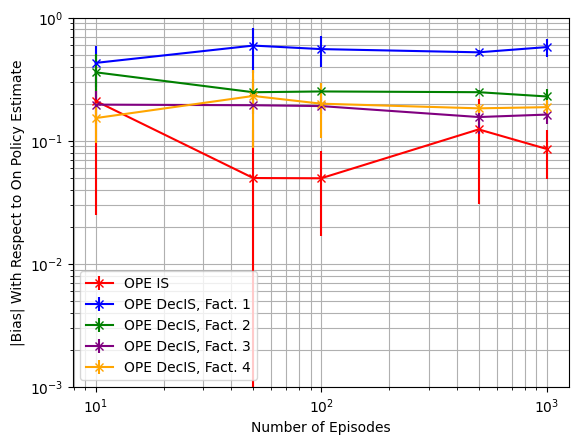

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**-3, 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.21038808 0.04979866 0.04956478 0.12356795 0.08581272]
OPE DecPDIS, Fact. 1-----[0.11023213 0.15154159 0.13167007 0.11558018 0.16894764]
OPE DecPDIS, Fact. 2-----[0.25307694 0.09962109 0.09236736 0.09810349 0.11553714]
OPE DecPDIS, Fact. 3-----[0.08740165 0.08626724 0.11717566 0.18057117 0.1491162 ]
OPE DecPDIS, Fact. 4-----[0.10479254 0.16869396 0.14708877 0.14288027 0.14583977]


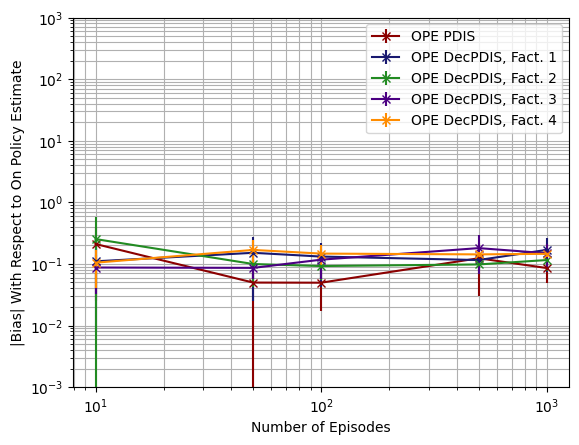

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.73325496 0.74990426 0.74216787 0.74552934 0.74507994]
OPE DecPDWIS, Fact. 1-----[0.74226415 0.75832631 0.75045461 0.7539527  0.75310239]
OPE DecPDWIS, Fact. 2-----[0.68250811 0.70430825 0.69756368 0.70275353 0.70320919]
OPE DecPDWIS, Fact. 3-----[0.70378418 0.720398   0.71212981 0.71533473 0.71557893]
OPE DecPDWIS, Fact. 4-----[0.70509054 0.72518529 0.71829388 0.72253823 0.72254938]


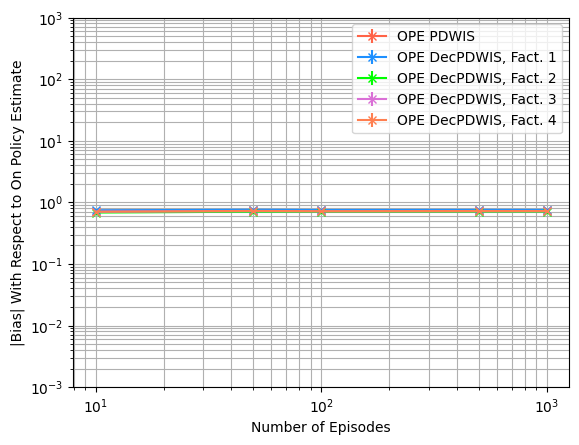

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.02237518 0.00517436 0.00263435 0.00046854 0.0002364 ]
OPE IS-----[1.28867162 0.17311292 0.07200112 0.26859441 0.06994207]
OPE DecIS, Fact. 1-----[0.56700173 1.64357747 0.43829287 0.04098515 0.20797875]
OPE DecIS, Fact. 2-----[2.09787753 0.11921559 0.04769177 0.00851886 0.0203138 ]
OPE DecIS, Fact. 3-----[0.11995872 0.03634945 0.02524419 0.03242375 0.00927143]
OPE DecIS, Fact. 4-----[0.28659935 0.73552452 0.20508942 0.01791879 0.02393325]


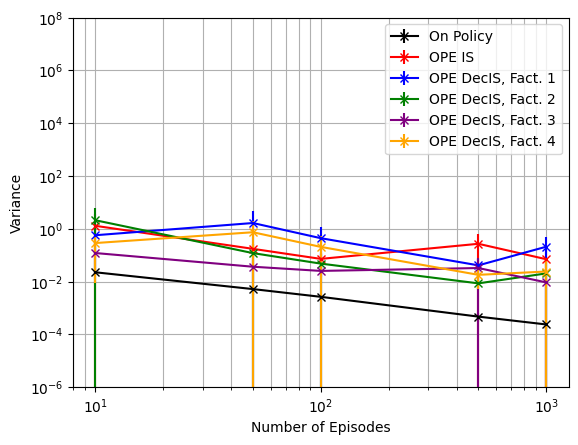

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-6), 10**8, shorter_D, estimator='IS')

On Policy-----[0.02237518 0.00517436 0.00263435 0.00046854 0.0002364 ]
OPE PDIS-----[1.28867162 0.17311292 0.07200112 0.26859441 0.06994207]
OPE DecPDIS, Fact. 1-----[0.21153188 0.5114471  0.13796686 0.01463106 0.16428256]
OPE DecPDIS, Fact. 2-----[2.15780107 0.13425907 0.05406247 0.01099625 0.02142219]
OPE DecPDIS, Fact. 3-----[0.37788291 0.07250952 0.12447901 0.30367863 0.07740699]
OPE DecPDIS, Fact. 4-----[0.16778734 0.23654697 0.06999145 0.00902559 0.00893796]


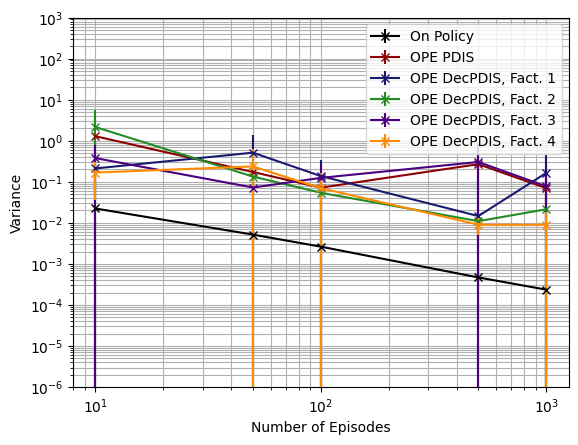

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**3, shorter_D, estimator='PDIS')

On Policy-----[0.02237518 0.00517436 0.00263435 0.00046854 0.0002364 ]
OPE PDWIS-----[1.14206726e-04 5.76556471e-05 3.93871685e-05 1.85583958e-05
 1.45846738e-05]
OPE DecPDWIS, Fact. 1-----[2.36024814e-05 5.92235230e-06 7.34572763e-06 3.40669494e-06
 5.42015242e-06]
OPE DecPDWIS, Fact. 2-----[7.80134377e-04 3.18509964e-04 1.77206228e-04 6.19014319e-05
 5.30242024e-05]
OPE DecPDWIS, Fact. 3-----[4.12681028e-04 1.32450241e-04 1.02735538e-04 9.83845896e-05
 7.11005883e-05]
OPE DecPDWIS, Fact. 4-----[3.31287848e-04 1.37168594e-04 7.96745993e-05 2.72698518e-05
 1.95677146e-05]


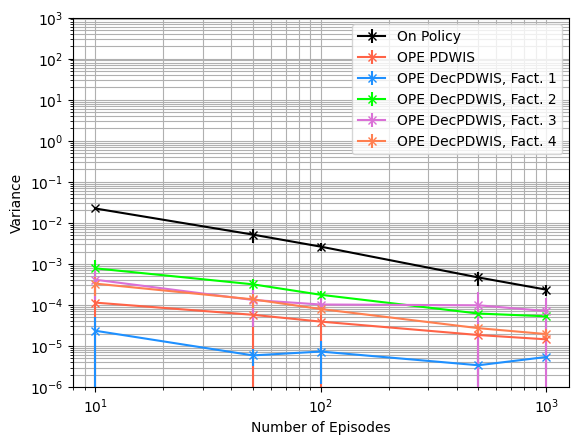

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.02237518 0.00517436 0.00263435 0.00046854 0.0002364 ]
OPE IS-----[1.36740071 0.18073808 0.07552517 0.29253375 0.07866687]
OPE DecIS, Fact. 1-----[0.7748943  2.05000822 0.77009227 0.31401437 0.54762553]
OPE DecIS, Fact. 2-----[2.24735351 0.18505343 0.11249113 0.0699848  0.07391032]
OPE DecIS, Fact. 3-----[0.16197848 0.07486441 0.06238092 0.0585104  0.03654892]
OPE DecIS, Fact. 4-----[0.31317949 0.80958197 0.25387216 0.05172349 0.05967495]


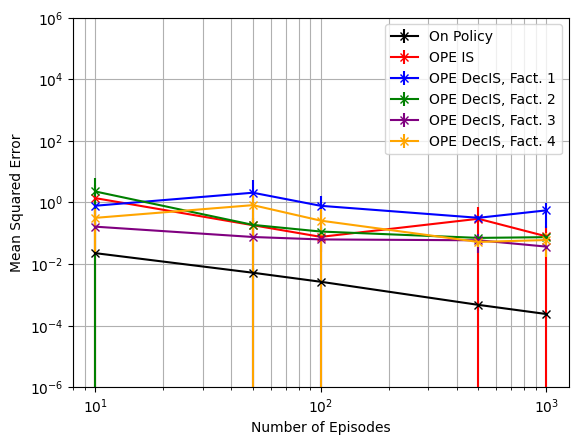

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='IS')

On Policy-----[0.02237518 0.00517436 0.00263435 0.00046854 0.0002364 ]
OPE PDIS-----[1.36740071 0.18073808 0.07552517 0.29253375 0.07866687]
OPE DecPDIS, Fact. 1-----[0.23416051 0.5503387  0.16335076 0.02825196 0.20201286]
OPE DecPDIS, Fact. 2-----[2.33370283 0.14752106 0.0639613  0.02092974 0.03628121]
OPE DecPDIS, Fact. 3-----[0.38852472 0.08080661 0.14181118 0.34856564 0.10362008]
OPE DecPDIS, Fact. 4-----[0.18289216 0.27010024 0.0949063  0.02961852 0.03051888]


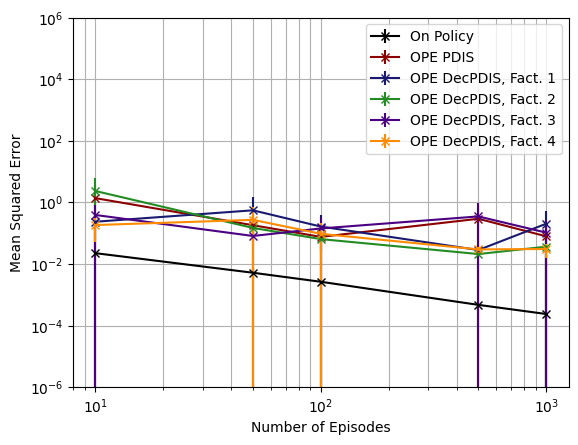

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='PDIS')

On Policy-----[0.02237518 0.00517436 0.00263435 0.00046854 0.0002364 ]
OPE PDWIS-----[0.53857468 0.56251566 0.55090321 0.55585908 0.55516381]
OPE DecPDWIS, Fact. 1-----[0.55185673 0.57518524 0.56323846 0.56847529 0.56717493]
OPE DecPDWIS, Fact. 2-----[0.46740649 0.49653069 0.48682031 0.49395056 0.49457075]
OPE DecPDWIS, Fact. 3-----[0.49659175 0.51924251 0.50727811 0.51184207 0.51213371]
OPE DecPDWIS, Fact. 4-----[0.49835092 0.52617773 0.51607343 0.52211277 0.52210734]


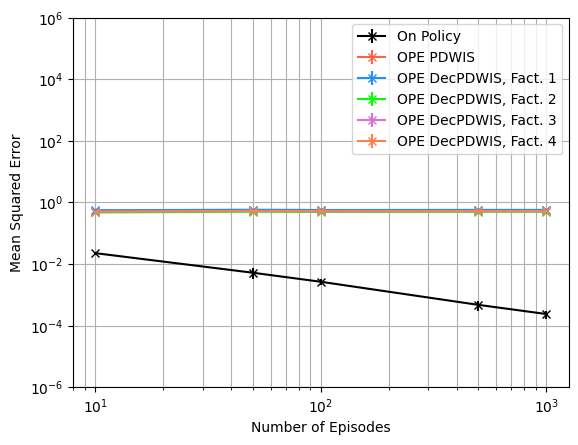

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[ 1.39225442  2.21722233  4.83691683  5.56677512 10.65835208]
OPE DecIS, Fact. 1-----[ 0.76038005  2.0470798   4.26619764 11.9698012  18.44573322]
OPE DecIS, Fact. 2-----[ 2.25849539  7.70172747 14.05227524 33.77457799 65.12644377]
OPE DecIS, Fact. 3-----[ 1.96245624 11.20447955 14.57067806 23.22233456 60.34402938]
OPE DecIS, Fact. 4-----[ 1.63668701  3.61479416  7.46965263 19.68275886 40.16373058]


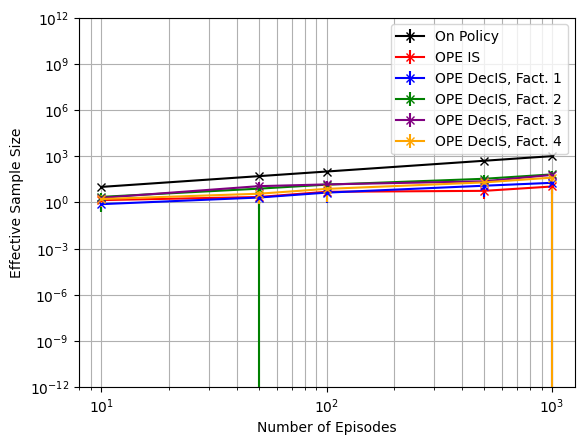

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-12), 10**12, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[ 1.39225442  2.21722233  4.83691683  5.56677512 10.65835208]
OPE DecPDIS, Fact. 1-----[ 1.8095781   3.78379067  7.58768095 31.04065509 48.3765643 ]
OPE DecPDIS, Fact. 2-----[ 1.20494917  5.80394355 10.34800556 24.78608455 47.4519852 ]
OPE DecPDIS, Fact. 3-----[ 1.14758841  3.60124188  5.5190607   7.93331668 14.62063846]
OPE DecPDIS, Fact. 4-----[ 2.12403064  4.9723967  10.6294184  29.42956383 52.17052074]


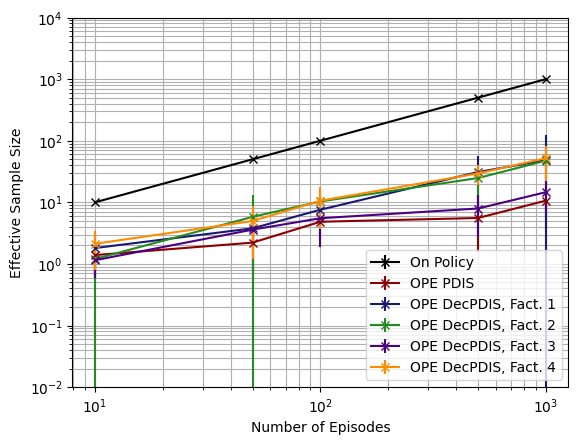

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-2), 10**4, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[11291.89591535 23969.41892924 19838.08467472 29051.95585535
 45096.06521398]
OPE DecPDWIS, Fact. 1-----[ 22299.41314114  64680.50266966  65350.67178264 153714.15072433
  59846.93817232]
OPE DecPDWIS, Fact. 2-----[ 356.33595057  914.03027979 1521.99491846 4568.77825762 5953.65502508]
OPE DecPDWIS, Fact. 3-----[ 773.01248546 2624.29081176 3692.04966897 4871.13490473 6500.9965595 ]
OPE DecPDWIS, Fact. 4-----[  774.8190004   2194.50845283  3567.52117015  9767.72388724
 13415.47880827]


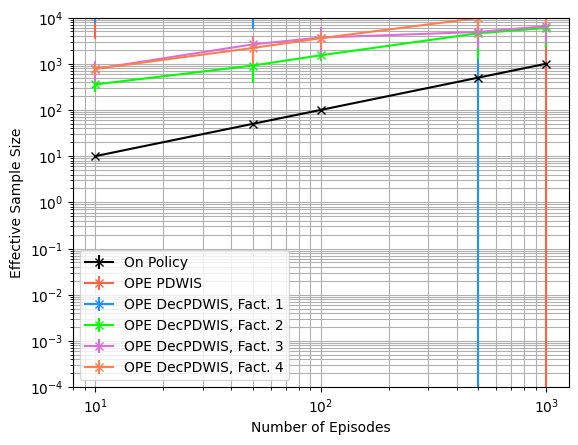

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(4), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.6$ (Policy Divergence $3.2^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
EVAL_EPSILON = 0.6

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

3.2


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.8794326881902761. Variance of on policy Q estimate: 0.008848227712566154
Mean OPE IS estimate: -0.7647220624140494. Bias1: 0.11471062577622672. Bias2: 0.1147106257762267. Variance: 0.025779822038478943. MSE: 0.03893834970445247
Mean OPE PDIS estimate: -0.7647220624140494. Bias1: 0.11471062577622672. Bias2: 0.1147106257762267. Variance: 0.025779822038478943. MSE: 0.03893834970445247
Mean OPE PDWIS estimate: -0.047384061445353905. Bias1: 0.8320486267449222. Bias2: 0.8320486267449222. Variance: 6.950567650132465e-06. MSE: 0.6923118678357609
Mean OPE DecIS: Fact. 1 estimate: -1.1132062481607312. Bias1: 0.2337735599704551. Bias2: 0.23377355997045512. Variance: 0.07917220386494077. MSE: 0.13382228120620074
Mean OPE DecPDIS: Fact. 1 estimate: -0.8168208503509569. Bias1: 0.06261183783931917. Bias2: 0.06261183783931923. Variance: 0.036712776124538535. MSE: 0.040633018362155736
Mean OPE DecPDWIS: Fact. 1 estimate: 

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.10019315 0.03130794 0.02361456 0.04819625 0.03064101]
OPE DecIS, Fact. 1-----[0.28555208 0.35890178 0.34886725 0.35648092 0.36171898]
OPE DecIS, Fact. 2-----[0.2463431  0.24891685 0.24601766 0.23865729 0.22426243]
OPE DecIS, Fact. 3-----[0.18066694 0.16989503 0.1639538  0.13792553 0.14595068]
OPE DecIS, Fact. 4-----[0.04624446 0.07757974 0.06876604 0.07842728 0.07759452]


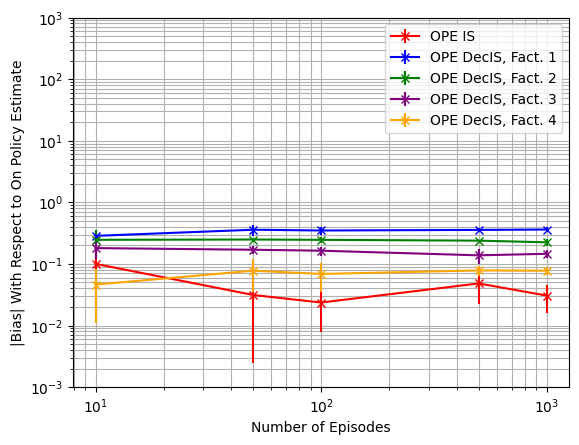

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='IS')

OPE PDIS-----[0.10019315 0.03130794 0.02361456 0.04819625 0.03064101]
OPE DecPDIS, Fact. 1-----[0.06995428 0.04619557 0.03578396 0.04182782 0.04817241]
OPE DecPDIS, Fact. 2-----[0.10096476 0.02194181 0.02736644 0.03277431 0.0455496 ]
OPE DecPDIS, Fact. 3-----[0.06063734 0.02583745 0.03655646 0.06799127 0.05034823]
OPE DecPDIS, Fact. 4-----[0.0488452  0.04568582 0.03791081 0.04961294 0.04843816]


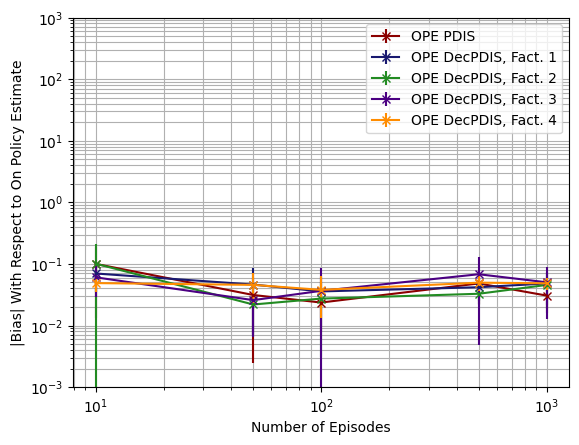

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.84856632 0.85146474 0.85076483 0.84403644 0.84517284]
OPE DecPDWIS, Fact. 1-----[0.85656846 0.85906351 0.85835469 0.85197862 0.85281868]
OPE DecPDWIS, Fact. 2-----[0.82390377 0.82789974 0.82712603 0.82109594 0.82199837]
OPE DecPDWIS, Fact. 3-----[0.83591696 0.8386742  0.83793407 0.83096189 0.83216651]
OPE DecPDWIS, Fact. 4-----[0.83740751 0.84093333 0.84028628 0.83385721 0.83484017]


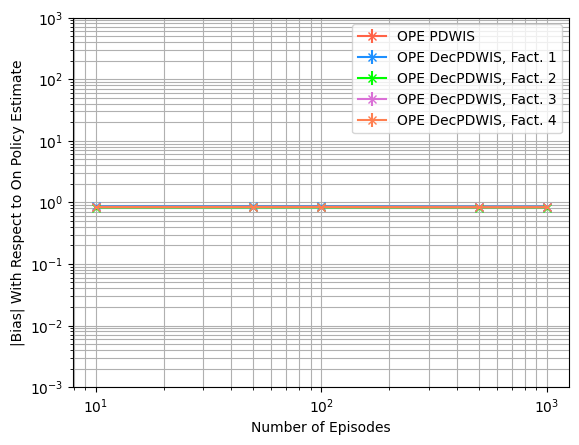

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.0097292  0.00172478 0.00090144 0.00026051 0.00013162]
OPE IS-----[0.33750922 0.03494886 0.02023639 0.02785579 0.00927645]
OPE DecIS, Fact. 1-----[0.15735192 0.16336267 0.05309555 0.00712255 0.01320447]
OPE DecIS, Fact. 2-----[0.2432477  0.02537491 0.01624175 0.00270152 0.01204298]
OPE DecIS, Fact. 3-----[0.08144962 0.01493745 0.02088413 0.02235239 0.00605619]
OPE DecIS, Fact. 4-----[0.08478782 0.07432171 0.02554563 0.00356028 0.00242147]


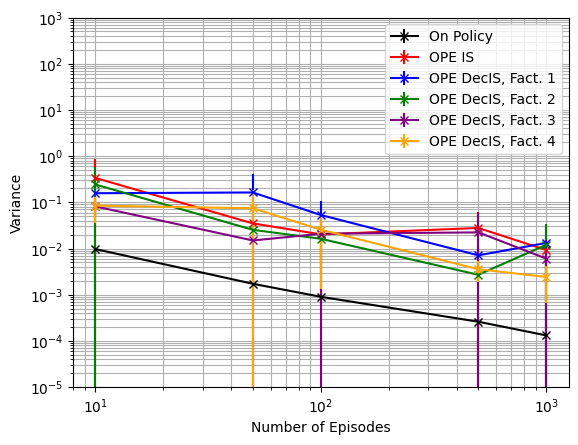

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-5), 10**3, shorter_D, estimator='IS')

On Policy-----[0.0097292  0.00172478 0.00090144 0.00026051 0.00013162]
OPE PDIS-----[0.33750922 0.03494886 0.02023639 0.02785579 0.00927645]
OPE DecPDIS, Fact. 1-----[0.0764739  0.06732794 0.02366689 0.00338855 0.00979987]
OPE DecPDIS, Fact. 2-----[0.27593293 0.02995202 0.01872324 0.00409669 0.01259022]
OPE DecPDIS, Fact. 3-----[0.14854299 0.02364763 0.06386211 0.07782501 0.01959873]
OPE DecPDIS, Fact. 4-----[0.06625397 0.03376227 0.01301377 0.0025909  0.00146499]


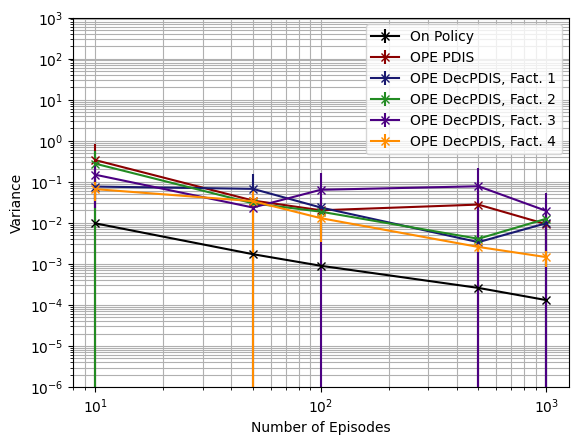

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**3, shorter_D, estimator='PDIS')

On Policy-----[0.0097292  0.00172478 0.00090144 0.00026051 0.00013162]
OPE PDWIS-----[8.57633363e-05 2.74275978e-05 1.56551496e-05 4.26355611e-06
 5.47568130e-06]
OPE DecPDWIS, Fact. 1-----[1.78433457e-05 5.26781225e-06 4.17592560e-06 1.98175698e-06
 3.51323997e-06]
OPE DecPDWIS, Fact. 2-----[1.77670996e-04 6.19750927e-05 3.73408635e-05 1.07277937e-05
 1.46406787e-05]
OPE DecPDWIS, Fact. 3-----[1.15112548e-04 3.05908585e-05 3.19235345e-05 2.64927293e-05
 1.52253125e-05]
OPE DecPDWIS, Fact. 4-----[7.77750066e-05 2.77254601e-05 1.82466160e-05 4.83608665e-06
 2.98304935e-06]


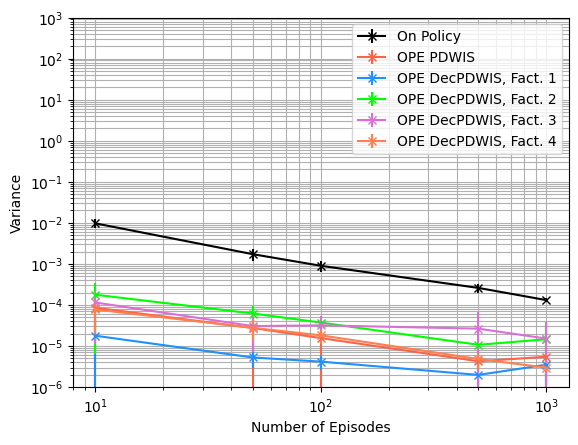

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.0097292  0.00172478 0.00090144 0.00026051 0.00013162]
OPE IS-----[0.35512445 0.03676267 0.02104346 0.03084134 0.01042419]
OPE DecIS, Fact. 1-----[0.24435548 0.29713727 0.17734363 0.13467474 0.14488344]
OPE DecIS, Fact. 2-----[0.31709723 0.0875768  0.0773284  0.05970727 0.0629854 ]
OPE DecIS, Fact. 3-----[0.11751726 0.04433285 0.04850894 0.04271763 0.02784577]
OPE DecIS, Fact. 4-----[0.08817026 0.08217303 0.03137037 0.00989982 0.00857514]


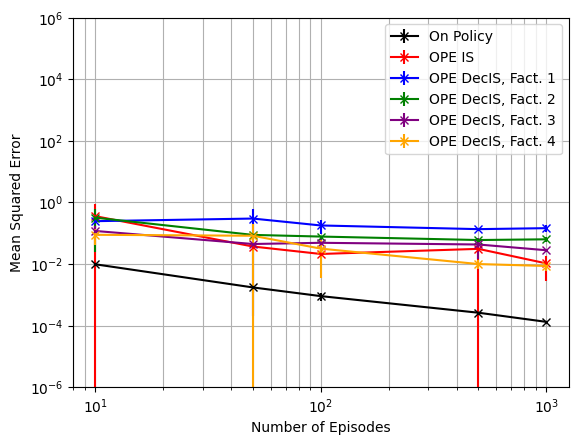

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='IS')

On Policy-----[0.0097292  0.00172478 0.00090144 0.00026051 0.00013162]
OPE PDIS-----[0.35512445 0.03676267 0.02104346 0.03084134 0.01042419]
OPE DecPDIS, Fact. 1-----[0.08259249 0.07099556 0.02564602 0.00541714 0.01283883]
OPE DecPDIS, Fact. 2-----[0.29765335 0.0306515  0.02006332 0.00529988 0.01538862]
OPE DecPDIS, Fact. 3-----[0.15323108 0.02468987 0.06753422 0.08643347 0.02353781]
OPE DecPDIS, Fact. 4-----[0.06883252 0.0364818  0.01506793 0.00524216 0.003918  ]


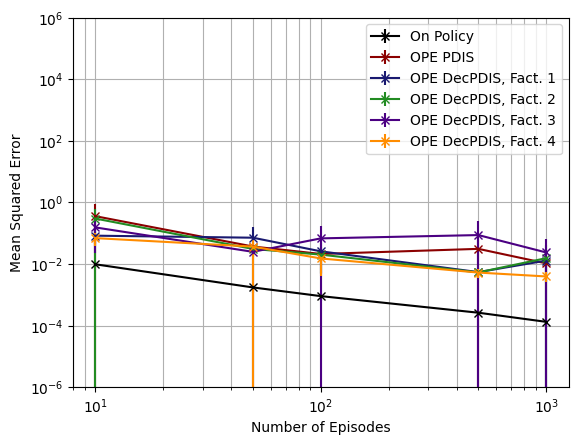

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='PDIS')

On Policy-----[0.0097292  0.00172478 0.00090144 0.00026051 0.00013162]
OPE PDWIS-----[0.72068474 0.72515296 0.72383617 0.71242786 0.71433179]
OPE DecPDWIS, Fact. 1-----[0.73422469 0.73813167 0.73679557 0.72589156 0.72731202]
OPE DecPDWIS, Fact. 2-----[0.67952744 0.68558036 0.68419259 0.67423302 0.67570346]
OPE DecPDWIS, Fact. 3-----[0.69942646 0.70352476 0.70218385 0.69055583 0.69252802]
OPE DecPDWIS, Fact. 4-----[0.70184602 0.70731089 0.7061167  0.69534713 0.69696917]


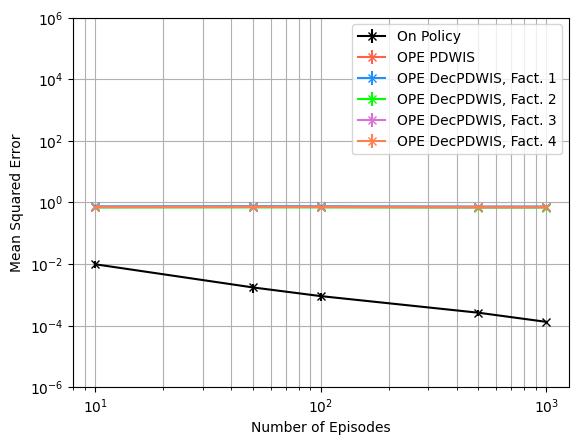

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[ 1.43294303  2.60820643  4.98794505 12.54293211 21.42506394]
OPE DecIS, Fact. 1-----[ 0.84555124  2.01465978  3.44422402 27.86001032 33.85774942]
OPE DecIS, Fact. 2-----[ 1.97029624  4.87049751  9.77493875 53.41136895 94.94567639]
OPE DecIS, Fact. 3-----[ 1.38713285  6.50703725  8.87646932 25.56189521 83.10205663]
OPE DecIS, Fact. 4-----[ 1.61479105  4.52549317  7.24072231 47.9199749  79.8572986 ]


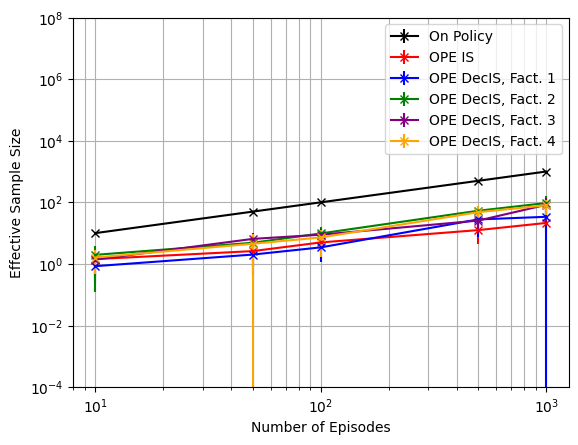

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[ 1.43294303  2.60820643  4.98794505 12.54293211 21.42506394]
OPE DecPDIS, Fact. 1-----[ 1.60970996  3.47464582  5.79877645 49.95410909 67.14847076]
OPE DecPDIS, Fact. 2-----[ 1.00686031  3.76102796  8.02135909 35.57183618 64.22757888]
OPE DecPDIS, Fact. 3-----[ 1.01026893  3.64968709  5.42195482 13.76054346 42.70287367]
OPE DecPDIS, Fact. 4-----[  1.69757468   5.26956309  10.27556908  51.86094601 106.21271721]


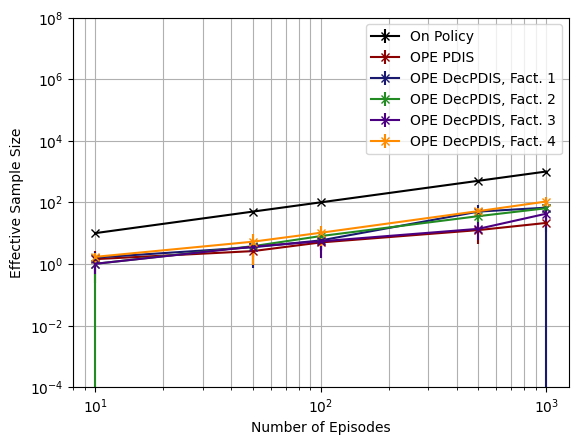

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[12295.32276523  9555.32159    16293.33473982 43504.38931557
 38429.99061722]
OPE DecPDWIS, Fact. 1-----[ 20778.50487426  18213.52398943  22869.33624519 261388.14804845
  56838.19078176]
OPE DecPDWIS, Fact. 2-----[  933.38183811  1582.82749202  2468.35571486 17562.36214816
 19993.59431466]
OPE DecPDWIS, Fact. 3-----[ 1675.45636758  3565.71892419  4837.14673842 22894.2174248
 34744.97469459]
OPE DecPDWIS, Fact. 4-----[ 1835.76421367  3650.0652861   5115.4398418  38258.76797978
 47202.89256457]


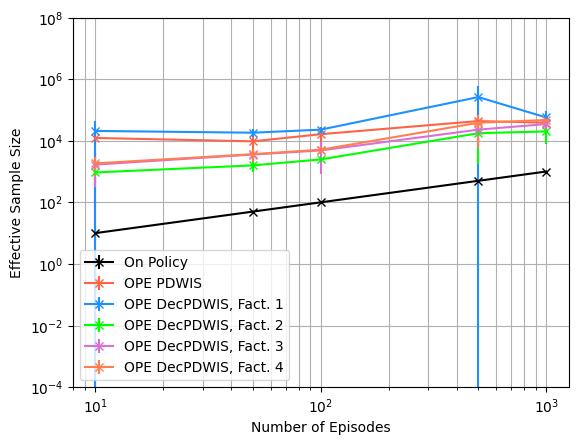

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{20}$)



Set up evaluation policy, generate data and convert into factored format

In [ ]:
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.9447078462410744. Variance of on policy Q estimate: 0.004541427228210121
Mean OPE IS estimate: -0.9318861414106937. Bias1: 0.012821704830380887. Bias2: 0.012821704830380698. Variance: 0.00694967768782836. MSE: 0.007114073802585772
Mean OPE PDIS estimate: -0.9318861414106937. Bias1: 0.012821704830380887. Bias2: 0.012821704830380698. Variance: 0.00694967768782836. MSE: 0.007114073802585772
Mean OPE PDWIS estimate: -0.04826958059550411. Bias1: 0.8964382656455704. Bias2: 0.8964382656455703. Variance: 8.664358025876099e-06. MSE: 0.803610228471664
Mean OPE DecIS: Fact. 1 estimate: -1.0556972990522664. Bias1: 0.11098945281119203. Bias2: 0.11098945281119199. Variance: 0.007890666765181254. MSE: 0.020209325400509077
Mean OPE DecPDIS: Fact. 1 estimate: -0.9286107770866059. Bias1: 0.01609706915446843. Bias2: 0.016097069154468513. Variance: 0.006403467550309548. MSE: 0.006662583185673287
Mean OPE DecPDWIS: Fact. 1 es

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.02995105 0.00930776 0.00604397 0.00658381 0.00640234]
OPE DecIS, Fact. 1-----[0.12504879 0.13759384 0.13457065 0.14034412 0.13921978]
OPE DecIS, Fact. 2-----[0.11864392 0.11262407 0.11058262 0.10647723 0.10569474]
OPE DecIS, Fact. 3-----[0.06432628 0.0558534  0.05552554 0.05394344 0.05391743]
OPE DecIS, Fact. 4-----[0.02423103 0.01596784 0.0153071  0.01906717 0.01900231]


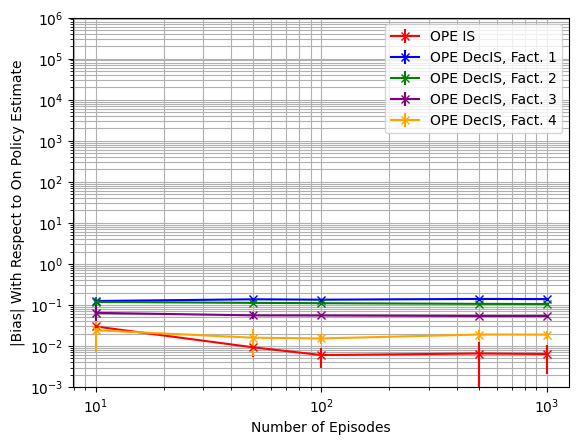

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**6, shorter_D, estimator='IS')

OPE PDIS-----[0.02995105 0.00930776 0.00604397 0.00658381 0.00640234]
OPE DecPDIS, Fact. 1-----[0.02362355 0.00896552 0.00316333 0.00870889 0.00755341]
OPE DecPDIS, Fact. 2-----[0.03087013 0.00997315 0.00604688 0.00747153 0.007716  ]
OPE DecPDIS, Fact. 3-----[0.02494458 0.01049087 0.0055229  0.0051298  0.00392961]
OPE DecPDIS, Fact. 4-----[0.02178809 0.00957364 0.00440689 0.00723672 0.00683189]


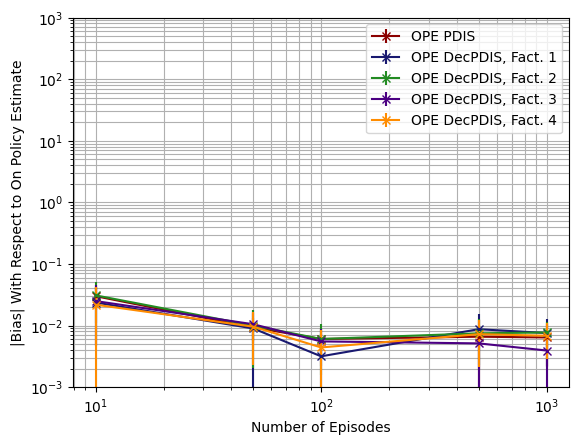

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.89986478 0.89926878 0.89672038 0.89470329 0.89423129]
OPE DecPDWIS, Fact. 1-----[0.90415604 0.90356208 0.90103332 0.89899987 0.89852304]
OPE DecPDWIS, Fact. 2-----[0.89383825 0.89327227 0.89063303 0.8886695  0.88819817]
OPE DecPDWIS, Fact. 3-----[0.89746653 0.89669944 0.89413552 0.89210247 0.89165021]
OPE DecPDWIS, Fact. 4-----[0.89881887 0.89821678 0.89561383 0.89358678 0.89311992]


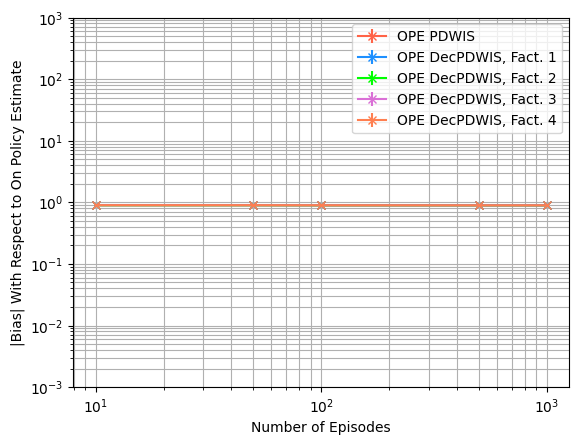

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[3.37903202e-03 7.40304269e-04 5.68526552e-04 9.94352037e-05
 6.15891625e-05]
OPE IS-----[0.01643139 0.0025855  0.00155109 0.00044013 0.0002508 ]
OPE DecIS, Fact. 1-----[0.0133296  0.00294524 0.00157729 0.00030933 0.00019753]
OPE DecIS, Fact. 2-----[0.00988768 0.00208151 0.00113064 0.00031116 0.0001588 ]
OPE DecIS, Fact. 3-----[0.01243077 0.00230112 0.00126364 0.0003807  0.00017627]
OPE DecIS, Fact. 4-----[0.0085698  0.00196748 0.00097285 0.00024008 0.00011817]


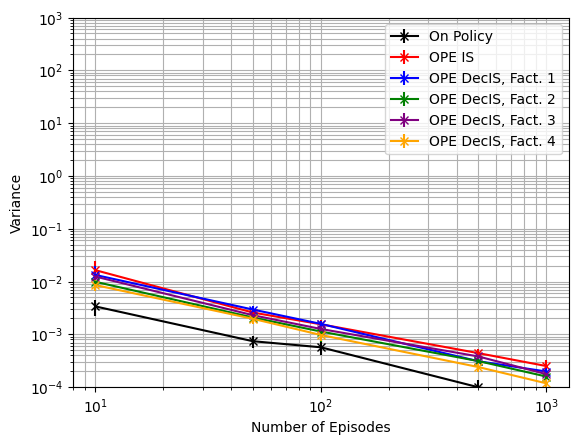

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**3, shorter_D, estimator='IS')

On Policy-----[3.37903202e-03 7.40304269e-04 5.68526552e-04 9.94352037e-05
 6.15891625e-05]
OPE PDIS-----[0.01643139 0.0025855  0.00155109 0.00044013 0.0002508 ]
OPE DecPDIS, Fact. 1-----[0.01070679 0.00227369 0.0012593  0.00026227 0.00016678]
OPE DecPDIS, Fact. 2-----[0.01253789 0.00233821 0.00133494 0.00038389 0.00019452]
OPE DecPDIS, Fact. 3-----[0.01381608 0.00250149 0.00144862 0.00042384 0.00019736]
OPE DecPDIS, Fact. 4-----[0.00900244 0.00182073 0.0009501  0.00025421 0.00012189]


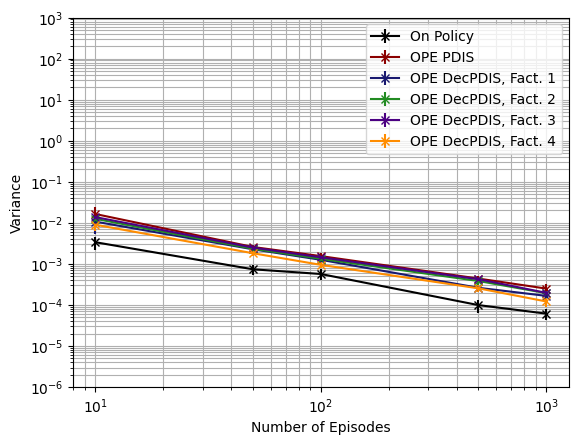

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**3, shorter_D, estimator='PDIS')

On Policy-----[3.37903202e-03 7.40304269e-04 5.68526552e-04 9.94352037e-05
 6.15891625e-05]
OPE PDWIS-----[1.78383440e-05 2.72582679e-06 1.44961746e-06 3.36607596e-07
 1.93959687e-07]
OPE DecPDWIS, Fact. 1-----[7.06314722e-06 1.65883093e-06 9.80916360e-07 1.98810731e-07
 1.15857120e-07]
OPE DecPDWIS, Fact. 2-----[1.90902692e-05 3.52151654e-06 2.25665845e-06 4.40066157e-07
 2.15627885e-07]
OPE DecPDWIS, Fact. 3-----[1.92667791e-05 3.71069481e-06 2.24543665e-06 4.37841025e-07
 2.06891139e-07]
OPE DecPDWIS, Fact. 4-----[1.20692801e-05 2.56716008e-06 1.60227342e-06 2.83834693e-07
 1.43957764e-07]


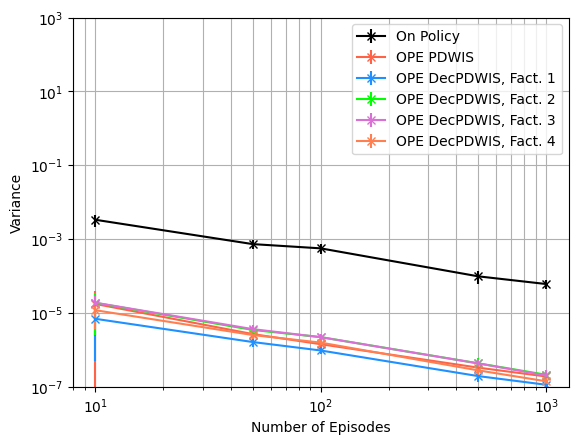

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[3.37903202e-03 7.40304269e-04 5.68526552e-04 9.94352037e-05
 6.15891625e-05]
OPE IS-----[0.01747987 0.00268641 0.00159769 0.00051835 0.00030996]
OPE DecIS, Fact. 1-----[0.02980555 0.02201742 0.01970166 0.02006445 0.01961431]
OPE DecIS, Fact. 2-----[0.02534178 0.0148785  0.01339051 0.01166646 0.01134066]
OPE DecIS, Fact. 3-----[0.017675   0.00553693 0.00437282 0.00330898 0.00309232]
OPE DecIS, Fact. 4-----[0.00944287 0.00233038 0.00122331 0.00062842 0.00049514]


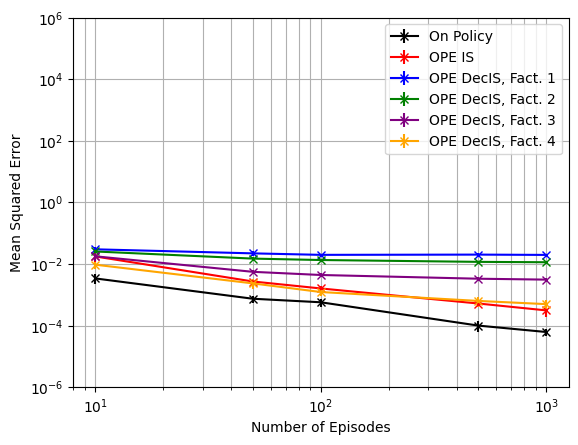

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='IS')

On Policy-----[3.37903202e-03 7.40304269e-04 5.68526552e-04 9.94352037e-05
 6.15891625e-05]
OPE PDIS-----[0.01747987 0.00268641 0.00159769 0.00051835 0.00030996]
OPE DecPDIS, Fact. 1-----[0.01161873 0.00243426 0.00128573 0.00038476 0.00025217]
OPE DecPDIS, Fact. 2-----[0.01389348 0.00250091 0.00139154 0.00046625 0.0002683 ]
OPE DecPDIS, Fact. 3-----[0.01484811 0.00263925 0.00148988 0.00046941 0.00022644]
OPE DecPDIS, Fact. 4-----[0.00991319 0.00196497 0.00098706 0.00033281 0.00018452]


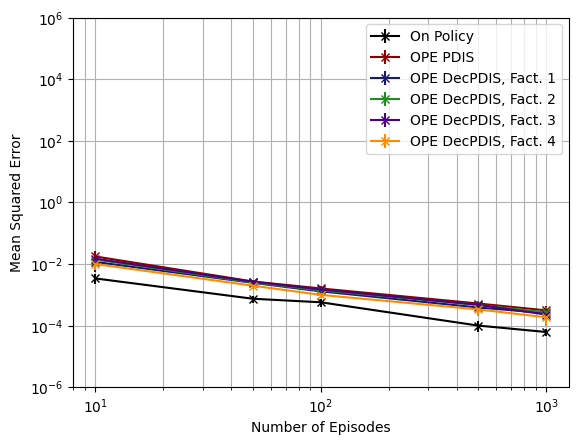

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='PDIS')

On Policy-----[3.37903202e-03 7.40304269e-04 5.68526552e-04 9.94352037e-05
 6.15891625e-05]
OPE PDWIS-----[0.80986696 0.80869779 0.80411418 0.8004992  0.7996562 ]
OPE DecPDWIS, Fact. 1-----[0.81759468 0.81643669 0.81186736 0.80820587 0.80735025]
OPE DecPDWIS, Fact. 2-----[0.79905707 0.79795126 0.79323502 0.78973886 0.78890263]
OPE DecPDWIS, Fact. 3-----[0.80555899 0.80408506 0.79948596 0.79585229 0.79504681]
OPE DecPDWIS, Fact. 4-----[0.80797838 0.80680762 0.80213122 0.79850264 0.79766983]


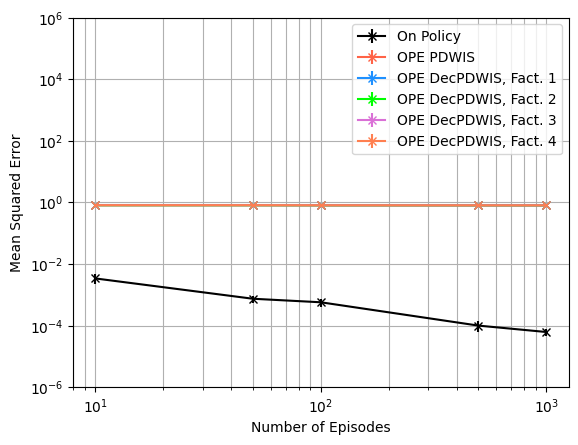

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[  2.87580994  14.17598233  38.85188585 118.55237193 248.69160178]
OPE DecIS, Fact. 1-----[  3.37448234  12.68358302  37.12669648 159.74219525 321.77622674]
OPE DecIS, Fact. 2-----[  3.9936186   18.48009375  57.76402315 163.06823215 388.87320741]
OPE DecIS, Fact. 3-----[  2.75669947  16.41455129  49.79979961 128.30736649 351.92514995]
OPE DecIS, Fact. 4-----[  4.39635325  19.60308319  65.14135201 202.69373878 518.69547991]


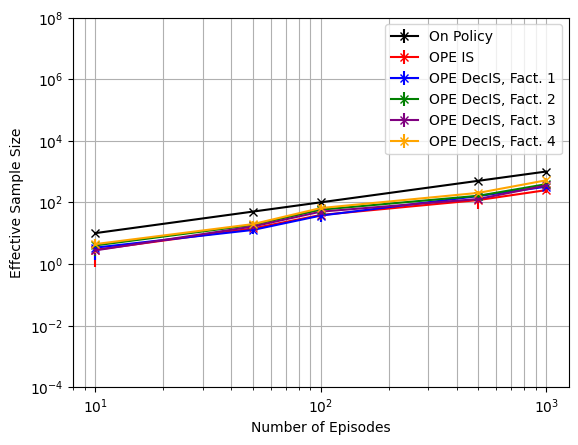

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[  2.87580994  14.17598233  38.85188585 118.55237193 248.69160178]
OPE DecPDIS, Fact. 1-----[  4.27339129  16.36810626  47.49963623 187.06751374 373.22329379]
OPE DecPDIS, Fact. 2-----[  3.0704412   16.3673925   46.13134065 131.51567446 324.12626059]
OPE DecPDIS, Fact. 3-----[  2.5357035   14.89763591  40.58873814 115.3204942  318.60597838]
OPE DecPDIS, Fact. 4-----[  4.2915971   20.85375192  64.56173832 190.8087666  510.31402366]


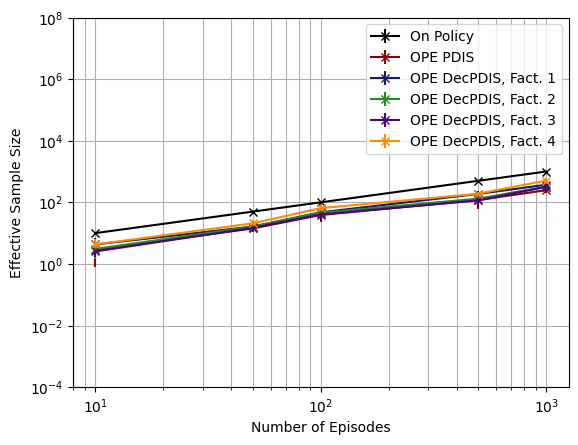

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[  6732.22045316  15005.30332216  39861.01128808 149412.5293252
 318302.11690301]
OPE DecPDWIS, Fact. 1-----[ 14495.31794984  23051.60551624  58918.69106605 263790.1503105
 520918.21530397]
OPE DecPDWIS, Fact. 2-----[  4643.34824542  10834.74714398  25100.16340214 125240.09039929
 313521.48407754]
OPE DecPDWIS, Fact. 3-----[  4230.87262386  10811.10240793  25708.65303339 119889.21564215
 326703.14980297]
OPE DecPDWIS, Fact. 4-----[  7434.14413333  15090.10872768  36010.2706059  184956.88936164
 453162.6899618 ]


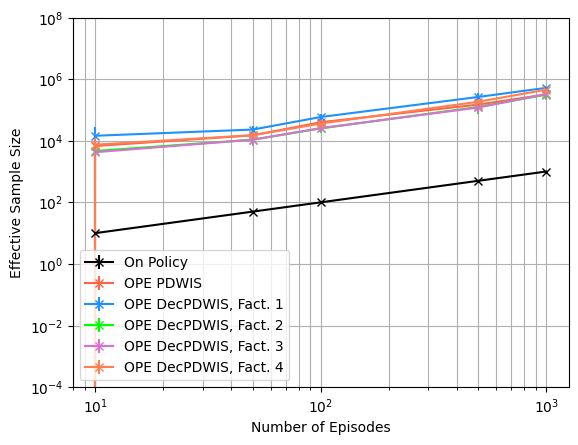

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

### Varying Episode Length $T$ With $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{T}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
LENGTHS = [1, 5, 10, 20]

bias_means = np.zeros((len(LENGTHS), 16))
bias_stds = np.zeros((len(LENGTHS), 16))
var_means = np.zeros((len(LENGTHS), 16))
var_stds = np.zeros((len(LENGTHS), 16))
MSE_means = np.zeros((len(LENGTHS), 16))
MSE_stds = np.zeros((len(LENGTHS), 16))
ESS_means = np.zeros((len(LENGTHS), 16))
ESS_stds = np.zeros((len(LENGTHS), 16))

RUNS = 20

for id in range(len(LENGTHS)):
  e = LENGTHS[id]
  print(f'{e} Steps, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

1 Steps, 20 ----------------------------------

Mean on policy Q estimate: -0.9684450595121341. Variance of on policy Q estimate: 0.0010877717603912183
Mean OPE IS estimate: -0.9523735668113498. Bias1: 0.01607149270078432. Bias2: 0.01607149270078434. Variance: 0.05488110954740649. MSE: 0.055139402425037856
Mean OPE PDIS estimate: -0.9523735668113498. Bias1: 0.01607149270078432. Bias2: 0.01607149270078434. Variance: 0.05488110954740649. MSE: 0.055139402425037856
Mean OPE PDWIS estimate: -0.04919522220642131. Bias1: 0.9192498373057127. Bias2: 0.9192498373057127. Variance: 1.154482875527577e-06. MSE: 0.845021417869455
Mean OPE DecIS: Fact. 1 estimate: -1.011631062770405. Bias1: 0.04318600325827109. Bias2: 0.04318600325827093. Variance: 0.06886247491608041. MSE: 0.07072750579350381
Mean OPE DecPDIS: Fact. 1 estimate: -0.888713786208422. Bias1: 0.07973127330371227. Bias2: 0.0797312733037121. Variance: 0.05054162045728862. MSE: 0.05689869639991988
Mean OPE DecPDWIS: Fact. 1 estimate: -0.0441

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.04511273 0.01765745 0.02071673 0.01802026]
OPE DecIS, Fact. 1-----[0.12069286 0.12103057 0.14451003 0.15437713]
OPE DecIS, Fact. 2-----[0.13805325 0.12654223 0.09918267 0.09285932]
OPE DecIS, Fact. 3-----[0.08318822 0.06924635 0.04486503 0.04015908]
OPE DecIS, Fact. 4-----[0.06918141 0.03524875 0.02855229 0.0326833 ]


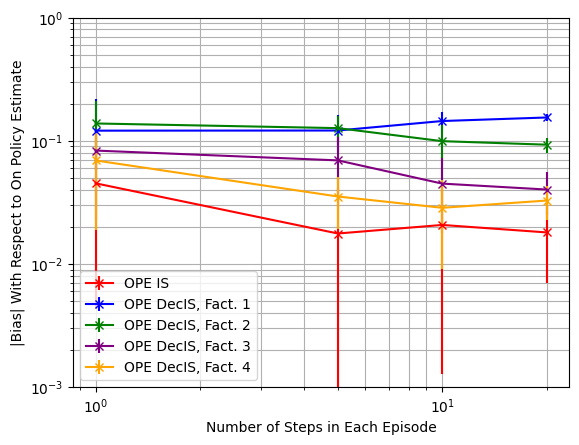

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.04511273 0.01765745 0.02071673 0.01802026]
OPE DecPDIS, Fact. 1-----[0.08166896 0.0303639  0.02600325 0.02339382]
OPE DecPDIS, Fact. 2-----[0.06998989 0.03122163 0.03213446 0.02122829]
OPE DecPDIS, Fact. 3-----[0.05368163 0.0315654  0.02427617 0.01757626]
OPE DecPDIS, Fact. 4-----[0.06367534 0.02799875 0.02422543 0.0214195 ]


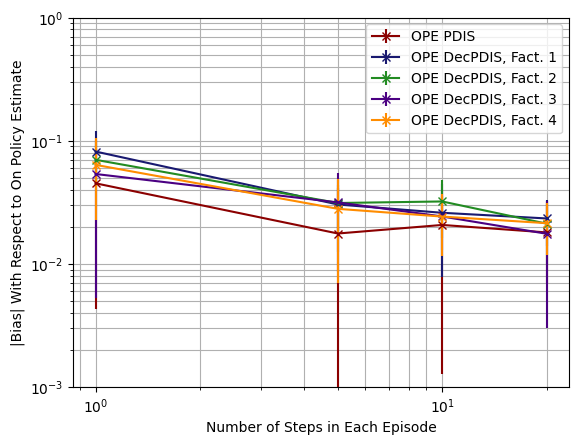

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.89081583 0.88898471 0.88040354 0.88417011]
OPE DecPDWIS, Fact. 1-----[0.8960758  0.89326751 0.8846948  0.88846635]
OPE DecPDWIS, Fact. 2-----[0.88513945 0.88249741 0.87437701 0.87797623]
OPE DecPDWIS, Fact. 3-----[0.88841246 0.88609655 0.87800528 0.88160716]
OPE DecPDWIS, Fact. 4-----[0.89037909 0.88754714 0.87935763 0.88302111]


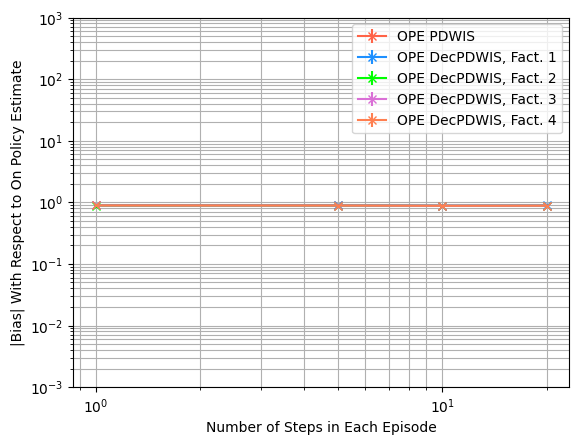

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.05481232 0.01383904 0.00786943 0.00361094]
OPE IS-----[0.10866983 0.04070051 0.01643139 0.00653152]
OPE DecIS, Fact. 1-----[0.13858865 0.02731648 0.0133296  0.00622197]
OPE DecIS, Fact. 2-----[0.07367232 0.02216112 0.00988768 0.00517351]
OPE DecIS, Fact. 3-----[0.10159407 0.02763452 0.01243077 0.00516081]
OPE DecIS, Fact. 4-----[0.08653227 0.01889094 0.0085698  0.00403272]


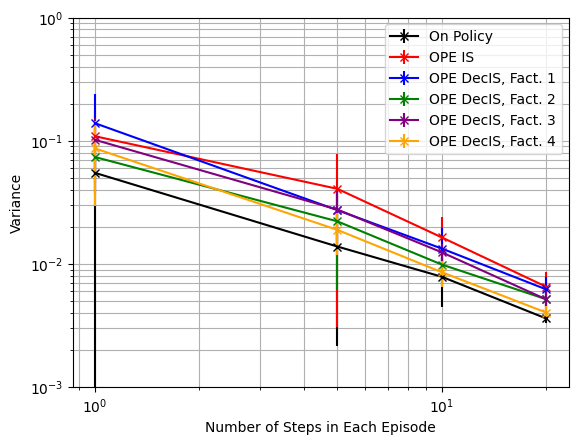

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

On Policy-----[0.05481232 0.01383904 0.00786943 0.00361094]
OPE PDIS-----[0.10866983 0.04070051 0.01643139 0.00653152]
OPE DecPDIS, Fact. 1-----[0.09687234 0.02318378 0.01070679 0.00502247]
OPE DecPDIS, Fact. 2-----[0.08780005 0.02934177 0.01253789 0.00585232]
OPE DecPDIS, Fact. 3-----[0.11760218 0.03153256 0.01381608 0.00537027]
OPE DecPDIS, Fact. 4-----[0.07692682 0.0205711  0.00900244 0.00394801]


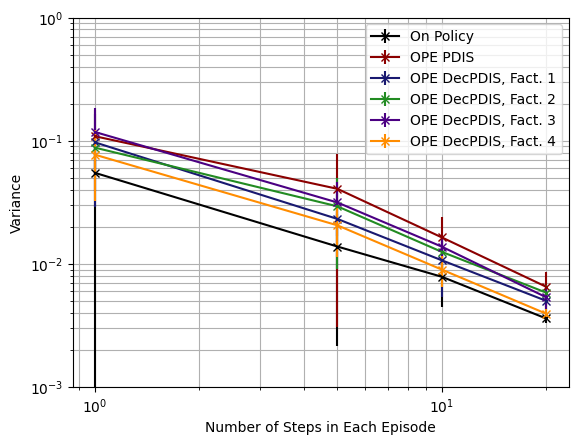

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.05481232 0.01383904 0.00786943 0.00361094]
OPE PDWIS-----[3.02410602e-05 4.79478431e-05 1.78383440e-05 5.55890263e-06]
OPE DecPDWIS, Fact. 1-----[3.09696254e-05 2.10142202e-05 7.06314722e-06 2.35976437e-06]
OPE DecPDWIS, Fact. 2-----[6.25783234e-05 4.52903076e-05 1.90902692e-05 6.62274703e-06]
OPE DecPDWIS, Fact. 3-----[5.50205475e-05 4.38208019e-05 1.92667791e-05 6.40664144e-06]
OPE DecPDWIS, Fact. 4-----[4.95117297e-05 2.93351235e-05 1.20692801e-05 4.16213295e-06]


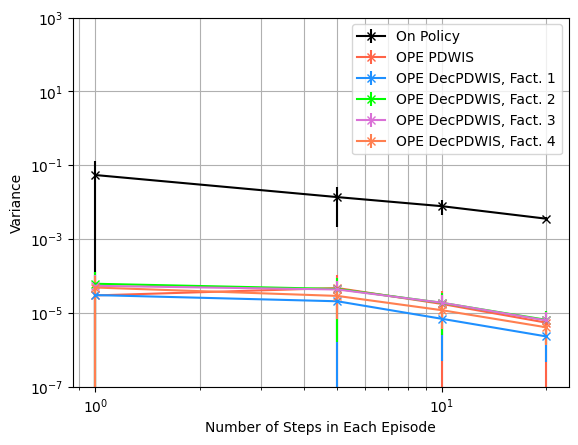

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.05481232 0.01383904 0.00786943 0.00361094]
OPE IS-----[0.11237273 0.04155706 0.01723812 0.00697664]
OPE DecIS, Fact. 1-----[0.16271708 0.04351465 0.03497916 0.03017104]
OPE DecIS, Fact. 2-----[0.09797682 0.03917369 0.02092316 0.01396824]
OPE DecIS, Fact. 3-----[0.10912287 0.03385782 0.01517763 0.00700704]
OPE DecIS, Fact. 4-----[0.09384749 0.02038556 0.00976631 0.0052031 ]


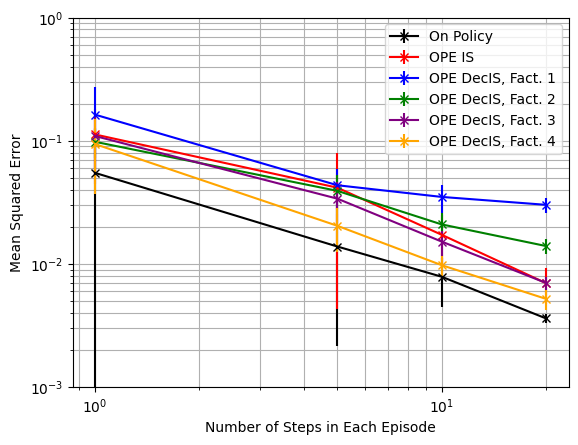

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

On Policy-----[0.05481232 0.01383904 0.00786943 0.00361094]
OPE PDIS-----[0.11237273 0.04155706 0.01723812 0.00697664]
OPE DecPDIS, Fact. 1-----[0.10494255 0.02442187 0.01171411 0.00565858]
OPE DecPDIS, Fact. 2-----[0.09347352 0.03047957 0.01382073 0.00643427]
OPE DecPDIS, Fact. 3-----[0.12282507 0.03305824 0.01453467 0.00589188]
OPE DecPDIS, Fact. 4-----[0.08265035 0.02179712 0.00974839 0.00449824]


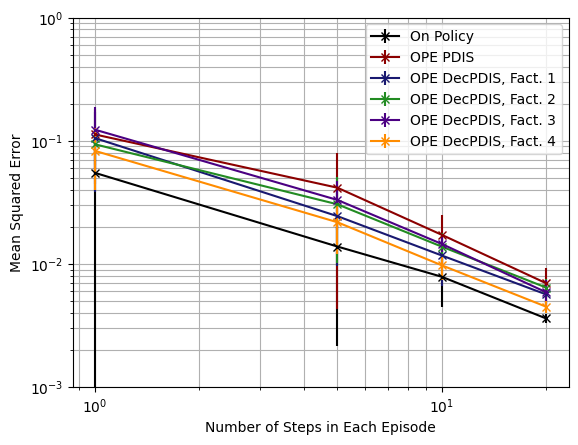

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.05481232 0.01383904 0.00786943 0.00361094]
OPE PDWIS-----[0.79571436 0.79067275 0.77519492 0.78178285]
OPE DecPDWIS, Fact. 1-----[0.80515198 0.79829521 0.78276329 0.78939505]
OPE DecPDWIS, Fact. 2-----[0.78563617 0.77917766 0.76461874 0.77086718]
OPE DecPDWIS, Fact. 3-----[0.79147987 0.78554851 0.77097788 0.77725596]
OPE DecPDWIS, Fact. 4-----[0.79496376 0.78811065 0.77334908 0.77974907]


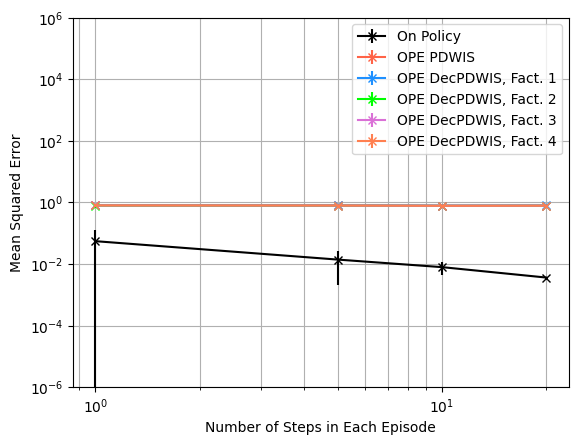

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[ 1.  5. 10. 20.]
OPE IS-----[ 0.91143099  1.84286099  4.96938287 12.45199458]
OPE DecIS, Fact. 1-----[ 0.48532446  2.66402557  6.32950812 12.60444001]
OPE DecIS, Fact. 2-----[ 0.60323746  3.46552736  7.84930742 14.66176228]
OPE DecIS, Fact. 3-----[ 0.53353241  2.4588501   6.61633673 14.66292173]
OPE DecIS, Fact. 4-----[ 0.73193695  3.74571254  9.15744894 18.24826085]


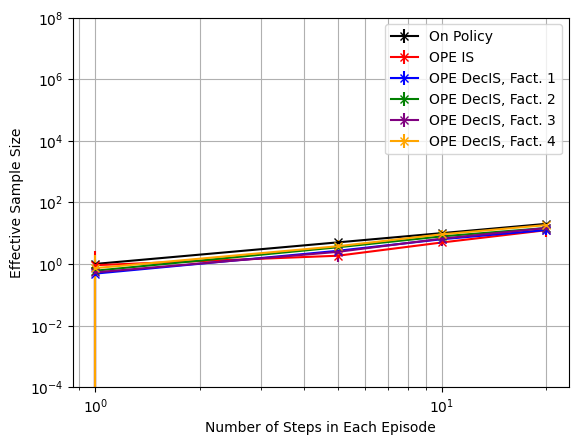

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='IS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDIS-----[ 0.91143099  1.84286099  4.96938287 12.45199458]
OPE DecPDIS, Fact. 1-----[ 0.6502489   3.46572815  7.96601439 15.44385412]
OPE DecPDIS, Fact. 2-----[ 0.5393017   2.45586038  6.11480188 12.76089785]
OPE DecPDIS, Fact. 3-----[ 0.46943151  2.05970408  5.77461005 14.07798184]
OPE DecPDIS, Fact. 4-----[ 0.75506073  3.41640949  8.89092014 18.44846594]


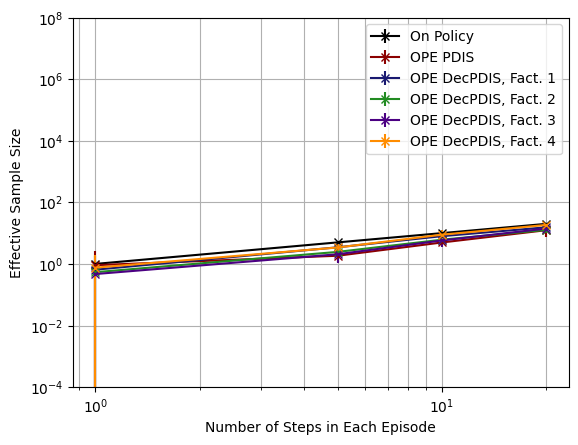

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='PDIS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDWIS-----[29913.73389642  2390.89776989 10158.83675615 45656.79087354]
OPE DecPDWIS, Fact. 1-----[40075.48162118 15471.32776791 22349.59377504 69074.92958075]
OPE DecPDWIS, Fact. 2-----[ 1918.28102775  2124.29834312  6626.35959133 20452.18919769]
OPE DecPDWIS, Fact. 3-----[ 2900.60943014  2490.32664895  6093.32488523 18958.03170323]
OPE DecPDWIS, Fact. 4-----[ 3904.05343025  3873.43094411 10590.26893227 31695.13453099]


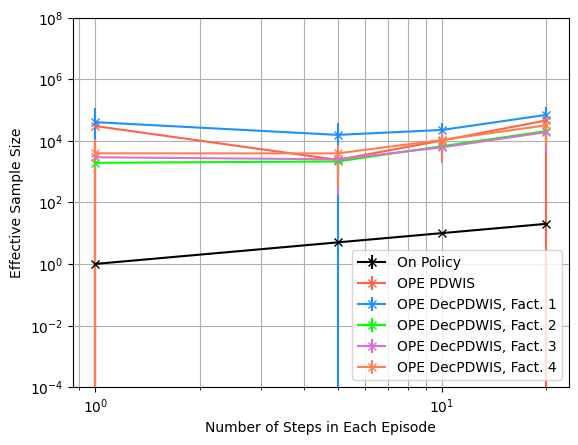

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

## From Patient State 136, Without Diabetes

In [ ]:
#The patient has no diabetes
PROB_DIAB = 0.0

### State Analysis

In [ ]:
#Instantiate a state based on the idx and get the state vector
testState = State(state_idx = 136, diabetic_idx=0)
vec = testState.get_state_vector()

print(f'Heart Rate: {hr_state_mapping[vec[0]]}')
print(f'Systolic Blood Pressure: {sbp_state_mapping[vec[1]]}')
print(f'Percent Oxygen: {o2_state_mapping[vec[2]]}')
print(f'Glucose Level: {glu_state_mapping[vec[3]]}')
print(f'Antibiotics: {abx_state_mapping[vec[4]]}')
print(f'Vasopressors: {vaso_state_mapping[vec[5]]}')
print(f'Ventilator: {vent_state_mapping[vec[6]]}')
print(f'Diabetes: {testState.diabetic_idx}')

Heart Rate: Low
Systolic Blood Pressure: Normal
Percent Oxygen: Normal
Glucose Level: Normal
Antibiotics: Off
Vasopressors: Off
Ventilator: Off
Diabetes: 0


### Generate Data From Behaviour Policy

Run the data generator

In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=randPol, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

Convert data into array format

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_b = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_b.shape

(100000, 20, 5)

In [ ]:
f_tr_b1, f_tr_b2, f_tr_b3, f_tr_b4 = factorise_dataset(nf_tr_b)

In [ ]:
print(nf_tr_b)

[[[  0. 136.   0.  -1. 168.]
  [  1. 168.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 136.   3.   0. 219.]
  [  1. 219.   5.   0. 222.]
  [  2. 222.   5.   0. 222.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 136.   7.   0. 223.]
  [  1. 223.   5.   0. 142.]
  [  2. 142.   0.   0. 136.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 ...

 [[  0. 136.   0.   0. 136.]
  [  1. 136.   2.   0. 377.]
  [  2. 377.   4.   0. 380.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 136.   6.   0. 141.]
  [  1. 141.   1.  -1. 178.]
  [  2. 178.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 136.   4.   0. 140.]
  [  1. 140.   2.   0. 137.]
  [  2. 137.   1.   0.  98

In [ ]:
print(f_tr_b1)

[[[[  0.  136.    0.   -0.5 168. ]
   [  0.  136.    0.   -0.5 168. ]]

  [[  1.  168.    1.    0.   -1. ]
   [  1.  168.   -1.    0.   -1. ]]

  [[  2.   -1.    1.    0.   -1. ]
   [  2.   -1.   -1.    0.   -1. ]]

  ...

  [[ 17.   -1.    1.    0.   -1. ]
   [ 17.   -1.   -1.    0.   -1. ]]

  [[ 18.   -1.    1.    0.   -1. ]
   [ 18.   -1.   -1.    0.   -1. ]]

  [[ 19.   -1.    1.    0.   -1. ]
   [ 19.   -1.   -1.    0.   -1. ]]]


 [[[  0.  136.    1.    0.  219. ]
   [  0.  136.    1.    0.  219. ]]

  [[  1.  219.    0.    0.  222. ]
   [  1.  219.    3.    0.  222. ]]

  [[  2.  222.    0.    0.  222. ]
   [  2.  222.    3.    0.  222. ]]

  ...

  [[ 17.   -1.    1.    0.   -1. ]
   [ 17.   -1.   -1.    0.   -1. ]]

  [[ 18.   -1.    1.    0.   -1. ]
   [ 18.   -1.   -1.    0.   -1. ]]

  [[ 19.   -1.    1.    0.   -1. ]
   [ 19.   -1.   -1.    0.   -1. ]]]


 [[[  0.  136.    1.    0.  223. ]
   [  0.  136.    3.    0.  223. ]]

  [[  1.  223.    0.    0.  142. ]
   [  1.  2

In [ ]:
factored_randPol1 = factor_policy_1(randPol)
factored_randPol2 = factor_policy_2(randPol)
factored_randPol3 = factor_policy_3(randPol)
factored_randPol4 = factor_policy_4(randPol)

In [ ]:
randPol = pad_policy(randPol)

factored_randPol1[0] = pad_policy(factored_randPol1[0])
factored_randPol1[1] = pad_policy(factored_randPol1[1])

factored_randPol2[0] = pad_policy(factored_randPol2[0])
factored_randPol2[1] = pad_policy(factored_randPol2[1])

factored_randPol3[0] = pad_policy(factored_randPol3[0])
factored_randPol3[1] = pad_policy(factored_randPol3[1])

factored_randPol4[0] = pad_policy(factored_randPol4[0])
factored_randPol4[1] = pad_policy(factored_randPol4[1])
factored_randPol4[2] = pad_policy(factored_randPol4[2])

### Varying Episodes $\epsilon_{e} = 0.4$ (Policy Divergence $4.8^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
EVAL_EPSILON = 0.4

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

4.8


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.3444504873366444. Variance of on policy Q estimate: 0.017400501610581997
Mean OPE IS estimate: -0.1256744857845178. Bias1: 0.21877600155212665. Bias2: 0.21877600155212662. Variance: 0.00692870376204521. MSE: 0.054791642617181335
Mean OPE PDIS estimate: -0.1256744857845178. Bias1: 0.21877600155212665. Bias2: 0.21877600155212662. Variance: 0.00692870376204521. MSE: 0.054791642617181335
Mean OPE PDWIS estimate: -0.022511473401940624. Bias1: 0.3219390139347038. Bias2: 0.3219390139347038. Variance: 0.00011467691746490105. MSE: 0.10375940561071431
Mean OPE DecIS: Fact. 1 estimate: -0.47217222630202543. Bias1: 0.12772173896538114. Bias2: 0.12772173896538103. Variance: 0.4988474133547044. MSE: 0.5151602559590454
Mean OPE DecPDIS: Fact. 1 estimate: -0.2958744554198892. Bias1: 0.048576031916754386. Bias2: 0.04857603191675519. Variance: 0.15209590538639378. MSE: 0.15445553626317132
Mean OPE DecPDWIS: Fact. 1 estimat

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.14009122 0.13243116 0.32517467 0.08917033 0.05070575]
OPE DecIS, Fact. 1-----[0.28748381 0.35374819 0.43374443 0.47120464 0.91585069]
OPE DecIS, Fact. 2-----[0.19999807 0.46421501 0.388125   0.26671653 0.31059566]
OPE DecIS, Fact. 3-----[0.20389463 0.14510382 0.12963226 0.09751984 0.11183897]
OPE DecIS, Fact. 4-----[0.4036074  0.644048   0.6166541  0.56940357 0.84422323]


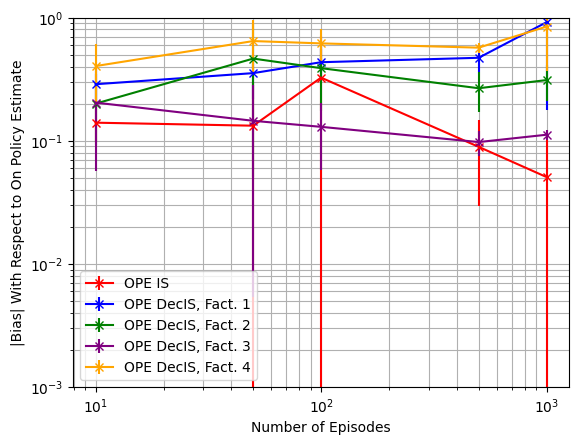

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**-3, 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.14009122 0.13243116 0.32517467 0.08917033 0.05070575]
OPE DecPDIS, Fact. 1-----[0.06994146 0.10759152 0.15073762 0.15349742 0.40835781]
OPE DecPDIS, Fact. 2-----[0.14329506 0.23330542 0.20619774 0.14495085 0.18913708]
OPE DecPDIS, Fact. 3-----[0.37380799 0.16763415 0.10903119 0.1126683  0.08936928]
OPE DecPDIS, Fact. 4-----[0.18581741 0.32600382 0.30669806 0.27642163 0.42492226]


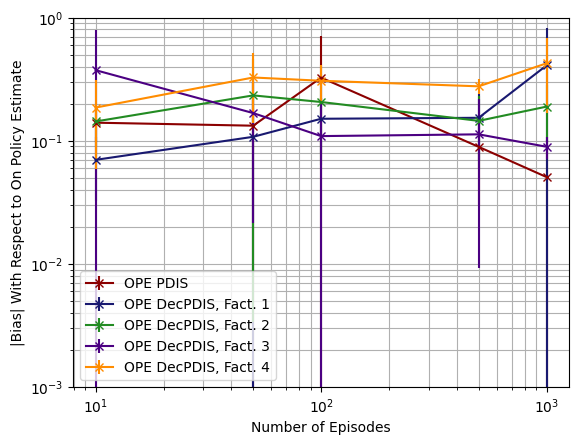

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.32710781 0.31246508 0.31215445 0.31459971 0.3181379 ]
OPE DecPDWIS, Fact. 1-----[0.3317697  0.31248425 0.31036732 0.3114118  0.31297547]
OPE DecPDWIS, Fact. 2-----[0.32874935 0.30994537 0.30898738 0.30965105 0.3119649 ]
OPE DecPDWIS, Fact. 3-----[0.32950046 0.31034358 0.30937648 0.31274671 0.31451393]
OPE DecPDWIS, Fact. 4-----[0.33018824 0.30981768 0.30795922 0.30884258 0.31044424]


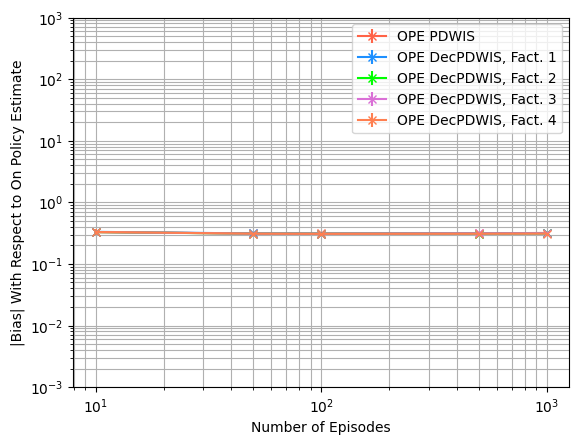

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.03777319 0.00993514 0.00433756 0.00087853 0.00040502]
OPE IS-----[0.27058778 1.15225562 5.42371073 0.49986452 0.18442529]
OPE DecIS, Fact. 1-----[ 0.72578963  0.31538351  0.32122599  0.33814675 15.01969445]
OPE DecIS, Fact. 2-----[1.18577091 5.55931414 1.5881965  0.13679347 0.17933615]
OPE DecIS, Fact. 3-----[0.97205168 0.27284949 0.09362569 0.13240081 0.04306602]
OPE DecIS, Fact. 4-----[0.83522842 2.49958478 0.78169733 0.11406265 6.63258273]


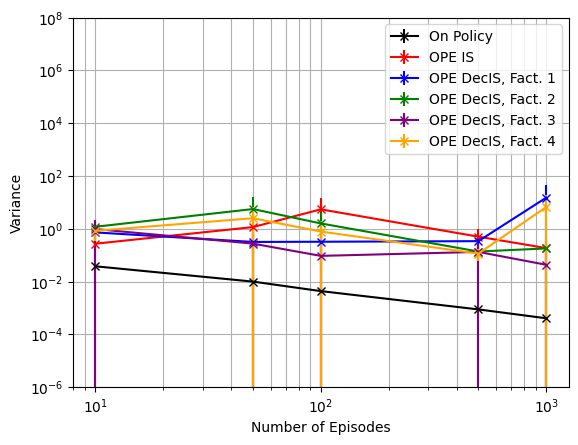

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-6), 10**8, shorter_D, estimator='IS')

On Policy-----[0.03777319 0.00993514 0.00433756 0.00087853 0.00040502]
OPE PDIS-----[0.27058778 1.15225562 5.42371073 0.49986452 0.18442529]
OPE DecPDIS, Fact. 1-----[0.43518333 0.23304815 0.14265663 0.20934862 4.53495319]
OPE DecPDIS, Fact. 2-----[0.41927097 1.73482115 0.54994808 0.09363935 0.15426764]
OPE DecPDIS, Fact. 3-----[5.62100917 0.50553151 0.14091268 0.65495204 0.18100814]
OPE DecPDIS, Fact. 4-----[0.28575785 0.80689334 0.25680558 0.0542516  1.9914056 ]


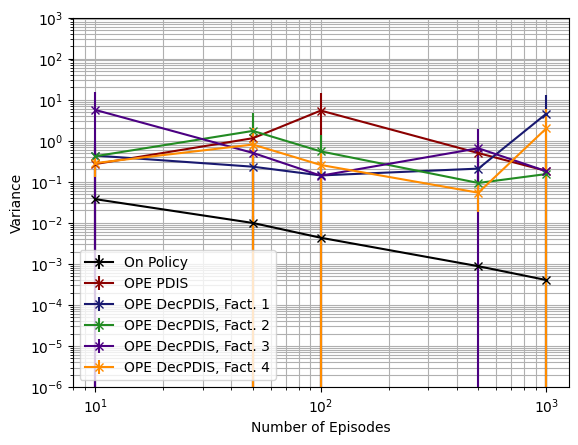

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**3, shorter_D, estimator='PDIS')

On Policy-----[0.03777319 0.00993514 0.00433756 0.00087853 0.00040502]
OPE PDWIS-----[0.00016738 0.00021959 0.00029976 0.00023335 0.00021035]
OPE DecPDWIS, Fact. 1-----[2.10721435e-04 8.10438052e-05 4.72349583e-05 6.81507163e-05
 1.08187166e-04]
OPE DecPDWIS, Fact. 2-----[1.88115982e-04 9.24521973e-05 1.09165955e-04 7.23363368e-05
 5.22836809e-05]
OPE DecPDWIS, Fact. 3-----[2.05979960e-04 1.44461956e-04 8.53495387e-05 1.04220962e-04
 7.61023271e-05]
OPE DecPDWIS, Fact. 4-----[1.46233196e-04 5.08508126e-05 3.52239856e-05 2.16998714e-05
 3.64442501e-05]


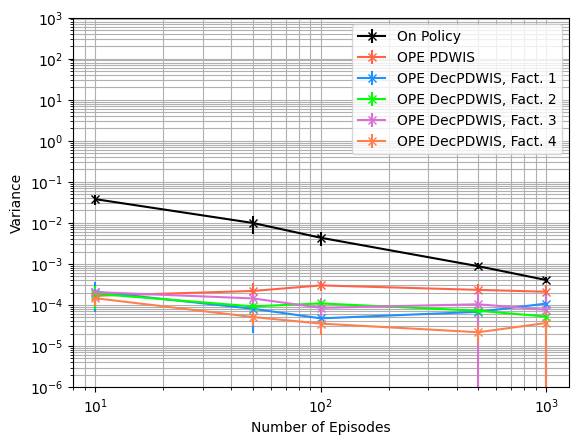

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.03777319 0.00993514 0.00433756 0.00087853 0.00040502]
OPE IS-----[0.2920883  1.19705002 5.68090725 0.51135383 0.18958148]
OPE DecIS, Fact. 1-----[ 0.81878381  0.45894447  0.52295133  0.57243298 16.40395562]
OPE DecIS, Fact. 2-----[1.23745167 5.94594025 1.78417734 0.21700624 0.285559  ]
OPE DecIS, Fact. 3-----[1.03514093 0.31342019 0.1156028  0.14243568 0.05568336]
OPE DecIS, Fact. 4-----[1.04136436 3.00620742 1.19584294 0.44081179 7.57324241]


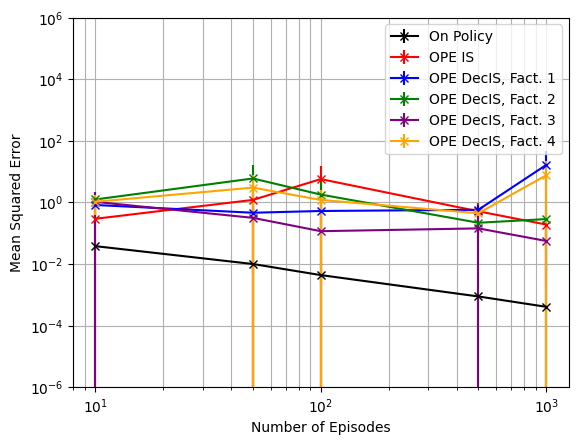

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='IS')

On Policy-----[0.03777319 0.00993514 0.00433756 0.00087853 0.00040502]
OPE PDIS-----[0.2920883  1.19705002 5.68090725 0.51135383 0.18958148]
OPE DecPDIS, Fact. 1-----[0.44150131 0.25974756 0.17037708 0.24001995 4.87021152]
OPE DecPDIS, Fact. 2-----[0.44265492 1.84211746 0.61279525 0.12207558 0.19848783]
OPE DecPDIS, Fact. 3-----[5.9331537  0.55497432 0.16547371 0.67834197 0.18934693]
OPE DecPDIS, Fact. 4-----[0.3365082  0.94800519 0.36113614 0.13208877 2.23881692]


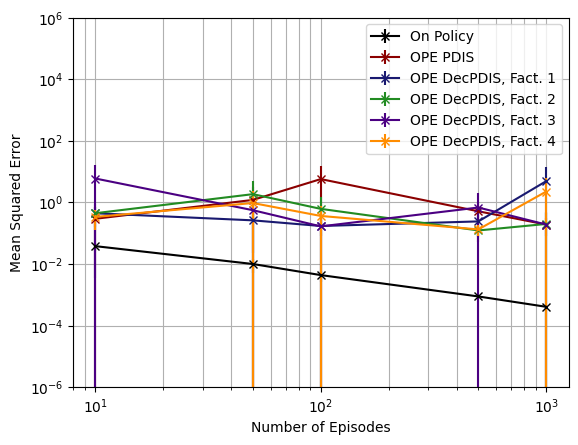

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='PDIS')

On Policy-----[0.03777319 0.00993514 0.00433756 0.00087853 0.00040502]
OPE PDWIS-----[0.10827701 0.09800957 0.09787313 0.09928743 0.1014535 ]
OPE DecPDWIS, Fact. 1-----[0.11165581 0.09794622 0.09648448 0.0971     0.0980794 ]
OPE DecPDWIS, Fact. 2-----[0.10933109 0.09634234 0.09570893 0.09602742 0.09740489]
OPE DecPDWIS, Fact. 3-----[0.10987765 0.09662895 0.09587954 0.09799361 0.09900827]
OPE DecPDWIS, Fact. 4-----[0.11038339 0.09623874 0.094968   0.09547056 0.09644137]


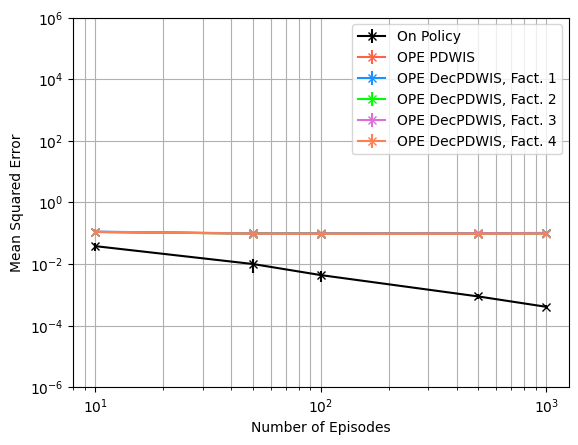

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[10.22161738  2.72216496  1.34017638  2.99450631  3.68551625]
OPE DecIS, Fact. 1-----[0.54598963 2.34994916 2.4329229  2.45233219 4.35700053]
OPE DecIS, Fact. 2-----[1.18973699 0.82952822 1.32930057 4.17649425 7.11629121]
OPE DecIS, Fact. 3-----[ 2.83954301  5.45391938  9.17010954 20.82194705 27.20767208]
OPE DecIS, Fact. 4-----[0.59286187 2.33940029 3.12021368 4.71099946 5.98754738]


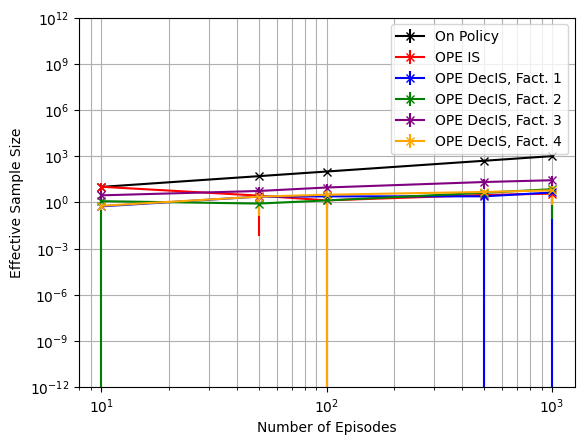

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-12), 10**12, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[10.22161738  2.72216496  1.34017638  2.99450631  3.68551625]
OPE DecPDIS, Fact. 1-----[1.38183367 3.93309289 4.08464579 5.42900385 8.31397218]
OPE DecPDIS, Fact. 2-----[2.04092507 1.59322743 3.07969722 5.85887352 8.00090954]
OPE DecPDIS, Fact. 3-----[ 3.24091191  5.27060502 12.00061465 22.0632224  24.845578  ]
OPE DecPDIS, Fact. 4-----[ 1.66298944  4.9857186   7.89511526 11.13008771 14.46994704]


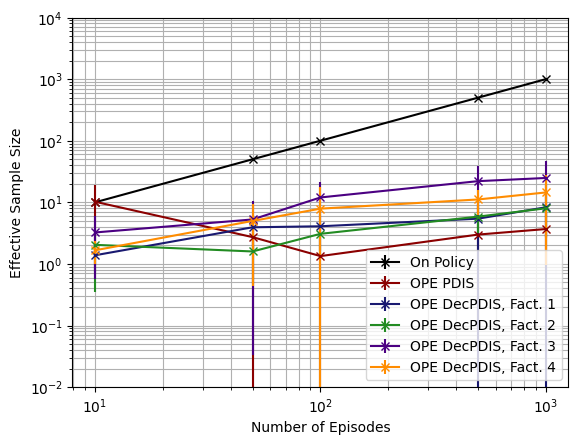

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-2), 10**4, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[2215.91420934 2837.4689667  1572.25666231 2303.64620653 2695.94411615]
OPE DecPDWIS, Fact. 1-----[ 2427.2083502   8662.79753977 10318.64888489  9863.76013533
  7480.29749996]
OPE DecPDWIS, Fact. 2-----[2636.56754957 5451.11391549 4964.16405624 6809.10990648 9594.15446705]
OPE DecPDWIS, Fact. 3-----[ 1847.0016991   3470.66606457  6900.37331752 11543.24922287
 14000.12351693]
OPE DecPDWIS, Fact. 4-----[ 2804.78615421 11925.29208203 18679.03242734 26558.09094978
 39299.18326922]


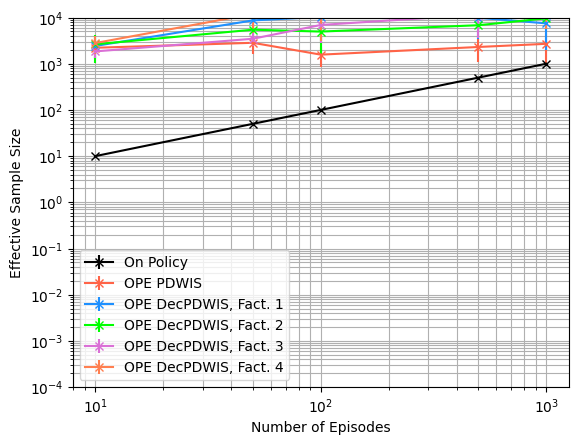

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(4), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.6$ (Policy Divergence $3.2^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc

gc.collect()
EVAL_EPSILON = 0.6

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

3.2


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.6569218907978842. Variance of on policy Q estimate: 0.02952480986754687
Mean OPE IS estimate: -0.36837530868854274. Bias1: 0.28854658210934153. Bias2: 0.2885465821093415. Variance: 0.02835268679603902. MSE: 0.11161181684302197
Mean OPE PDIS estimate: -0.36837530868854274. Bias1: 0.28854658210934153. Bias2: 0.2885465821093415. Variance: 0.02835268679603902. MSE: 0.11161181684302197
Mean OPE PDWIS estimate: -0.031441057126942326. Bias1: 0.6254808336709419. Bias2: 0.6254808336709419. Variance: 9.148144653016094e-05. MSE: 0.39131775473622665
Mean OPE DecIS: Fact. 1 estimate: -0.5949109187100599. Bias1: 0.06201097208782457. Bias2: 0.062010972087824356. Variance: 0.12548543161053277. MSE: 0.12933079226980973
Mean OPE DecPDIS: Fact. 1 estimate: -0.4354944198314253. Bias1: 0.22142747096645882. Bias2: 0.22142747096645893. Variance: 0.054892724488026436. MSE: 0.1039228493866284
Mean OPE DecPDWIS: Fact. 1 estimate: 

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.11760883 0.05784879 0.14054429 0.04178738 0.02276881]
OPE DecIS, Fact. 1-----[0.26094435 0.26908808 0.29054694 0.30596282 0.37690016]
OPE DecIS, Fact. 2-----[0.18497184 0.16254008 0.13355945 0.08231064 0.09029041]
OPE DecIS, Fact. 3-----[0.29175085 0.08817545 0.06953941 0.03525918 0.0434073 ]
OPE DecIS, Fact. 4-----[0.2790805  0.32510597 0.31574622 0.3001766  0.33416976]


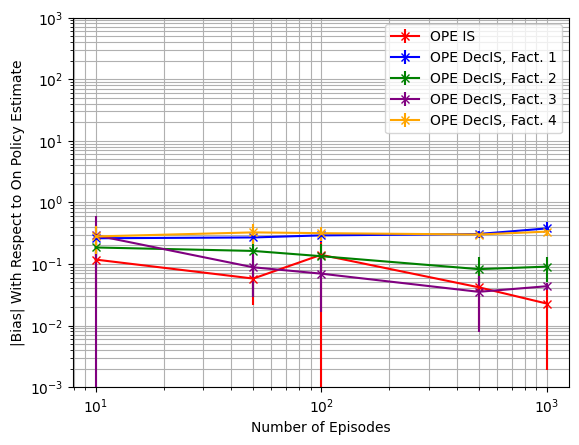

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='IS')

OPE PDIS-----[0.11760883 0.05784879 0.14054429 0.04178738 0.02276881]
OPE DecPDIS, Fact. 1-----[0.10780746 0.04490029 0.05318281 0.04618111 0.093586  ]
OPE DecPDIS, Fact. 2-----[0.18317971 0.0839072  0.07251247 0.04914446 0.04717936]
OPE DecPDIS, Fact. 3-----[0.45942407 0.11119405 0.06823404 0.02287385 0.01626524]
OPE DecPDIS, Fact. 4-----[0.14274332 0.11730626 0.11134006 0.09601223 0.11655295]


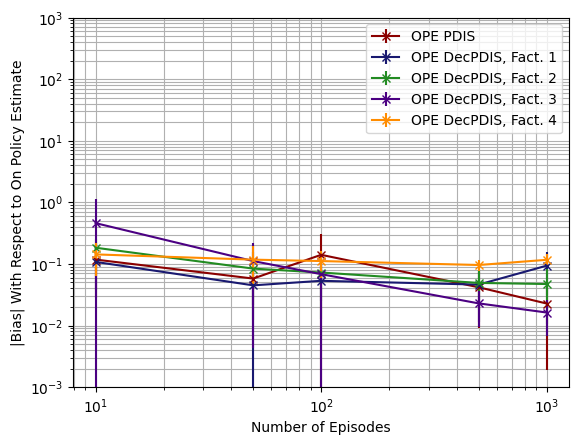

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.55730586 0.55836756 0.55516467 0.551167   0.55244844]
OPE DecPDWIS, Fact. 1-----[0.56236589 0.56042137 0.55632726 0.55221568 0.55249118]
OPE DecPDWIS, Fact. 2-----[0.55842016 0.55732774 0.55413451 0.54930723 0.55016946]
OPE DecPDWIS, Fact. 3-----[0.56026004 0.55809202 0.55432797 0.55078283 0.55134694]
OPE DecPDWIS, Fact. 4-----[0.56100259 0.55876803 0.55469097 0.54988847 0.55037593]


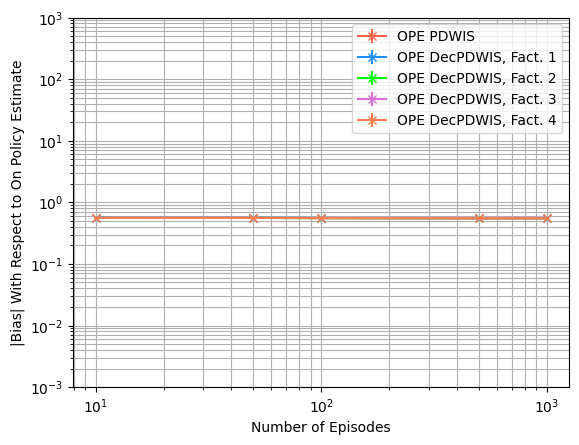

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.03276492 0.00656148 0.00391529 0.00062524 0.00031672]
OPE IS-----[0.21380663 0.22383404 1.07805343 0.0979624  0.0363696 ]
OPE DecIS, Fact. 1-----[0.62302818 0.15859404 0.09966822 0.0469029  0.33178124]
OPE DecIS, Fact. 2-----[0.72177367 0.94493942 0.34110152 0.03768146 0.02019173]
OPE DecIS, Fact. 3-----[3.57641855 0.28861957 0.09038767 0.02696532 0.01165342]
OPE DecIS, Fact. 4-----[0.50623063 0.44777175 0.15142252 0.02500382 0.14649547]


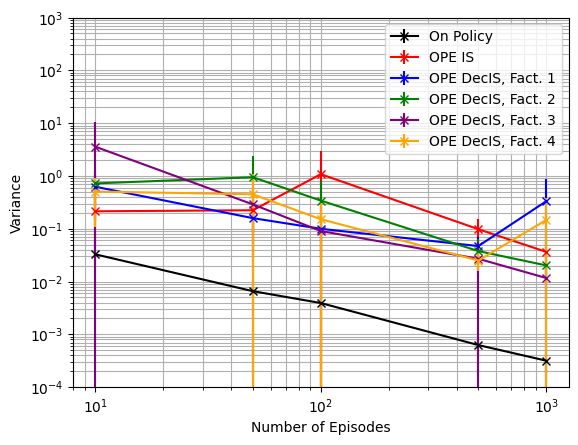

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**3, shorter_D, estimator='IS')

On Policy-----[0.03276492 0.00656148 0.00391529 0.00062524 0.00031672]
OPE PDIS-----[0.21380663 0.22383404 1.07805343 0.0979624  0.0363696 ]
OPE DecPDIS, Fact. 1-----[0.33340162 0.12000896 0.05551481 0.02735522 0.12687996]
OPE DecPDIS, Fact. 2-----[0.40956731 0.38363737 0.17495003 0.03268583 0.01785503]
OPE DecPDIS, Fact. 3-----[12.86484642  0.69548151  0.18237513  0.03492037  0.01670311]
OPE DecPDIS, Fact. 4-----[0.24281458 0.19087935 0.06607328 0.01435216 0.05526708]


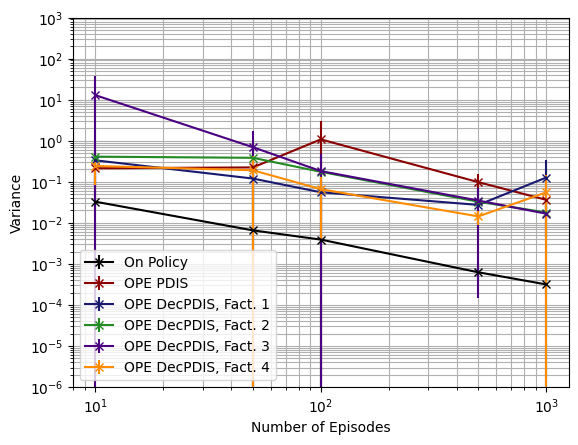

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**3, shorter_D, estimator='PDIS')

On Policy-----[0.03276492 0.00656148 0.00391529 0.00062524 0.00031672]
OPE PDWIS-----[1.50018312e-04 1.39947420e-04 1.55691612e-04 1.04973876e-04
 6.44911782e-05]
OPE DecPDWIS, Fact. 1-----[1.20199092e-04 4.63998250e-05 2.73303343e-05 2.65722948e-05
 3.90072881e-05]
OPE DecPDWIS, Fact. 2-----[1.68553974e-04 8.10734380e-05 7.30364459e-05 3.67133170e-05
 2.60232089e-05]
OPE DecPDWIS, Fact. 3-----[1.86935391e-04 1.05486169e-04 6.59631801e-05 3.45835362e-05
 1.95462372e-05]
OPE DecPDWIS, Fact. 4-----[1.09157477e-04 3.69313295e-05 2.16430630e-05 1.03546157e-05
 1.40926789e-05]


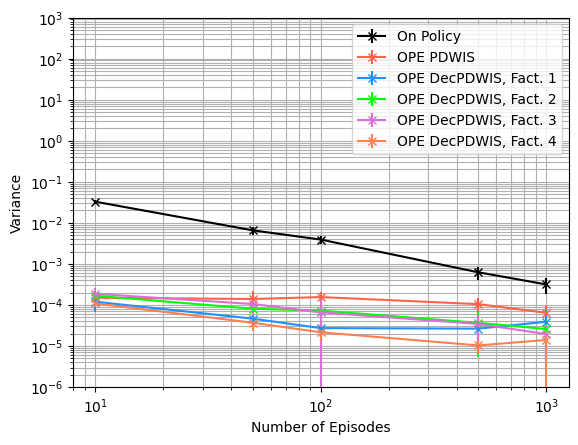

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.03276492 0.00656148 0.00391529 0.00062524 0.00031672]
OPE IS-----[0.23563215 0.22848035 1.12591249 0.10078253 0.03732382]
OPE DecIS, Fact. 1-----[0.71421594 0.23367438 0.18791591 0.14225551 0.48339871]
OPE DecIS, Fact. 2-----[0.75844416 0.98905199 0.36494375 0.04681335 0.02988725]
OPE DecIS, Fact. 3-----[3.75125337 0.2998306  0.09803747 0.02895231 0.01357634]
OPE DecIS, Fact. 4-----[0.60279257 0.56606018 0.25782909 0.11554899 0.2605754 ]


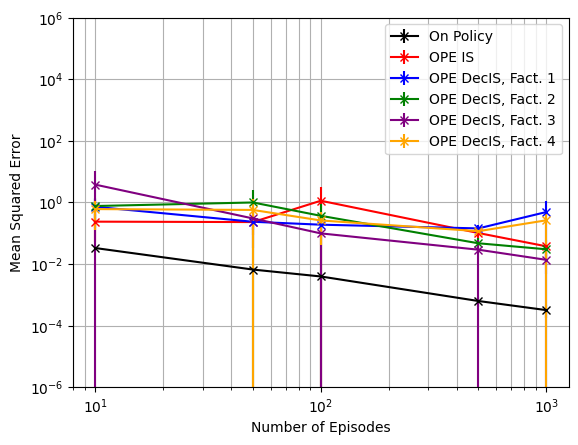

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='IS')

On Policy-----[0.03276492 0.00656148 0.00391529 0.00062524 0.00031672]
OPE PDIS-----[0.23563215 0.22848035 1.12591249 0.10078253 0.03732382]
OPE DecPDIS, Fact. 1-----[0.34985615 0.1239621  0.0591482  0.0306871  0.13956994]
OPE DecPDIS, Fact. 2-----[0.4482113  0.3958349  0.18380191 0.03609436 0.02143133]
OPE DecPDIS, Fact. 3-----[13.50360083  0.71926106  0.19453777  0.03562536  0.01705725]
OPE DecPDIS, Fact. 4-----[0.26926314 0.21032635 0.08123549 0.02395628 0.06960362]


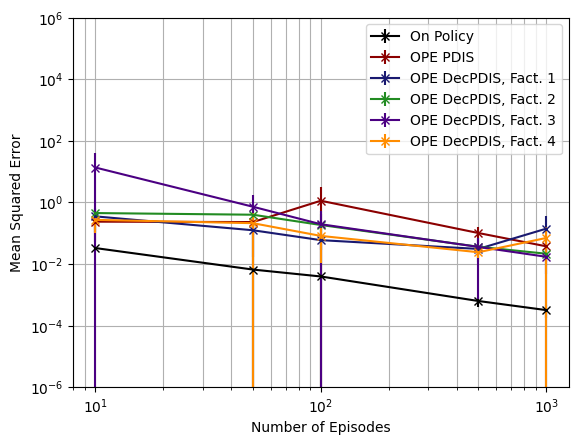

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='PDIS')

On Policy-----[0.03276492 0.00656148 0.00391529 0.00062524 0.00031672]
OPE PDWIS-----[0.31284807 0.31211887 0.30852795 0.30390605 0.30526716]
OPE DecPDWIS, Fact. 1-----[0.31863589 0.31429976 0.30970647 0.30499982 0.30529008]
OPE DecPDWIS, Fact. 2-----[0.31410757 0.31087105 0.30729063 0.30179794 0.30271747]
OPE DecPDWIS, Fact. 3-----[0.3163701  0.31172809 0.30751548 0.30341402 0.30400862]
OPE DecPDWIS, Fact. 4-----[0.31708423 0.3124352  0.30788541 0.30241273 0.30293378]


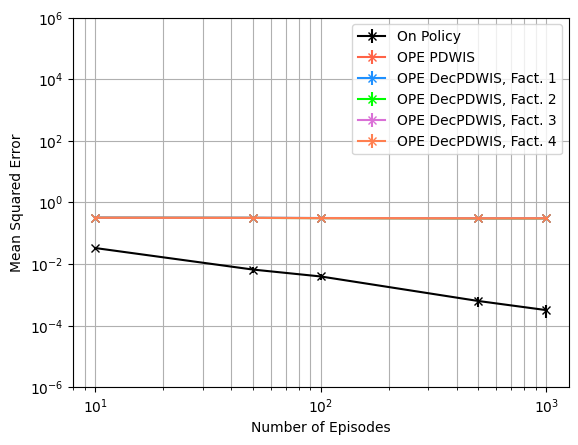

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[ 3.72809011  3.10702544  3.19543597  3.76533285 10.29934932]
OPE DecIS, Fact. 1-----[ 1.14924197  2.50455313  5.97957014  9.67203524 18.43241801]
OPE DecIS, Fact. 2-----[ 0.90189913  1.63967733  3.62760532 12.09615186 25.70818046]
OPE DecIS, Fact. 3-----[ 2.04999487  2.19280402  7.33679282 26.16402569 40.81961767]
OPE DecIS, Fact. 4-----[ 1.14989737  3.13987079  7.34165857 15.96479683 26.50409008]


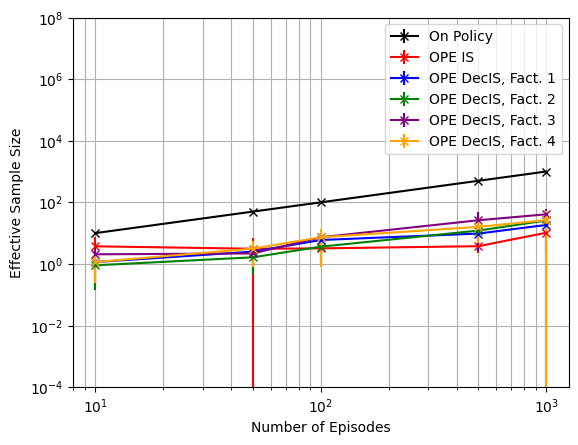

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[ 3.72809011  3.10702544  3.19543597  3.76533285 10.29934932]
OPE DecPDIS, Fact. 1-----[ 2.25937089  4.34960669  9.40458889 15.7546921  32.41261651]
OPE DecPDIS, Fact. 2-----[ 1.46251171  2.4698852   6.39296683 15.37347578 24.02362693]
OPE DecPDIS, Fact. 3-----[ 2.11260025  3.04259194 10.77304378 20.84984213 33.60156032]
OPE DecPDIS, Fact. 4-----[ 2.1351111   5.29893425 14.1964537  28.74168964 47.27688317]


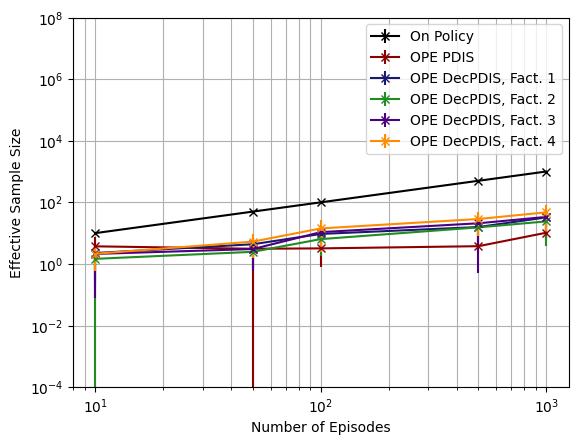

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[2527.48411591 3499.69829465 3119.65521331 3438.20606173 5503.52729929]
OPE DecPDWIS, Fact. 1-----[ 3149.03096421  7361.17231842 14917.84610419 18641.42581974
 25610.36279332]
OPE DecPDWIS, Fact. 2-----[ 2313.26819288  4441.60079794  6041.09193117 13760.70740426
 15850.22016268]
OPE DecPDWIS, Fact. 3-----[ 1993.03955531  3567.81912678 10182.7189565  12213.53634104
 21103.50041205]
OPE DecPDWIS, Fact. 4-----[ 3068.70551907  9898.02355928 22669.87449639 41608.91088625
 63570.56580426]


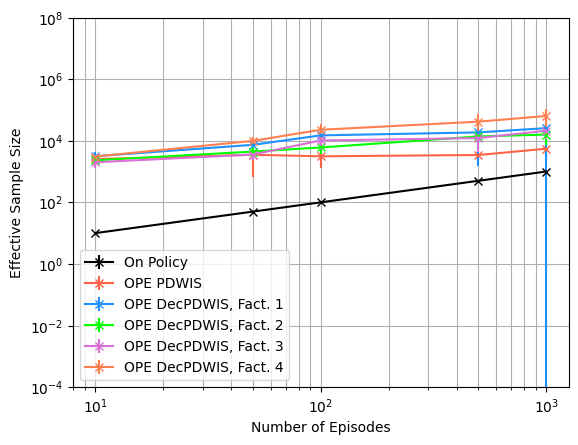

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{20}$)



Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc
gc.collect()
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.7270254865264666. Variance of on policy Q estimate: 0.020202163553442225
Mean OPE IS estimate: -0.6931728604669243. Bias1: 0.03385262605954237. Bias2: 0.03385262605954231. Variance: 0.022219830306937617. MSE: 0.023365830598064824
Mean OPE PDIS estimate: -0.6931728604669243. Bias1: 0.03385262605954237. Bias2: 0.03385262605954231. Variance: 0.022219830306937617. MSE: 0.023365830598064824
Mean OPE PDWIS estimate: -0.03795492868574648. Bias1: 0.6890705578407202. Bias2: 0.6890705578407201. Variance: 5.350655070889503e-05. MSE: 0.4748717402336302
Mean OPE DecIS: Fact. 1 estimate: -0.8166747627002706. Bias1: 0.08964927617380396. Bias2: 0.08964927617380403. Variance: 0.021539275563593478. MSE: 0.029576268282080452
Mean OPE DecPDIS: Fact. 1 estimate: -0.7160866443734115. Bias1: 0.010938842153054996. Bias2: 0.010938842153055073. Variance: 0.017632237436476662. MSE: 0.017751895704126115
Mean OPE DecPDWIS: Fact. 1 es

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.07459182 0.01856385 0.01799461 0.01005194 0.00510109]
OPE DecIS, Fact. 1-----[0.09600189 0.11691597 0.11988596 0.10971121 0.11730459]
OPE DecIS, Fact. 2-----[0.0848361  0.02237632 0.02350236 0.02660161 0.02067884]
OPE DecIS, Fact. 3-----[0.07701916 0.02405382 0.02015389 0.00719523 0.00806822]
OPE DecIS, Fact. 4-----[0.07002178 0.06604457 0.07139297 0.06025669 0.06544709]


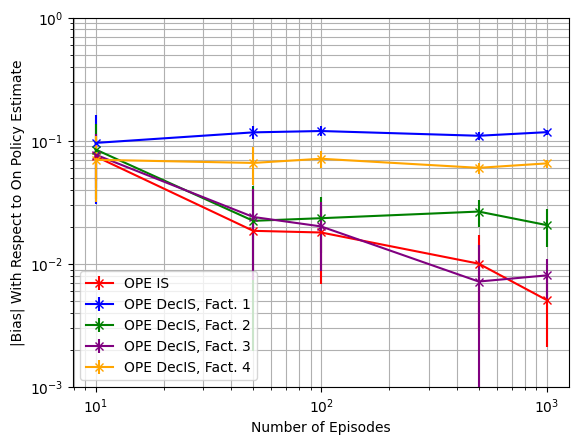

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.07459182 0.01856385 0.01799461 0.01005194 0.00510109]
OPE DecPDIS, Fact. 1-----[0.0545814  0.01308827 0.0111242  0.00637115 0.00692641]
OPE DecPDIS, Fact. 2-----[0.08345908 0.01765594 0.01638503 0.00766275 0.00541609]
OPE DecPDIS, Fact. 3-----[0.07820228 0.01958035 0.0121808  0.01565195 0.00832966]
OPE DecPDIS, Fact. 4-----[0.06609188 0.01808322 0.01374499 0.00543789 0.00595389]


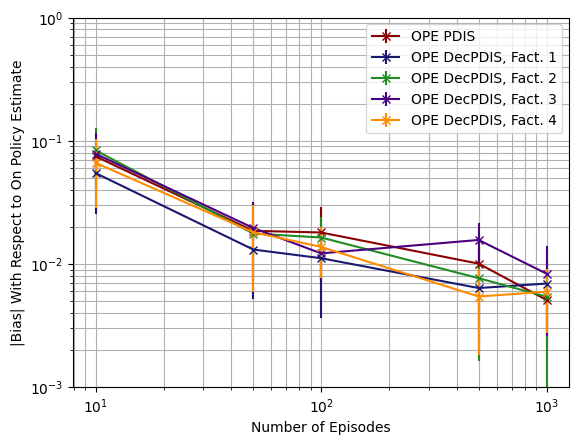

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.72256999 0.7133439  0.70877352 0.71371871 0.70992657]
OPE DecPDWIS, Fact. 1-----[0.72502484 0.71559991 0.71077038 0.71574999 0.71194117]
OPE DecPDWIS, Fact. 2-----[0.72221261 0.71298767 0.70837507 0.71313488 0.70932747]
OPE DecPDWIS, Fact. 3-----[0.72366634 0.71398248 0.70922937 0.71428959 0.71054592]
OPE DecPDWIS, Fact. 4-----[0.72407626 0.71457125 0.70971841 0.71459192 0.71082155]


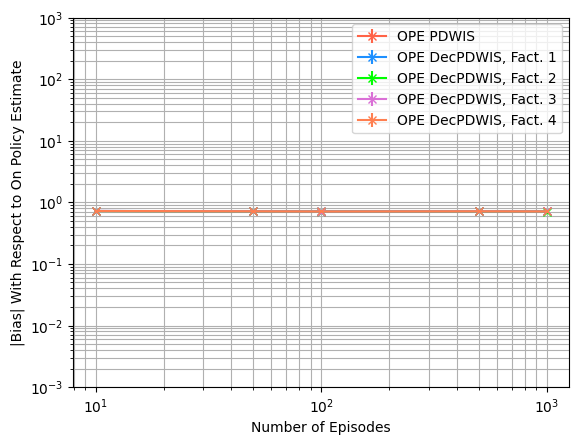

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.01606314 0.00410561 0.00213808 0.00040538 0.00019348]
OPE IS-----[0.03340013 0.00906076 0.00444966 0.00099364 0.00050368]
OPE DecIS, Fact. 1-----[0.04400441 0.00896644 0.00410348 0.00084993 0.00042822]
OPE DecIS, Fact. 2-----[0.04246274 0.0091892  0.00516687 0.00083783 0.00041845]
OPE DecIS, Fact. 3-----[0.04698822 0.01123652 0.00536384 0.00088675 0.00048402]
OPE DecIS, Fact. 4-----[0.03672018 0.00785829 0.00416819 0.00068998 0.00035585]


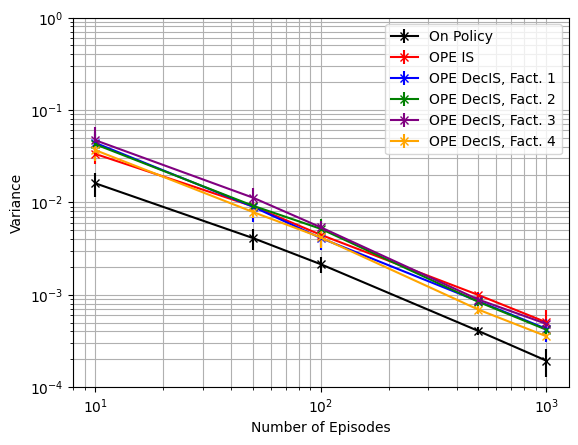

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

On Policy-----[0.01606314 0.00410561 0.00213808 0.00040538 0.00019348]
OPE PDIS-----[0.03340013 0.00906076 0.00444966 0.00099364 0.00050368]
OPE DecPDIS, Fact. 1-----[0.03558416 0.00720574 0.00326225 0.00070279 0.00035055]
OPE DecPDIS, Fact. 2-----[0.04268562 0.00864751 0.00450767 0.00084948 0.00042216]
OPE DecPDIS, Fact. 3-----[0.05479408 0.0115031  0.00516101 0.00088953 0.0004717 ]
OPE DecPDIS, Fact. 4-----[0.03421146 0.00704005 0.0034949  0.00064263 0.00033061]


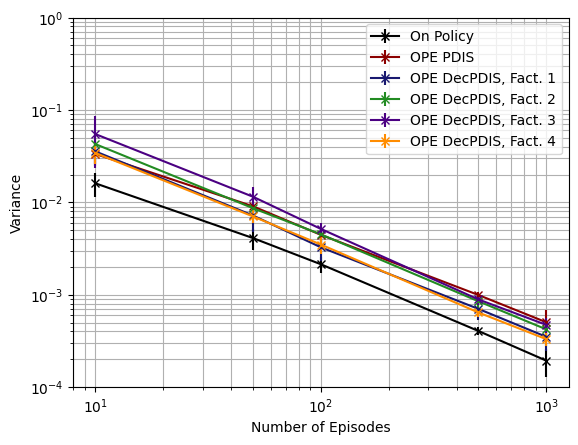

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.01606314 0.00410561 0.00213808 0.00040538 0.00019348]
OPE PDWIS-----[6.59564735e-05 1.47576247e-05 7.23447604e-06 1.79004399e-06
 1.03844442e-06]
OPE DecPDWIS, Fact. 1-----[5.03629703e-05 9.64247034e-06 4.38350451e-06 9.47925776e-07
 5.39309011e-07]
OPE DecPDWIS, Fact. 2-----[7.94833380e-05 1.36148822e-05 7.49292062e-06 1.59651442e-06
 9.30017332e-07]
OPE DecPDWIS, Fact. 3-----[8.18367657e-05 1.53061912e-05 6.94116452e-06 1.64816350e-06
 9.58897692e-07]
OPE DecPDWIS, Fact. 4-----[6.20358875e-05 9.49158601e-06 4.79952810e-06 9.93860772e-07
 6.29808519e-07]


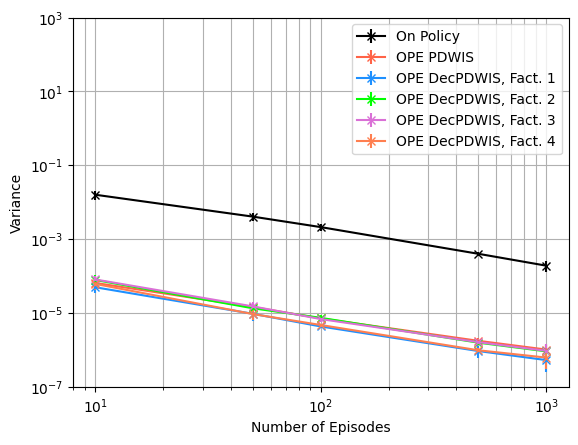

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.01606314 0.00410561 0.00213808 0.00040538 0.00019348]
OPE IS-----[0.03973322 0.00941386 0.004897   0.00114654 0.00053858]
OPE DecIS, Fact. 1-----[0.05752729 0.02284008 0.01859647 0.01294224 0.0142223 ]
OPE DecIS, Fact. 2-----[0.05227318 0.01010637 0.00584649 0.00158855 0.00089581]
OPE DecIS, Fact. 3-----[0.05418206 0.01209414 0.00590092 0.00098723 0.00055746]
OPE DecIS, Fact. 4-----[0.0430895  0.01271156 0.0093997  0.00435797 0.00466372]


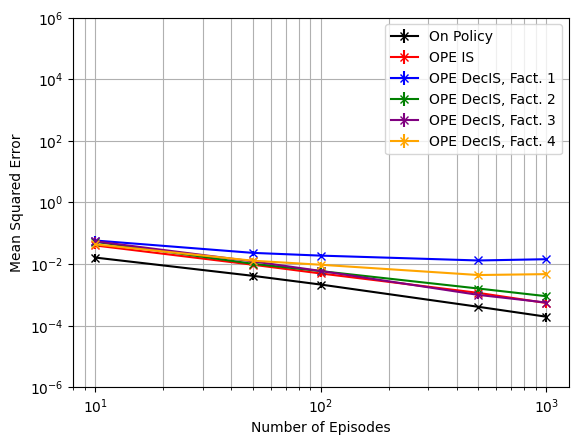

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='IS')

On Policy-----[0.01606314 0.00410561 0.00213808 0.00040538 0.00019348]
OPE PDIS-----[0.03973322 0.00941386 0.004897   0.00114654 0.00053858]
OPE DecPDIS, Fact. 1-----[0.03940361 0.00744015 0.00344196 0.0007636  0.00041361]
OPE DecPDIS, Fact. 2-----[0.05144745 0.00902341 0.00483699 0.00094456 0.00047449]
OPE DecPDIS, Fact. 3-----[0.06238431 0.01203363 0.00533185 0.00116727 0.00057403]
OPE DecPDIS, Fact. 4-----[0.03999989 0.00751621 0.00372127 0.00068531 0.00037629]


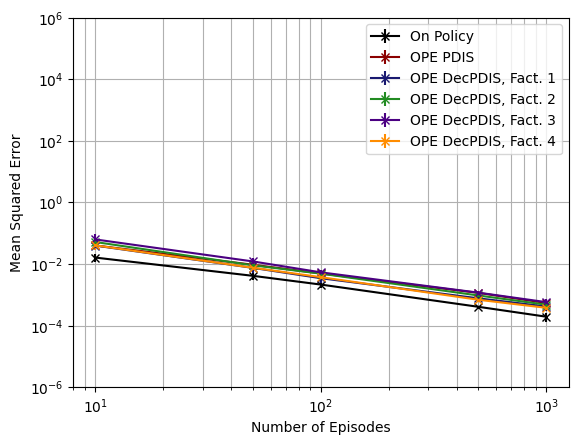

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='PDIS')

On Policy-----[0.01606314 0.00410561 0.00213808 0.00040538 0.00019348]
OPE PDWIS-----[0.52330404 0.50895032 0.50246942 0.50940673 0.50400526]
OPE DecPDWIS, Fact. 1-----[0.52681343 0.51217083 0.50529992 0.51230999 0.50686925]
OPE DecPDWIS, Fact. 2-----[0.5228252  0.50844006 0.5019048  0.50857307 0.50315491]
OPE DecPDWIS, Fact. 3-----[0.52488362 0.50986589 0.50311375 0.51022176 0.50488461]
OPE DecPDWIS, Fact. 4-----[0.5254689  0.51070017 0.50380642 0.51065307 0.50527611]


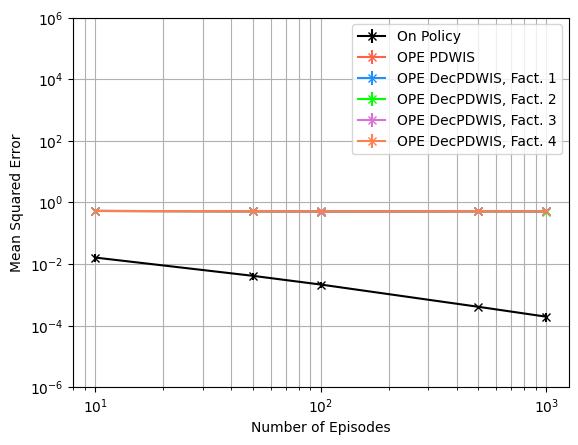

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[  5.10433867  22.58067059  49.22835207 205.20356728 394.8124882 ]
OPE DecIS, Fact. 1-----[  4.31784113  24.37527028  53.57103597 247.46407304 452.21724274]
OPE DecIS, Fact. 2-----[  4.51049653  22.48077374  44.16120301 256.0665179  483.90591389]
OPE DecIS, Fact. 3-----[  4.00115383  18.56506777  40.90162581 234.43231489 403.76884928]
OPE DecIS, Fact. 4-----[  4.88081668  26.82394628  52.29705546 298.85619505 550.87165626]


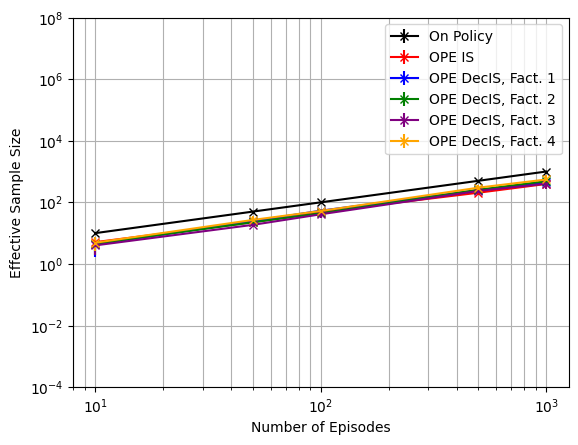

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[  5.10433867  22.58067059  49.22835207 205.20356728 394.8124882 ]
OPE DecPDIS, Fact. 1-----[  5.28605703  30.33490736  67.91926412 303.52777143 558.10594462]
OPE DecPDIS, Fact. 2-----[  4.47575088  24.31298187  48.97876352 253.48629814 474.61455092]
OPE DecPDIS, Fact. 3-----[  3.952374    18.57710346  42.63974496 234.34033756 417.29861606]
OPE DecPDIS, Fact. 4-----[  5.28794536  29.75588869  61.84225052 321.57708486 587.60101249]


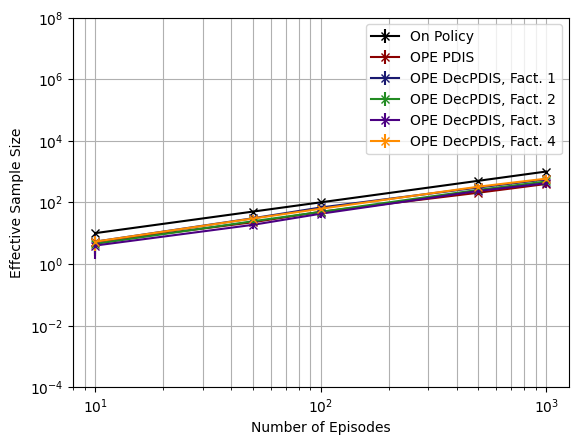

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[  2904.71956943  14083.69913602  29942.70126422 116863.65513712
 194679.22496398]
OPE DecPDWIS, Fact. 1-----[  3632.72099036  22949.27048463  48614.62413494 240558.93541205
 390996.53993138]
OPE DecPDWIS, Fact. 2-----[  2481.84768357  15129.19143981  29664.89750725 128256.18399608
 237904.54873811]
OPE DecPDWIS, Fact. 3-----[  2193.33939312  14647.61313285  32377.81105021 125753.27562553
 226113.07814367]
OPE DecPDWIS, Fact. 4-----[  3018.16199585  23747.03468893  44489.40557649 206558.68534466
 335311.20385878]


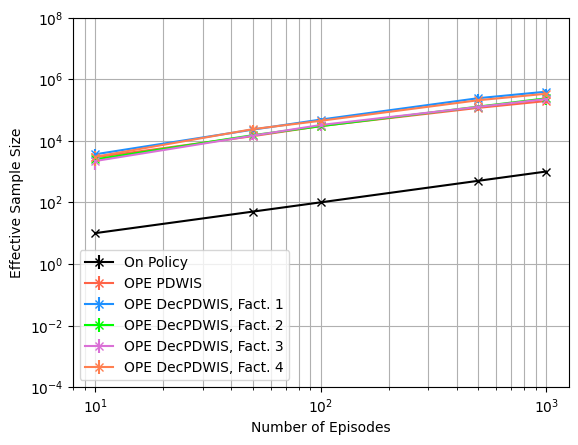

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

### Varying Episode Length $T$ With $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{T}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
LENGTHS = [1, 5, 10, 20]

bias_means = np.zeros((len(LENGTHS), 16))
bias_stds = np.zeros((len(LENGTHS), 16))
var_means = np.zeros((len(LENGTHS), 16))
var_stds = np.zeros((len(LENGTHS), 16))
MSE_means = np.zeros((len(LENGTHS), 16))
MSE_stds = np.zeros((len(LENGTHS), 16))
ESS_means = np.zeros((len(LENGTHS), 16))
ESS_stds = np.zeros((len(LENGTHS), 16))

RUNS = 20

for id in range(len(LENGTHS)):
  e = LENGTHS[id]
  print(f'{e} Steps, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

1 Steps, 20 ----------------------------------

Mean on policy Q estimate: -0.7452520701831644. Variance of on policy Q estimate: 0.2224486976938398
Mean OPE IS estimate: -0.8518563042807626. Bias1: 0.10660423409759784. Bias2: 0.10660423409759823. Variance: 0.19345058119734768. MSE: 0.20481504392488312
Mean OPE PDIS estimate: -0.8518563042807626. Bias1: 0.10660423409759784. Bias2: 0.10660423409759823. Variance: 0.19345058119734768. MSE: 0.20481504392488312
Mean OPE PDWIS estimate: -0.04350417047981152. Bias1: 0.7017478997033529. Bias2: 0.7017478997033529. Variance: 0.00012014944899286263. MSE: 0.49257026418705996
Mean OPE DecIS: Fact. 1 estimate: -0.9162194996496019. Bias1: 0.1709674294664374. Bias2: 0.1709674294664375. Variance: 0.19126300997153672. MSE: 0.22049287190989797
Mean OPE DecPDIS: Fact. 1 estimate: -0.8069408990655388. Bias1: 0.06168882888237467. Bias2: 0.06168882888237437. Variance: 0.14703613518553915. MSE: 0.15084164679441806
Mean OPE DecPDWIS: Fact. 1 estimate: -0.03877

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.12963754 0.0791825  0.06896931 0.04003304]
OPE DecIS, Fact. 1-----[0.11455409 0.04265447 0.11430624 0.11656991]
OPE DecIS, Fact. 2-----[0.11771168 0.11603765 0.07921358 0.03808636]
OPE DecIS, Fact. 3-----[0.13674278 0.07229957 0.07139665 0.05667615]
OPE DecIS, Fact. 4-----[0.07226077 0.03879127 0.06250163 0.07368366]


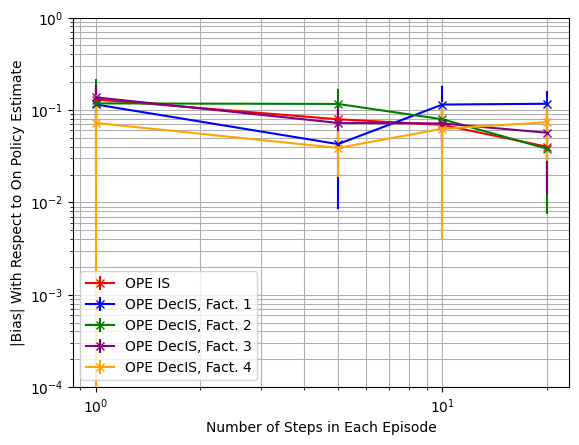

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.12963754 0.0791825  0.06896931 0.04003304]
OPE DecPDIS, Fact. 1-----[0.07877667 0.0615165  0.04895888 0.03740353]
OPE DecPDIS, Fact. 2-----[0.0983664  0.0913106  0.07783656 0.03108373]
OPE DecPDIS, Fact. 3-----[0.11952251 0.08105788 0.07257976 0.05714427]
OPE DecPDIS, Fact. 4-----[0.09115427 0.07066165 0.06046937 0.03541662]


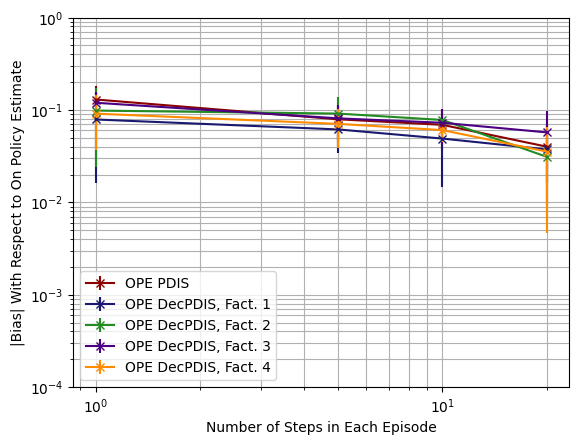

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.75585109 0.7311331  0.70426565 0.70971568]
OPE DecPDWIS, Fact. 1-----[0.75954489 0.73356557 0.7067205  0.7116761 ]
OPE DecPDWIS, Fact. 2-----[0.75578648 0.73081128 0.70390826 0.70899138]
OPE DecPDWIS, Fact. 3-----[0.75701094 0.73178091 0.70536199 0.70998026]
OPE DecPDWIS, Fact. 4-----[0.75824272 0.73251114 0.70577191 0.71051027]


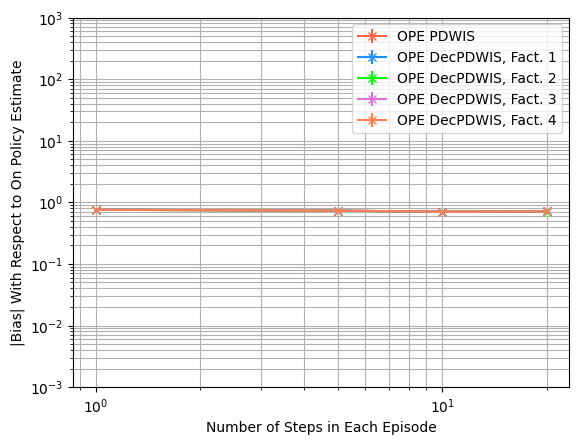

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.15663337 0.02793453 0.01649393 0.01078014]
OPE IS-----[0.32451672 0.05888023 0.03340013 0.0191584 ]
OPE DecIS, Fact. 1-----[0.40559134 0.07597282 0.04400441 0.02294498]
OPE DecIS, Fact. 2-----[0.22440874 0.0700333  0.04246274 0.02116201]
OPE DecIS, Fact. 3-----[0.34084966 0.07178614 0.04698822 0.02312749]
OPE DecIS, Fact. 4-----[0.28053563 0.06754739 0.03672018 0.01683118]


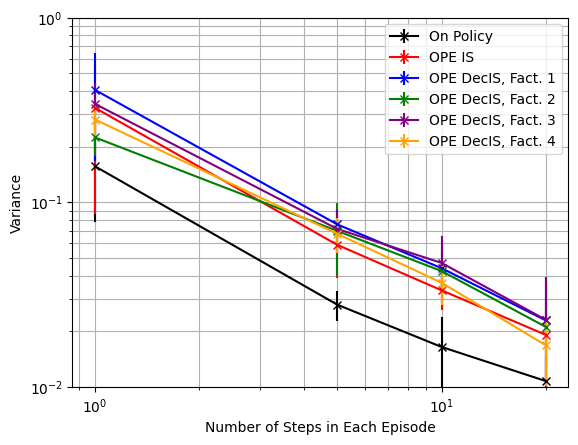

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-2), 10**0, shorter_D, estimator='IS')

On Policy-----[0.15663337 0.02793453 0.01649393 0.01078014]
OPE PDIS-----[0.32451672 0.05888023 0.03340013 0.0191584 ]
OPE DecPDIS, Fact. 1-----[0.30950926 0.06193063 0.03558416 0.0190138 ]
OPE DecPDIS, Fact. 2-----[0.25796182 0.07247834 0.04268562 0.02104142]
OPE DecPDIS, Fact. 3-----[0.33130677 0.07213768 0.05479408 0.0248341 ]
OPE DecPDIS, Fact. 4-----[0.25364676 0.06283567 0.03421146 0.01592654]


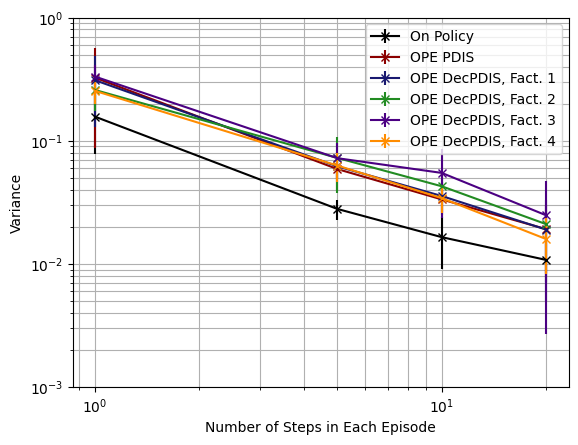

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.15663337 0.02793453 0.01649393 0.01078014]
OPE PDWIS-----[3.77276855e-04 1.24988212e-04 6.59564735e-05 3.59444190e-05]
OPE DecPDWIS, Fact. 1-----[3.20675969e-04 1.03158711e-04 5.03629703e-05 2.75962423e-05]
OPE DecPDWIS, Fact. 2-----[4.14784346e-04 1.29874424e-04 7.94833380e-05 3.88727388e-05]
OPE DecPDWIS, Fact. 3-----[3.89654210e-04 1.35468549e-04 8.18367657e-05 3.68422997e-05]
OPE DecPDWIS, Fact. 4-----[3.58063484e-04 1.13264881e-04 6.20358875e-05 2.78883917e-05]


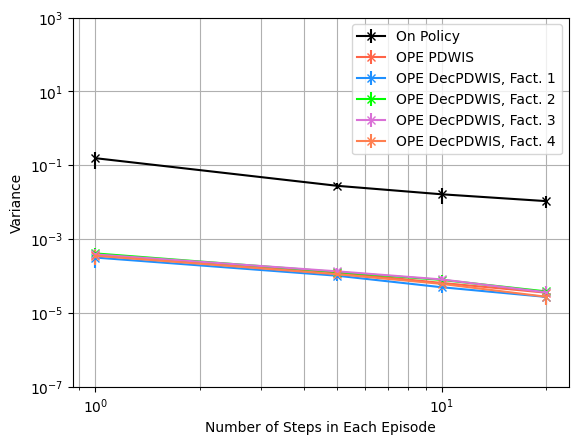

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.15663337 0.02793453 0.01649393 0.01078014]
OPE IS-----[0.34419119 0.06665879 0.03917954 0.02170507]
OPE DecIS, Fact. 1-----[0.42163653 0.07895734 0.06169252 0.03855468]
OPE DecIS, Fact. 2-----[0.2477912  0.08627044 0.04960471 0.0235505 ]
OPE DecIS, Fact. 3-----[0.36176496 0.07816437 0.05305658 0.02832019]
OPE DecIS, Fact. 4-----[0.2910001  0.06945068 0.04406415 0.02435172]


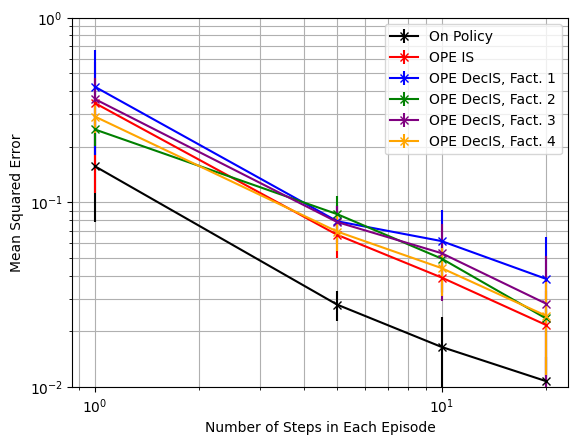

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-2), 10**0, shorter_D, estimator='IS')

On Policy-----[0.15663337 0.02793453 0.01649393 0.01078014]
OPE PDIS-----[0.34419119 0.06665879 0.03917954 0.02170507]
OPE DecPDIS, Fact. 1-----[0.31962961 0.06646361 0.0391542  0.02086669]
OPE DecPDIS, Fact. 2-----[0.2731491  0.08296477 0.04890326 0.02262074]
OPE DecPDIS, Fact. 3-----[0.34694011 0.07972295 0.06099466 0.02975414]
OPE DecPDIS, Fact. 4-----[0.2649106  0.06886112 0.03811431 0.01812511]


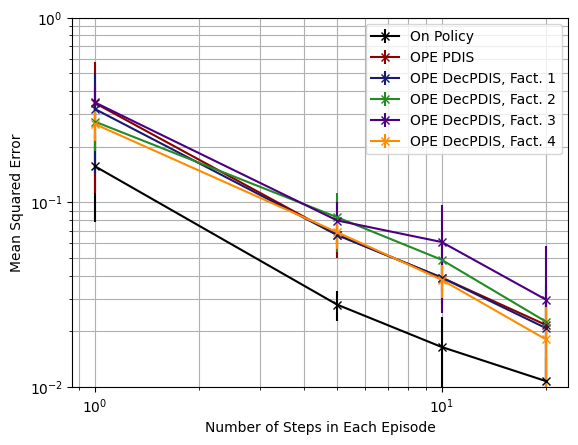

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-2), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.15663337 0.02793453 0.01649393 0.01078014]
OPE PDWIS-----[0.57560578 0.53503748 0.49688178 0.50434106]
OPE DecPDWIS, Fact. 1-----[0.58114627 0.53859271 0.50032037 0.50711535]
OPE DecPDWIS, Fact. 2-----[0.5755832  0.53457086 0.49637032 0.50329597]
OPE DecPDWIS, Fact. 3-----[0.57740245 0.53601527 0.49843782 0.50471238]
OPE DecPDWIS, Fact. 4-----[0.57923854 0.53704998 0.49898357 0.50544332]


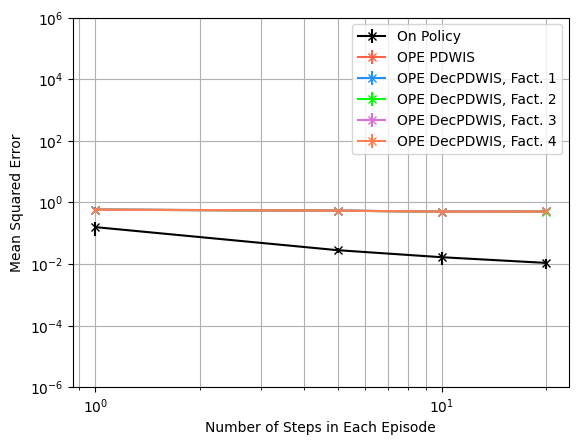

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[ 1.  5. 10. 20.]
OPE IS-----[ 0.72339426  3.06726315  5.04946067 12.986867  ]
OPE DecIS, Fact. 1-----[ 0.56014888  1.88407448  3.78199717 12.84438845]
OPE DecIS, Fact. 2-----[ 0.73940786  2.16078528  3.78130417 10.10096733]
OPE DecIS, Fact. 3-----[ 0.50568888  2.09394382  3.51960368 11.56247304]
OPE DecIS, Fact. 4-----[ 0.59306421  2.11689426  4.4036949  14.5432664 ]


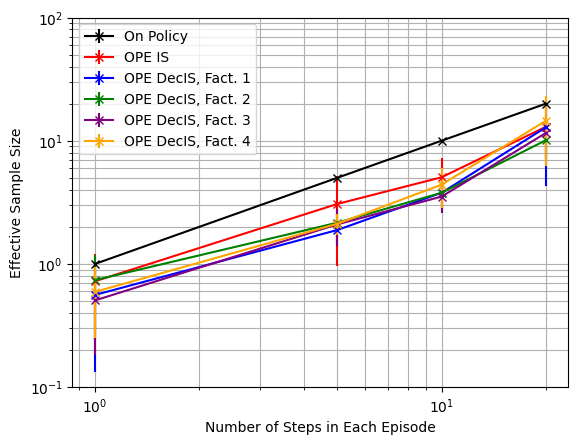

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-1), 10**2, shorter_D, estimator='IS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDIS-----[ 0.72339426  3.06726315  5.04946067 12.986867  ]
OPE DecPDIS, Fact. 1-----[ 0.72595166  2.30598057  4.76495821 15.99622585]
OPE DecPDIS, Fact. 2-----[ 0.72711345  2.22501624  3.85087573 11.07030673]
OPE DecPDIS, Fact. 3-----[ 0.53958617  2.21024224  3.20711704 12.69840247]
OPE DecPDIS, Fact. 4-----[ 0.66645941  2.31080185  4.7856241  17.52861278]


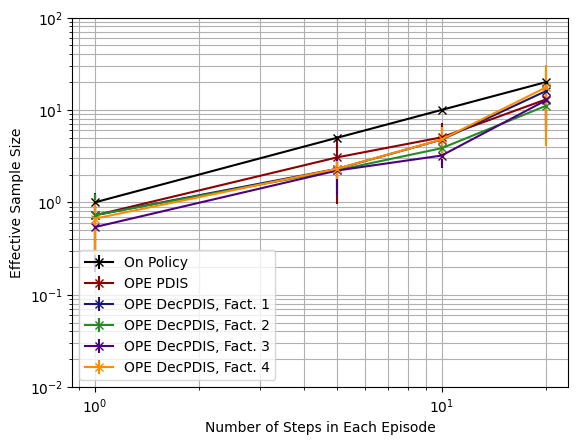

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-2), 10**2, shorter_D, estimator='PDIS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDWIS-----[ 642.17425601 1220.14634399 3260.27887229 6103.71981441]
OPE DecPDWIS, Fact. 1-----[ 782.57944542 1465.05227199 3733.03774495 8967.39169324]
OPE DecPDWIS, Fact. 2-----[ 546.31162881 1145.64195575 2171.86764886 7301.16012388]
OPE DecPDWIS, Fact. 3-----[ 639.03516047 1076.76835085 1983.10428966 8243.85060238]
OPE DecPDWIS, Fact. 4-----[  670.26522113  1301.63933736  2786.93635431 13249.40546231]


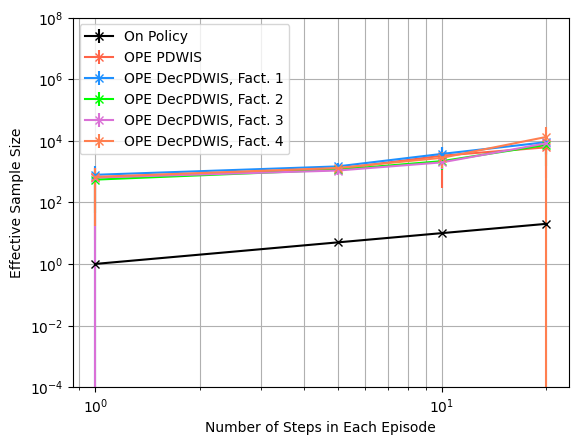

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

## From Patient State 143, With Diabetes

In [ ]:
#The patient has diabetes
PROB_DIAB = 1.0

### State Analysis

In [ ]:
#Instantiate a state based on the idx and get the state vector
testState = State(state_idx = 143, diabetic_idx=1)
vec = testState.get_state_vector()

print(vec)

print(f'Heart Rate: {hr_state_mapping[vec[0]]}')
print(f'Systolic Blood Pressure: {sbp_state_mapping[vec[1]]}')
print(f'Percent Oxygen: {o2_state_mapping[vec[2]]}')
print(f'Glucose Level: {glu_state_mapping[vec[3]]}')
print(f'Antibiotics: {abx_state_mapping[vec[4]]}')
print(f'Vasopressors: {vaso_state_mapping[vec[5]]}')
print(f'Ventilator: {vent_state_mapping[vec[6]]}')
print(f'Diabetes: {testState.diabetic_idx}')

[0 1 1 2 1 1 1]
Heart Rate: Low
Systolic Blood Pressure: Normal
Percent Oxygen: Normal
Glucose Level: Normal
Antibiotics: On
Vasopressors: On
Ventilator: On
Diabetes: 1


### Generate Data From Behaviour Policy

Run the data generator

In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=randPol, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

Convert data into array format

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_b = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_b.shape

(100000, 20, 5)

In [ ]:
f_tr_b1, f_tr_b2, f_tr_b3, f_tr_b4 = factorise_dataset(nf_tr_b)

In [ ]:
print(nf_tr_b)

[[[  0. 143.   0.   0. 128.]
  [  1. 128.   2.   0. 137.]
  [  2. 137.   5.  -1. 230.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 143.   3.  -1. 227.]
  [  1. 227.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 143.   7.   0. 223.]
  [  1. 223.   7.  -1. 231.]
  [  2. 231.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 ...

 [[  0. 143.   3.  -1. 227.]
  [  1. 227.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 143.   2.   0. 129.]
  [  1. 129.   2.   0. 121.]
  [  2. 121.   1.  -1. 202.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 143.   5.   0. 222.]
  [  1. 222.   0.   0. 216.]
  [  2. 216.   3.   0. 219

In [ ]:
print(f_tr_b1)

[[[[  0.  143.    0.    0.  128. ]
   [  0.  143.    0.    0.  128. ]]

  [[  1.  128.    1.    0.  137. ]
   [  1.  128.    0.    0.  137. ]]

  [[  2.  137.    0.   -0.5 230. ]
   [  2.  137.    3.   -0.5 230. ]]

  ...

  [[ 17.   -1.    1.    0.   -1. ]
   [ 17.   -1.   -1.    0.   -1. ]]

  [[ 18.   -1.    1.    0.   -1. ]
   [ 18.   -1.   -1.    0.   -1. ]]

  [[ 19.   -1.    1.    0.   -1. ]
   [ 19.   -1.   -1.    0.   -1. ]]]


 [[[  0.  143.    1.   -0.5 227. ]
   [  0.  143.    1.   -0.5 227. ]]

  [[  1.  227.    1.    0.   -1. ]
   [  1.  227.   -1.    0.   -1. ]]

  [[  2.   -1.    1.    0.   -1. ]
   [  2.   -1.   -1.    0.   -1. ]]

  ...

  [[ 17.   -1.    1.    0.   -1. ]
   [ 17.   -1.   -1.    0.   -1. ]]

  [[ 18.   -1.    1.    0.   -1. ]
   [ 18.   -1.   -1.    0.   -1. ]]

  [[ 19.   -1.    1.    0.   -1. ]
   [ 19.   -1.   -1.    0.   -1. ]]]


 [[[  0.  143.    1.    0.  223. ]
   [  0.  143.    3.    0.  223. ]]

  [[  1.  223.    1.   -0.5 231. ]
   [  1.  2

In [ ]:
factored_randPol1 = factor_policy_1(randPol)
factored_randPol2 = factor_policy_2(randPol)
factored_randPol3 = factor_policy_3(randPol)
factored_randPol4 = factor_policy_4(randPol)

In [ ]:
randPol = pad_policy(randPol)

factored_randPol1[0] = pad_policy(factored_randPol1[0])
factored_randPol1[1] = pad_policy(factored_randPol1[1])

factored_randPol2[0] = pad_policy(factored_randPol2[0])
factored_randPol2[1] = pad_policy(factored_randPol2[1])

factored_randPol3[0] = pad_policy(factored_randPol3[0])
factored_randPol3[1] = pad_policy(factored_randPol3[1])

factored_randPol4[0] = pad_policy(factored_randPol4[0])
factored_randPol4[1] = pad_policy(factored_randPol4[1])
factored_randPol4[2] = pad_policy(factored_randPol4[2])

### Varying Episodes $\epsilon_{e} = 0.4$ (Policy Divergence $4.8^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
EVAL_EPSILON = 0.4

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

4.8


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
print(nf_tr_e)

[[[  0. 143.   2.   0. 129.]
  [  1. 129.   3.  -1. 211.]
  [  2. 211.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 143.   2.   0. 129.]
  [  1. 129.   3.   0. 219.]
  [  2. 219.   2.   0. 217.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 143.   2.   0. 129.]
  [  1. 129.   2.   0. 129.]
  [  2. 129.   2.   0. 121.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 ...

 [[  0. 143.   7.  -1. 231.]
  [  1. 231.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 143.   2.   0. 137.]
  [  1. 137.   5.   0. 222.]
  [  2. 222.   3.  -1. 227.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 143.   5.   0. 150.]
  [  1. 150.   2.   0. 137.]
  [  2. 137.   0.   0. 128

In [ ]:
print(f_tr_e1)

[[[[  0.  143.    1.    0.  129. ]
   [  0.  143.    0.    0.  129. ]]

  [[  1.  129.    1.   -0.5 211. ]
   [  1.  129.    1.   -0.5 211. ]]

  [[  2.  211.    1.    0.   -1. ]
   [  2.  211.   -1.    0.   -1. ]]

  ...

  [[ 17.   -1.    1.    0.   -1. ]
   [ 17.   -1.   -1.    0.   -1. ]]

  [[ 18.   -1.    1.    0.   -1. ]
   [ 18.   -1.   -1.    0.   -1. ]]

  [[ 19.   -1.    1.    0.   -1. ]
   [ 19.   -1.   -1.    0.   -1. ]]]


 [[[  0.  143.    1.    0.  129. ]
   [  0.  143.    0.    0.  129. ]]

  [[  1.  129.    1.    0.  219. ]
   [  1.  129.    1.    0.  219. ]]

  [[  2.  219.    1.    0.  217. ]
   [  2.  219.    0.    0.  217. ]]

  ...

  [[ 17.   -1.    1.    0.   -1. ]
   [ 17.   -1.   -1.    0.   -1. ]]

  [[ 18.   -1.    1.    0.   -1. ]
   [ 18.   -1.   -1.    0.   -1. ]]

  [[ 19.   -1.    1.    0.   -1. ]
   [ 19.   -1.   -1.    0.   -1. ]]]


 [[[  0.  143.    1.    0.  129. ]
   [  0.  143.    0.    0.  129. ]]

  [[  1.  129.    1.    0.  129. ]
   [  1.  1

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.9115201102121899. Variance of on policy Q estimate: 0.00793475419345447
Mean OPE IS estimate: -0.9259572238800493. Bias1: 0.01443711366785619. Bias2: 0.01443711366785938. Variance: 0.42148640035370183. MSE: 0.42169483060476043
Mean OPE PDIS estimate: -0.9259572238800493. Bias1: 0.01443711366785619. Bias2: 0.01443711366785938. Variance: 0.42148640035370183. MSE: 0.42169483060476043
Mean OPE PDWIS estimate: -0.046157689898534915. Bias1: 0.8653624203136551. Bias2: 0.865362420313655. Variance: 3.6699445096248536e-05. MSE: 0.7488888179362032
Mean OPE DecIS: Fact. 1 estimate: -1.3270722226598362. Bias1: 0.415552112447646. Bias2: 0.4155521124476462. Variance: 0.13996465119679352. MSE: 0.31264820935649457
Mean OPE DecPDIS: Fact. 1 estimate: -0.9078596281976778. Bias1: 0.0036604820145142844. Bias2: 0.0036604820145120787. Variance: 0.05633193584514497. MSE: 0.05634533497372355
Mean OPE DecPDWIS: Fact. 1 estimate: -

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.12839269 0.08191807 0.10604575 0.11894158 0.0962284 ]
OPE DecIS, Fact. 1-----[0.44503397 0.46897314 0.45718456 0.50373865 0.498995  ]
OPE DecIS, Fact. 2-----[0.2621483  0.26831427 0.26227212 0.25475339 0.25916216]
OPE DecIS, Fact. 3-----[0.23365172 0.20707345 0.21049046 0.19583191 0.19697832]
OPE DecIS, Fact. 4-----[0.10031229 0.12593831 0.11573641 0.13896709 0.1356332 ]


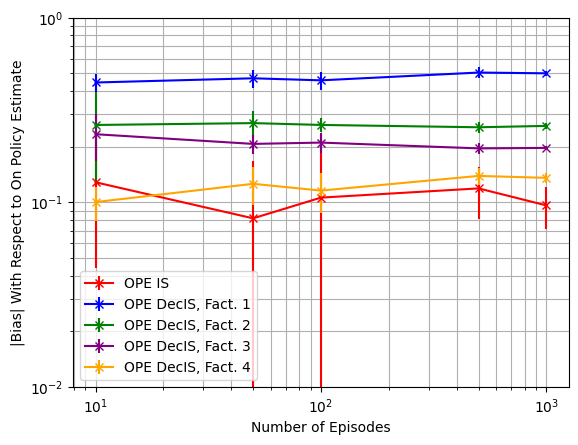

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-2), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.12839269 0.08191807 0.10604575 0.11894158 0.0962284 ]
OPE DecPDIS, Fact. 1-----[0.03953177 0.07236414 0.07068096 0.11070595 0.10540167]
OPE DecPDIS, Fact. 2-----[0.14490792 0.1011499  0.10046239 0.10352657 0.09824996]
OPE DecPDIS, Fact. 3-----[0.12671908 0.09145904 0.08657698 0.10164709 0.11299355]
OPE DecPDIS, Fact. 4-----[0.0708681  0.10784175 0.09989036 0.1157986  0.1115124 ]


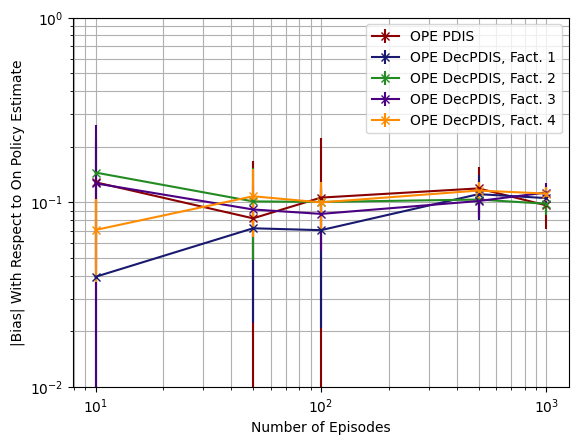

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-2), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.82494026 0.80542591 0.79972494 0.79453354 0.79690212]
OPE DecPDWIS, Fact. 1-----[0.83412665 0.81492548 0.80915388 0.80438858 0.80597032]
OPE DecPDWIS, Fact. 2-----[0.77179883 0.75734768 0.75308621 0.74988391 0.75167014]
OPE DecPDWIS, Fact. 3-----[0.79573118 0.7754561  0.76958136 0.76451483 0.76629916]
OPE DecPDWIS, Fact. 4-----[0.79556787 0.7798072  0.77522208 0.77136845 0.77307807]


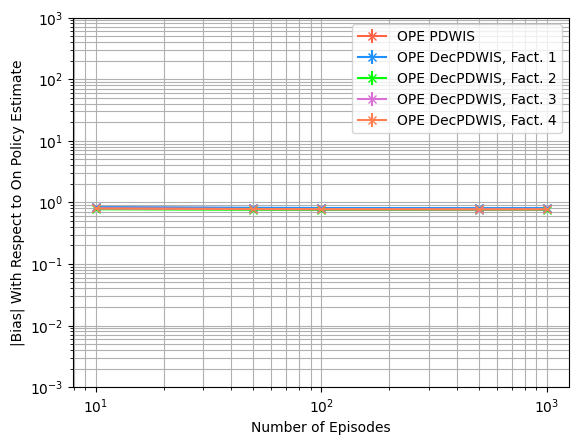

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.01447484 0.0038228  0.00186275 0.00030717 0.00016227]
OPE IS-----[0.41755598 0.32110668 0.3533937  0.0891031  0.08056497]
OPE DecIS, Fact. 1-----[0.29661258 0.123687   0.04782122 0.02698169 0.01113926]
OPE DecIS, Fact. 2-----[0.31317173 0.05124782 0.02422483 0.0154075  0.0052242 ]
OPE DecIS, Fact. 3-----[0.10916834 0.03169242 0.01340425 0.00699654 0.00281679]
OPE DecIS, Fact. 4-----[0.12609158 0.04020279 0.01870855 0.00830995 0.00323071]


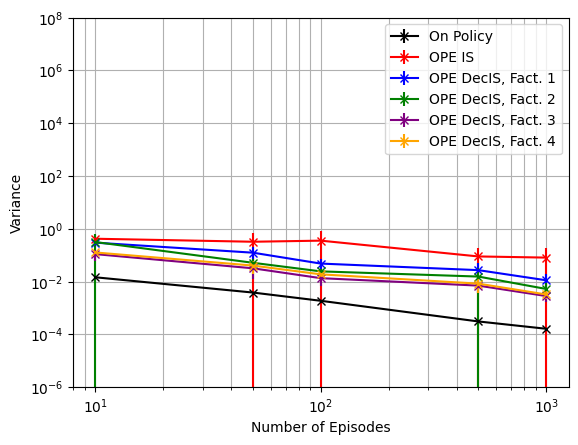

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-6), 10**8, shorter_D, estimator='IS')

On Policy-----[0.01447484 0.0038228  0.00186275 0.00030717 0.00016227]
OPE PDIS-----[0.41755598 0.32110668 0.3533937  0.0891031  0.08056497]
OPE DecPDIS, Fact. 1-----[0.12816599 0.06794257 0.02463819 0.01816969 0.00738472]
OPE DecPDIS, Fact. 2-----[0.36371433 0.08358651 0.0331754  0.01685229 0.00580739]
OPE DecPDIS, Fact. 3-----[0.51005069 0.0467017  0.02372591 0.01057786 0.0090858 ]
OPE DecPDIS, Fact. 4-----[0.06727247 0.02887211 0.01275116 0.00505348 0.0019    ]


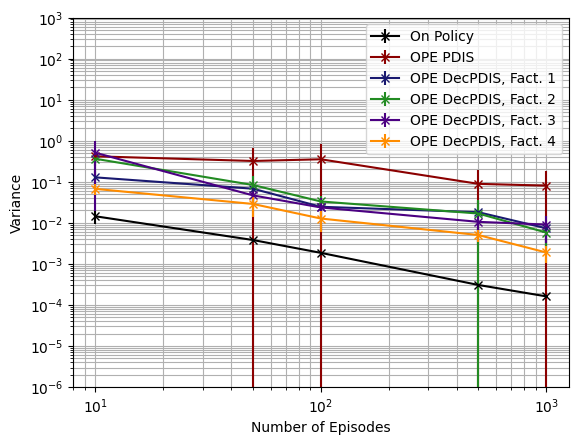

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**3, shorter_D, estimator='PDIS')

On Policy-----[0.01447484 0.0038228  0.00186275 0.00030717 0.00016227]
OPE PDWIS-----[2.23853452e-05 1.88000418e-05 1.22076135e-05 4.16634552e-06
 6.29528111e-05]
OPE DecPDWIS, Fact. 1-----[4.66233091e-06 7.02020536e-06 2.91801468e-06 1.71287595e-06
 1.58211530e-06]
OPE DecPDWIS, Fact. 2-----[6.90680708e-04 1.79950994e-04 1.12316863e-04 4.47901087e-05
 2.00690987e-05]
OPE DecPDWIS, Fact. 3-----[3.02841114e-04 9.96432102e-05 6.34435431e-05 1.96986735e-05
 3.53934046e-05]
OPE DecPDWIS, Fact. 4-----[2.98306543e-04 8.70813792e-05 5.40075170e-05 1.97232505e-05
 8.98609997e-06]


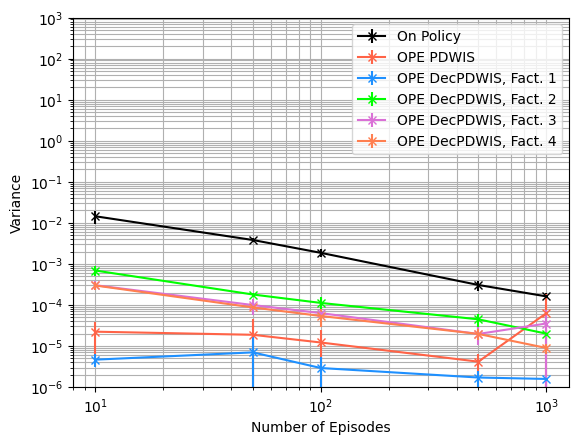

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.01447484 0.0038228  0.00186275 0.00030717 0.00016227]
OPE IS-----[0.44118569 0.33498897 0.3782632  0.10463676 0.09042913]
OPE DecIS, Fact. 1-----[0.49702655 0.34639603 0.25964687 0.28189966 0.26032235]
OPE DecIS, Fact. 2-----[0.3995176  0.12513222 0.0935363  0.08061813 0.07249015]
OPE DecIS, Fact. 3-----[0.16816993 0.07517951 0.05837513 0.045514   0.04163935]
OPE DecIS, Fact. 4-----[0.13659967 0.05692806 0.03292366 0.02782103 0.0217113 ]


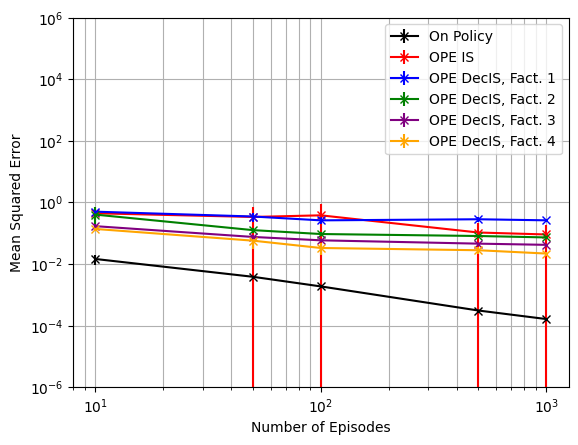

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='IS')

On Policy-----[0.01447484 0.0038228  0.00186275 0.00030717 0.00016227]
OPE PDIS-----[0.44118569 0.33498897 0.3782632  0.10463676 0.09042913]
OPE DecPDIS, Fact. 1-----[0.13124325 0.07570474 0.03211285 0.03134596 0.01863856]
OPE DecPDIS, Fact. 2-----[0.39145632 0.09657265 0.04348502 0.02788542 0.01562188]
OPE DecPDIS, Fact. 3-----[0.54445107 0.05541316 0.03226916 0.02129458 0.02206934]
OPE DecPDIS, Fact. 4-----[0.07344843 0.04235626 0.02358233 0.01862441 0.01442092]


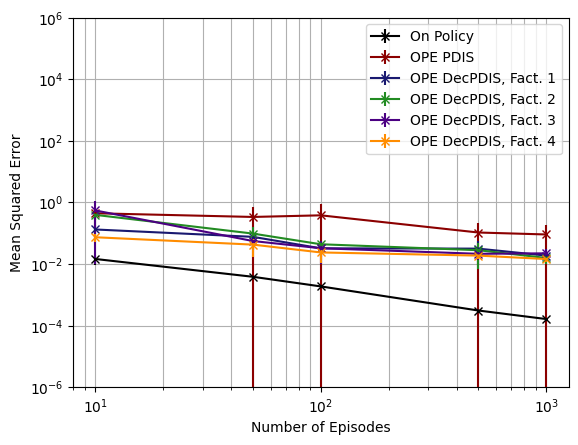

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='PDIS')

On Policy-----[0.01447484 0.0038228  0.00186275 0.00030717 0.00016227]
OPE PDWIS-----[0.68197115 0.64887395 0.63977332 0.63129495 0.63513977]
OPE DecPDWIS, Fact. 1-----[0.69715474 0.6642604  0.65494379 0.64704973 0.64959989]
OPE DecPDWIS, Fact. 2-----[0.5978255  0.5738736  0.56744787 0.56237683 0.56503981]
OPE DecPDWIS, Fact. 3-----[0.63487591 0.60158515 0.59253599 0.58451144 0.58726435]
OPE DecPDWIS, Fact. 4-----[0.63463009 0.60830972 0.60121383 0.59503656 0.59766867]


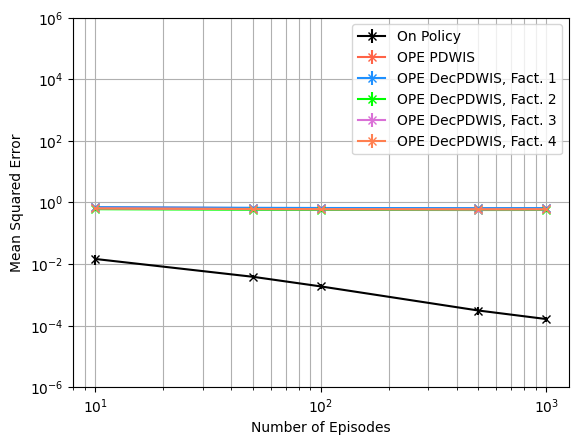

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[0.40393409 1.49535726 2.47499297 4.02622161 5.94351887]
OPE DecIS, Fact. 1-----[ 0.51735531  2.59641285  4.83044746 10.81646961 18.79322144]
OPE DecIS, Fact. 2-----[ 1.37468294  4.38494945  8.0093033  22.79033552 40.41319944]
OPE DecIS, Fact. 3-----[ 1.5198493   8.92236338 18.53353168 41.07077012 73.04209608]
OPE DecIS, Fact. 4-----[ 1.15124722  6.10917593 12.59486875 25.83969849 57.36301496]


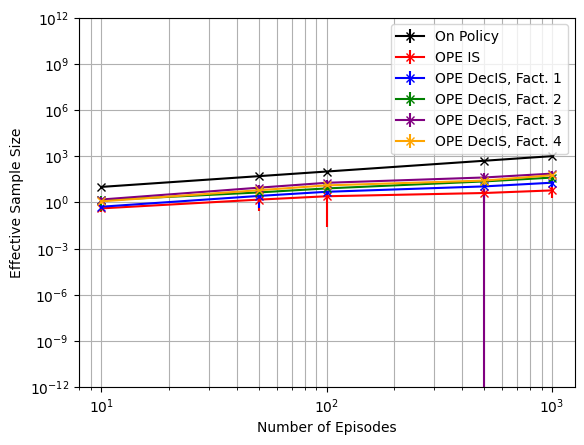

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-12), 10**12, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[0.40393409 1.49535726 2.47499297 4.02622161 5.94351887]
OPE DecPDIS, Fact. 1-----[ 1.30840168  5.0333797   8.83863898 18.07104529 27.93679344]
OPE DecPDIS, Fact. 2-----[ 0.66326404  3.16160074  6.30603762 21.09571589 35.66895103]
OPE DecPDIS, Fact. 3-----[ 0.68982459  4.53775186 10.85263277 20.06353537 31.82513839]
OPE DecPDIS, Fact. 4-----[  2.15047873   9.26543755  22.55751097  38.90375112 113.23477134]


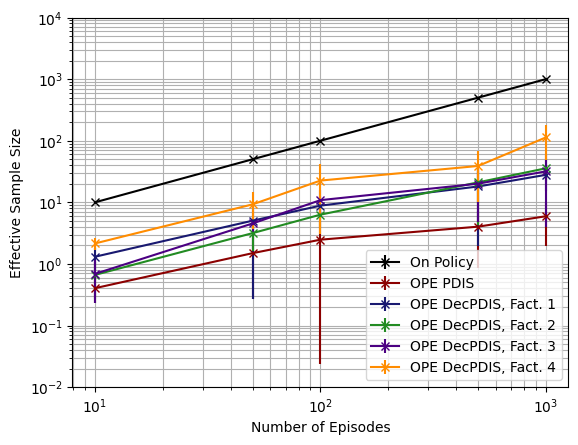

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-2), 10**4, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[12411.78085169 47340.63192901 62672.1719735  46404.53115405
 53106.52244523]
OPE DecPDWIS, Fact. 1-----[ 32293.06243529 113352.40639634 155461.46695799 113225.10429171
 125445.88601465]
OPE DecPDWIS, Fact. 2-----[ 227.30677935 1067.55573216 1978.26477775 4050.75357964 8598.94041282]
OPE DecPDWIS, Fact. 3-----[ 477.9582507  2166.03241983 3130.50156357 9408.80103518 9906.88305022]
OPE DecPDWIS, Fact. 4-----[  521.00270785  2232.62991859  4481.74254379  8598.42198174
 19067.79247056]


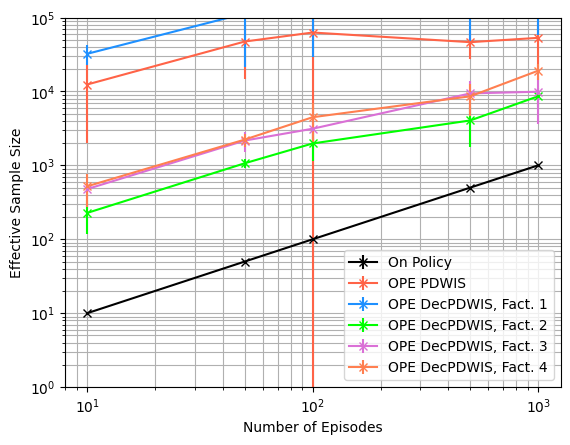

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**(5), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.6$ (Policy Divergence $3.2^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc

gc.collect()
EVAL_EPSILON = 0.6

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

3.2


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.918567424310124. Variance of on policy Q estimate: 0.0104748892784223
Mean OPE IS estimate: -0.9854994358812693. Bias1: 0.06693201157114526. Bias2: 0.06693201157114537. Variance: 0.11381397741295787. MSE: 0.1182938715859178
Mean OPE PDIS estimate: -0.9854994358812693. Bias1: 0.06693201157114526. Bias2: 0.06693201157114537. Variance: 0.11381397741295787. MSE: 0.1182938715859178
Mean OPE PDWIS estimate: -0.04734718613081468. Bias1: 0.8712202381793093. Bias2: 0.8712202381793093. Variance: 2.3264911989744058e-05. MSE: 0.7590479683252022
Mean OPE DecIS: Fact. 1 estimate: -1.2795933894316138. Bias1: 0.36102596512148966. Bias2: 0.3610259651214899. Variance: 0.04927877736272649. MSE: 0.17961852485462954
Mean OPE DecPDIS: Fact. 1 estimate: -0.9577498239941287. Bias1: 0.03918239968400461. Bias2: 0.03918239968400472. Variance: 0.023601282386276744. MSE: 0.02513654283127383
Mean OPE DecPDWIS: Fact. 1 estimate: -0.039

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.09815043 0.04304608 0.03170588 0.03868029 0.03083307]
OPE DecIS, Fact. 1-----[0.34557929 0.33991198 0.33156759 0.34821118 0.35049596]
OPE DecIS, Fact. 2-----[0.23035576 0.24271234 0.24692558 0.24775837 0.24675802]
OPE DecIS, Fact. 3-----[0.14095554 0.15652308 0.16465389 0.16289609 0.16116779]
OPE DecIS, Fact. 4-----[0.06311539 0.060971   0.05170071 0.05851325 0.06046307]


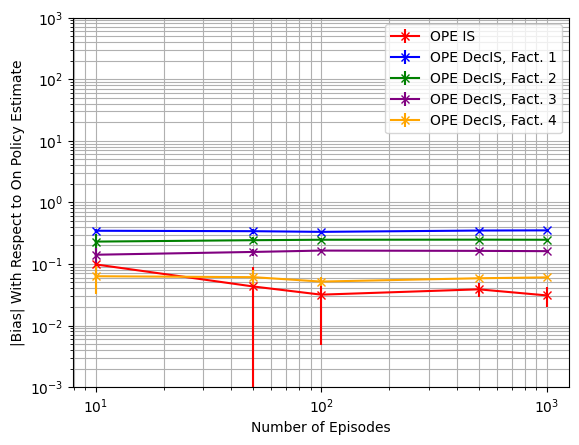

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='IS')

OPE PDIS-----[0.09815043 0.04304608 0.03170588 0.03868029 0.03083307]
OPE DecPDIS, Fact. 1-----[0.03401279 0.03567608 0.02296847 0.03683292 0.03786678]
OPE DecPDIS, Fact. 2-----[0.08509929 0.04592466 0.03388111 0.03087993 0.03143653]
OPE DecPDIS, Fact. 3-----[0.08376838 0.04003756 0.03016199 0.03156773 0.03587016]
OPE DecPDIS, Fact. 4-----[0.04685322 0.03943622 0.03317242 0.03668661 0.03750665]


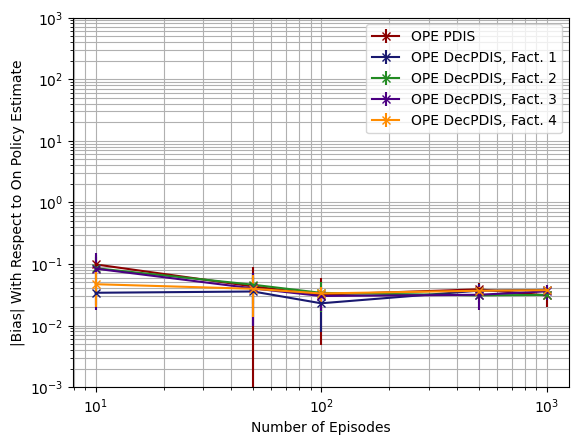

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.87194276 0.87881294 0.87769524 0.87877753 0.87877058]
OPE DecPDWIS, Fact. 1-----[0.88015416 0.88722903 0.88607397 0.88728576 0.886883  ]
OPE DecPDWIS, Fact. 2-----[0.84600965 0.8541189  0.853184   0.85474788 0.85434336]
OPE DecPDWIS, Fact. 3-----[0.85905277 0.86624105 0.86498629 0.86596334 0.8657035 ]
OPE DecPDWIS, Fact. 4-----[0.86023699 0.86809321 0.86712658 0.86844173 0.86802203]


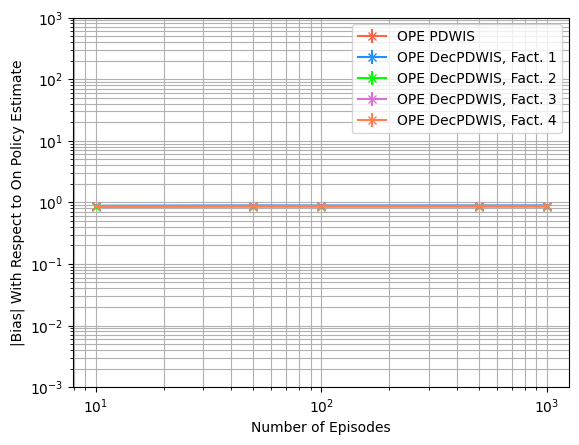

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[8.41512254e-03 1.34581618e-03 7.36938149e-04 1.45889989e-04
 6.59620167e-05]
OPE IS-----[0.14308132 0.10463612 0.0434897  0.00830104 0.00778346]
OPE DecIS, Fact. 1-----[0.1107103  0.04810023 0.01798959 0.00659886 0.0034211 ]
OPE DecIS, Fact. 2-----[0.07530654 0.01939778 0.00776548 0.00253717 0.00113265]
OPE DecIS, Fact. 3-----[0.08247072 0.01586368 0.00643196 0.00251311 0.00134865]
OPE DecIS, Fact. 4-----[0.05067333 0.01644193 0.00736217 0.00209777 0.00102984]


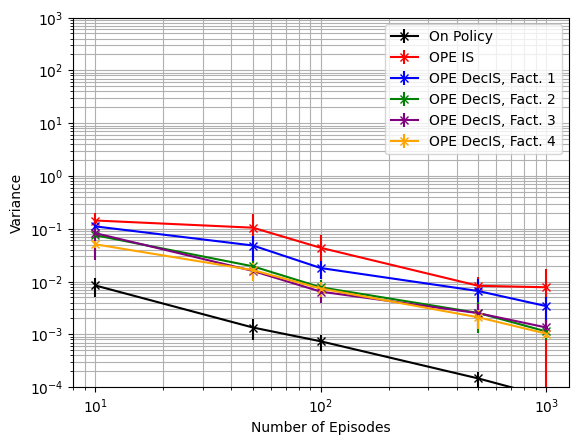

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**3, shorter_D, estimator='IS')

On Policy-----[8.41512254e-03 1.34581618e-03 7.36938149e-04 1.45889989e-04
 6.59620167e-05]
OPE PDIS-----[0.14308132 0.10463612 0.0434897  0.00830104 0.00778346]
OPE DecPDIS, Fact. 1-----[0.05474886 0.03065419 0.01104062 0.00490451 0.0023735 ]
OPE DecPDIS, Fact. 2-----[0.1026626  0.02824242 0.01113078 0.00313152 0.00135389]
OPE DecPDIS, Fact. 3-----[0.22339184 0.02291566 0.00904289 0.00326736 0.00241493]
OPE DecPDIS, Fact. 4-----[0.03417202 0.01293432 0.00565945 0.00160737 0.00075529]


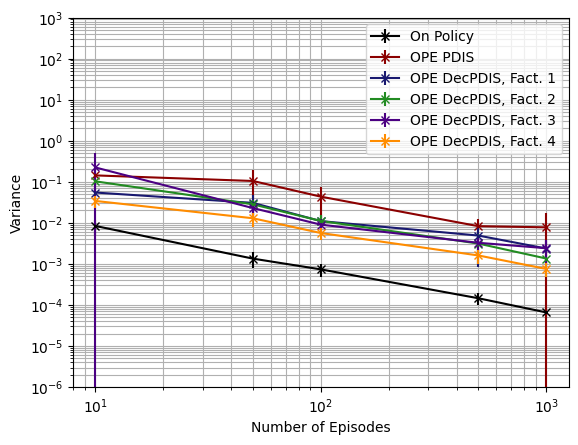

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**3, shorter_D, estimator='PDIS')

On Policy-----[8.41512254e-03 1.34581618e-03 7.36938149e-04 1.45889989e-04
 6.59620167e-05]
OPE PDWIS-----[1.14620688e-05 1.02985381e-05 6.74707848e-06 1.87631169e-06
 1.56107606e-05]
OPE DecPDWIS, Fact. 1-----[3.28099320e-06 4.10246964e-06 2.07178874e-06 1.25447740e-06
 9.32440074e-07]
OPE DecPDWIS, Fact. 2-----[1.17065395e-04 2.44593428e-05 1.62035899e-05 6.53237713e-06
 2.54786745e-06]
OPE DecPDWIS, Fact. 3-----[6.08164608e-05 2.14571026e-05 1.38922781e-05 3.57631181e-06
 6.19051652e-06]
OPE DecPDWIS, Fact. 4-----[5.08609187e-05 1.43096177e-05 9.78062916e-06 3.08256488e-06
 1.40813213e-06]


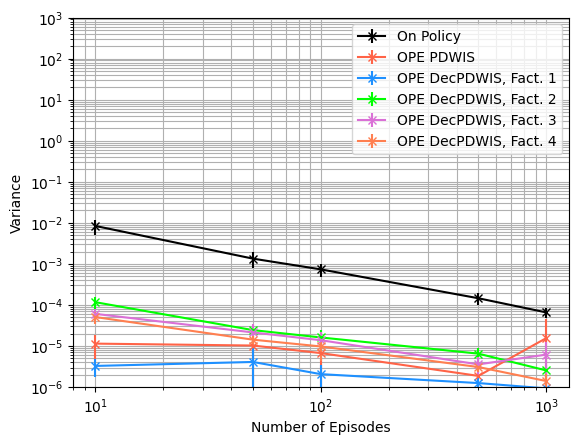

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[8.41512254e-03 1.34581618e-03 7.36938149e-04 1.45889989e-04
 6.59620167e-05]
OPE IS-----[0.15361124 0.10866877 0.045218   0.00989162 0.0088583 ]
OPE DecIS, Fact. 1-----[0.23071919 0.1647724  0.12821327 0.12796134 0.12630789]
OPE DecIS, Fact. 2-----[0.13441811 0.07907928 0.06893768 0.06395404 0.06202754]
OPE DecIS, Fact. 3-----[0.10418304 0.04075639 0.03359726 0.02918786 0.0273785 ]
OPE DecIS, Fact. 4-----[0.05556483 0.02050513 0.0101082  0.00554151 0.00469001]


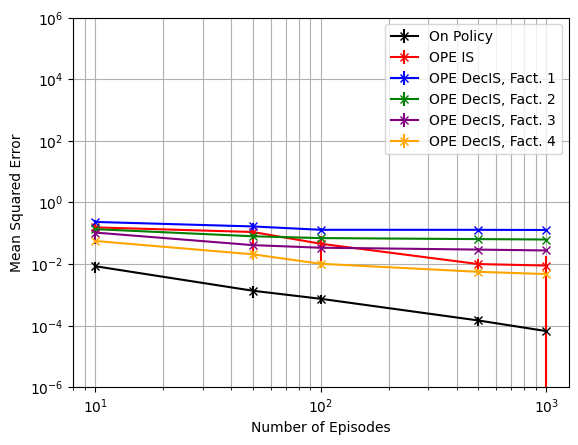

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='IS')

On Policy-----[8.41512254e-03 1.34581618e-03 7.36938149e-04 1.45889989e-04
 6.59620167e-05]
OPE PDIS-----[0.15361124 0.10866877 0.045218   0.00989162 0.0088583 ]
OPE DecPDIS, Fact. 1-----[0.05605276 0.03257848 0.01179336 0.00636133 0.00383043]
OPE DecPDIS, Fact. 2-----[0.11292552 0.03089537 0.012588   0.00414673 0.0023436 ]
OPE DecPDIS, Fact. 3-----[0.23472599 0.02542415 0.01011543 0.00444646 0.00379575]
OPE DecPDIS, Fact. 4-----[0.03709432 0.01514536 0.00683678 0.00298768 0.00216413]


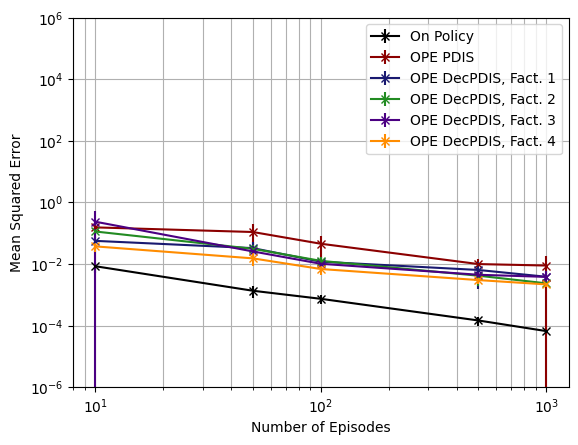

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='PDIS')

On Policy-----[8.41512254e-03 1.34581618e-03 7.36938149e-04 1.45889989e-04
 6.59620167e-05]
OPE PDWIS-----[0.76090906 0.77240019 0.77040315 0.77226113 0.77226394]
OPE DecPDWIS, Fact. 1-----[0.77528048 0.78726074 0.78517394 0.78728638 0.78657001]
OPE DecPDWIS, Fact. 2-----[0.7164444  0.72962008 0.72798297 0.7306101  0.72991313]
OPE DecPDWIS, Fact. 3-----[0.7386387  0.75047611 0.74826034 0.7499044  0.74945678]
OPE DecPDWIS, Fact. 4-----[0.74064504 0.75367564 0.75196196 0.75420356 0.75347112]


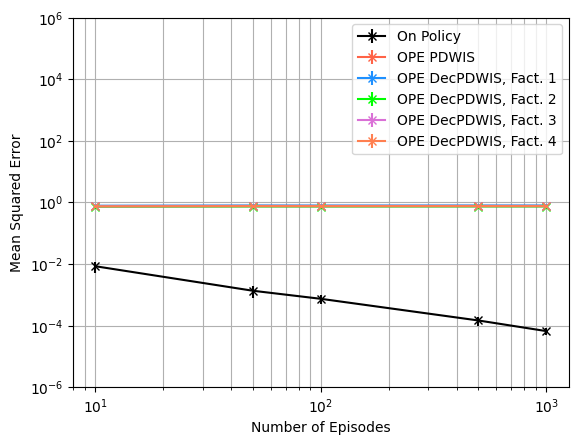

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[ 0.66243537  1.51672     3.14629551  9.30675913 23.27336655]
OPE DecIS, Fact. 1-----[ 0.9424821   2.16700742  4.91276108 16.73614477 22.1181629 ]
OPE DecIS, Fact. 2-----[ 1.53662741  3.99322835 11.90602177 36.37769309 62.17951217]
OPE DecIS, Fact. 3-----[ 1.47247926  4.75475116 14.6021436  37.35095097 59.95761586]
OPE DecIS, Fact. 4-----[ 1.7471048   4.94997986 13.21030909 38.96805403 65.25345007]


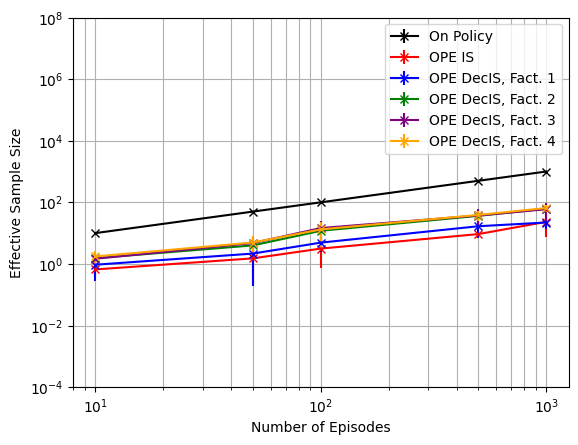

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[ 0.66243537  1.51672     3.14629551  9.30675913 23.27336655]
OPE DecPDIS, Fact. 1-----[ 1.91370257  3.74916691  7.84603653 24.5284386  32.23286192]
OPE DecPDIS, Fact. 2-----[ 0.90642447  2.69174428  8.26848248 28.37260653 51.30461809]
OPE DecPDIS, Fact. 3-----[ 1.05312491  2.99273168  8.96644464 24.39031895 42.32309819]
OPE DecPDIS, Fact. 4-----[ 2.85547858  6.31717131 18.02571103 49.07500356 94.45062013]


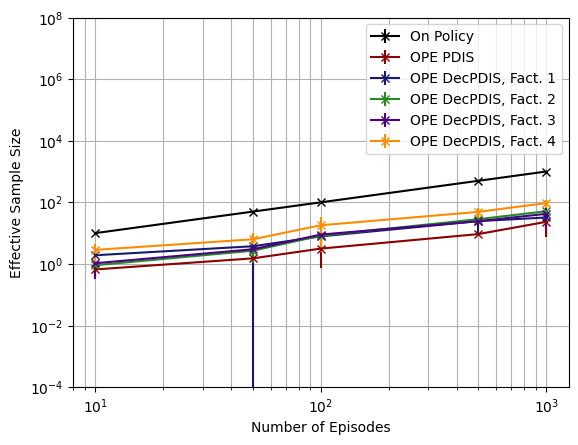

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[ 9697.40668974 21762.18331003 39578.24206182 62126.76247146
 57294.47842969]
OPE DecPDWIS, Fact. 1-----[27609.20009663 50040.54576391 59147.23706481 83148.91306273
 99547.59449898]
OPE DecPDWIS, Fact. 2-----[  813.81499277  2784.85785458  5300.9792818  13386.32039816
 27629.78139057]
OPE DecPDWIS, Fact. 3-----[ 1539.76852478  4580.12017162  8363.40606285 25338.36165754
 22767.58951551]
OPE DecPDWIS, Fact. 4-----[ 1821.26325215  5070.75786445 10412.0927761  25425.51038113
 54564.32801718]


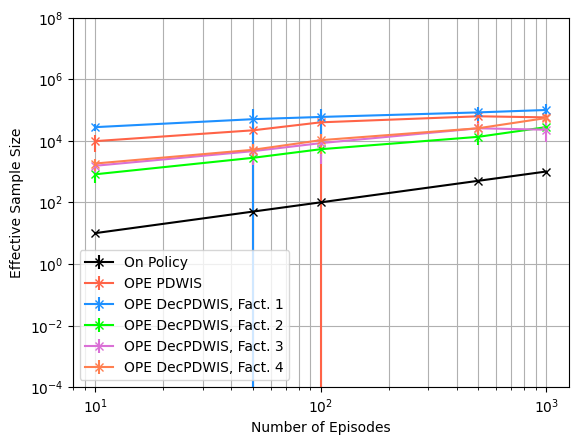

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{20}$)



Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc
gc.collect()
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.97111345857769. Variance of on policy Q estimate: 0.0008409480775204732
Mean OPE IS estimate: -0.9784839739698482. Bias1: 0.00737051539215803. Bias2: 0.007370515392158161. Variance: 0.007225157700460505. MSE: 0.007279482197606543
Mean OPE PDIS estimate: -0.9784839739698482. Bias1: 0.00737051539215803. Bias2: 0.007370515392158161. Variance: 0.007225157700460505. MSE: 0.007279482197606543
Mean OPE PDWIS estimate: -0.04811251017740591. Bias1: 0.9230009484002841. Bias2: 0.9230009484002841. Variance: 5.792327539638301e-06. MSE: 0.8519365430753636
Mean OPE DecIS: Fact. 1 estimate: -1.1044115717890766. Bias1: 0.13329811321138657. Bias2: 0.13329811321138652. Variance: 0.006860839445843259. MSE: 0.024629226431558886
Mean OPE DecPDIS: Fact. 1 estimate: -0.9741545373576403. Bias1: 0.0030410787799504987. Bias2: 0.0030410787799503014. Variance: 0.005831208226638009. MSE: 0.005840456386783874
Mean OPE DecPDWIS: Fact. 1

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.01692372 0.01007647 0.0070105  0.00636082 0.00594678]
OPE DecIS, Fact. 1-----[0.13741612 0.13804192 0.13807435 0.13848767 0.13991986]
OPE DecIS, Fact. 2-----[0.11047653 0.10998326 0.11111532 0.11037522 0.11008534]
OPE DecIS, Fact. 3-----[0.05204096 0.05330253 0.05518649 0.05531377 0.0539615 ]
OPE DecIS, Fact. 4-----[0.01433635 0.01639827 0.01552865 0.0162438  0.01760699]


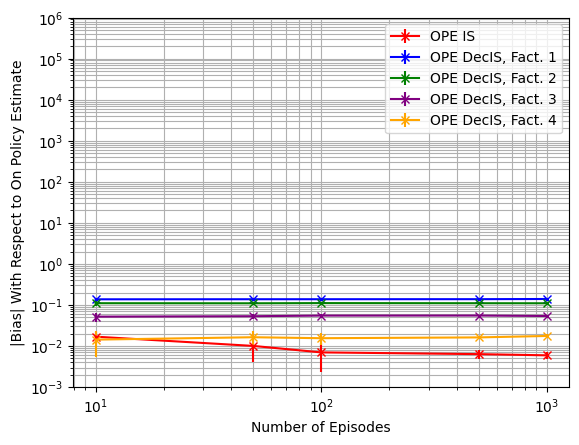

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**6, shorter_D, estimator='IS')

OPE PDIS-----[0.01692372 0.01007647 0.0070105  0.00636082 0.00594678]
OPE DecPDIS, Fact. 1-----[0.00747614 0.00945578 0.00609949 0.00583177 0.00704639]
OPE DecPDIS, Fact. 2-----[0.01232559 0.01023176 0.00637247 0.00549251 0.00567553]
OPE DecPDIS, Fact. 3-----[0.01187367 0.00960114 0.00533459 0.00401598 0.00515327]
OPE DecPDIS, Fact. 4-----[0.00863763 0.00755365 0.00496794 0.00505168 0.0061986 ]


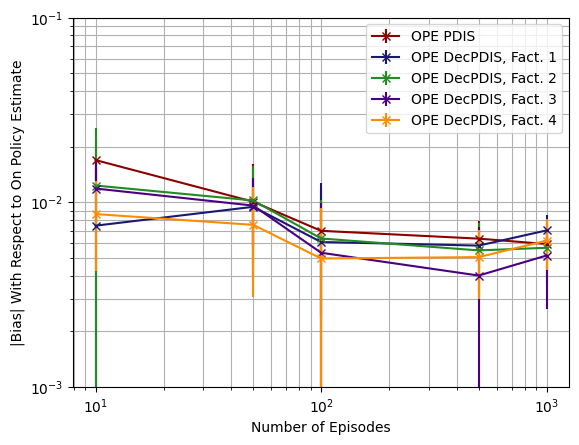

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**(-1), shorter_D, estimator='PDIS')

OPE PDWIS-----[0.9196115  0.91592704 0.91595707 0.91538118 0.9150205 ]
OPE DecPDWIS, Fact. 1-----[0.9240393  0.92037023 0.92046253 0.91990202 0.91953566]
OPE DecPDWIS, Fact. 2-----[0.91323932 0.90966502 0.90972101 0.90917375 0.90879092]
OPE DecPDWIS, Fact. 3-----[0.91689662 0.91325751 0.91325164 0.91265699 0.91228239]
OPE DecPDWIS, Fact. 4-----[0.91841587 0.91480741 0.91485474 0.91427414 0.91389597]


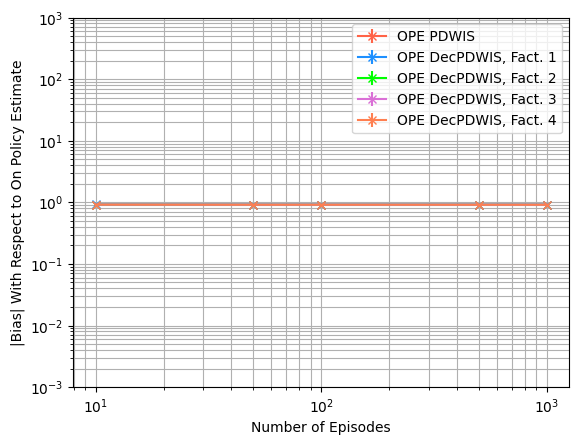

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[1.34239198e-03 2.57510696e-04 1.60194912e-04 4.69311203e-05
 2.19611174e-05]
OPE IS-----[0.0122211  0.00356682 0.00160061 0.00030499 0.00014791]
OPE DecIS, Fact. 1-----[0.01263398 0.00357308 0.0016458  0.00028133 0.00014122]
OPE DecIS, Fact. 2-----[7.30247769e-03 2.00275290e-03 8.17339702e-04 1.63733280e-04
 9.04567495e-05]
OPE DecIS, Fact. 3-----[0.01059986 0.00193275 0.00085273 0.00021081 0.00012844]
OPE DecIS, Fact. 4-----[7.58662359e-03 1.75165243e-03 8.00781375e-04 1.55888993e-04
 9.07064295e-05]


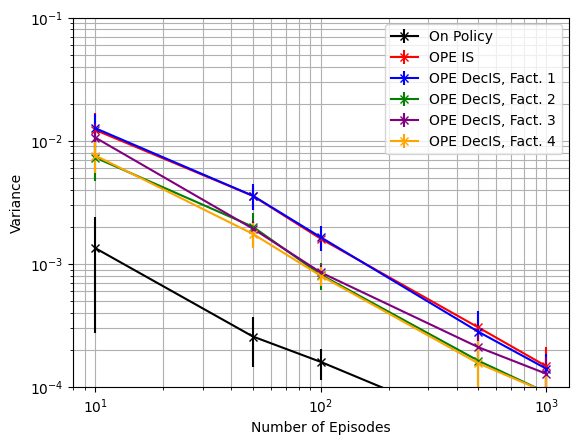

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**(-1), shorter_D, estimator='IS')

On Policy-----[1.34239198e-03 2.57510696e-04 1.60194912e-04 4.69311203e-05
 2.19611174e-05]
OPE PDIS-----[0.0122211  0.00356682 0.00160061 0.00030499 0.00014791]
OPE DecPDIS, Fact. 1-----[0.00949063 0.0028573  0.00129379 0.00021843 0.00010831]
OPE DecPDIS, Fact. 2-----[0.01043535 0.00261754 0.0011279  0.00021185 0.00010062]
OPE DecPDIS, Fact. 3-----[0.01226707 0.00221817 0.00098699 0.00023466 0.00013129]
OPE DecPDIS, Fact. 4-----[7.36738466e-03 1.68250895e-03 7.84099237e-04 1.52246566e-04
 7.95449194e-05]


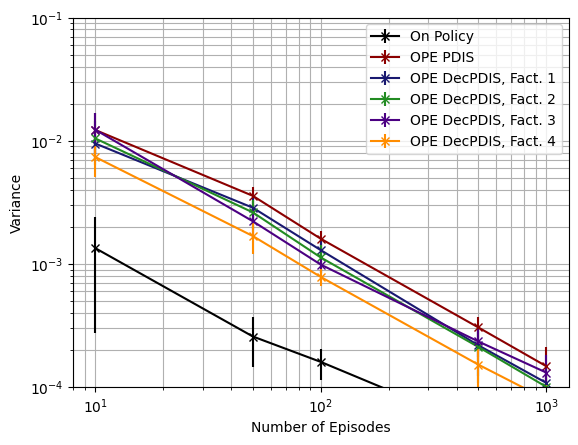

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**(-1), shorter_D, estimator='PDIS')

On Policy-----[1.34239198e-03 2.57510696e-04 1.60194912e-04 4.69311203e-05
 2.19611174e-05]
OPE PDWIS-----[5.36511584e-06 1.74677869e-06 6.65486878e-07 1.50049655e-07
 8.08115430e-08]
OPE DecPDWIS, Fact. 1-----[3.37648406e-06 8.72943139e-07 4.24213239e-07 9.71203518e-08
 3.84677868e-08]
OPE DecPDWIS, Fact. 2-----[9.76692749e-06 1.68531717e-06 9.76142197e-07 2.71867649e-07
 9.86523874e-08]
OPE DecPDWIS, Fact. 3-----[1.12941274e-05 2.00101889e-06 1.01510105e-06 2.36684161e-07
 1.05689393e-07]
OPE DecPDWIS, Fact. 4-----[7.10663456e-06 1.16248929e-06 6.76906995e-07 1.75214068e-07
 6.72920571e-08]


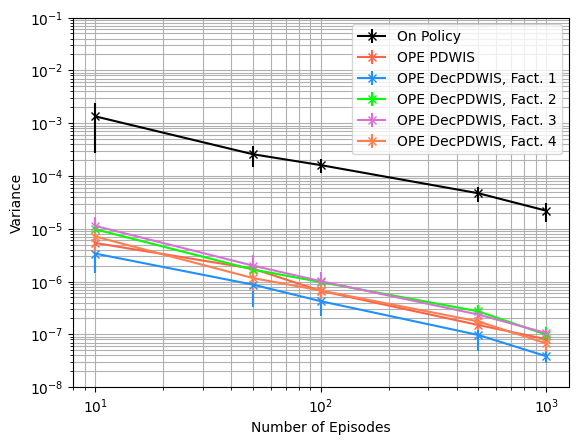

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-8), 10**(-1), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[1.34239198e-03 2.57510696e-04 1.60194912e-04 4.69311203e-05
 2.19611174e-05]
OPE IS-----[0.01253741 0.00370541 0.00167143 0.00034795 0.0001845 ]
OPE DecIS, Fact. 1-----[0.03164466 0.02271246 0.02076637 0.01946038 0.0197212 ]
OPE DecIS, Fact. 2-----[0.01972397 0.01417742 0.01318332 0.0123488  0.01221228]
OPE DecIS, Fact. 3-----[0.01346701 0.00482725 0.00392193 0.00328009 0.00304637]
OPE DecIS, Fact. 4-----[0.00787023 0.00206782 0.00106454 0.00042218 0.00040373]


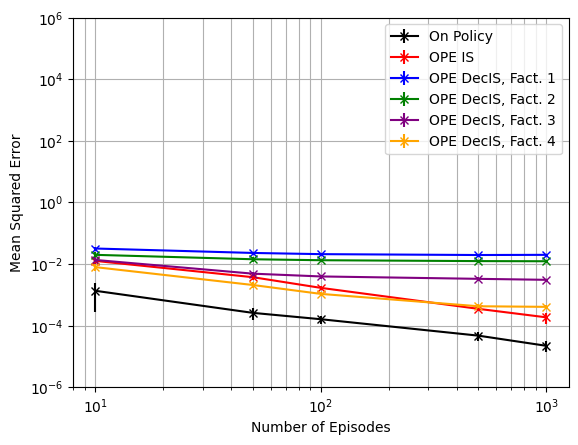

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='IS')

On Policy-----[1.34239198e-03 2.57510696e-04 1.60194912e-04 4.69311203e-05
 2.19611174e-05]
OPE PDIS-----[0.01253741 0.00370541 0.00167143 0.00034795 0.0001845 ]
OPE DecPDIS, Fact. 1-----[0.00960843 0.00295991 0.00137532 0.00025264 0.00016017]
OPE DecPDIS, Fact. 2-----[0.01075699 0.00275334 0.00118389 0.00024691 0.00013685]
OPE DecPDIS, Fact. 3-----[0.01242913 0.00232529 0.00103671 0.00026185 0.00016407]
OPE DecPDIS, Fact. 4-----[0.00746115 0.0017597  0.00082752 0.00018199 0.00012156]


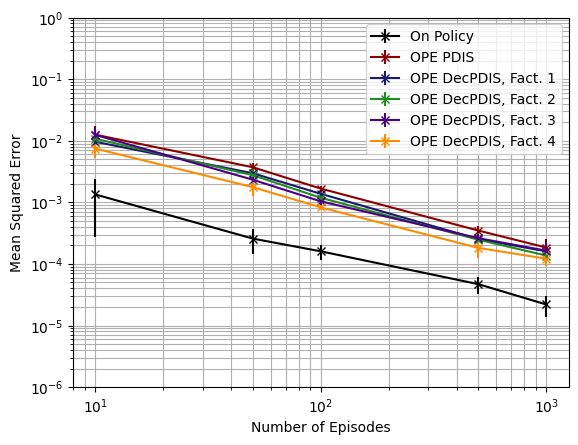

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**0, shorter_D, estimator='PDIS')

On Policy-----[1.34239198e-03 2.57510696e-04 1.60194912e-04 4.69311203e-05
 2.19611174e-05]
OPE PDWIS-----[0.8457248  0.83894136 0.83898294 0.83792578 0.83726317]
OPE DecPDWIS, Fact. 1-----[0.85388658 0.84709972 0.84725675 0.84622272 0.84554643]
OPE DecPDWIS, Fact. 2-----[0.83404951 0.82751011 0.82759864 0.82660004 0.82590162]
OPE DecPDWIS, Fact. 3-----[0.84074501 0.83405907 0.8340349  0.83294596 0.83225985]
OPE DecPDWIS, Fact. 4-----[0.84352945 0.83689157 0.83696514 0.83590029 0.8352065 ]


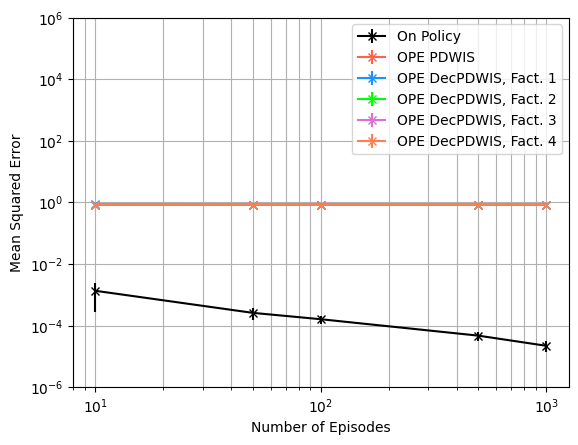

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[  1.57892707   3.78681567  10.28991418  81.11306594 185.67269257]
OPE DecIS, Fact. 1-----[  1.28752645   3.50266195  11.01522125  91.9020876  158.96921569]
OPE DecIS, Fact. 2-----[  2.35545373   6.51340601  21.04343284 175.07574181 315.34629236]
OPE DecIS, Fact. 3-----[  1.73107322   6.77940188  19.32594016 115.32627587 210.90285956]
OPE DecIS, Fact. 4-----[  2.09075854   7.14708673  20.35614615 166.42665649 289.46932182]


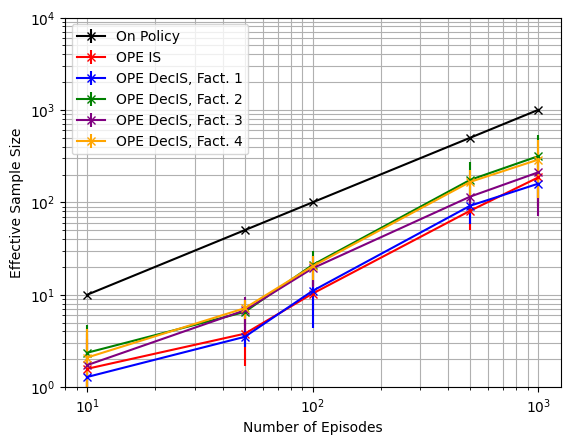

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**4, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[  1.57892707   3.78681567  10.28991418  81.11306594 185.67269257]
OPE DecPDIS, Fact. 1-----[  1.70443671   4.41981415  14.62400928 116.82996101 206.68828601]
OPE DecPDIS, Fact. 2-----[  1.63919208   4.86010381  15.60021021 149.2070798  257.818935  ]
OPE DecPDIS, Fact. 3-----[  1.63669747   6.06732388  16.8501412  103.74917399 202.36293727]
OPE DecPDIS, Fact. 4-----[  2.13916783   7.48510315  21.22961998 171.40908313 313.65634106]


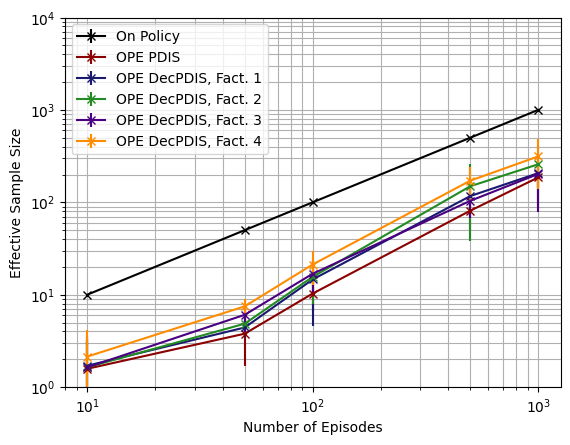

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**4, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[  3542.47248714   8802.47513165  29910.34972565 168438.38207621
 362088.53116816]
OPE DecPDWIS, Fact. 1-----[  5086.19150528  16585.00810954  55243.75515639 273522.53251631
 631961.02471884]
OPE DecPDWIS, Fact. 2-----[  1400.19858932   8512.30969193  19514.99982102  90247.86700281
 261483.42242717]
OPE DecPDWIS, Fact. 3-----[  1557.3490851    7046.8027097   20840.02969641 105228.51911139
 214674.39186738]
OPE DecPDWIS, Fact. 4-----[  2320.82203585  11349.96378151  29550.18140293 141011.28458921
 350940.46037883]


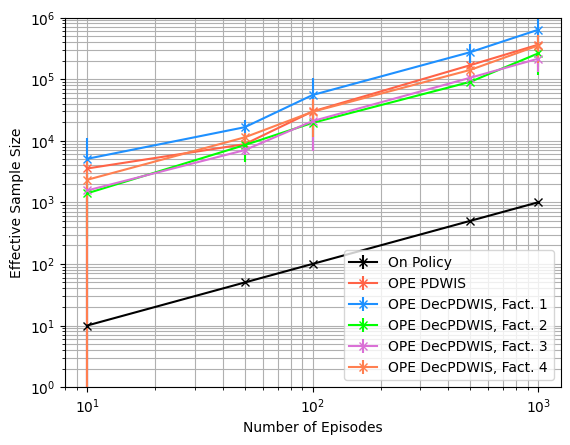

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**(6), shorter_D, estimator='PDWIS')

### Varying Episode Length $T$ With $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{T}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc

gc.collect()
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(500000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
LENGTHS = [1, 5, 10, 20]

bias_means = np.zeros((len(LENGTHS), 16))
bias_stds = np.zeros((len(LENGTHS), 16))
var_means = np.zeros((len(LENGTHS), 16))
var_stds = np.zeros((len(LENGTHS), 16))
MSE_means = np.zeros((len(LENGTHS), 16))
MSE_stds = np.zeros((len(LENGTHS), 16))
ESS_means = np.zeros((len(LENGTHS), 16))
ESS_stds = np.zeros((len(LENGTHS), 16))

RUNS = 100

for id in range(len(LENGTHS)):
  e = LENGTHS[id]
  print(f'{e} Steps, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

1 Steps, 100 ----------------------------------

Mean on policy Q estimate: -0.9575167238481792. Variance of on policy Q estimate: 0.01956356393185186
Mean OPE IS estimate: -1.0008030499991047. Bias1: 0.04328632615092523. Bias2: 0.043286326150925536. Variance: 0.18031478314584617. MSE: 0.18218848917749045
Mean OPE PDIS estimate: -1.0008030499991047. Bias1: 0.04328632615092523. Bias2: 0.043286326150925536. Variance: 0.18031478314584617. MSE: 0.18218848917749045
Mean OPE PDWIS estimate: -0.048845343939712314. Bias1: 0.9086713799084669. Bias2: 0.9086713799084669. Variance: 5.5230385648391725e-06. MSE: 0.8256891997033223
Mean OPE DecIS: Fact. 1 estimate: -1.1002594435733453. Bias1: 0.14274271972516597. Bias2: 0.14274271972516606. Variance: 0.17052447978253873. MSE: 0.19089996381707602
Mean OPE DecPDIS: Fact. 1 estimate: -0.969889348335101. Bias1: 0.012372624486923037. Bias2: 0.01237262448692178. Variance: 0.1256793270295633. MSE: 0.1258324088662577
Mean OPE DecPDWIS: Fact. 1 estimate: -0.0

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.02134115 0.01290457 0.01333292 0.0069765 ]
OPE DecIS, Fact. 1-----[0.14258197 0.14410737 0.13919977 0.14019373]
OPE DecIS, Fact. 2-----[0.11502173 0.1045643  0.10882541 0.10899594]
OPE DecIS, Fact. 3-----[0.04872125 0.05026706 0.05214468 0.05306711]
OPE DecIS, Fact. 4-----[0.02572847 0.02069615 0.01755612 0.01764803]


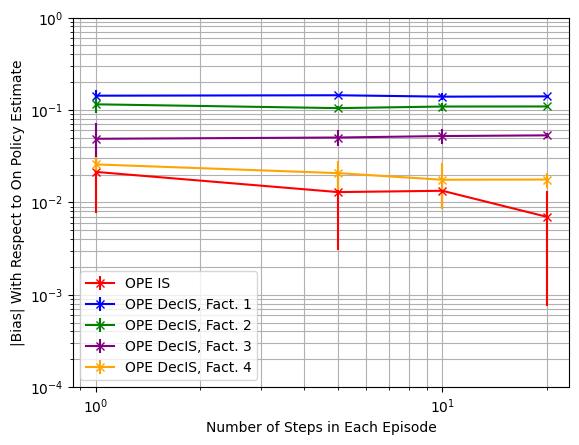

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.02134115 0.01290457 0.01333292 0.0069765 ]
OPE DecPDIS, Fact. 1-----[0.02218554 0.0100542  0.01271223 0.00765356]
OPE DecPDIS, Fact. 2-----[0.02175772 0.01273995 0.01348821 0.00792654]
OPE DecPDIS, Fact. 3-----[0.02053833 0.01191383 0.01285759 0.00688866]
OPE DecPDIS, Fact. 4-----[0.01605581 0.00874636 0.0108101  0.00657522]


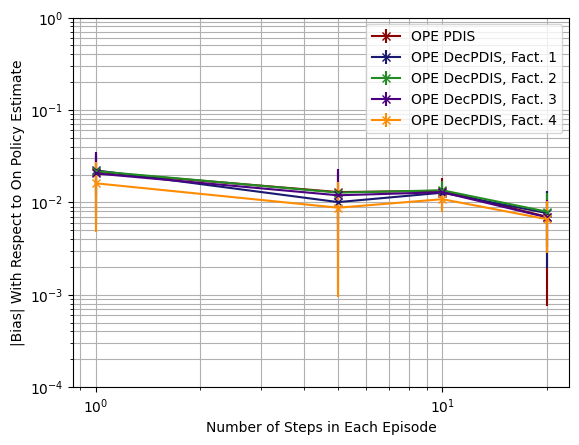

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.91199342 0.91293232 0.91479363 0.91384028]
OPE DecPDWIS, Fact. 1-----[0.91669971 0.91746096 0.91925821 0.91836098]
OPE DecPDWIS, Fact. 2-----[0.9058359  0.90647681 0.90849932 0.90759137]
OPE DecPDWIS, Fact. 3-----[0.90920535 0.91016785 0.91208856 0.91113208]
OPE DecPDWIS, Fact. 4-----[0.91099005 0.91172026 0.91364143 0.9127325 ]


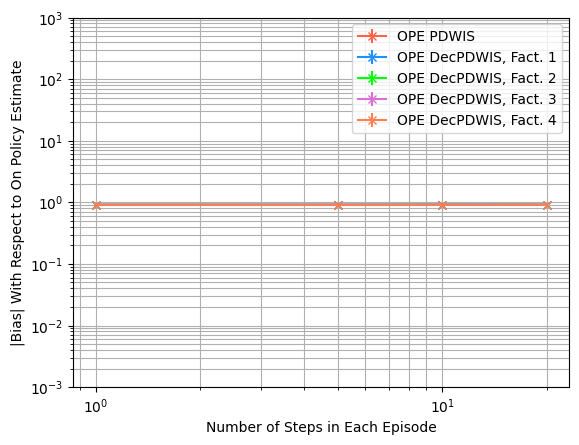

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.0212882  0.00465598 0.00222469 0.00124215]
OPE IS-----[0.13359348 0.02607503 0.01713198 0.00818373]
OPE DecIS, Fact. 1-----[0.1589363  0.02883211 0.01786429 0.00894053]
OPE DecIS, Fact. 2-----[0.09218084 0.01897749 0.01000106 0.0052664 ]
OPE DecIS, Fact. 3-----[0.11624717 0.02254699 0.01169725 0.00571899]
OPE DecIS, Fact. 4-----[0.08969716 0.01764945 0.00970371 0.00513117]


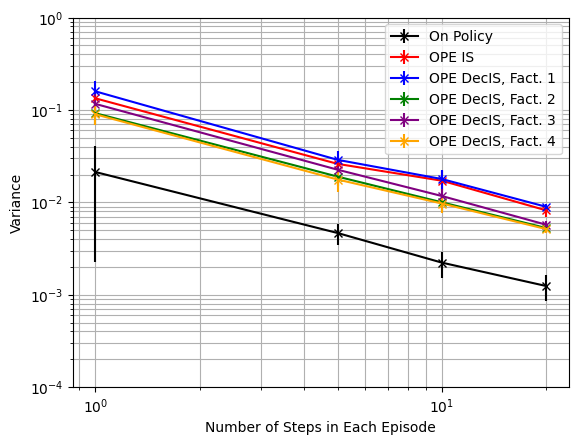

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

On Policy-----[0.0212882  0.00465598 0.00222469 0.00124215]
OPE PDIS-----[0.13359348 0.02607503 0.01713198 0.00818373]
OPE DecPDIS, Fact. 1-----[0.12193915 0.02199417 0.01370105 0.00689118]
OPE DecPDIS, Fact. 2-----[0.11283346 0.0233713  0.01275523 0.00680265]
OPE DecPDIS, Fact. 3-----[0.1280337  0.02505396 0.0132476  0.00663051]
OPE DecPDIS, Fact. 4-----[0.08214934 0.01670532 0.00918392 0.00495262]


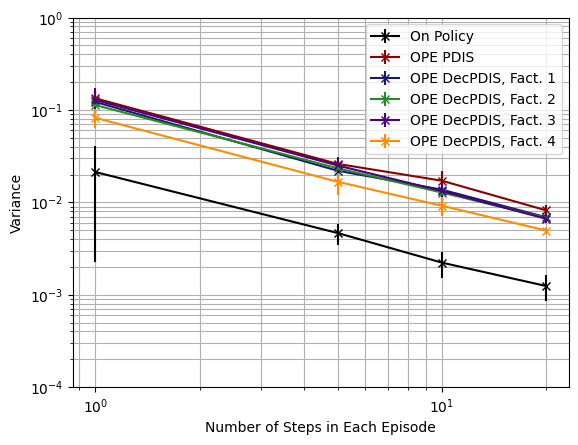

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.0212882  0.00465598 0.00222469 0.00124215]
OPE PDWIS-----[2.46319590e-05 1.05779432e-05 7.88180740e-06 3.39570965e-06]
OPE DecPDWIS, Fact. 1-----[1.97700243e-05 6.29936179e-06 3.95325887e-06 2.07949133e-06]
OPE DecPDWIS, Fact. 2-----[5.06074209e-05 1.47845927e-05 1.01099075e-05 5.24979836e-06]
OPE DecPDWIS, Fact. 3-----[3.92312921e-05 1.64973482e-05 1.05424757e-05 5.36575910e-06]
OPE DecPDWIS, Fact. 4-----[3.27818289e-05 1.08277177e-05 6.76413084e-06 3.68046525e-06]


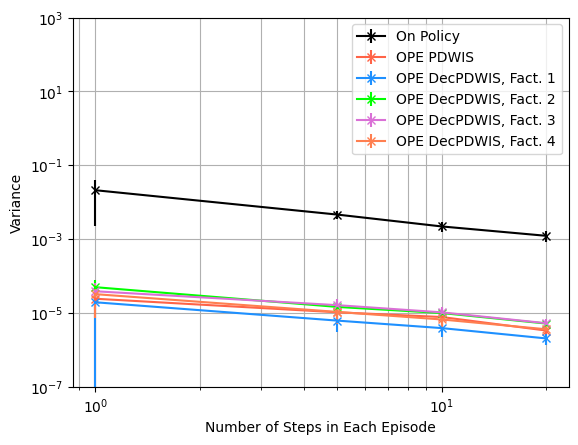

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.0212882  0.00465598 0.00222469 0.00124215]
OPE IS-----[0.13423637 0.02633901 0.0173339  0.00827102]
OPE DecIS, Fact. 1-----[0.17981897 0.04961644 0.0373809  0.0286304 ]
OPE DecIS, Fact. 2-----[0.10588312 0.02994287 0.02196605 0.01716854]
OPE DecIS, Fact. 3-----[0.11917406 0.02517319 0.01451389 0.00854874]
OPE DecIS, Fact. 4-----[0.09038382 0.01812989 0.01009449 0.00545385]


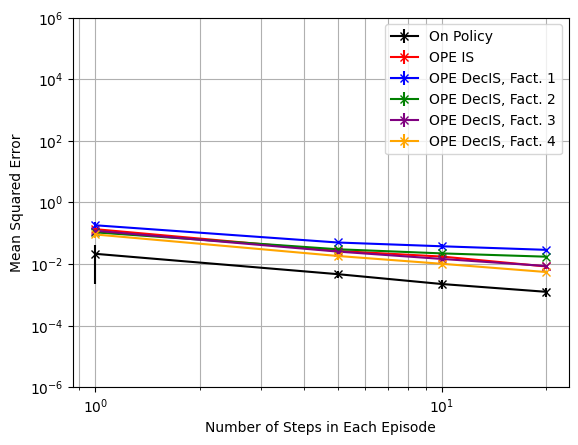

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='IS')

On Policy-----[0.0212882  0.00465598 0.00222469 0.00124215]
OPE PDIS-----[0.13423637 0.02633901 0.0173339  0.00827102]
OPE DecPDIS, Fact. 1-----[0.12254173 0.02210849 0.01387293 0.0069821 ]
OPE DecPDIS, Fact. 2-----[0.11342079 0.02359416 0.01295018 0.00688723]
OPE DecPDIS, Fact. 3-----[0.1286749  0.02531256 0.01341502 0.006691  ]
OPE DecPDIS, Fact. 4-----[0.08253334 0.01684283 0.00930964 0.00500998]


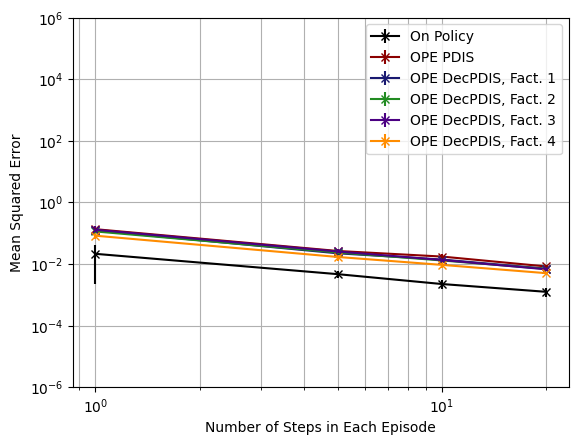

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='PDIS')

On Policy-----[0.0212882  0.00465598 0.00222469 0.00124215]
OPE PDWIS-----[0.83187973 0.83348454 0.8368757  0.83511224]
OPE DecPDWIS, Fact. 1-----[0.84048438 0.84176997 0.84506039 0.8433936 ]
OPE DecPDWIS, Fact. 2-----[0.82071688 0.82174428 0.82540233 0.82373212]
OPE DecPDWIS, Fact. 3-----[0.82682082 0.82845213 0.8319369  0.83017194]
OPE DecPDWIS, Fact. 4-----[0.83006371 0.8312744  0.83476834 0.83308906]


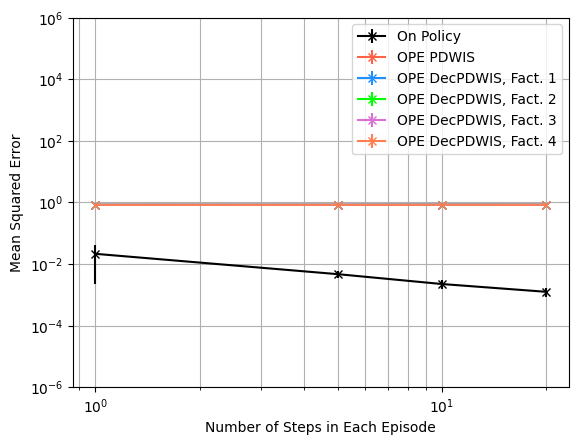

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[ 1.  5. 10. 20.]
OPE IS-----[0.15222908 0.92925991 1.39663034 3.19314971]
OPE DecIS, Fact. 1-----[0.11748792 0.85352919 1.27836478 2.84821492]
OPE DecIS, Fact. 2-----[0.21716655 1.23856656 2.28352724 4.77762135]
OPE DecIS, Fact. 3-----[0.15950278 1.04113939 1.8837803  4.38715378]
OPE DecIS, Fact. 4-----[0.20775944 1.36925466 2.31831959 4.88290408]


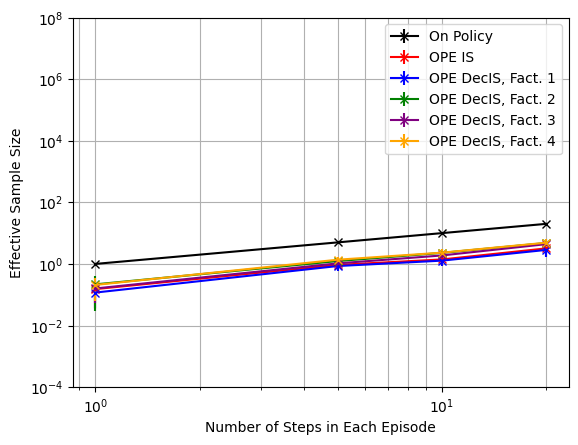

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='IS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDIS-----[0.15222908 0.92925991 1.39663034 3.19314971]
OPE DecPDIS, Fact. 1-----[0.1534665  1.13275571 1.66840702 3.70735477]
OPE DecPDIS, Fact. 2-----[0.18287343 1.0039033  1.77679639 3.67439365]
OPE DecPDIS, Fact. 3-----[0.14435661 0.93903564 1.66236932 3.79586947]
OPE DecPDIS, Fact. 4-----[0.22753128 1.45278825 2.45827739 5.03925821]


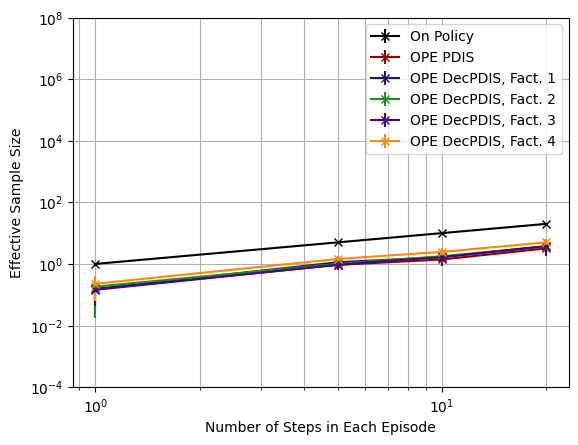

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='PDIS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDWIS-----[1309.61159755 2988.07479266 3447.63485358 8948.11478756]
OPE DecPDWIS, Fact. 1-----[ 1471.17895132  6069.19038109  6044.64328773 12541.95122025]
OPE DecPDWIS, Fact. 2-----[ 371.42560688 1902.41819126 2733.10497268 4744.99573508]
OPE DecPDWIS, Fact. 3-----[ 553.5009254  1759.96436943 2653.74241621 4993.98147623]
OPE DecPDWIS, Fact. 4-----[ 670.13048079 2915.61026013 4058.68626713 6852.03182114]


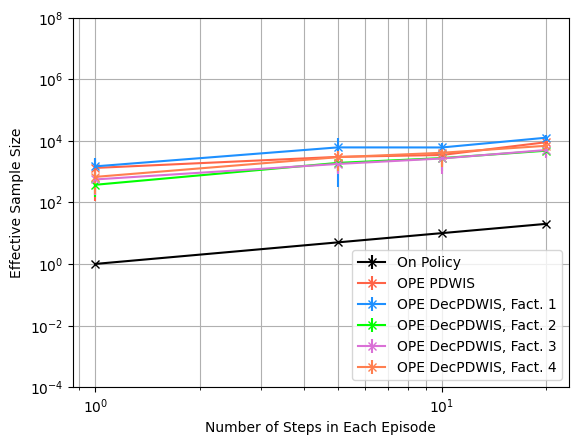

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

## From Patient State 63, With Diabetes

In [ ]:
#The patient has diabetes
PROB_DIAB = 1.0

### State Analysis

In [ ]:
#Instantiate a state based on the idx and get the state vector
testState = State(state_idx = 63, diabetic_idx=1)
vec = testState.get_state_vector()

print(vec)
print(f'Num abnormals: {testState.get_num_abnormal()}\n')

print(f'Heart Rate: {hr_state_mapping[vec[0]]}')
print(f'Systolic Blood Pressure: {sbp_state_mapping[vec[1]]}')
print(f'Percent Oxygen: {o2_state_mapping[vec[2]]}')
print(f'Glucose Level: {glu_state_mapping[vec[3]]}')
print(f'Antibiotics: {abx_state_mapping[vec[4]]}')
print(f'Vasopressors: {vaso_state_mapping[vec[5]]}')
print(f'Ventilator: {vent_state_mapping[vec[6]]}')
print(f'Diabetes: {testState.diabetic_idx}')

[0 0 1 2 1 1 1]
Num abnormals: 2

Heart Rate: Low
Systolic Blood Pressure: Low
Percent Oxygen: Normal
Glucose Level: Normal
Antibiotics: On
Vasopressors: On
Ventilator: On
Diabetes: 1


### Generate Data From Behaviour Policy

Run the data generator

In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=randPol, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

Convert data into array format

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_b = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_b.shape

(100000, 20, 5)

In [ ]:
f_tr_b1, f_tr_b2, f_tr_b3, f_tr_b4 = factorise_dataset(nf_tr_b)

In [ ]:
print(nf_tr_b)

[[[  0.  63.   0.  -1.  48.]
  [  1.  48.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0.  63.   2.  -1.  65.]
  [  1.  65.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0.  63.   5.  -1. 230.]
  [  1. 230.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 ...

 [[  0.  63.   2.  -1.  65.]
  [  1.  65.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0.  63.   1.  -1. 226.]
  [  1. 226.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0.  63.   3.   0. 147.]
  [  1. 147.   5.  -1. 238.]
  [  2. 238.  -1.   0.  -1

In [ ]:
print(f_tr_b1)

[[[[  0.   63.    0.   -0.5  48. ]
   [  0.   63.    0.   -0.5  48. ]]

  [[  1.   48.    1.    0.   -1. ]
   [  1.   48.   -1.    0.   -1. ]]

  [[  2.   -1.    1.    0.   -1. ]
   [  2.   -1.   -1.    0.   -1. ]]

  ...

  [[ 17.   -1.    1.    0.   -1. ]
   [ 17.   -1.   -1.    0.   -1. ]]

  [[ 18.   -1.    1.    0.   -1. ]
   [ 18.   -1.   -1.    0.   -1. ]]

  [[ 19.   -1.    1.    0.   -1. ]
   [ 19.   -1.   -1.    0.   -1. ]]]


 [[[  0.   63.    1.   -0.5  65. ]
   [  0.   63.    0.   -0.5  65. ]]

  [[  1.   65.    1.    0.   -1. ]
   [  1.   65.   -1.    0.   -1. ]]

  [[  2.   -1.    1.    0.   -1. ]
   [  2.   -1.   -1.    0.   -1. ]]

  ...

  [[ 17.   -1.    1.    0.   -1. ]
   [ 17.   -1.   -1.    0.   -1. ]]

  [[ 18.   -1.    1.    0.   -1. ]
   [ 18.   -1.   -1.    0.   -1. ]]

  [[ 19.   -1.    1.    0.   -1. ]
   [ 19.   -1.   -1.    0.   -1. ]]]


 [[[  0.   63.    0.   -0.5 230. ]
   [  0.   63.    3.   -0.5 230. ]]

  [[  1.  230.    1.    0.   -1. ]
   [  1.  2

In [ ]:
factored_randPol1 = factor_policy_1(randPol)
factored_randPol2 = factor_policy_2(randPol)
factored_randPol3 = factor_policy_3(randPol)
factored_randPol4 = factor_policy_4(randPol)

In [ ]:
randPol = pad_policy(randPol)

factored_randPol1[0] = pad_policy(factored_randPol1[0])
factored_randPol1[1] = pad_policy(factored_randPol1[1])

factored_randPol2[0] = pad_policy(factored_randPol2[0])
factored_randPol2[1] = pad_policy(factored_randPol2[1])

factored_randPol3[0] = pad_policy(factored_randPol3[0])
factored_randPol3[1] = pad_policy(factored_randPol3[1])

factored_randPol4[0] = pad_policy(factored_randPol4[0])
factored_randPol4[1] = pad_policy(factored_randPol4[1])
factored_randPol4[2] = pad_policy(factored_randPol4[2])

### Varying Episodes $\epsilon_{e} = 0.4$ (Policy Divergence $4.8^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
EVAL_EPSILON = 0.4

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

4.8


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.9012583342090572. Variance of on policy Q estimate: 0.012730880425591926
Mean OPE IS estimate: -0.8576688132867382. Bias1: 0.043589520922318443. Bias2: 0.04358952092231905. Variance: 0.3764348307021204. MSE: 0.37833487703635765
Mean OPE PDIS estimate: -0.8576688132867382. Bias1: 0.043589520922318443. Bias2: 0.04358952092231905. Variance: 0.3764348307021204. MSE: 0.37833487703635765
Mean OPE PDWIS estimate: -0.045080741013692416. Bias1: 0.8561775931953648. Bias2: 0.8561775931953648. Variance: 8.655423957012203e-05. MSE: 0.7331266253293778
Mean OPE DecIS: Fact. 1 estimate: -1.2614475933116756. Bias1: 0.3601892591026183. Bias2: 0.36018925910261834. Variance: 0.21498958402337814. MSE: 0.3447258863962712
Mean OPE DecPDIS: Fact. 1 estimate: -0.8844009888868847. Bias1: 0.016857345322172142. Bias2: 0.016857345322172534. Variance: 0.1617103986582981. MSE: 0.16199456874960905
Mean OPE DecPDWIS: Fact. 1 estimate: -0

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.1641137  0.07960907 0.09694149 0.09516229 0.0653294 ]
OPE DecIS, Fact. 1-----[0.3986382  0.4383306  0.43600784 0.44604712 0.46966818]
OPE DecIS, Fact. 2-----[0.31517531 0.21472637 0.21944768 0.20366585 0.20686436]
OPE DecIS, Fact. 3-----[0.0892211  0.05495017 0.05849924 0.0484744  0.02657336]
OPE DecIS, Fact. 4-----[0.20770786 0.176814   0.15976243 0.1615198  0.16964465]


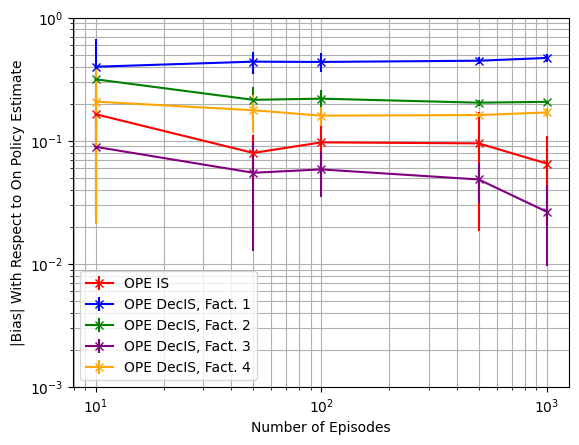

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.1641137  0.07960907 0.09694149 0.09516229 0.0653294 ]
OPE DecPDIS, Fact. 1-----[0.11148809 0.06605729 0.06346703 0.04883202 0.0669139 ]
OPE DecPDIS, Fact. 2-----[0.08798812 0.05820906 0.04812653 0.04725609 0.05108128]
OPE DecPDIS, Fact. 3-----[0.12025714 0.08873798 0.03140262 0.12603852 0.10570945]
OPE DecPDIS, Fact. 4-----[0.13702724 0.07144967 0.06611127 0.06399103 0.07310556]


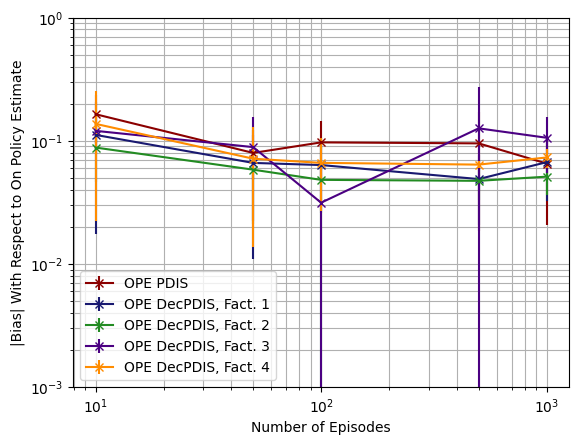

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.84365946 0.83728578 0.84065594 0.83665375 0.83657422]
OPE DecPDWIS, Fact. 1-----[0.85316118 0.84653725 0.84966904 0.8463984  0.84575195]
OPE DecPDWIS, Fact. 2-----[0.81786948 0.81663923 0.82014127 0.81757829 0.81719221]
OPE DecPDWIS, Fact. 3-----[0.84023348 0.83442206 0.83769205 0.83277809 0.83227325]
OPE DecPDWIS, Fact. 4-----[0.83192568 0.82968655 0.83311864 0.83038418 0.82989467]


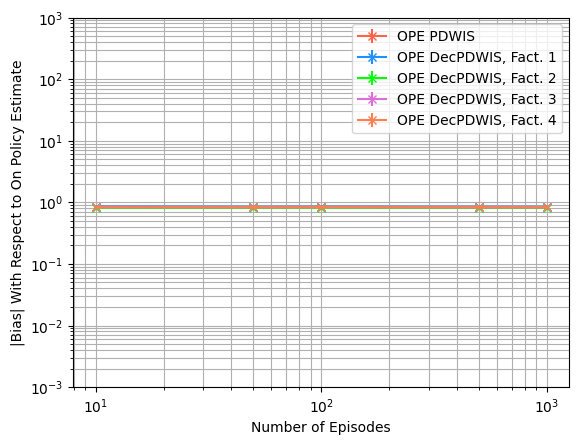

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.01428671 0.00258562 0.00127186 0.00025777 0.00015257]
OPE IS-----[0.82893536 0.14335281 0.04508091 0.29290047 0.1114514 ]
OPE DecIS, Fact. 1-----[1.25795129 0.26078854 0.07664528 0.02224496 0.02101621]
OPE DecIS, Fact. 2-----[0.11040955 0.05336776 0.02488577 0.00725888 0.00320486]
OPE DecIS, Fact. 3-----[0.46172422 0.04725841 0.01889821 0.10263569 0.04933978]
OPE DecIS, Fact. 4-----[0.67474025 0.11706094 0.0332407  0.0059889  0.00412087]


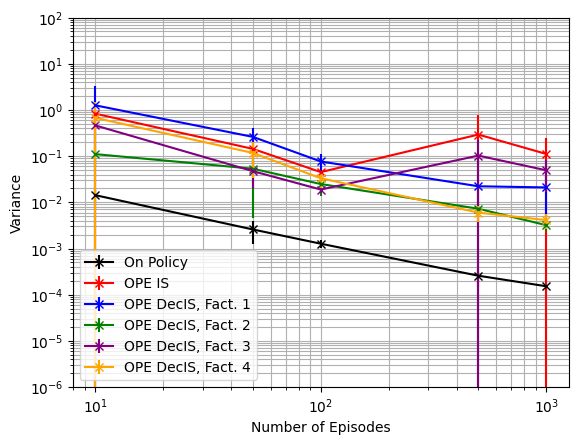

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-6), 10**2, shorter_D, estimator='IS')

On Policy-----[0.01428671 0.00258562 0.00127186 0.00025777 0.00015257]
OPE PDIS-----[0.82893536 0.14335281 0.04508091 0.29290047 0.1114514 ]
OPE DecPDIS, Fact. 1-----[0.42744661 0.11439895 0.03650972 0.01671729 0.01911423]
OPE DecPDIS, Fact. 2-----[0.1860974  0.06751657 0.036659   0.01019073 0.00805144]
OPE DecPDIS, Fact. 3-----[0.55696863 0.07880963 0.03391714 0.5844763  0.17324555]
OPE DecPDIS, Fact. 4-----[0.34156384 0.05844465 0.02297009 0.00465204 0.00493466]


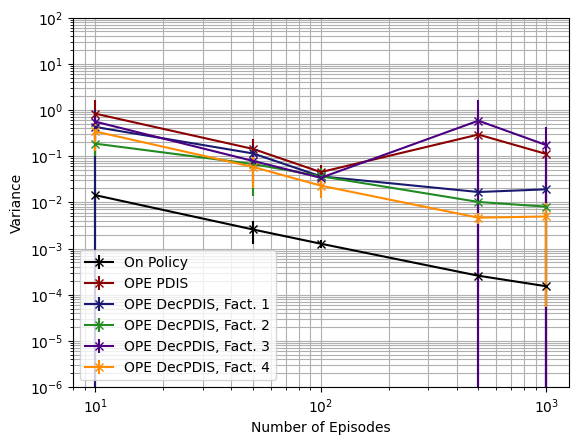

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**2, shorter_D, estimator='PDIS')

On Policy-----[0.01428671 0.00258562 0.00127186 0.00025777 0.00015257]
OPE PDWIS-----[3.68494308e-05 1.55662872e-05 7.91727135e-06 4.12140834e-06
 2.92119003e-05]
OPE DecPDWIS, Fact. 1-----[2.99599547e-05 6.96923311e-06 2.96694473e-06 1.31505476e-06
 1.03150458e-06]
OPE DecPDWIS, Fact. 2-----[3.96153275e-04 1.07161432e-04 6.10684671e-05 2.59764343e-05
 2.39892324e-05]
OPE DecPDWIS, Fact. 3-----[1.86868099e-04 7.36208578e-05 4.01001380e-05 6.06096579e-05
 5.30137568e-05]
OPE DecPDWIS, Fact. 4-----[1.84203851e-04 4.94517470e-05 3.01923223e-05 1.21619011e-05
 1.33177769e-05]


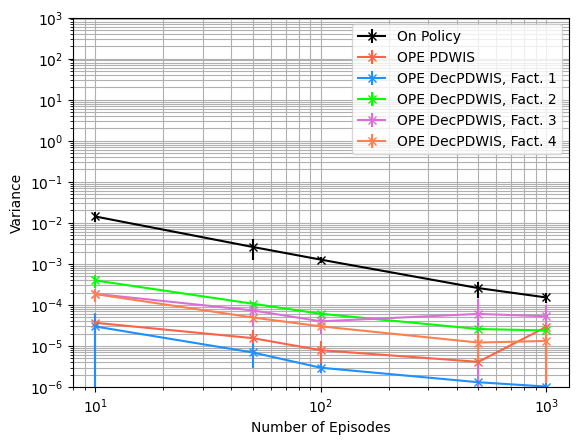

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.01428671 0.00258562 0.00127186 0.00025777 0.00015257]
OPE IS-----[0.86063331 0.15068725 0.05665947 0.30781966 0.11772782]
OPE DecIS, Fact. 1-----[1.4905562  0.46072495 0.27250961 0.22205297 0.24306512]
OPE DecIS, Fact. 2-----[0.21064792 0.10305493 0.07460413 0.04888777 0.04601497]
OPE DecIS, Fact. 3-----[0.47385349 0.05206577 0.02288396 0.10527448 0.05033241]
OPE DecIS, Fact. 4-----[0.75268272 0.15188297 0.0594953  0.03212271 0.03307439]


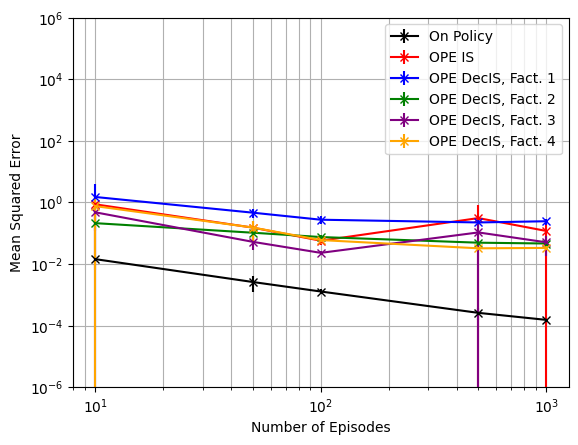

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='IS')

On Policy-----[0.01428671 0.00258562 0.00127186 0.00025777 0.00015257]
OPE PDIS-----[0.86063331 0.15068725 0.05665947 0.30781966 0.11772782]
OPE DecPDIS, Fact. 1-----[0.44870217 0.12178884 0.04194782 0.01988767 0.02477794]
OPE DecPDIS, Fact. 2-----[0.19558101 0.07227871 0.04221867 0.01263332 0.01089021]
OPE DecPDIS, Fact. 3-----[0.57307167 0.09108656 0.03589419 0.62122209 0.18703977]
OPE DecPDIS, Fact. 4-----[0.37345681 0.0668944  0.02886302 0.00876225 0.01043698]


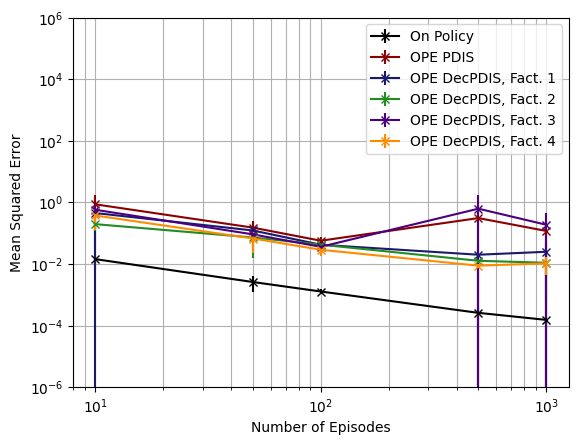

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='PDIS')

On Policy-----[0.01428671 0.00258562 0.00127186 0.00025777 0.00015257]
OPE PDWIS-----[0.71199352 0.70152973 0.70685013 0.70000732 0.69990003]
OPE DecPDWIS, Fact. 1-----[0.72812586 0.71708534 0.72207955 0.71640213 0.71530604]
OPE DecPDWIS, Fact. 2-----[0.66942176 0.6674591  0.67287608 0.66846729 0.6678355 ]
OPE DecPDWIS, Fact. 3-----[0.70636653 0.69685113 0.70192542 0.6935925  0.69273697]
OPE DecPDWIS, Fact. 4-----[0.69242464 0.68886699 0.69427551 0.68955861 0.6887468 ]


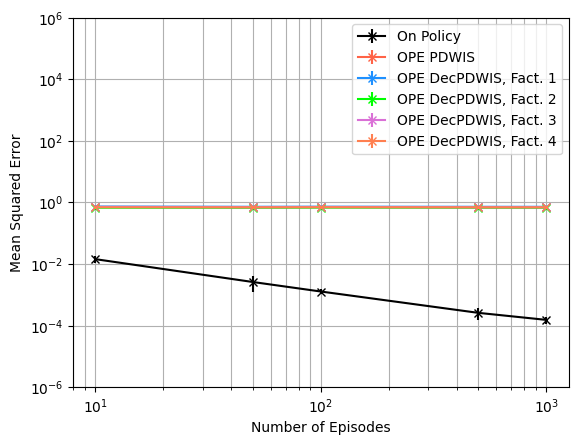

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[ 0.5013097   1.43322764  3.59719633 10.39807002  4.28952556]
OPE DecIS, Fact. 1-----[ 0.48782008  0.98893736  2.24978687 14.07777761 11.09092993]
OPE DecIS, Fact. 2-----[ 1.74470188  3.98988844  7.47900698 20.906895   51.44683261]
OPE DecIS, Fact. 3-----[ 0.75217178  3.66861918  6.84712763 13.92824139 10.71692289]
OPE DecIS, Fact. 4-----[ 0.54132284  2.87550151  5.06408888 26.39284896 39.26638822]


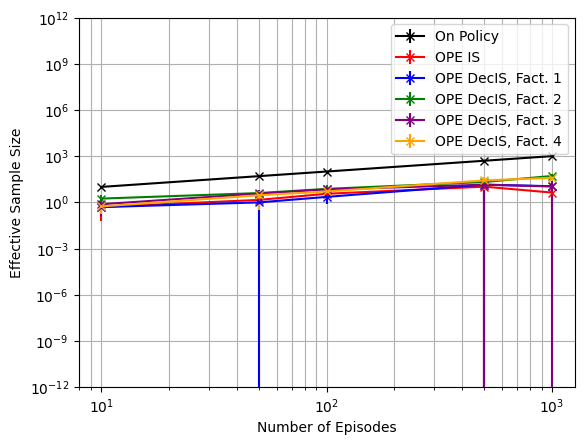

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-12), 10**12, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[ 0.5013097   1.43322764  3.59719633 10.39807002  4.28952556]
OPE DecPDIS, Fact. 1-----[ 0.91801501  1.72807157  4.33513371 21.89029926 17.20607622]
OPE DecPDIS, Fact. 2-----[ 0.99944002  2.92922936  4.46647823 12.32861081 42.71491075]
OPE DecPDIS, Fact. 3-----[0.39813294 2.61424085 4.32017494 7.66037721 5.24184445]
OPE DecPDIS, Fact. 4-----[ 0.78202241  4.81465025  7.45996157 27.78579624 52.49102756]


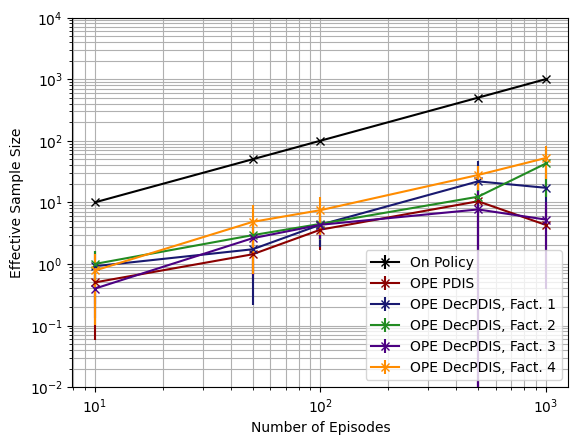

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-2), 10**4, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[ 6184.60159432 17435.62940248 24538.97126063 47591.34967762
 59278.77393478]
OPE DecPDWIS, Fact. 1-----[ 11274.62542415  27543.31996797  45511.82446535 158166.62540863
 184241.58094395]
OPE DecPDWIS, Fact. 2-----[  391.40298626  1261.50007657  2126.34072607  6120.77873313
 10852.21602071]
OPE DecPDWIS, Fact. 3-----[ 764.8593276  2098.14182269 3770.41132135 7544.37151017 5469.58139675]
OPE DecPDWIS, Fact. 4-----[  863.42165146  2643.32511631  4294.02653462 13643.54277601
 24664.16871351]


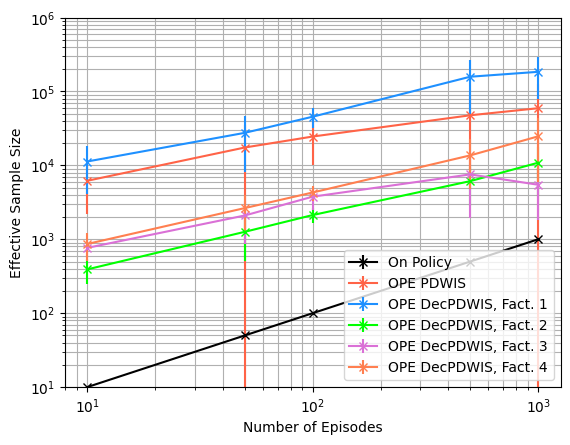

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(1), 10**(6), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.6$ (Policy Divergence $3.2^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc

gc.collect()
EVAL_EPSILON = 0.6

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

3.2


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.9533337162051119. Variance of on policy Q estimate: 0.003980357975496059
Mean OPE IS estimate: -1.0438211519533402. Bias1: 0.09048743574822922. Bias2: 0.09048743574822837. Variance: 0.44277025911974055. MSE: 0.45095823514803046
Mean OPE PDIS estimate: -1.0438211519533402. Bias1: 0.09048743574822922. Bias2: 0.09048743574822837. Variance: 0.44277025911974055. MSE: 0.45095823514803046
Mean OPE PDWIS estimate: -0.047056605327105254. Bias1: 0.9062771108780067. Bias2: 0.9062771108780067. Variance: 3.2580387013853476e-05. MSE: 0.8213707820884005
Mean OPE DecIS: Fact. 1 estimate: -1.3204930686247334. Bias1: 0.3671593524196216. Bias2: 0.3671593524196215. Variance: 0.1817238870737996. MSE: 0.3165298771429955
Mean OPE DecPDIS: Fact. 1 estimate: -0.9910818393505949. Bias1: 0.03774812314548373. Bias2: 0.03774812314548304. Variance: 0.10044311890180253. MSE: 0.10186803970280914
Mean OPE DecPDWIS: Fact. 1 estimate: -0.0

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.07433759 0.02159236 0.03408936 0.03054888 0.02353562]
OPE DecIS, Fact. 1-----[0.29275335 0.32232923 0.3197387  0.32829239 0.33792049]
OPE DecIS, Fact. 2-----[0.2063814  0.16075816 0.16624928 0.15696802 0.15824191]
OPE DecIS, Fact. 3-----[0.11623932 0.04407012 0.01707087 0.03606387 0.03729967]
OPE DecIS, Fact. 4-----[0.14915258 0.12169822 0.1102076  0.1134884  0.11861368]


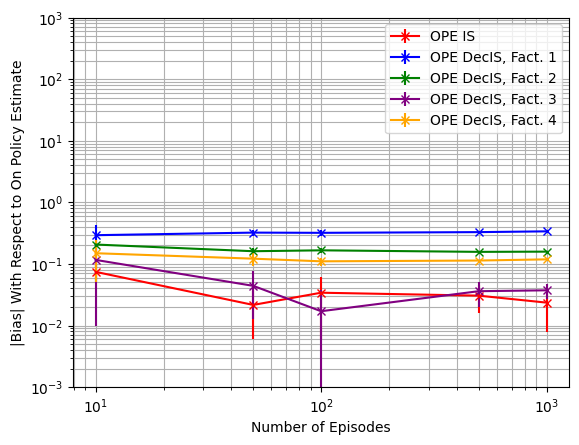

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='IS')

OPE PDIS-----[0.07433759 0.02159236 0.03408936 0.03054888 0.02353562]
OPE DecPDIS, Fact. 1-----[0.07478995 0.02951576 0.02732933 0.01606523 0.02131563]
OPE DecPDIS, Fact. 2-----[0.05463209 0.01569369 0.02419213 0.01105385 0.01156913]
OPE DecPDIS, Fact. 3-----[0.11225017 0.05397343 0.02694351 0.0253719  0.02321973]
OPE DecPDIS, Fact. 4-----[0.09736119 0.02992698 0.02617431 0.01618119 0.02075114]


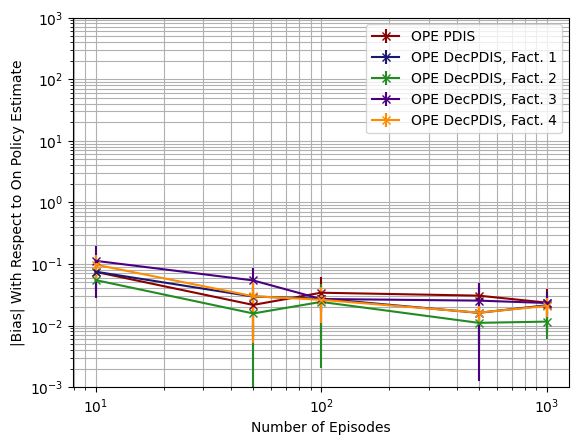

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.89869747 0.89634454 0.89865013 0.89647276 0.89654031]
OPE DecPDWIS, Fact. 1-----[0.90737579 0.90498021 0.90707694 0.9051417  0.90504268]
OPE DecPDWIS, Fact. 2-----[0.88760229 0.88663899 0.8885703  0.88697843 0.88703851]
OPE DecPDWIS, Fact. 3-----[0.89981435 0.89797166 0.90001399 0.89763563 0.89765873]
OPE DecPDWIS, Fact. 4-----[0.89656326 0.89560642 0.89757455 0.89587509 0.89580739]


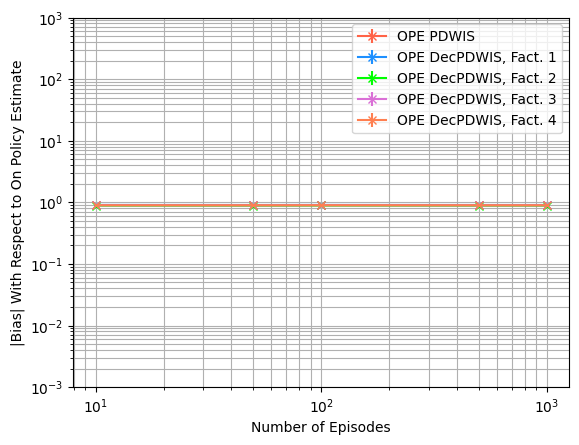

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[5.69499601e-03 1.12243832e-03 5.49643583e-04 1.05589433e-04
 4.41600607e-05]
OPE IS-----[0.31319657 0.05514608 0.01766681 0.01790527 0.00963796]
OPE DecIS, Fact. 1-----[0.27559885 0.07600948 0.02508479 0.00547725 0.00329461]
OPE DecIS, Fact. 2-----[0.0671491  0.02251285 0.00936543 0.00241032 0.00121898]
OPE DecIS, Fact. 3-----[0.40195877 0.03583721 0.01166765 0.01391821 0.00572084]
OPE DecIS, Fact. 4-----[0.24634554 0.04114053 0.01183987 0.00216367 0.00140772]


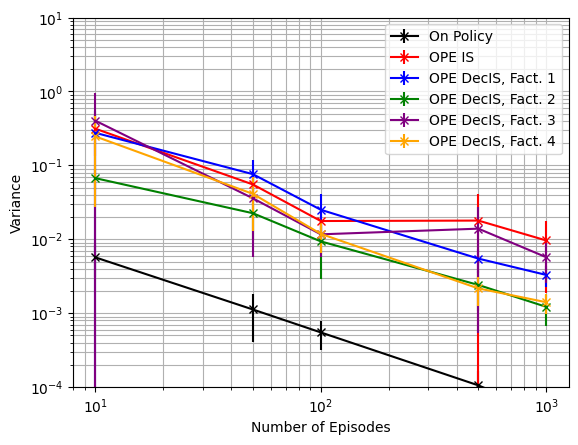

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**1, shorter_D, estimator='IS')

On Policy-----[5.69499601e-03 1.12243832e-03 5.49643583e-04 1.05589433e-04
 4.41600607e-05]
OPE PDIS-----[0.31319657 0.05514608 0.01766681 0.01790527 0.00963796]
OPE DecPDIS, Fact. 1-----[0.12721876 0.04113253 0.01472093 0.0038438  0.00243532]
OPE DecPDIS, Fact. 2-----[0.09703547 0.02759729 0.01399911 0.00326442 0.0018168 ]
OPE DecPDIS, Fact. 3-----[0.42602081 0.04481146 0.01624548 0.02692716 0.00895381]
OPE DecPDIS, Fact. 4-----[0.20118552 0.02846761 0.01056226 0.00185234 0.00132071]


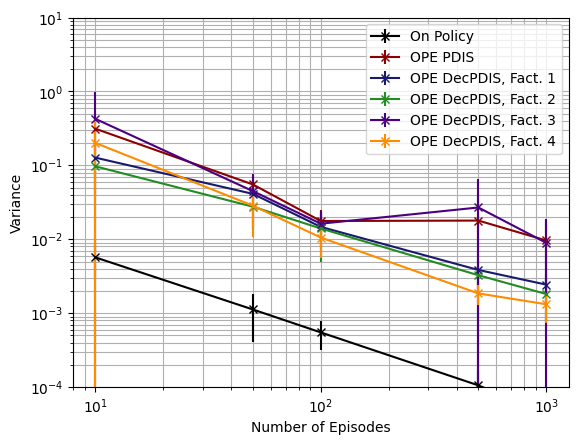

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**1, shorter_D, estimator='PDIS')

On Policy-----[5.69499601e-03 1.12243832e-03 5.49643583e-04 1.05589433e-04
 4.41600607e-05]
OPE PDWIS-----[1.84772929e-05 6.51775837e-06 3.59087666e-06 1.89571582e-06
 3.91766438e-06]
OPE DecPDWIS, Fact. 1-----[1.86220707e-05 4.23495601e-06 1.87288537e-06 1.18552733e-06
 6.14250271e-07]
OPE DecPDWIS, Fact. 2-----[8.63946980e-05 2.08716891e-05 1.05204570e-05 4.09214858e-06
 4.42850407e-06]
OPE DecPDWIS, Fact. 3-----[4.88142621e-05 1.38105211e-05 6.71522525e-06 8.17540439e-06
 5.56436784e-06]
OPE DecPDWIS, Fact. 4-----[3.95705799e-05 9.98678745e-06 5.45538145e-06 2.00556375e-06
 2.09955503e-06]


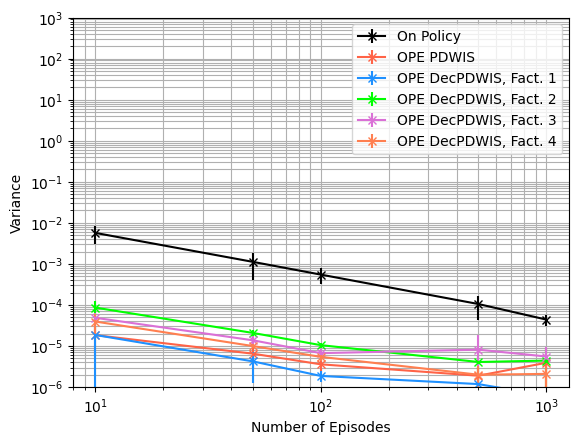

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[5.69499601e-03 1.12243832e-03 5.49643583e-04 1.05589433e-04
 4.41600607e-05]
OPE IS-----[0.3191281  0.05585506 0.01962036 0.01905723 0.01043757]
OPE DecIS, Fact. 1-----[0.37778336 0.18123024 0.12835668 0.11346812 0.11774246]
OPE DecIS, Fact. 2-----[0.11032955 0.04888068 0.03729607 0.02707745 0.0262666 ]
OPE DecIS, Fact. 3-----[0.42680258 0.03876603 0.01238657 0.01546707 0.00722785]
OPE DecIS, Fact. 4-----[0.27838522 0.05680402 0.02425367 0.01505432 0.01554171]


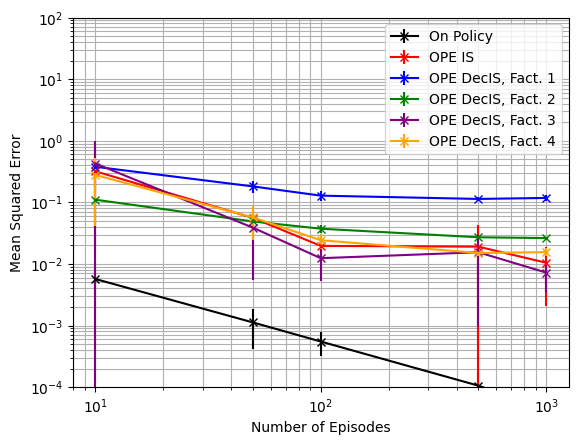

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**2, shorter_D, estimator='IS')

On Policy-----[5.69499601e-03 1.12243832e-03 5.49643583e-04 1.05589433e-04
 4.41600607e-05]
OPE PDIS-----[0.3191281  0.05585506 0.01962036 0.01905723 0.01043757]
OPE DecPDIS, Fact. 1-----[0.13411182 0.04253537 0.01558284 0.00422981 0.00307857]
OPE DecPDIS, Fact. 2-----[0.10037125 0.02805968 0.01507632 0.00343339 0.00198132]
OPE DecPDIS, Fact. 3-----[0.44580969 0.04872413 0.01706054 0.02815226 0.00955858]
OPE DecPDIS, Fact. 4-----[0.21226541 0.02997742 0.01148346 0.00213832 0.00180385]


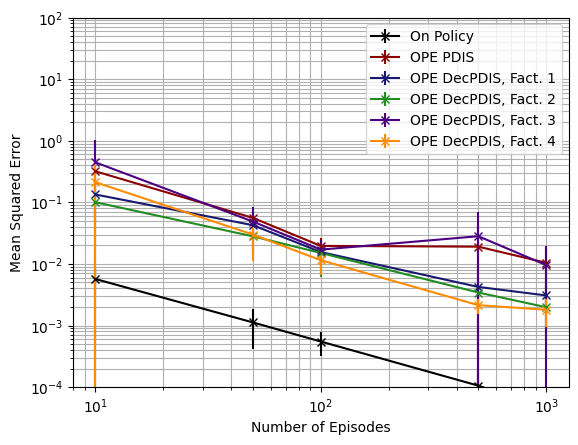

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**2, shorter_D, estimator='PDIS')

On Policy-----[5.69499601e-03 1.12243832e-03 5.49643583e-04 1.05589433e-04
 4.41600607e-05]
OPE PDWIS-----[0.80769617 0.80350579 0.80759775 0.80367244 0.80379249]
OPE DecPDWIS, Fact. 1-----[0.82336753 0.81905752 0.82281297 0.81929034 0.81910644]
OPE DecPDWIS, Fact. 2-----[0.78794716 0.78621243 0.78959327 0.78674143 0.78684511]
OPE DecPDWIS, Fact. 3-----[0.80973079 0.80643292 0.81005406 0.80576407 0.80579922]
OPE DecPDWIS, Fact. 4-----[0.80388469 0.8021828  0.80567034 0.80260124 0.80247609]


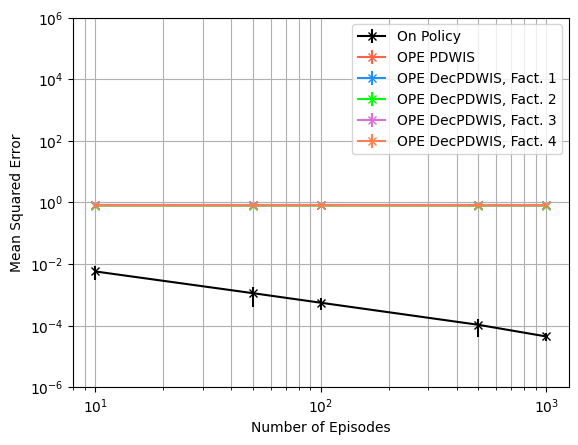

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[ 0.32054664  1.33891559  3.24751183 12.41587077  8.01386573]
OPE DecIS, Fact. 1-----[ 0.38096539  1.01430305  2.73728347 13.71332521 14.46007251]
OPE DecIS, Fact. 2-----[ 0.97018478  4.13001555  7.79714473 34.57449948 43.13304688]
OPE DecIS, Fact. 3-----[ 1.058108    2.85219067  5.10176473 15.38622108 17.0263449 ]
OPE DecIS, Fact. 4-----[ 1.04716602  3.4892619   5.4155397  27.92824907 33.76122067]


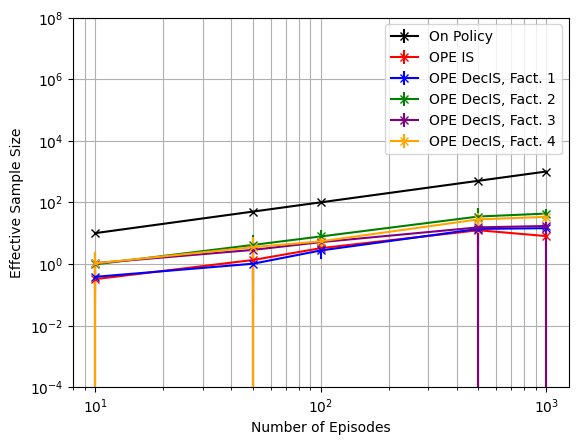

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[ 0.32054664  1.33891559  3.24751183 12.41587077  8.01386573]
OPE DecPDIS, Fact. 1-----[ 0.63475288  1.45018081  4.34653003 19.47747099 21.20820238]
OPE DecPDIS, Fact. 2-----[ 0.63128231  3.99060962  5.80618866 17.64467509 35.54795138]
OPE DecPDIS, Fact. 3-----[ 0.66575937  2.69248768  3.778219   10.82701918 13.34613744]
OPE DecPDIS, Fact. 4-----[ 1.32573916  4.46561161  6.34154354 28.14404558 37.81389691]


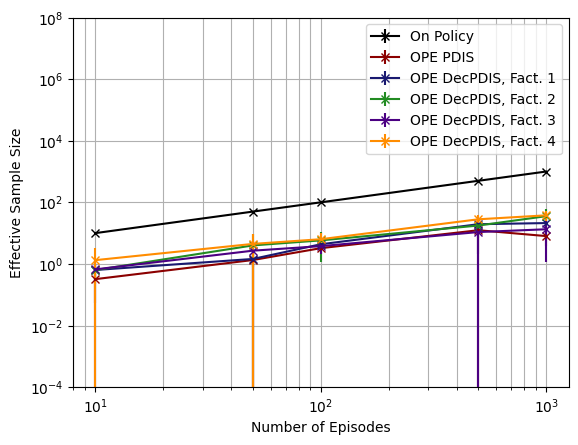

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[ 5914.91877533 21361.5724525  15296.46737263 43876.82748138
 33002.88728383]
OPE DecPDWIS, Fact. 1-----[ 8025.6138777  29134.07420626 30624.26561404 73749.67613535
 78959.40182404]
OPE DecPDWIS, Fact. 2-----[  831.3238625   2982.12153702  5390.19175011 15483.53729556
 18568.09478358]
OPE DecPDWIS, Fact. 3-----[ 1397.90299406  5411.13978547  8774.47425313 20580.71403605
 17893.14133665]
OPE DecPDWIS, Fact. 4-----[ 1772.75154271  5914.44104853 10167.40290778 28597.05138998
 35507.7787395 ]


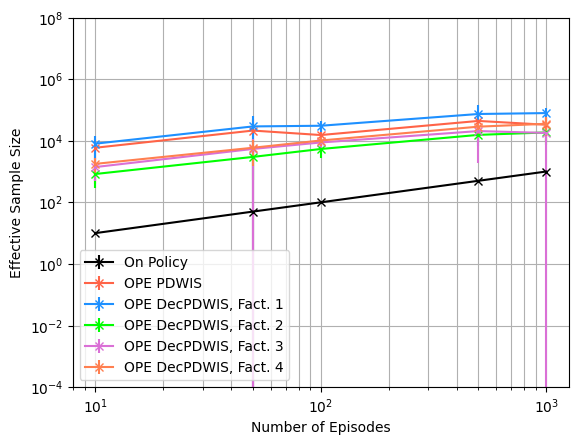

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{20}$)



Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc
gc.collect()
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.9677890300900749. Variance of on policy Q estimate: 0.0024260728989644333
Mean OPE IS estimate: -1.0019321374505008. Bias1: 0.034143107360426236. Bias2: 0.03414310736042592. Variance: 0.03966372895630026. MSE: 0.040829480736525856
Mean OPE PDIS estimate: -1.0019321374505008. Bias1: 0.034143107360426236. Bias2: 0.03414310736042592. Variance: 0.03966372895630026. MSE: 0.040829480736525856
Mean OPE PDWIS estimate: -0.04847207110894984. Bias1: 0.9193169589811251. Bias2: 0.9193169589811251. Variance: 5.470998710414514e-06. MSE: 0.8451491420690139
Mean OPE DecIS: Fact. 1 estimate: -1.1341418071428806. Bias1: 0.16635277705280568. Bias2: 0.1663527770528057. Variance: 0.02871831266978391. MSE: 0.05639155910296438
Mean OPE DecPDIS: Fact. 1 estimate: -0.9967631246973407. Bias1: 0.02897409460726598. Bias2: 0.028974094607265855. Variance: 0.020716214976771615. MSE: 0.021555713135082415
Mean OPE DecPDWIS: Fact. 1 estim

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.01952606 0.00675464 0.00581094 0.00544285 0.0054419 ]
OPE DecIS, Fact. 1-----[0.12222251 0.13079584 0.13108176 0.13582763 0.13823191]
OPE DecIS, Fact. 2-----[0.04844159 0.04150675 0.04235016 0.0367598  0.03631065]
OPE DecIS, Fact. 3-----[0.04870265 0.04452779 0.03802652 0.0437682  0.04569084]
OPE DecIS, Fact. 4-----[0.05847845 0.06110002 0.0598715  0.06460102 0.06630029]


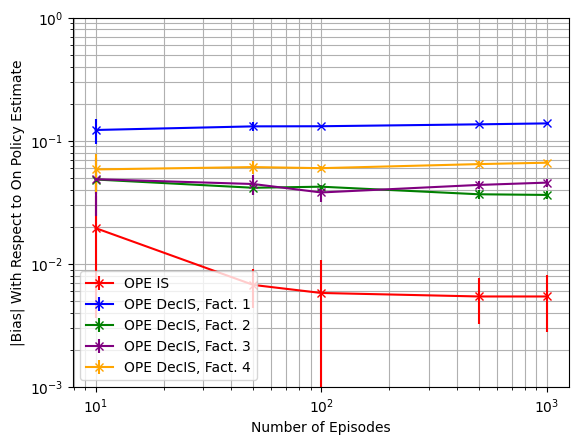

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.01952606 0.00675464 0.00581094 0.00544285 0.0054419 ]
OPE DecPDIS, Fact. 1-----[0.02113472 0.00757439 0.00259455 0.00418013 0.00533603]
OPE DecPDIS, Fact. 2-----[0.01140352 0.00642681 0.00548061 0.00302413 0.00291945]
OPE DecPDIS, Fact. 3-----[0.02512514 0.00930278 0.00623057 0.00272567 0.00343732]
OPE DecPDIS, Fact. 4-----[0.01999178 0.00694984 0.00347861 0.0029718  0.00378918]


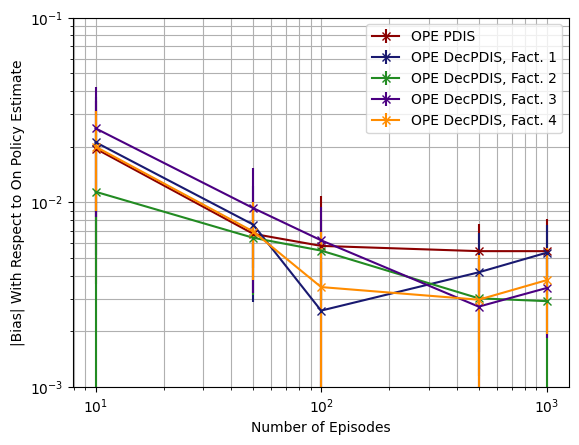

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**(-1), shorter_D, estimator='PDIS')

OPE PDWIS-----[0.92448211 0.92374528 0.92401628 0.92230914 0.92235511]
OPE DecPDWIS, Fact. 1-----[0.92921444 0.92848912 0.92870715 0.92700513 0.92704584]
OPE DecPDWIS, Fact. 2-----[0.92284124 0.92227323 0.92239927 0.92077466 0.92082885]
OPE DecPDWIS, Fact. 3-----[0.92642197 0.92583396 0.92600714 0.92433494 0.9243862 ]
OPE DecPDWIS, Fact. 4-----[0.9264504  0.92591721 0.92606575 0.92440924 0.92445414]


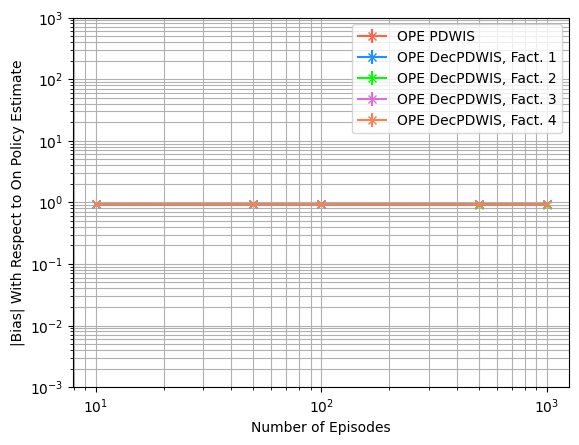

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[1.53117497e-03 3.98599839e-04 1.99100282e-04 4.57359951e-05
 2.21560528e-05]
OPE IS-----[0.01747177 0.00321075 0.00129778 0.00024237 0.00013078]
OPE DecIS, Fact. 1-----[0.01519096 0.00358158 0.00144311 0.000274   0.00014267]
OPE DecIS, Fact. 2-----[1.01179937e-02 1.85308734e-03 7.88393385e-04 1.52320464e-04
 9.29920638e-05]
OPE DecIS, Fact. 3-----[0.01456428 0.00270232 0.00119101 0.00019212 0.00011686]
OPE DecIS, Fact. 4-----[9.11851454e-03 2.26040037e-03 8.66352575e-04 1.54327461e-04
 8.95055393e-05]


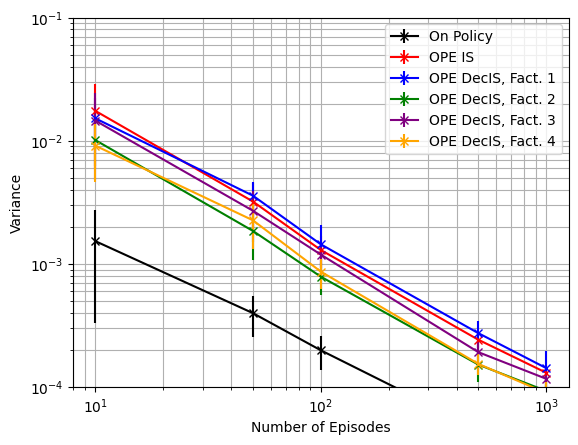

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**(-1), shorter_D, estimator='IS')

On Policy-----[1.53117497e-03 3.98599839e-04 1.99100282e-04 4.57359951e-05
 2.21560528e-05]
OPE PDIS-----[0.01747177 0.00321075 0.00129778 0.00024237 0.00013078]
OPE DecPDIS, Fact. 1-----[0.01155523 0.00282331 0.00115945 0.00022559 0.00011233]
OPE DecPDIS, Fact. 2-----[0.01182243 0.00228344 0.00100606 0.00020817 0.0001002 ]
OPE DecPDIS, Fact. 3-----[0.01392988 0.00289441 0.00125641 0.00020623 0.00010445]
OPE DecPDIS, Fact. 4-----[8.59846414e-03 2.20395388e-03 8.82809466e-04 1.63181238e-04
 8.05973686e-05]


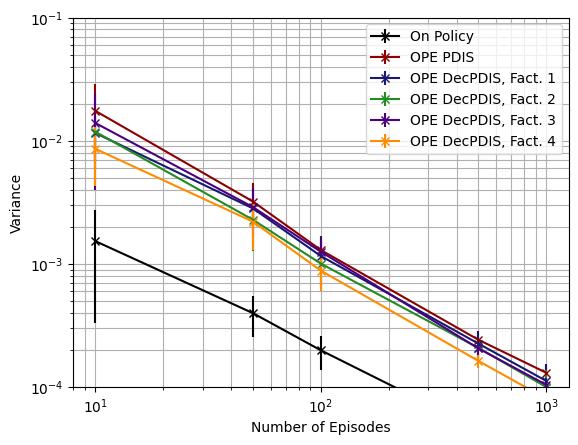

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**(-1), shorter_D, estimator='PDIS')

On Policy-----[1.53117497e-03 3.98599839e-04 1.99100282e-04 4.57359951e-05
 2.21560528e-05]
OPE PDWIS-----[5.73052263e-06 1.25027357e-06 7.30544628e-07 1.42637136e-07
 6.35169816e-08]
OPE DecPDWIS, Fact. 1-----[5.69360474e-06 9.66124031e-07 5.12018790e-07 9.81763983e-08
 4.13724069e-08]
OPE DecPDWIS, Fact. 2-----[8.44270374e-06 1.55728277e-06 7.45238834e-07 1.93781639e-07
 8.03838329e-08]
OPE DecPDWIS, Fact. 3-----[6.99088343e-06 1.53057721e-06 7.01835768e-07 1.55475553e-07
 6.42869176e-08]
OPE DecPDWIS, Fact. 4-----[5.21824072e-06 1.07016177e-06 5.17491110e-07 1.19512630e-07
 5.08778349e-08]


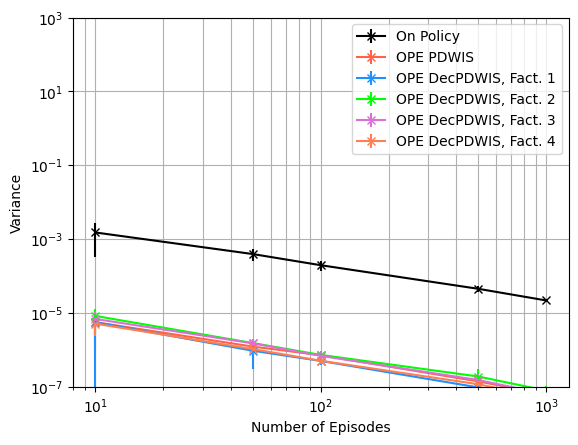

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[1.53117497e-03 3.98599839e-04 1.99100282e-04 4.57359951e-05
 2.21560528e-05]
OPE IS-----[0.01810646 0.00326184 0.00135663 0.00027673 0.00016747]
OPE DecIS, Fact. 1-----[0.03089318 0.02078888 0.01863776 0.01874525 0.01926797]
OPE DecIS, Fact. 2-----[0.01259511 0.00360462 0.00258313 0.0015124  0.00141814]
OPE DecIS, Fact. 3-----[0.01752655 0.00475061 0.00267202 0.00212002 0.00221509]
OPE DecIS, Fact. 4-----[0.01293904 0.0060428  0.00445941 0.00433936 0.00449536]


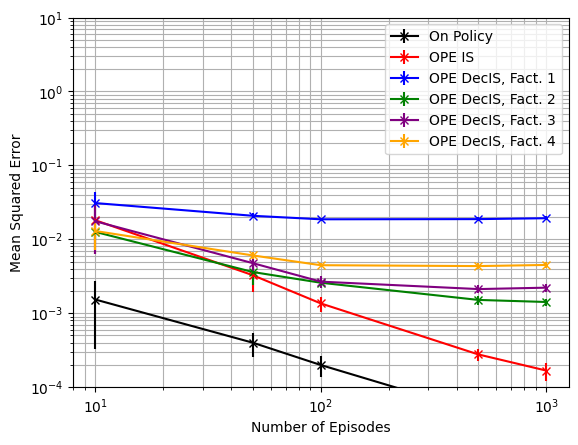

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**1, shorter_D, estimator='IS')

On Policy-----[1.53117497e-03 3.98599839e-04 1.99100282e-04 4.57359951e-05
 2.21560528e-05]
OPE PDIS-----[0.01810646 0.00326184 0.00135663 0.00027673 0.00016747]
OPE DecPDIS, Fact. 1-----[0.01225554 0.00290254 0.00117094 0.00024999 0.00014565]
OPE DecPDIS, Fact. 2-----[0.01214741 0.00233557 0.00104257 0.00022083 0.0001141 ]
OPE DecPDIS, Fact. 3-----[0.01484204 0.00301805 0.00130579 0.00021891 0.0001188 ]
OPE DecPDIS, Fact. 4-----[9.12039584e-03 2.26219090e-03 9.06572659e-04 1.76974277e-04
 9.83600491e-05]


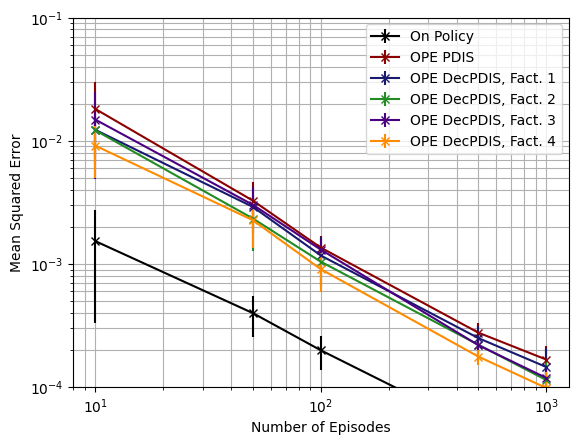

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**(-1), shorter_D, estimator='PDIS')

On Policy-----[1.53117497e-03 3.98599839e-04 1.99100282e-04 4.57359951e-05
 2.21560528e-05]
OPE PDWIS-----[0.85472816 0.85331383 0.85381233 0.85065679 0.85074028]
OPE DecPDWIS, Fact. 1-----[0.86350128 0.86210055 0.86250312 0.85934119 0.85941533]
OPE DecPDWIS, Fact. 2-----[0.85170085 0.85059656 0.85082587 0.84782862 0.84792709]
OPE DecPDWIS, Fact. 3-----[0.85832286 0.85717699 0.85749492 0.85439772 0.85449115]
OPE DecPDWIS, Fact. 4-----[0.85837246 0.85733094 0.85760349 0.85453508 0.85461678]


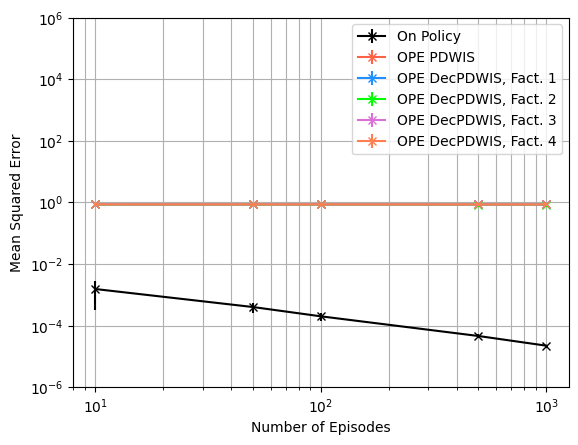

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[  0.95397771   7.85528192  16.44153976  97.09891734 172.6174054 ]
OPE DecIS, Fact. 1-----[  1.01847085   6.38473385  16.56132472  93.97065801 170.99951064]
OPE DecIS, Fact. 2-----[  1.30034326  14.08574377  27.35666871 166.51168126 259.92681723]
OPE DecIS, Fact. 3-----[  0.96416122   9.97775691  17.88427789 126.62851382 193.09866034]
OPE DecIS, Fact. 4-----[  1.43490599  11.50126452  25.11876965 154.58167828 257.04206283]


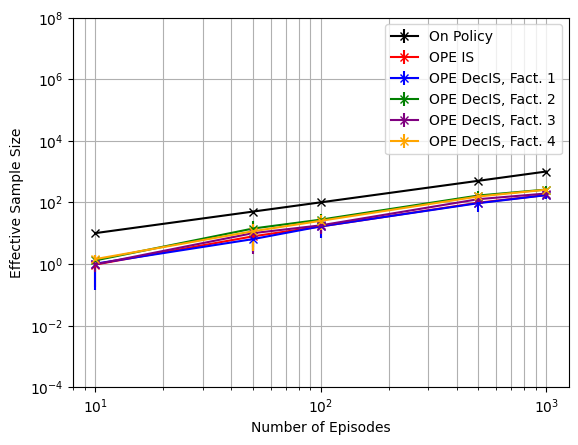

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[  0.95397771   7.85528192  16.44153976  97.09891734 172.6174054 ]
OPE DecPDIS, Fact. 1-----[  1.28842562   7.82774682  20.05785706 113.5660873  217.48037881]
OPE DecPDIS, Fact. 2-----[  1.13317178  11.55729855  22.92841352 110.94533242 281.34747152]
OPE DecPDIS, Fact. 3-----[  1.04463101   9.1520891   17.05282275 113.43918131 217.70222371]
OPE DecPDIS, Fact. 4-----[  1.54868262  12.02112004  24.87518656 142.16554496 286.29661953]


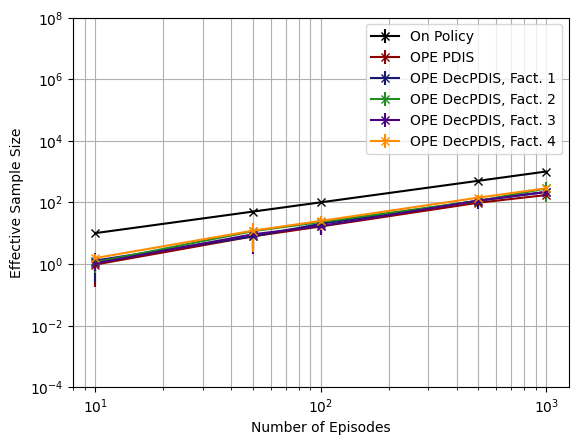

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[  4420.21809924  32576.36946083  28300.52933837 172451.75693421
 363666.62004261]
OPE DecPDWIS, Fact. 1-----[  5400.19898808  60441.19407746  40580.54225773 243219.31622588
 557789.30208138]
OPE DecPDWIS, Fact. 2-----[  2100.24183918  14329.09695193  26673.73089213 161425.70778697
 301331.0635379 ]
OPE DecPDWIS, Fact. 3-----[  2670.32415035  16168.87564861  30275.51760115 165672.04651829
 369918.41484697]
OPE DecPDWIS, Fact. 4-----[  3712.49973295  22681.28379797  39190.77341287 222601.0369101
 475027.11735176]


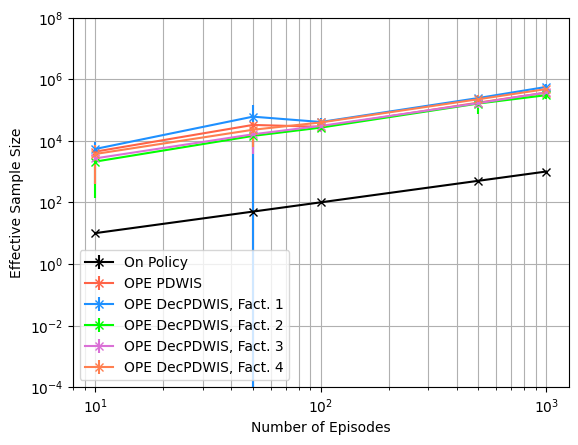

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

### Varying Episode Length $T$ With $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{T}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc

gc.collect()
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
LENGTHS = [1, 5, 10, 20]

bias_means = np.zeros((len(LENGTHS), 16))
bias_stds = np.zeros((len(LENGTHS), 16))
var_means = np.zeros((len(LENGTHS), 16))
var_stds = np.zeros((len(LENGTHS), 16))
MSE_means = np.zeros((len(LENGTHS), 16))
MSE_stds = np.zeros((len(LENGTHS), 16))
ESS_means = np.zeros((len(LENGTHS), 16))
ESS_stds = np.zeros((len(LENGTHS), 16))

RUNS = 20

for id in range(len(LENGTHS)):
  e = LENGTHS[id]
  print(f'{e} Steps, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

1 Steps, 20 ----------------------------------

Mean on policy Q estimate: -0.9798790728392319. Variance of on policy Q estimate: 0.0005204896819740555
Mean OPE IS estimate: -0.972860222563986. Bias1: 0.007018850275247315. Bias2: 0.007018850275245958. Variance: 0.049357258734322285. MSE: 0.049406522993508624
Mean OPE PDIS estimate: -0.972860222563986. Bias1: 0.007018850275247315. Bias2: 0.007018850275245958. Variance: 0.049357258734322285. MSE: 0.049406522993508624
Mean OPE PDWIS estimate: -0.04916283178417703. Bias1: 0.9307162410550548. Bias2: 0.9307162410550549. Variance: 1.2594622673326137e-06. MSE: 0.8662339808259183
Mean OPE DecIS: Fact. 1 estimate: -1.1660521414928433. Bias1: 0.18617306865361136. Bias2: 0.18617306865361138. Variance: 0.06486543640721758. MSE: 0.09952584789911986
Mean OPE DecPDIS: Fact. 1 estimate: -1.0311039719721822. Bias1: 0.05122489913295045. Bias2: 0.05122489913295025. Variance: 0.04941757553779212. MSE: 0.05204156582897307
Mean OPE DecPDWIS: Fact. 1 estimate

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.12337369 0.04677672 0.02504851 0.01881494]
OPE DecIS, Fact. 1-----[0.2437593  0.1443475  0.11555445 0.12594302]
OPE DecIS, Fact. 2-----[0.05042429 0.05015424 0.05510965 0.04795187]
OPE DecIS, Fact. 3-----[0.0986432  0.04657509 0.04486226 0.04134849]
OPE DecIS, Fact. 4-----[0.12745742 0.06770484 0.0518104  0.05671852]


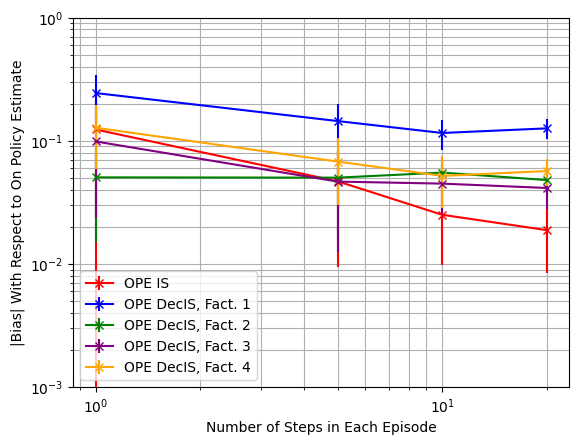

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.12337369 0.04677672 0.02504851 0.01881494]
OPE DecPDIS, Fact. 1-----[0.09409736 0.03346761 0.0278431  0.02005197]
OPE DecPDIS, Fact. 2-----[0.08972963 0.03173583 0.01925897 0.01632224]
OPE DecPDIS, Fact. 3-----[0.08742395 0.03182313 0.02492185 0.01564768]
OPE DecPDIS, Fact. 4-----[0.08342908 0.03102689 0.02226602 0.01570223]


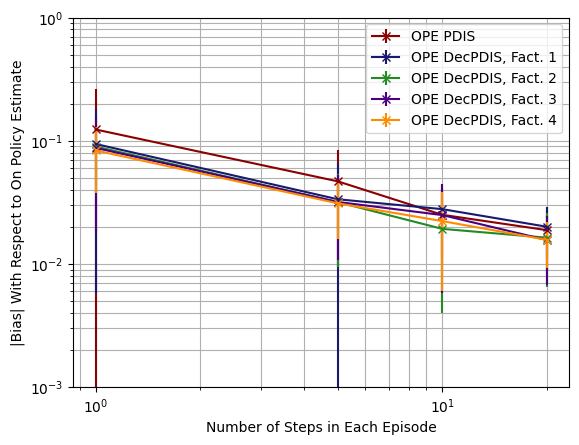

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.92590618 0.92870607 0.93115016 0.92894899]
OPE DecPDWIS, Fact. 1-----[0.9309482  0.93348475 0.93588249 0.93369784]
OPE DecPDWIS, Fact. 2-----[0.92452773 0.92713385 0.92950929 0.92740816]
OPE DecPDWIS, Fact. 3-----[0.9275387  0.93070296 0.93309002 0.9310633 ]
OPE DecPDWIS, Fact. 4-----[0.92838126 0.93079073 0.93311845 0.93105847]


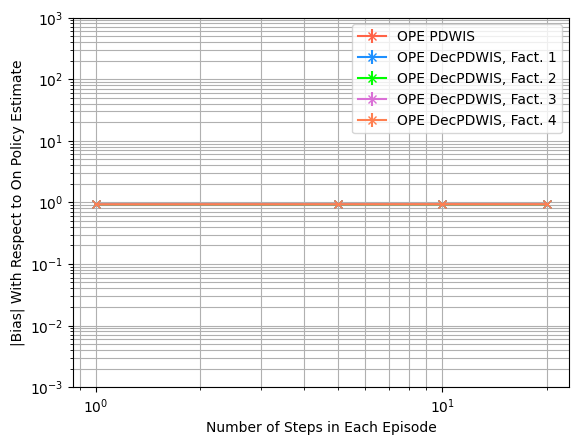

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.00949584 0.00210194 0.00075245 0.00050145]
OPE IS-----[0.37333573 0.0326855  0.01747177 0.00700484]
OPE DecIS, Fact. 1-----[0.29131864 0.03338816 0.01519096 0.00594541]
OPE DecIS, Fact. 2-----[0.10172889 0.01813848 0.01011799 0.00423446]
OPE DecIS, Fact. 3-----[0.11837163 0.01827474 0.01456428 0.00526602]
OPE DecIS, Fact. 4-----[0.12868948 0.01592165 0.00911851 0.00350031]


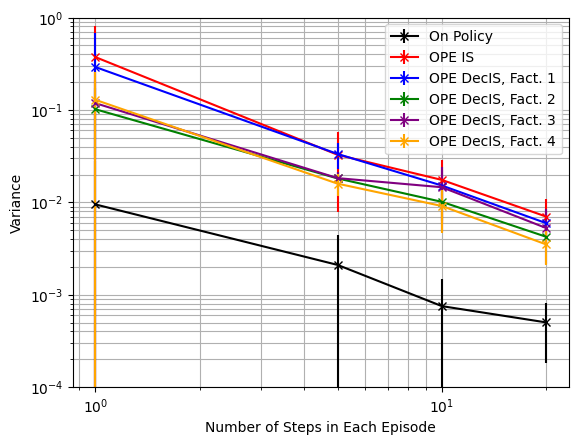

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

On Policy-----[0.00949584 0.00210194 0.00075245 0.00050145]
OPE PDIS-----[0.37333573 0.0326855  0.01747177 0.00700484]
OPE DecPDIS, Fact. 1-----[0.2084302  0.02349463 0.01155523 0.00479934]
OPE DecPDIS, Fact. 2-----[0.11872801 0.02327172 0.01182243 0.00520142]
OPE DecPDIS, Fact. 3-----[0.1214254  0.0174623  0.01392988 0.00544247]
OPE DecPDIS, Fact. 4-----[0.0981422  0.01407713 0.00859846 0.00342356]


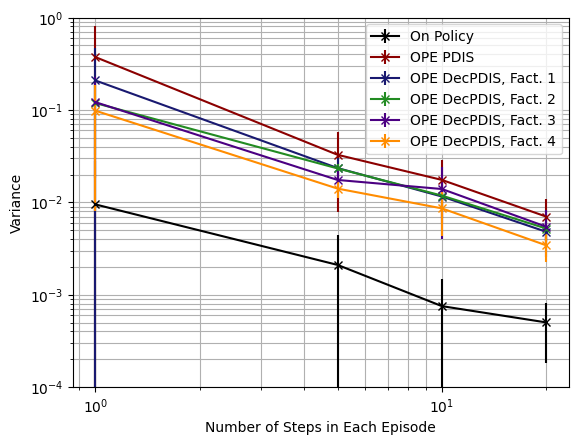

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.00949584 0.00210194 0.00075245 0.00050145]
OPE PDWIS-----[3.27438440e-06 4.83117381e-06 5.73052263e-06 1.78875264e-06]
OPE DecPDWIS, Fact. 1-----[2.11104286e-06 3.98289111e-06 5.69360474e-06 1.72995273e-06]
OPE DecPDWIS, Fact. 2-----[3.84652201e-05 1.53977848e-05 8.44270374e-06 2.86350405e-06]
OPE DecPDWIS, Fact. 3-----[3.16123516e-05 1.22943916e-05 6.99088343e-06 2.47887858e-06]
OPE DecPDWIS, Fact. 4-----[1.85092501e-05 8.10671587e-06 5.21824072e-06 1.70838986e-06]


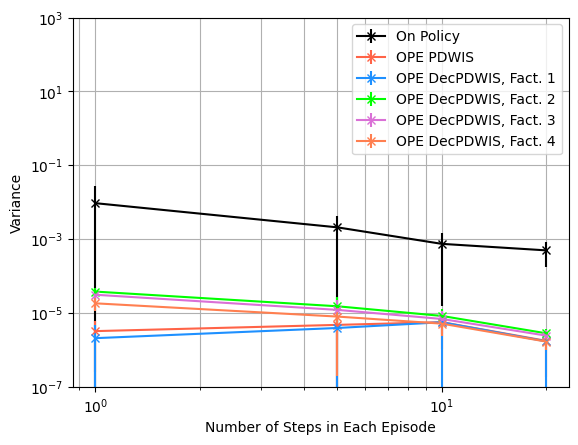

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.00949584 0.00210194 0.00075245 0.00050145]
OPE IS-----[0.40837131 0.03626495 0.01833402 0.00746741]
OPE DecIS, Fact. 1-----[0.36085917 0.05714344 0.02954102 0.02233697]
OPE DecIS, Fact. 2-----[0.10551608 0.02188341 0.01334894 0.00668609]
OPE DecIS, Fact. 3-----[0.13375607 0.02160186 0.01696302 0.00716199]
OPE DecIS, Fact. 4-----[0.14961732 0.02194062 0.01235483 0.0069171 ]


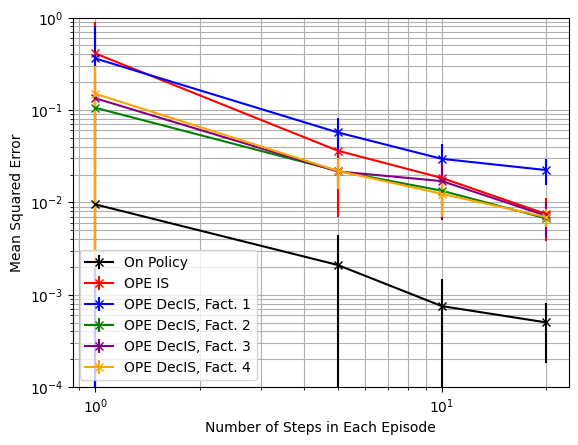

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

On Policy-----[0.00949584 0.00210194 0.00075245 0.00050145]
OPE PDIS-----[0.40837131 0.03626495 0.01833402 0.00746741]
OPE DecPDIS, Fact. 1-----[0.22507516 0.0257082  0.01260906 0.00528264]
OPE DecPDIS, Fact. 2-----[0.12886245 0.02477662 0.01242575 0.00556373]
OPE DecPDIS, Fact. 3-----[0.13381466 0.01892258 0.01491806 0.00576698]
OPE DecPDIS, Fact. 4-----[0.10721997 0.01526951 0.00935632 0.0037106 ]


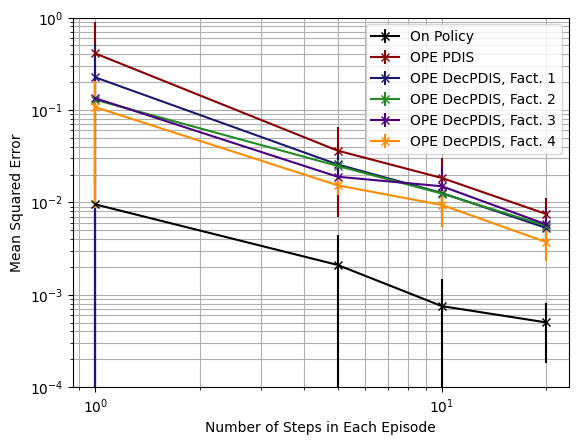

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.00949584 0.00210194 0.00075245 0.00050145]
OPE PDWIS-----[0.8577609  0.86255935 0.86708453 0.86296508]
OPE DecPDWIS, Fact. 1-----[0.86711163 0.87145627 0.8759207  0.87181075]
OPE DecPDWIS, Fact. 2-----[0.85522375 0.85965317 0.86403578 0.86010633]
OPE DecPDWIS, Fact. 3-----[0.86078906 0.86628294 0.87070502 0.86689896]
OPE DecPDWIS, Fact. 4-----[0.86234108 0.86644052 0.87075504 0.86688895]


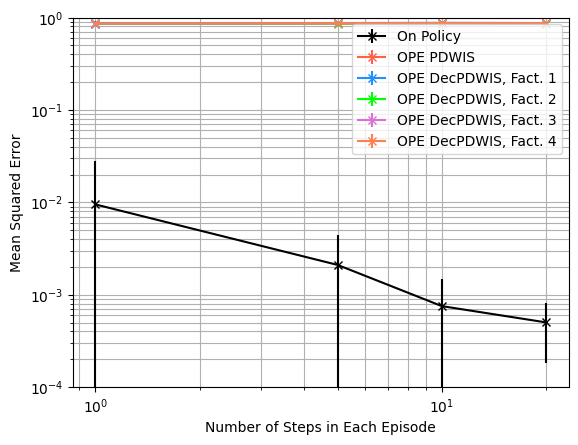

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**(0), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[ 1.  5. 10. 20.]
OPE IS-----[0.01182701 0.57534597 0.46306013 1.39508755]
OPE DecIS, Fact. 1-----[0.01450959 0.31836336 0.43726175 1.75078306]
OPE DecIS, Fact. 2-----[0.04814625 0.6784152  0.71548544 2.29654986]
OPE DecIS, Fact. 3-----[0.05721108 0.52961879 0.53210523 2.69728135]
OPE DecIS, Fact. 4-----[0.03300999 0.67461592 0.7439433  3.84643057]


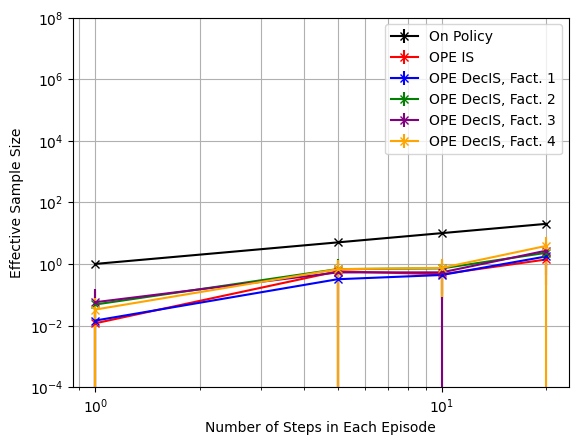

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='IS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDIS-----[0.01182701 0.57534597 0.46306013 1.39508755]
OPE DecPDIS, Fact. 1-----[0.02016965 0.44832431 0.59582562 2.05099824]
OPE DecPDIS, Fact. 2-----[0.04016188 0.44972552 0.6258435  1.79682384]
OPE DecPDIS, Fact. 3-----[0.05043211 0.50366271 0.6670236  2.28171783]
OPE DecPDIS, Fact. 4-----[0.04665451 0.69435073 0.90418782 3.29215026]


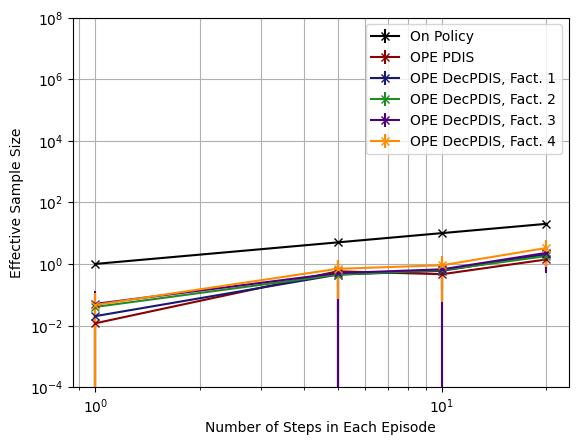

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='PDIS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDWIS-----[ 1289.27059435  6678.87237212  3582.08516445 10628.25271829]
OPE DecPDWIS, Fact. 1-----[ 1873.27054673 11827.23293509  4213.04759305 20102.09220063]
OPE DecPDWIS, Fact. 2-----[ 169.15943949  628.73874356  987.31031766 3790.80905524]
OPE DecPDWIS, Fact. 3-----[ 201.07353866  697.01024317 1475.33100233 5190.51934083]
OPE DecPDWIS, Fact. 4-----[ 302.74362418 1332.53559208 1979.65991556 7284.47655941]


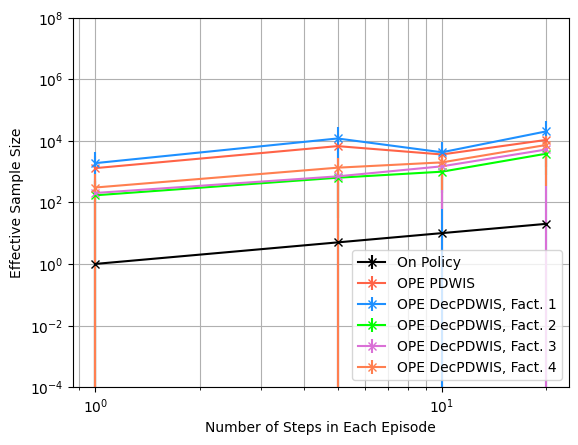

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

## From Patient State 56, Without Diabetes

In [ ]:
#The patient has no diabetes
PROB_DIAB = 0.0

### State Analysis

In [ ]:
#Instantiate a state based on the idx and get the state vector
testState = State(state_idx = 56, diabetic_idx=0)
vec = testState.get_state_vector()

print(vec)
print(f'Num abnormals: {testState.get_num_abnormal()}\n')

print(f'Heart Rate: {hr_state_mapping[vec[0]]}')
print(f'Systolic Blood Pressure: {sbp_state_mapping[vec[1]]}')
print(f'Percent Oxygen: {o2_state_mapping[vec[2]]}')
print(f'Glucose Level: {glu_state_mapping[vec[3]]}')
print(f'Antibiotics: {abx_state_mapping[vec[4]]}')
print(f'Vasopressors: {vaso_state_mapping[vec[5]]}')
print(f'Ventilator: {vent_state_mapping[vec[6]]}')
print(f'Diabetes: {testState.diabetic_idx}')

[0 0 1 2 0 0 0]
Num abnormals: 2

Heart Rate: Low
Systolic Blood Pressure: Low
Percent Oxygen: Normal
Glucose Level: Normal
Antibiotics: Off
Vasopressors: Off
Ventilator: Off
Diabetes: 0


### Generate Data From Behaviour Policy

Run the data generator

In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=randPol, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

Convert data into array format

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_b = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_b.shape

(100000, 20, 5)

In [ ]:
f_tr_b1, f_tr_b2, f_tr_b3, f_tr_b4 = factorise_dataset(nf_tr_b)

In [ ]:
print(nf_tr_b)

[[[  0.  56.   0.  -1.  88.]
  [  1.  88.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0.  56.   3.   0. 139.]
  [  1. 139.   5.   0. 142.]
  [  2. 142.   0.   0. 128.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0.  56.   7.   0. 143.]
  [  1. 143.   5.   0. 222.]
  [  2. 222.   6.   0. 141.]
  ...
  [ 17. 455.   0.   0. 448.]
  [ 18. 448.   1.  -1. 410.]
  [ 19. 410.  -1.   0.  -1.]]

 ...

 [[  0.  56.   4.   0.  60.]
  [  1.  60.   2.   0.  57.]
  [  2.  57.   4.   0.  60.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0.  56.   5.   0. 142.]
  [  1. 142.   5.   0. 222.]
  [  2. 222.   7.   0. 223.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0.  56.   2.  -1.  49.]
  [  1.  49.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1

In [ ]:
print(f_tr_b1)

[[[[  0.   56.    0.   -0.5  88. ]
   [  0.   56.    0.   -0.5  88. ]]

  [[  1.   88.    1.    0.   -1. ]
   [  1.   88.   -1.    0.   -1. ]]

  [[  2.   -1.    1.    0.   -1. ]
   [  2.   -1.   -1.    0.   -1. ]]

  ...

  [[ 17.   -1.    1.    0.   -1. ]
   [ 17.   -1.   -1.    0.   -1. ]]

  [[ 18.   -1.    1.    0.   -1. ]
   [ 18.   -1.   -1.    0.   -1. ]]

  [[ 19.   -1.    1.    0.   -1. ]
   [ 19.   -1.   -1.    0.   -1. ]]]


 [[[  0.   56.    1.    0.  139. ]
   [  0.   56.    1.    0.  139. ]]

  [[  1.  139.    0.    0.  142. ]
   [  1.  139.    3.    0.  142. ]]

  [[  2.  142.    0.    0.  128. ]
   [  2.  142.    0.    0.  128. ]]

  ...

  [[ 17.   -1.    1.    0.   -1. ]
   [ 17.   -1.   -1.    0.   -1. ]]

  [[ 18.   -1.    1.    0.   -1. ]
   [ 18.   -1.   -1.    0.   -1. ]]

  [[ 19.   -1.    1.    0.   -1. ]
   [ 19.   -1.   -1.    0.   -1. ]]]


 [[[  0.   56.    1.    0.  143. ]
   [  0.   56.    3.    0.  143. ]]

  [[  1.  143.    0.    0.  222. ]
   [  1.  1

In [ ]:
factored_randPol1 = factor_policy_1(randPol)
factored_randPol2 = factor_policy_2(randPol)
factored_randPol3 = factor_policy_3(randPol)
factored_randPol4 = factor_policy_4(randPol)

In [ ]:
randPol = pad_policy(randPol)

factored_randPol1[0] = pad_policy(factored_randPol1[0])
factored_randPol1[1] = pad_policy(factored_randPol1[1])

factored_randPol2[0] = pad_policy(factored_randPol2[0])
factored_randPol2[1] = pad_policy(factored_randPol2[1])

factored_randPol3[0] = pad_policy(factored_randPol3[0])
factored_randPol3[1] = pad_policy(factored_randPol3[1])

factored_randPol4[0] = pad_policy(factored_randPol4[0])
factored_randPol4[1] = pad_policy(factored_randPol4[1])
factored_randPol4[2] = pad_policy(factored_randPol4[2])

### Varying Episodes $\epsilon_{e} = 0.4$ (Policy Divergence $4.8^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
EVAL_EPSILON = 0.4

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

4.8


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.4030721831088616. Variance of on policy Q estimate: 0.03552197507063139
Mean OPE IS estimate: -0.14917313034921564. Bias1: 0.25389905275964597. Bias2: 0.25389905275964597. Variance: 0.011690583743813421. MSE: 0.07615531273605891
Mean OPE PDIS estimate: -0.14917313034921564. Bias1: 0.25389905275964597. Bias2: 0.25389905275964597. Variance: 0.011690583743813421. MSE: 0.07615531273605891
Mean OPE PDWIS estimate: -0.02426793728265383. Bias1: 0.3788042458262078. Bias2: 0.3788042458262078. Variance: 7.415747733894616e-05. MSE: 0.14356681413330102
Mean OPE DecIS: Fact. 1 estimate: -0.9148025185628125. Bias1: 0.5117303354539505. Bias2: 0.5117303354539509. Variance: 4.853499214432645. MSE: 5.115367150656458
Mean OPE DecPDIS: Fact. 1 estimate: -0.7350379353376804. Bias1: 0.33196575222881947. Bias2: 0.33196575222881874. Variance: 4.962895643912185. MSE: 5.073096904565031
Mean OPE DecPDWIS: Fact. 1 estimate: -0.01921

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.11669999 0.24474739 0.20926583 0.11504774 0.07611814]
OPE DecIS, Fact. 1-----[0.25736949 0.56250482 0.50364432 0.67571053 0.64234161]
OPE DecIS, Fact. 2-----[0.14249006 0.18594458 0.23414054 0.47802457 0.37391429]
OPE DecIS, Fact. 3-----[6.68048331 1.4485618  0.77710993 0.37513375 0.30501461]
OPE DecIS, Fact. 4-----[4.68003583 1.45219302 0.97057389 0.79653811 0.70514229]


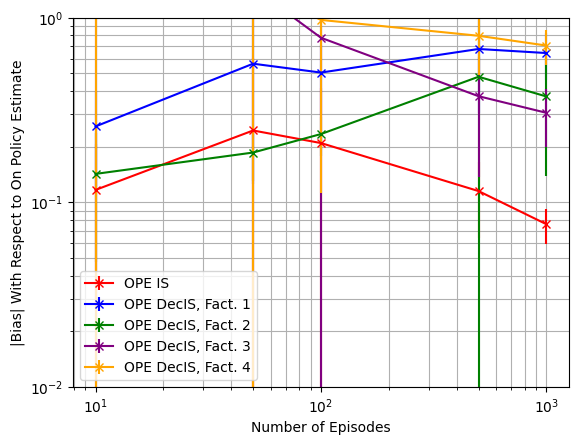

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**-2, 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.11669999 0.24474739 0.20926583 0.11504774 0.07611814]
OPE DecPDIS, Fact. 1-----[0.09570773 0.22768734 0.1783553  0.3557047  0.30649875]
OPE DecPDIS, Fact. 2-----[0.07649432 0.07227129 0.11930671 0.25581101 0.20373964]
OPE DecPDIS, Fact. 3-----[6.6248282  1.37530728 0.71198431 0.42725155 0.26922334]
OPE DecPDIS, Fact. 4-----[4.49030206 1.14203137 0.67715866 0.43505851 0.36779729]


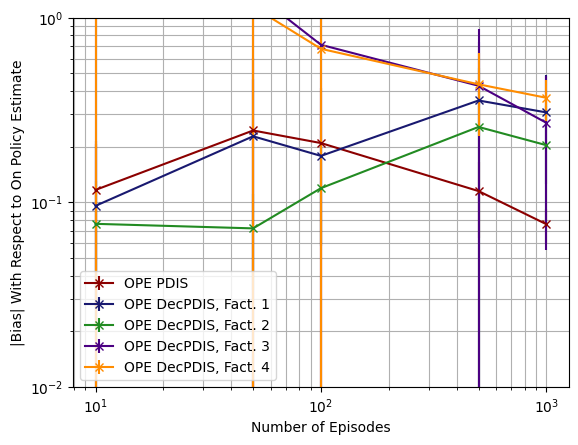

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-2), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.32234454 0.30579229 0.30709938 0.30926573 0.30800628]
OPE DecPDWIS, Fact. 1-----[0.32713165 0.30765331 0.30753857 0.30485357 0.30327313]
OPE DecPDWIS, Fact. 2-----[0.32379504 0.30515154 0.30558752 0.30246159 0.30160526]
OPE DecPDWIS, Fact. 3-----[0.32467389 0.30674385 0.30712376 0.30241783 0.30243365]
OPE DecPDWIS, Fact. 4-----[0.32432012 0.30483915 0.30513696 0.30030777 0.29963828]


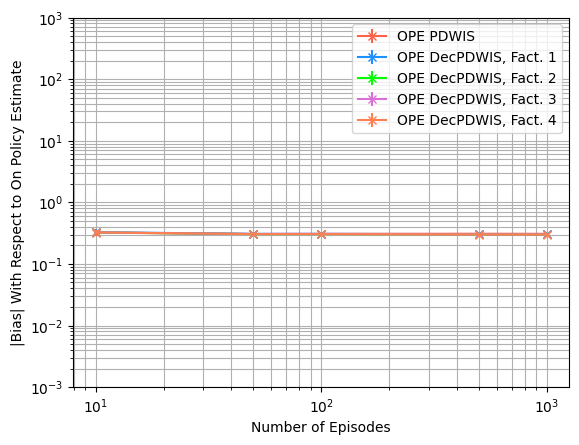

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.0443433  0.01159306 0.00423093 0.00088426 0.00042469]
OPE IS-----[0.3070164  4.75672617 1.90409516 0.25347475 0.10211495]
OPE DecIS, Fact. 1-----[1.16578773 5.03004394 1.32874708 2.87718673 0.8392195 ]
OPE DecIS, Fact. 2-----[0.69337339 0.23574899 0.16047755 5.46505925 1.45247071]
OPE DecIS, Fact. 3-----[4.10600422e+03 1.63978406e+02 4.10149975e+01 1.94738330e+00
 5.03654260e-01]
OPE DecIS, Fact. 4-----[1.82874756e+03 7.55674325e+01 1.88132311e+01 3.19434167e+00
 8.62493312e-01]


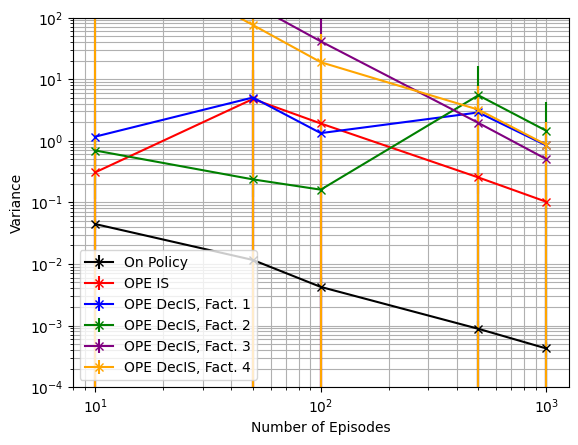

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**(2), shorter_D, estimator='IS')

On Policy-----[0.0443433  0.01159306 0.00423093 0.00088426 0.00042469]
OPE PDIS-----[0.3070164  4.75672617 1.90409516 0.25347475 0.10211495]
OPE DecPDIS, Fact. 1-----[1.06601006 1.56968813 0.41925286 2.75178739 0.72762933]
OPE DecPDIS, Fact. 2-----[0.46000527 0.1659368  0.10471505 1.6312746  0.45455744]
OPE DecPDIS, Fact. 3-----[4.10762552e+03 1.64155868e+02 4.09019244e+01 4.95809974e+00
 1.24351151e+00]
OPE DecPDIS, Fact. 4-----[1.82709238e+03 7.37810337e+01 1.83864581e+01 1.46227402e+00
 3.88530179e-01]


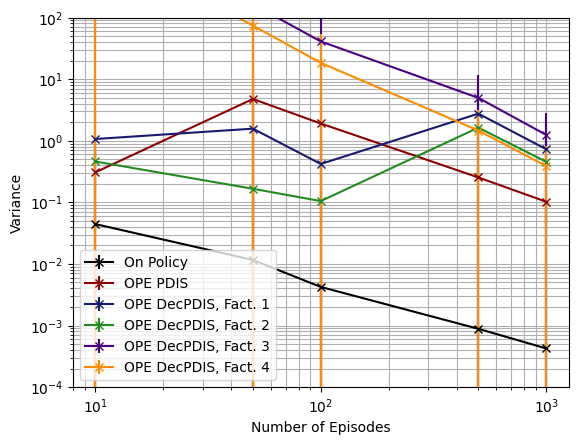

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**2, shorter_D, estimator='PDIS')

On Policy-----[0.0443433  0.01159306 0.00423093 0.00088426 0.00042469]
OPE PDWIS-----[0.00014398 0.00022377 0.00018827 0.00026156 0.00015468]
OPE DecPDWIS, Fact. 1-----[1.03869604e-04 7.67784042e-05 5.19002660e-05 4.52583831e-05
 3.38120240e-05]
OPE DecPDWIS, Fact. 2-----[9.52108438e-05 1.22347202e-04 8.37566804e-05 6.08734596e-05
 4.53541480e-05]
OPE DecPDWIS, Fact. 3-----[1.50771054e-04 1.61038135e-04 1.05379367e-04 7.28951209e-05
 6.66661377e-05]
OPE DecPDWIS, Fact. 4-----[1.06925742e-04 6.33395664e-05 4.73690734e-05 2.54511693e-05
 2.71809993e-05]


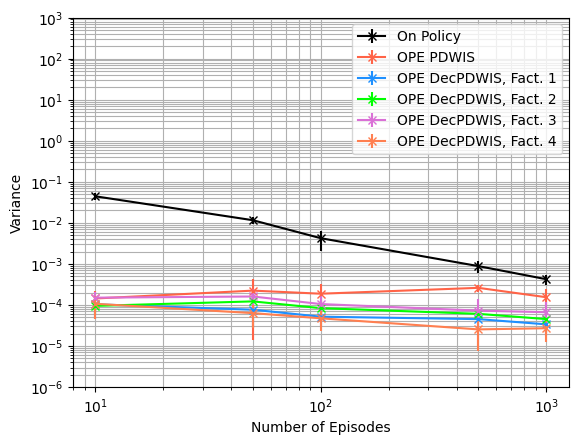

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.0443433  0.01159306 0.00423093 0.00088426 0.00042469]
OPE IS-----[0.32873922 4.94613433 1.98941804 0.26931472 0.10817967]
OPE DecIS, Fact. 1-----[1.25225383 5.53775338 1.62550579 3.47076754 1.28507425]
OPE DecIS, Fact. 2-----[0.72270603 0.27332447 0.2185161  5.93639681 1.64716094]
OPE DecIS, Fact. 3-----[4.32183755e+03 1.72900190e+02 4.34064217e+01 2.14473251e+00
 6.07885192e-01]
OPE DecIS, Fact. 4-----[1.92692791e+03 8.03336668e+01 2.04927360e+01 3.92477419e+00
 1.38229774e+00]


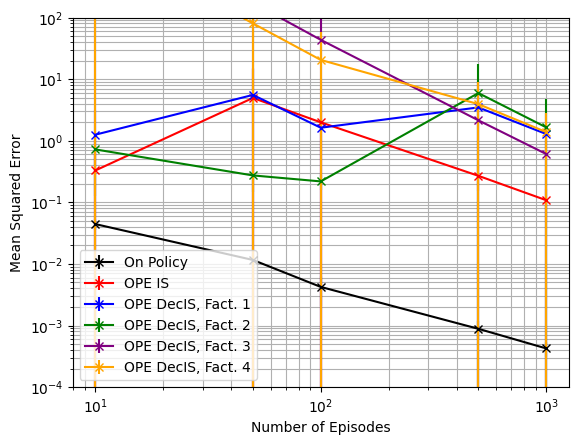

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**2, shorter_D, estimator='IS')

On Policy-----[0.0443433  0.01159306 0.00423093 0.00088426 0.00042469]
OPE PDIS-----[0.32873922 4.94613433 1.98941804 0.26931472 0.10817967]
OPE DecPDIS, Fact. 1-----[1.08934662 1.67760943 0.4654672  3.02446822 0.85447902]
OPE DecPDIS, Fact. 2-----[0.46870373 0.17267512 0.1225642  1.77344563 0.5121399 ]
OPE DecPDIS, Fact. 3-----[4.32226114e+03 1.72862116e+02 4.32217408e+01 5.33572078e+00
 1.36182938e+00]
OPE DecPDIS, Fact. 4-----[1.92342884e+03 7.79019189e+01 1.95971533e+01 1.69391119e+00
 5.32245784e-01]


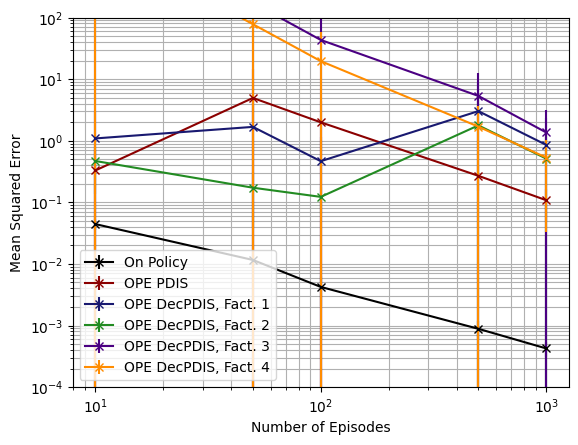

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**2, shorter_D, estimator='PDIS')

On Policy-----[0.0443433  0.01159306 0.00423093 0.00088426 0.00042469]
OPE PDWIS-----[0.10528481 0.09425092 0.09469307 0.09594646 0.09504455]
OPE DecPDWIS, Fact. 1-----[0.10839431 0.09526303 0.09481051 0.0930097  0.09202125]
OPE DecPDWIS, Fact. 2-----[0.10624497 0.09373919 0.09365    0.09157884 0.09103217]
OPE DecPDWIS, Fact. 3-----[0.10682441 0.09474822 0.09460009 0.09157047 0.09155255]
OPE DecPDWIS, Fact. 4-----[0.10654881 0.09349116 0.09332756 0.0902449  0.08982679]


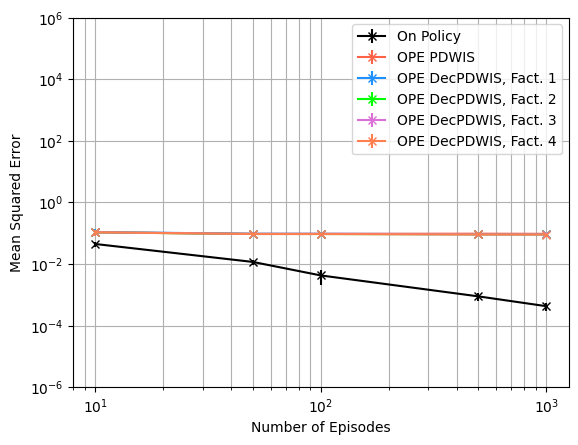

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[11.89546979  5.77139878  7.18195372  2.43697071 13.36410849]
OPE DecIS, Fact. 1-----[2.20118581 1.45295908 2.08507505 2.00066972 2.18513389]
OPE DecIS, Fact. 2-----[ 1.85635316  3.11437738  3.30268442 10.33509131 12.53903302]
OPE DecIS, Fact. 3-----[1.44552013 9.15506622 9.05144765 7.6534146  9.12116685]
OPE DecIS, Fact. 4-----[0.99836115 1.7549527  2.78819212 3.17990252 3.52187838]


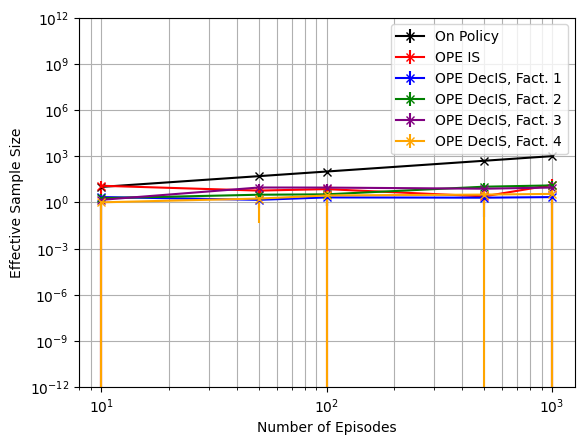

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-12), 10**12, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[11.89546979  5.77139878  7.18195372  2.43697071 13.36410849]
OPE DecPDIS, Fact. 1-----[5.77956742 3.07512207 3.96443639 5.83732575 6.54553042]
OPE DecPDIS, Fact. 2-----[ 2.71457697  5.31484409  6.09202623 15.40932941 18.21440163]
OPE DecPDIS, Fact. 3-----[ 1.64733724  3.72954961  7.74568782 18.55881564 19.31689106]
OPE DecPDIS, Fact. 4-----[1.35950744 3.75263474 5.46710624 7.52927433 9.88241049]


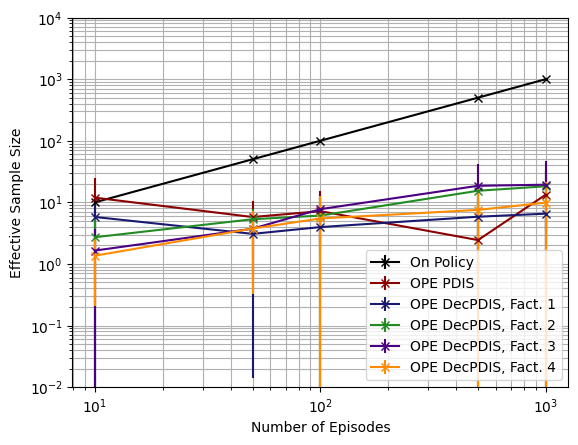

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-2), 10**4, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[4160.58265897 7256.937845   4833.06132827 1760.64660175 5162.88805048]
OPE DecPDWIS, Fact. 1-----[ 6002.04808701 12206.99166363 11434.54053075 11935.61401813
 15116.16210748]
OPE DecPDWIS, Fact. 2-----[ 5231.08470887  8478.68333108  7796.67457175  8153.18557982
 12656.78012868]
OPE DecPDWIS, Fact. 3-----[ 3263.39748374  5872.04934669  4408.39183914 17885.46807808
 28813.58160639]
OPE DecPDWIS, Fact. 4-----[ 5272.76396736 15184.22298508  9250.04885079 27396.17734187
 27941.49748962]


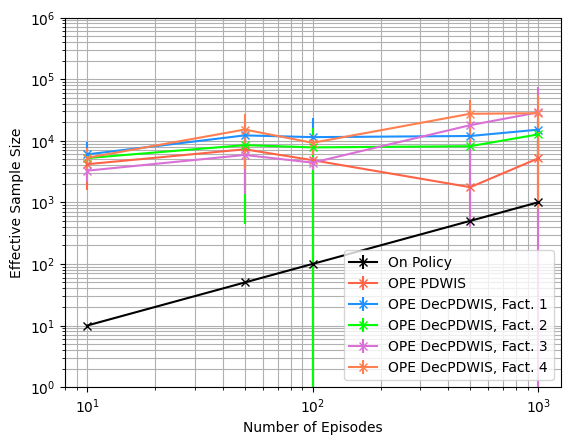

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**(6), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.6$ (Policy Divergence $3.2^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc

gc.collect()
EVAL_EPSILON = 0.6

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

3.2


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.5369173928885451. Variance of on policy Q estimate: 0.034966969635494075
Mean OPE IS estimate: -0.36312858634924433. Bias1: 0.1737888065393008. Bias2: 0.1737888065393008. Variance: 0.07299500505866895. MSE: 0.10319755433702346
Mean OPE PDIS estimate: -0.36312858634924433. Bias1: 0.1737888065393008. Bias2: 0.1737888065393008. Variance: 0.07299500505866895. MSE: 0.10319755433702346
Mean OPE PDWIS estimate: -0.03082931467421926. Bias1: 0.5060880782143259. Bias2: 0.5060880782143259. Variance: 8.146979106629594e-05. MSE: 0.2562066127017359
Mean OPE DecIS: Fact. 1 estimate: -0.954833580402199. Bias1: 0.4179161875136533. Bias2: 0.4179161875136539. Variance: 3.02952838651962. MSE: 3.204182326305567
Mean OPE DecPDIS: Fact. 1 estimate: -0.7748245646232272. Bias1: 0.2379071717346792. Bias2: 0.23790717173468212. Variance: 3.1141384202510864. MSE: 3.1707382426138806
Mean OPE DecPDWIS: Fact. 1 estimate: -0.024886581993

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.09096552 0.0893075  0.08995744 0.06369166 0.02972603]
OPE DecIS, Fact. 1-----[0.18793296 0.29270348 0.3091406  0.38830321 0.37485912]
OPE DecIS, Fact. 2-----[0.10339306 0.10146302 0.11495968 0.141803   0.13041141]
OPE DecIS, Fact. 3-----[1.27921281 0.33118637 0.19453352 0.1833196  0.17017989]
OPE DecIS, Fact. 4-----[0.98454604 0.45150443 0.36664908 0.34695196 0.34080177]


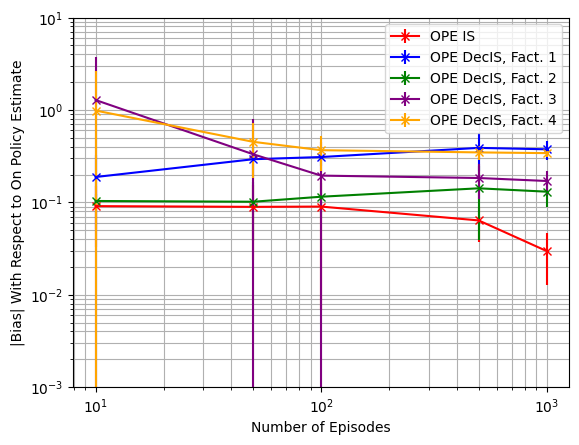

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**1, shorter_D, estimator='IS')

OPE PDIS-----[0.09096552 0.0893075  0.08995744 0.06369166 0.02972603]
OPE DecPDIS, Fact. 1-----[0.14221125 0.06632893 0.05576332 0.13241958 0.11295083]
OPE DecPDIS, Fact. 2-----[0.09328503 0.04892327 0.056436   0.06398786 0.05792692]
OPE DecPDIS, Fact. 3-----[1.26141926 0.27039737 0.15418435 0.09480929 0.06017011]
OPE DecPDIS, Fact. 4-----[0.86940864 0.23599635 0.15509392 0.12409143 0.11787326]


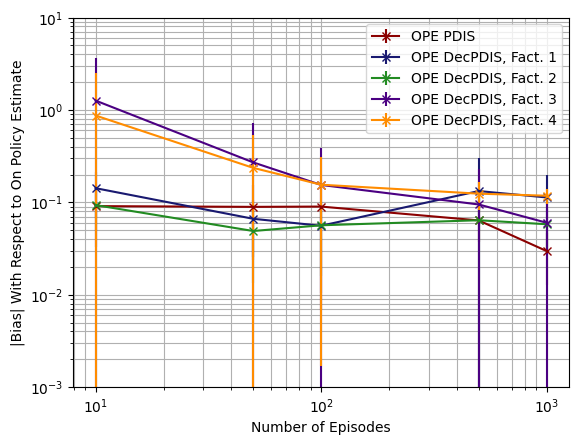

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**1, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.5611476  0.53951967 0.54028184 0.54434267 0.54344575]
OPE DecPDWIS, Fact. 1-----[0.56649941 0.54397391 0.54377853 0.54501857 0.54423679]
OPE DecPDWIS, Fact. 2-----[0.56267483 0.5409974  0.54119652 0.54270256 0.54198474]
OPE DecPDWIS, Fact. 3-----[0.56422635 0.54341268 0.54362321 0.54355411 0.54347194]
OPE DecPDWIS, Fact. 4-----[0.5642942  0.54245867 0.54262234 0.54279351 0.54222649]


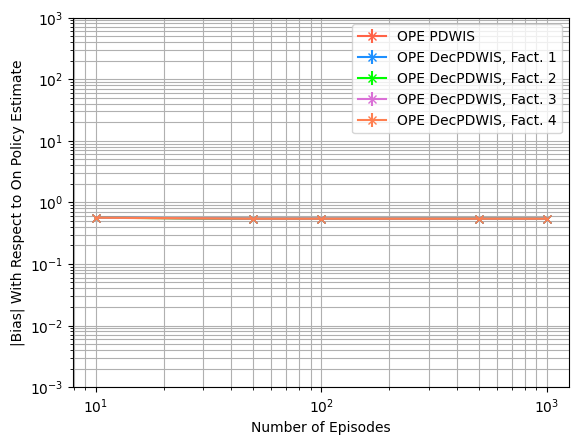

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.02881538 0.00599428 0.00403061 0.00075408 0.00037115]
OPE IS-----[0.25235378 0.65482096 0.54579962 0.07434095 0.02661245]
OPE DecIS, Fact. 1-----[0.73417219 0.42832262 0.14838663 0.44603531 0.12719681]
OPE DecIS, Fact. 2-----[0.27498369 0.1416021  0.0784432  0.17115669 0.05619595]
OPE DecIS, Fact. 3-----[1.51406407e+02 6.05668158e+00 1.53300167e+00 1.54478511e-01
 4.63376595e-02]
OPE DecIS, Fact. 4-----[6.78276944e+01 2.93834456e+00 7.43604288e-01 1.07573637e-01
 3.52810526e-02]


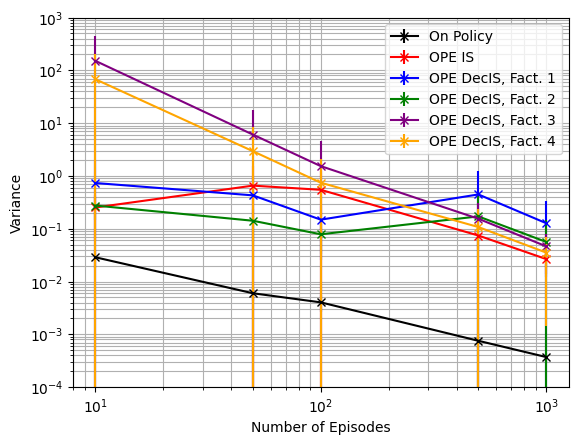

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**3, shorter_D, estimator='IS')

On Policy-----[0.02881538 0.00599428 0.00403061 0.00075408 0.00037115]
OPE PDIS-----[0.25235378 0.65482096 0.54579962 0.07434095 0.02661245]
OPE DecPDIS, Fact. 1-----[0.69085739 0.19352689 0.07324953 0.43486702 0.11437977]
OPE DecPDIS, Fact. 2-----[0.26000649 0.11510705 0.06729225 0.06721803 0.02542688]
OPE DecPDIS, Fact. 3-----[1.51618634e+02 6.10032128e+00 1.51619418e+00 3.49161244e-01
 8.97939174e-02]
OPE DecPDIS, Fact. 4-----[6.76439728e+01 2.78905885e+00 7.04160607e-01 5.84141763e-02
 1.84739250e-02]


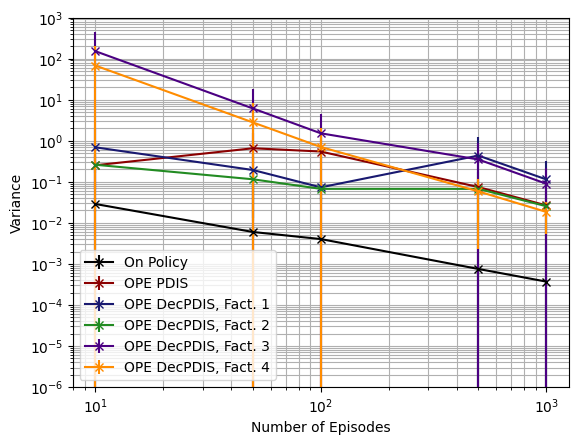

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**3, shorter_D, estimator='PDIS')

On Policy-----[0.02881538 0.00599428 0.00403061 0.00075408 0.00037115]
OPE PDWIS-----[1.33915438e-04 1.59811206e-04 1.20519725e-04 1.07295802e-04
 4.85521730e-05]
OPE DecPDWIS, Fact. 1-----[8.24458534e-05 5.58049356e-05 3.11736914e-05 2.64647494e-05
 1.38649741e-05]
OPE DecPDWIS, Fact. 2-----[9.79167495e-05 9.45676526e-05 6.91207631e-05 3.19102160e-05
 2.13777845e-05]
OPE DecPDWIS, Fact. 3-----[1.48029079e-04 8.39717536e-05 6.11133115e-05 4.01603244e-05
 2.93854559e-05]
OPE DecPDWIS, Fact. 4-----[8.97367386e-05 4.00333880e-05 3.19233404e-05 1.44218512e-05
 9.59498676e-06]


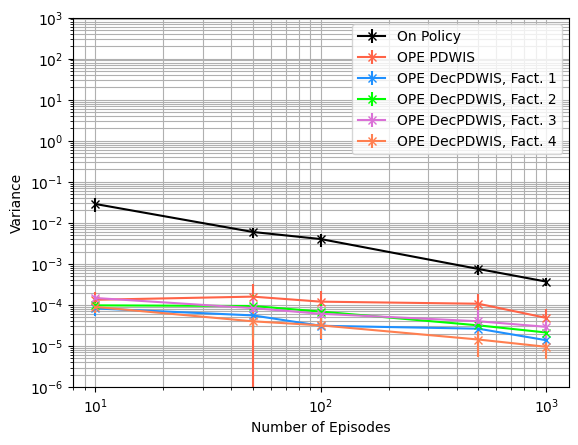

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.02881538 0.00599428 0.00403061 0.00075408 0.00037115]
OPE IS-----[0.26399517 0.66705676 0.56081021 0.0790762  0.02778932]
OPE DecIS, Fact. 1-----[0.78812654 0.52417371 0.24751189 0.62497745 0.27517544]
OPE DecIS, Fact. 2-----[0.28604743 0.15594169 0.09392027 0.20179618 0.07488953]
OPE DecIS, Fact. 3-----[1.59080235e+02 6.38861321e+00 1.63748303e+00 1.93729485e-01
 7.78468135e-02]
OPE DecIS, Fact. 4-----[71.53806739  3.2138124   0.90075748  0.23124939  0.15245241]


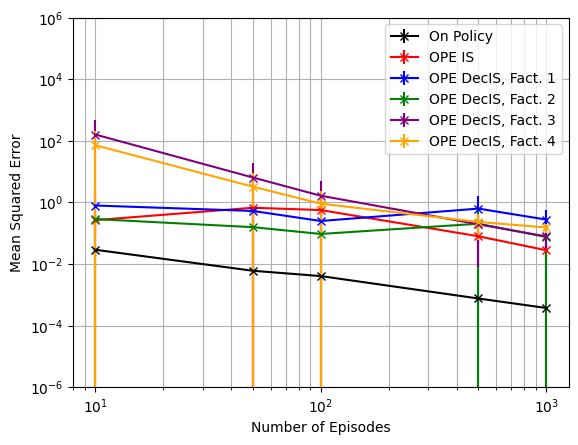

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='IS')

On Policy-----[0.02881538 0.00599428 0.00403061 0.00075408 0.00037115]
OPE PDIS-----[0.26399517 0.66705676 0.56081021 0.0790762  0.02778932]
OPE DecPDIS, Fact. 1-----[0.71634989 0.19959875 0.07841193 0.48130732 0.1342866 ]
OPE DecPDIS, Fact. 2-----[0.27063382 0.11875376 0.0721034  0.07660493 0.02951548]
OPE DecPDIS, Fact. 3-----[1.59032370e+02 6.37949472e+00 1.59463445e+00 3.76313449e-01
 9.77664538e-02]
OPE DecPDIS, Fact. 4-----[7.09906055e+01 2.93106219e+00 7.51746257e-01 7.55975981e-02
 3.28088403e-02]


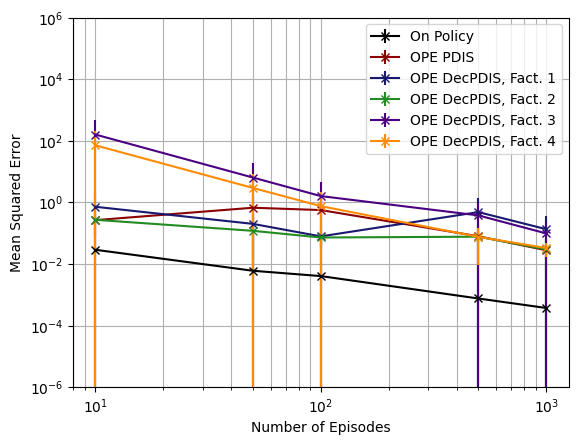

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**6, shorter_D, estimator='PDIS')

On Policy-----[0.02881538 0.00599428 0.00403061 0.00075408 0.00037115]
OPE PDWIS-----[0.31677853 0.29151964 0.29221455 0.2965154  0.29539313]
OPE DecPDWIS, Fact. 1-----[0.32277085 0.2962979  0.29594275 0.29716076 0.29622093]
OPE DecPDWIS, Fact. 2-----[0.31847422 0.29309446 0.29319737 0.2946538  0.29377991]
OPE DecPDWIS, Fact. 3-----[0.32021727 0.2956812  0.29575926 0.29558621 0.29539728]
OPE DecPDWIS, Fact. 4-----[0.32028353 0.29461356 0.29467307 0.294724   0.29403115]


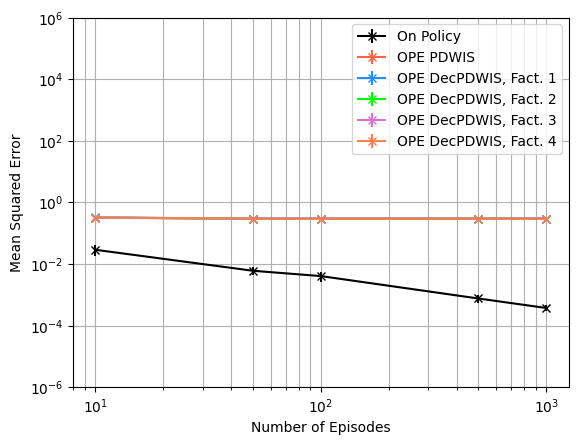

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[ 2.55877235  2.3106493   5.61294096  7.25054333 25.95074084]
OPE DecIS, Fact. 1-----[ 1.72742351  1.60612073  4.57688791 11.44434014 14.39417244]
OPE DecIS, Fact. 2-----[ 1.12923386  3.28812136  6.90020699 24.12726074 24.57522916]
OPE DecIS, Fact. 3-----[ 1.28087388  6.4607805  16.98419912  9.90233176 20.62443702]
OPE DecIS, Fact. 4-----[ 1.52433847  1.89184275  5.22396863 12.15290461 18.17310048]


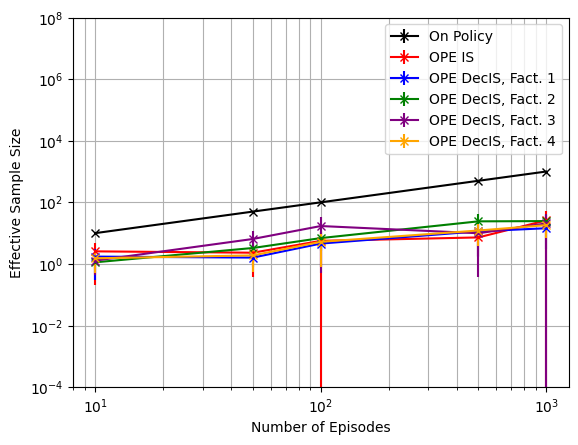

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[ 2.55877235  2.3106493   5.61294096  7.25054333 25.95074084]
OPE DecPDIS, Fact. 1-----[ 2.9579971   2.83361885  7.76356077 22.07806699 31.29824569]
OPE DecPDIS, Fact. 2-----[ 1.24148019  4.46072231  9.69420855 29.81882282 34.96879617]
OPE DecPDIS, Fact. 3-----[ 1.23328889  4.82792705 17.40418453 15.22472838 25.52840207]
OPE DecPDIS, Fact. 4-----[ 1.59786703  3.87700884  8.92550552 18.13205224 33.20551952]


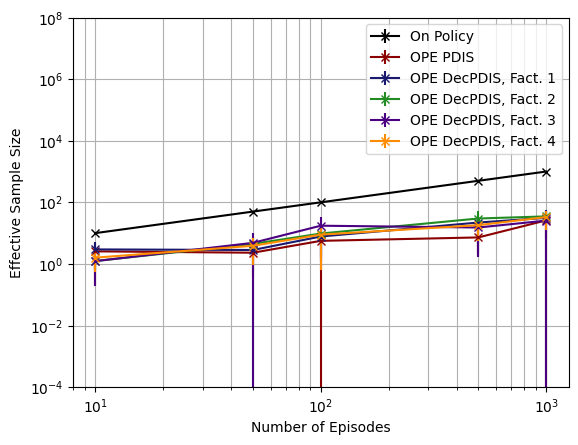

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[ 2622.38976669  3508.11821636  5849.8222653   4840.98131702
 11322.45454744]
OPE DecPDWIS, Fact. 1-----[ 4572.02868876  7010.79600129 16860.22364566 21318.49722095
 31381.94869925]
OPE DecPDWIS, Fact. 2-----[ 3070.99425313  8321.95295846 11065.30977493 12430.18201405
 23053.82617725]
OPE DecPDWIS, Fact. 3-----[ 2019.38078683  6977.87828978  9441.77370301 21592.87864963
 31012.94606567]
OPE DecPDWIS, Fact. 4-----[ 3453.21871464 12030.65417627 15326.57599649 32076.25712251
 52639.24152395]


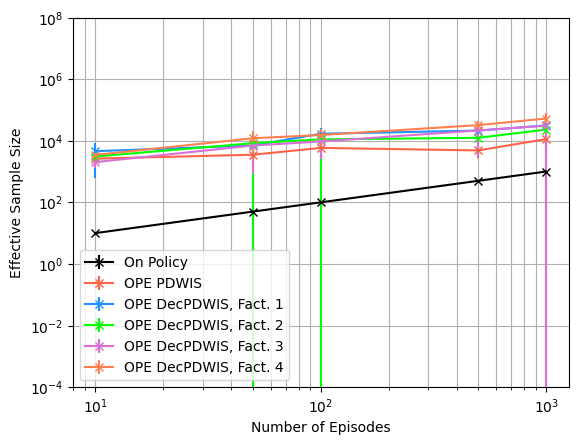

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{20}$)



Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc
gc.collect()
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.7476828630727625. Variance of on policy Q estimate: 0.030958011942666043
Mean OPE IS estimate: -0.6749815255495666. Bias1: 0.07270133752319612. Bias2: 0.07270133752319596. Variance: 0.027163020654164687. MSE: 0.03244850513182637
Mean OPE PDIS estimate: -0.6749815255495666. Bias1: 0.07270133752319612. Bias2: 0.07270133752319596. Variance: 0.027163020654164687. MSE: 0.03244850513182637
Mean OPE PDWIS estimate: -0.037691145285818475. Bias1: 0.709991717786944. Bias2: 0.709991717786944. Variance: 5.401818363394283e-05. MSE: 0.5041422575096896
Mean OPE DecIS: Fact. 1 estimate: -0.8077489954920086. Bias1: 0.06006613241924619. Bias2: 0.06006613241924608. Variance: 0.031999897870286474. MSE: 0.03560783813409289
Mean OPE DecPDIS: Fact. 1 estimate: -0.7084130473664166. Bias1: 0.039269815706345954. Bias2: 0.03926981570634591. Variance: 0.03128067631640247. MSE: 0.03282279474201284
Mean OPE DecPDWIS: Fact. 1 estimate:

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.05191166 0.02261095 0.0101601  0.00642765 0.00535941]
OPE DecIS, Fact. 1-----[0.08275452 0.10554579 0.1106846  0.12214176 0.11946409]
OPE DecIS, Fact. 2-----[0.05794968 0.02298565 0.00962637 0.01215284 0.00842211]
OPE DecIS, Fact. 3-----[0.04687218 0.04998339 0.04575525 0.05688217 0.05317313]
OPE DecIS, Fact. 4-----[0.06209575 0.07595032 0.07795985 0.09045216 0.08657185]


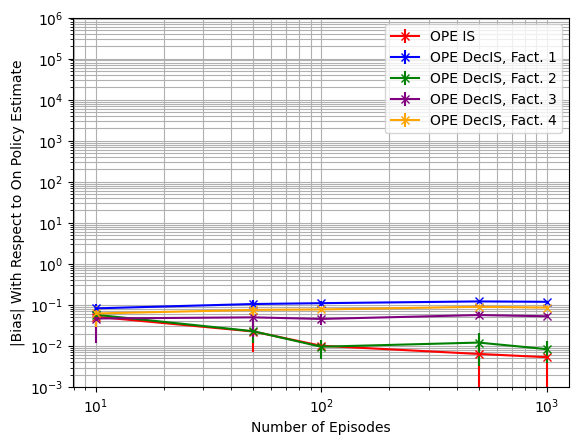

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**6, shorter_D, estimator='IS')

OPE PDIS-----[0.05191166 0.02261095 0.0101601  0.00642765 0.00535941]
OPE DecPDIS, Fact. 1-----[0.02409165 0.02319751 0.01371937 0.01064747 0.00763069]
OPE DecPDIS, Fact. 2-----[0.0612962  0.02370816 0.00887516 0.0076875  0.00369145]
OPE DecPDIS, Fact. 3-----[0.03902731 0.02941959 0.01692373 0.008162   0.00719208]
OPE DecPDIS, Fact. 4-----[0.0328111  0.02412008 0.01141967 0.0113359  0.00625206]


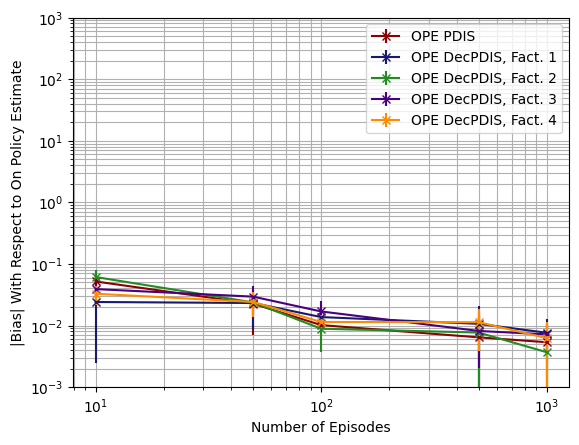

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.72851652 0.71816963 0.71482224 0.70798623 0.71218155]
OPE DecPDWIS, Fact. 1-----[0.7314893  0.72086965 0.71729971 0.71023738 0.71442439]
OPE DecPDWIS, Fact. 2-----[0.72930807 0.719226   0.71563281 0.70851398 0.71267023]
OPE DecPDWIS, Fact. 3-----[0.73051283 0.72066667 0.71707138 0.70985533 0.71407398]
OPE DecPDWIS, Fact. 4-----[0.73067124 0.72057008 0.71694326 0.70965996 0.71384635]


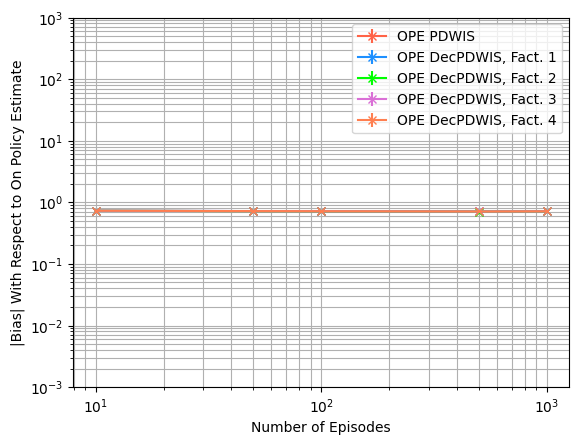

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.02298923 0.00442832 0.00291397 0.00055693 0.0002147 ]
OPE IS-----[0.0405514  0.00909131 0.0053957  0.00101003 0.00043035]
OPE DecIS, Fact. 1-----[0.04232944 0.0080531  0.00516782 0.00096404 0.00048132]
OPE DecIS, Fact. 2-----[0.03886065 0.00796421 0.00497818 0.00084823 0.00036606]
OPE DecIS, Fact. 3-----[0.07743727 0.00718629 0.00472413 0.00081607 0.00039111]
OPE DecIS, Fact. 4-----[0.05321322 0.00620784 0.0039879  0.00067939 0.00032338]


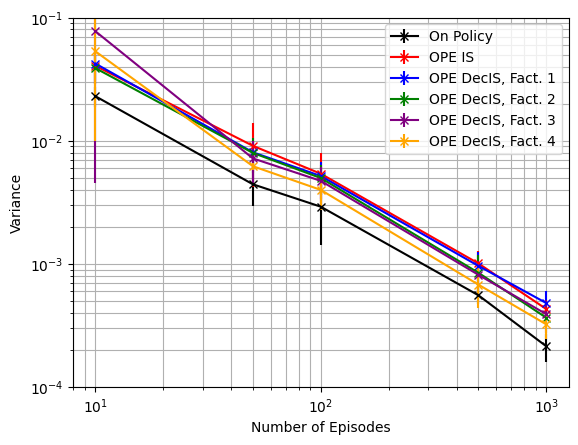

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**(-1), shorter_D, estimator='IS')

On Policy-----[0.02298923 0.00442832 0.00291397 0.00055693 0.0002147 ]
OPE PDIS-----[0.0405514  0.00909131 0.0053957  0.00101003 0.00043035]
OPE DecPDIS, Fact. 1-----[0.0347327  0.00659726 0.00424327 0.00081026 0.00039582]
OPE DecPDIS, Fact. 2-----[0.03777517 0.00746121 0.00511591 0.0007892  0.0003402 ]
OPE DecPDIS, Fact. 3-----[0.07454875 0.00709424 0.00452688 0.00078318 0.00036037]
OPE DecPDIS, Fact. 4-----[0.04868479 0.00546465 0.00372486 0.00058805 0.00028164]


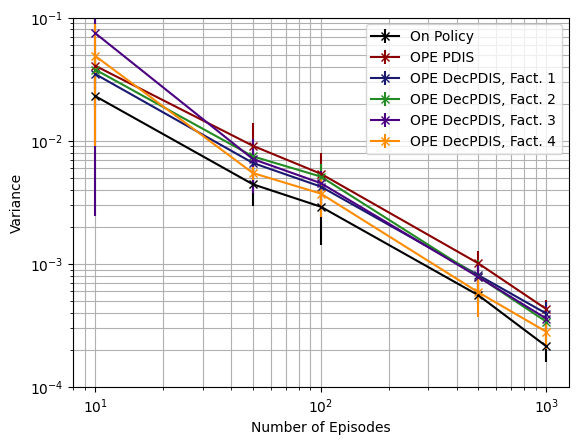

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**(-1), shorter_D, estimator='PDIS')

On Policy-----[0.02298923 0.00442832 0.00291397 0.00055693 0.0002147 ]
OPE PDWIS-----[6.05709775e-05 1.46534465e-05 8.84504056e-06 1.89162257e-06
 1.10094253e-06]
OPE DecPDWIS, Fact. 1-----[4.81485069e-05 9.85560203e-06 5.95456851e-06 1.41126632e-06
 7.81283719e-07]
OPE DecPDWIS, Fact. 2-----[5.80021913e-05 1.22744097e-05 7.58440143e-06 1.57184047e-06
 7.87004179e-07]
OPE DecPDWIS, Fact. 3-----[6.18726970e-05 1.22319729e-05 8.02641164e-06 1.41944403e-06
 8.47889586e-07]
OPE DecPDWIS, Fact. 4-----[5.19366810e-05 9.33413856e-06 5.67743285e-06 1.09169904e-06
 6.11821781e-07]


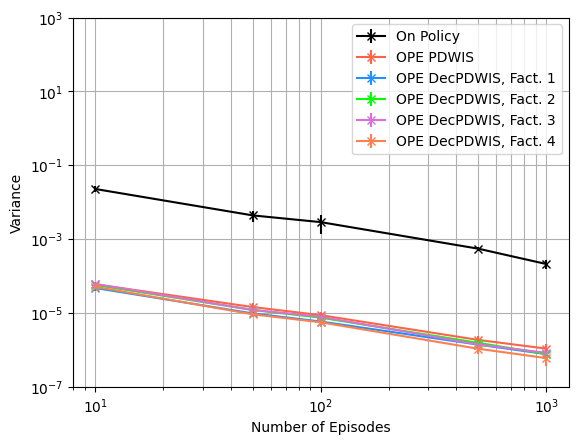

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.02298923 0.00442832 0.00291397 0.00055693 0.0002147 ]
OPE IS-----[0.04381357 0.00984404 0.00551032 0.00114912 0.0004802 ]
OPE DecIS, Fact. 1-----[0.04970694 0.02004407 0.01765402 0.01599229 0.01478132]
OPE DecIS, Fact. 2-----[0.04287736 0.00861939 0.00509256 0.00107459 0.00045734]
OPE DecIS, Fact. 3-----[0.08086457 0.01082607 0.00701612 0.00414986 0.00325606]
OPE DecIS, Fact. 4-----[0.05812709 0.01277746 0.0102145  0.0089357  0.00784623]


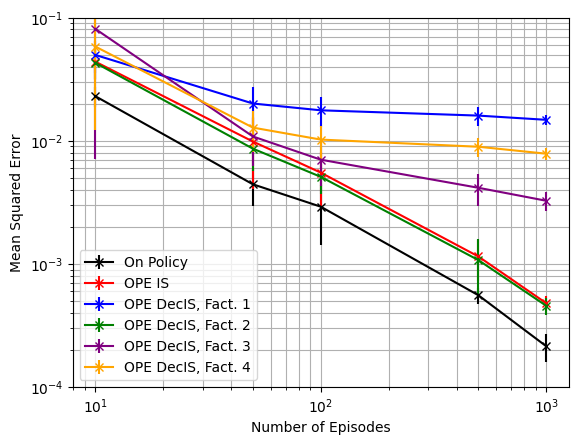

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**(-1), shorter_D, estimator='IS')

On Policy-----[0.02298923 0.00442832 0.00291397 0.00055693 0.0002147 ]
OPE PDIS-----[0.04381357 0.00984404 0.00551032 0.00114912 0.0004802 ]
OPE DecPDIS, Fact. 1-----[0.03577963 0.00734259 0.00445491 0.00102664 0.00047985]
OPE DecPDIS, Fact. 2-----[0.0418763  0.00804789 0.00522173 0.0008929  0.00036419]
OPE DecPDIS, Fact. 3-----[0.07639926 0.00818146 0.00488299 0.00088684 0.00042445]
OPE DecPDIS, Fact. 4-----[0.0498914  0.00615304 0.00386574 0.00077232 0.00034923]


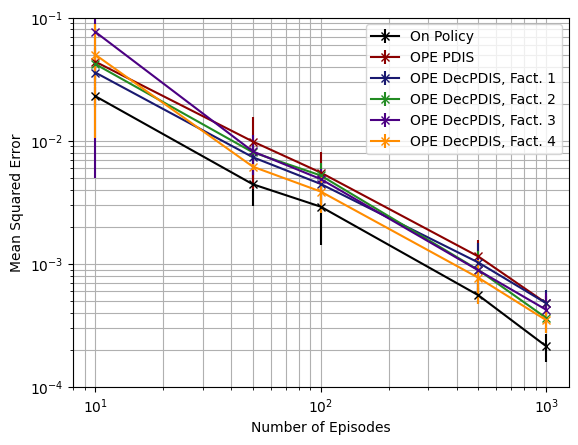

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**(-1), shorter_D, estimator='PDIS')

On Policy-----[0.02298923 0.00442832 0.00291397 0.00055693 0.0002147 ]
OPE PDWIS-----[0.53124875 0.51612003 0.5110831  0.50127351 0.50722172]
OPE DecPDWIS, Fact. 1-----[0.53555027 0.51999792 0.51463094 0.50446635 0.51042109]
OPE DecPDWIS, Fact. 2-----[0.53240924 0.51763108 0.5122433  0.50202204 0.50791757]
OPE DecPDWIS, Fact. 3-----[0.53415261 0.51970436 0.51429981 0.50392417 0.509921  ]
OPE DecPDWIS, Fact. 4-----[0.53437342 0.51956374 0.51411796 0.50364705 0.50959546]


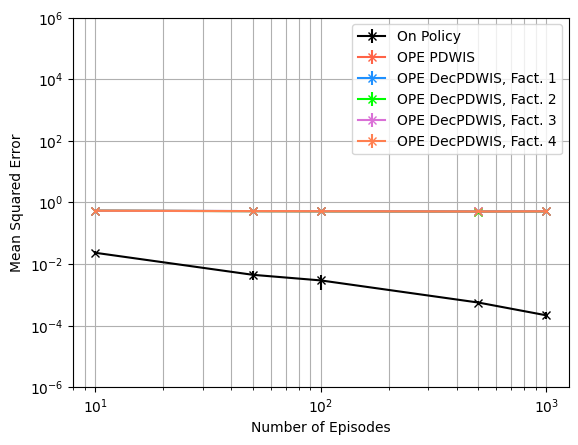

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[  6.33940064  31.86723825  72.6907279  293.94350892 527.86625456]
OPE DecIS, Fact. 1-----[  5.86358111  28.1690622   60.05813236 319.36534342 499.56779918]
OPE DecIS, Fact. 2-----[  6.44317883  31.96681293  64.81699075 390.98066569 583.8559067 ]
OPE DecIS, Fact. 3-----[  4.74020487  34.58428354  70.31123709 363.53871524 582.64405629]
OPE DecIS, Fact. 4-----[  6.44621525  35.19418177  81.3814961  459.40120573 691.56725096]


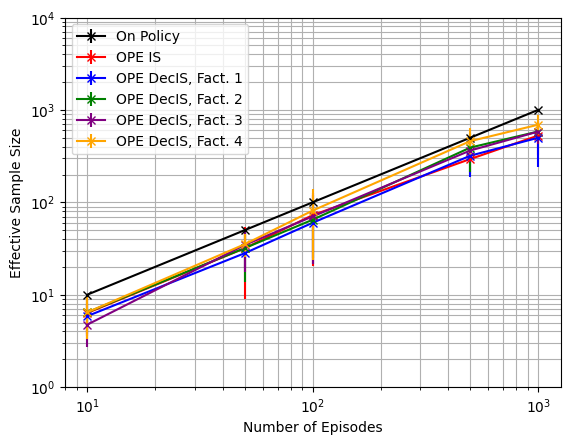

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**4, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[  6.33940064  31.86723825  72.6907279  293.94350892 527.86625456]
OPE DecPDIS, Fact. 1-----[  6.92933415  34.8727288   74.06005365 389.35305054 606.81159331]
OPE DecPDIS, Fact. 2-----[  6.4263057   32.46263273  62.77272183 417.06993522 645.5025346 ]
OPE DecPDIS, Fact. 3-----[  4.99089796  37.15815766  69.03704527 385.29295204 620.98661503]
OPE DecPDIS, Fact. 4-----[  6.83966352  40.55989002  88.83897303 531.64493717 813.59304952]


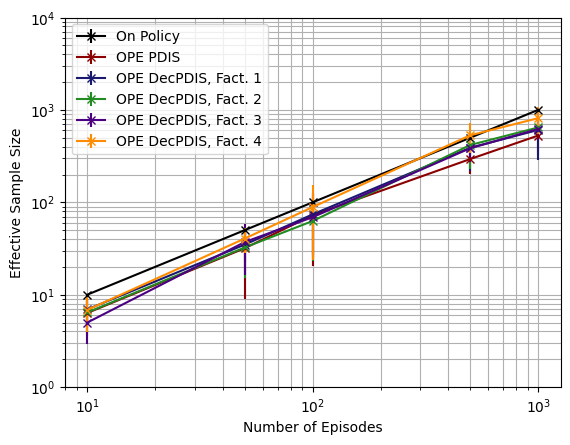

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**4, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[  3893.08842389  16722.1990409   37310.16060305 156432.35279593
 208540.72569828]
OPE DecPDWIS, Fact. 1-----[  4863.81010656  23669.83060211  48572.86249318 220507.77067395
 315895.56912698]
OPE DecPDWIS, Fact. 2-----[  3952.02667486  18388.79525811  39633.88861792 185649.58558642
 288834.13289581]
OPE DecPDWIS, Fact. 3-----[  3698.75286199  20261.42824558  35246.40026549 211889.42777394
 313302.31273979]
OPE DecPDWIS, Fact. 4-----[  4446.10285048  24082.20131482  52823.25181678 285291.30452005
 409305.1080384 ]


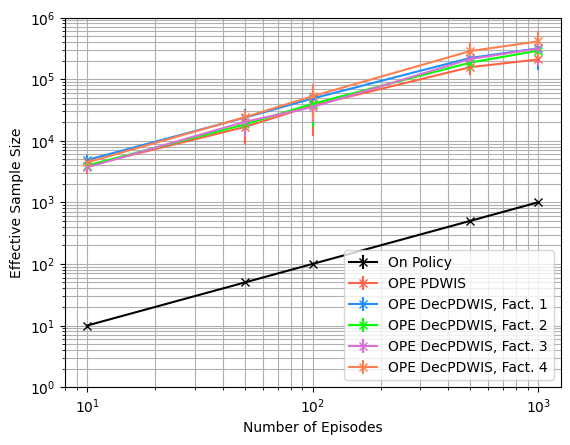

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**(6), shorter_D, estimator='PDWIS')

### Varying Episode Length $T$ With $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{T}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc

gc.collect()
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
LENGTHS = [1, 5, 10, 20]

bias_means = np.zeros((len(LENGTHS), 16))
bias_stds = np.zeros((len(LENGTHS), 16))
var_means = np.zeros((len(LENGTHS), 16))
var_stds = np.zeros((len(LENGTHS), 16))
MSE_means = np.zeros((len(LENGTHS), 16))
MSE_stds = np.zeros((len(LENGTHS), 16))
ESS_means = np.zeros((len(LENGTHS), 16))
ESS_stds = np.zeros((len(LENGTHS), 16))

RUNS = 20

for id in range(len(LENGTHS)):
  e = LENGTHS[id]
  print(f'{e} Steps, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

1 Steps, 20 ----------------------------------

Mean on policy Q estimate: -0.9312882590828837. Variance of on policy Q estimate: 0.0028521074059292104
Mean OPE IS estimate: -0.5931978619561863. Bias1: 0.3380903971266975. Bias2: 0.3380903971266974. Variance: 0.5161442304644911. MSE: 0.6304493470937791
Mean OPE PDIS estimate: -0.5931978619561863. Bias1: 0.3380903971266975. Bias2: 0.3380903971266974. Variance: 0.5161442304644911. MSE: 0.6304493470937791
Mean OPE PDWIS estimate: -0.03613286715132115. Bias1: 0.8951553919315626. Bias2: 0.8951553919315626. Variance: 0.0005957804576156067. MSE: 0.801898956161765
Mean OPE DecIS: Fact. 1 estimate: -0.668122900361925. Bias1: 0.2631653587209592. Bias2: 0.2631653587209587. Variance: 0.8332042525886127. MSE: 0.9024602586193439
Mean OPE DecPDIS: Fact. 1 estimate: -0.5410234692562859. Bias1: 0.3902647898265978. Bias2: 0.39026478982659785. Variance: 0.9396070028590916. MSE: 1.0919136090374901
Mean OPE DecPDWIS: Fact. 1 estimate: -0.031422108231800236.

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.18840494 0.07785454 0.06585066 0.04790317]
OPE DecIS, Fact. 1-----[0.25891086 0.13165025 0.09422979 0.1363265 ]
OPE DecIS, Fact. 2-----[0.21099625 0.05887594 0.05159347 0.03345657]
OPE DecIS, Fact. 3-----[0.24893391 0.08394204 0.07740188 0.08579597]
OPE DecIS, Fact. 4-----[0.22788339 0.10330059 0.07357103 0.10754018]


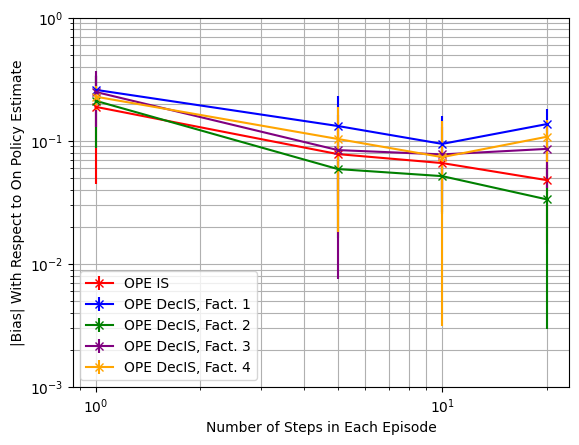

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.18840494 0.07785454 0.06585066 0.04790317]
OPE DecPDIS, Fact. 1-----[0.23998957 0.07228578 0.04722808 0.04184467]
OPE DecPDIS, Fact. 2-----[0.20109494 0.06037056 0.05190232 0.02766926]
OPE DecPDIS, Fact. 3-----[0.22165657 0.08123682 0.06607003 0.04749652]
OPE DecPDIS, Fact. 4-----[0.20866832 0.07078032 0.05338497 0.04265481]


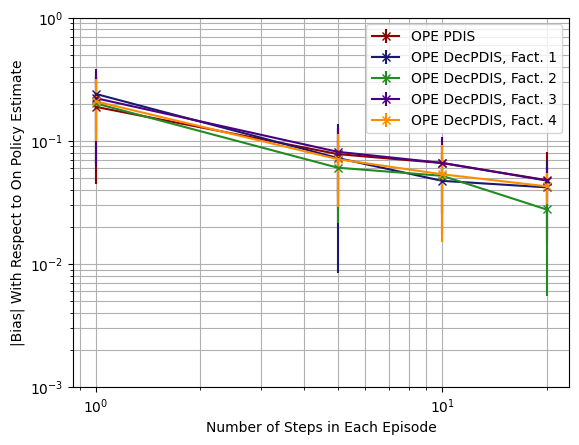

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.73415391 0.70062889 0.71704125 0.70043175]
OPE DecPDWIS, Fact. 1-----[0.73803862 0.7033377  0.72001403 0.70372128]
OPE DecPDWIS, Fact. 2-----[0.73568152 0.70102261 0.7178328  0.70180689]
OPE DecPDWIS, Fact. 3-----[0.73690042 0.70253789 0.71903756 0.70310143]
OPE DecPDWIS, Fact. 4-----[0.73749257 0.70247958 0.71919597 0.70324333]


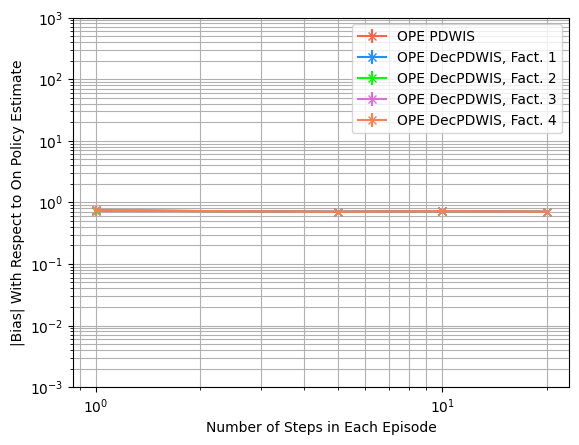

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.20729101 0.04336634 0.02187078 0.01270441]
OPE IS-----[0.4144097  0.06363601 0.0405514  0.02394661]
OPE DecIS, Fact. 1-----[0.79360552 0.09387391 0.04232944 0.02247843]
OPE DecIS, Fact. 2-----[0.65703079 0.07757515 0.03886065 0.0185171 ]
OPE DecIS, Fact. 3-----[0.53813922 0.24045997 0.07743727 0.02800458]
OPE DecIS, Fact. 4-----[0.50364546 0.15544032 0.05321322 0.01911981]


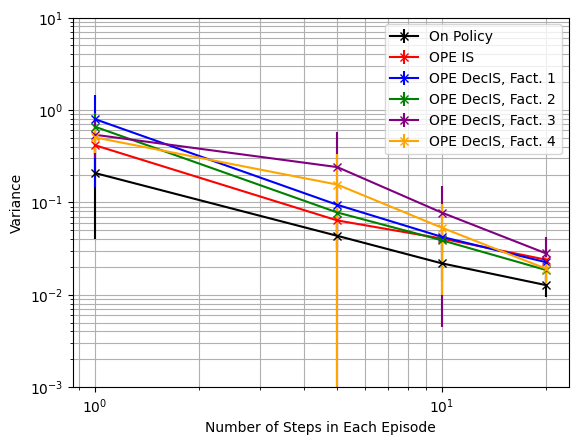

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-3), 10**1, shorter_D, estimator='IS')

On Policy-----[0.20729101 0.04336634 0.02187078 0.01270441]
OPE PDIS-----[0.4144097  0.06363601 0.0405514  0.02394661]
OPE DecPDIS, Fact. 1-----[0.75866331 0.07936459 0.0347327  0.01789638]
OPE DecPDIS, Fact. 2-----[0.69135701 0.06996442 0.03777517 0.01698113]
OPE DecPDIS, Fact. 3-----[0.54697036 0.23640048 0.07454875 0.02685481]
OPE DecPDIS, Fact. 4-----[0.52013654 0.14406855 0.04868479 0.01648457]


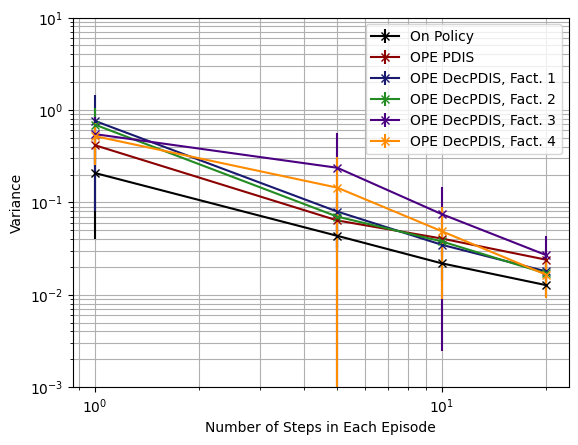

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-3), 10**1, shorter_D, estimator='PDIS')

On Policy-----[0.20729101 0.04336634 0.02187078 0.01270441]
OPE PDWIS-----[4.76740544e-04 9.83668585e-05 6.05709775e-05 3.04844753e-05]
OPE DecPDWIS, Fact. 1-----[4.15875226e-04 8.86539273e-05 4.81485069e-05 2.38362862e-05]
OPE DecPDWIS, Fact. 2-----[4.92700024e-04 1.00979337e-04 5.80021913e-05 2.52051625e-05]
OPE DecPDWIS, Fact. 3-----[4.47362788e-04 1.00860177e-04 6.18726970e-05 2.90806388e-05]
OPE DecPDWIS, Fact. 4-----[4.33236280e-04 9.17058419e-05 5.19366810e-05 2.20006978e-05]


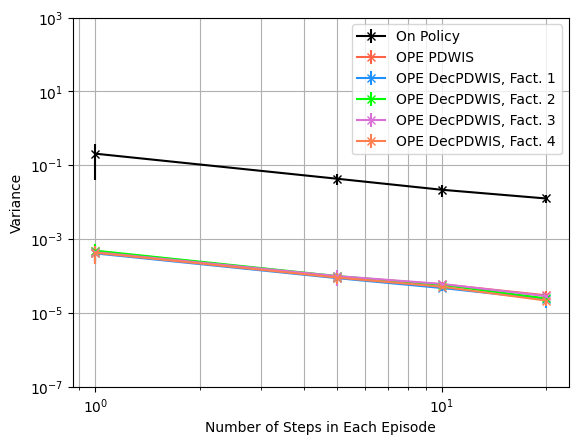

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.20729101 0.04336634 0.02187078 0.01270441]
OPE IS-----[0.47056592 0.07220239 0.04553707 0.02734848]
OPE DecIS, Fact. 1-----[0.8670381  0.12097783 0.05519115 0.04314559]
OPE DecIS, Fact. 2-----[0.71700235 0.08285841 0.04221318 0.02056728]
OPE DecIS, Fact. 3-----[0.61418669 0.25335077 0.08603209 0.03731056]
OPE DecIS, Fact. 4-----[0.55816943 0.17334998 0.06359119 0.03235522]


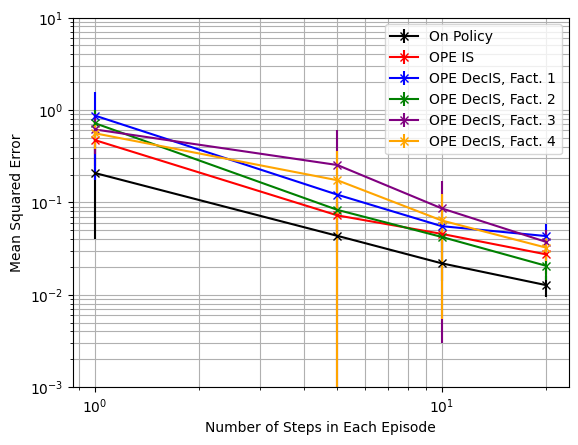

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-3), 10**1, shorter_D, estimator='IS')

On Policy-----[0.20729101 0.04336634 0.02187078 0.01270441]
OPE PDIS-----[0.47056592 0.07220239 0.04553707 0.02734848]
OPE DecPDIS, Fact. 1-----[0.8314776  0.08865889 0.03785507 0.02033204]
OPE DecPDIS, Fact. 2-----[0.75029799 0.07510897 0.04110807 0.01823787]
OPE DecPDIS, Fact. 3-----[0.62137994 0.24513586 0.08055439 0.0292938 ]
OPE DecPDIS, Fact. 4-----[0.57540092 0.15083061 0.05301361 0.01845438]


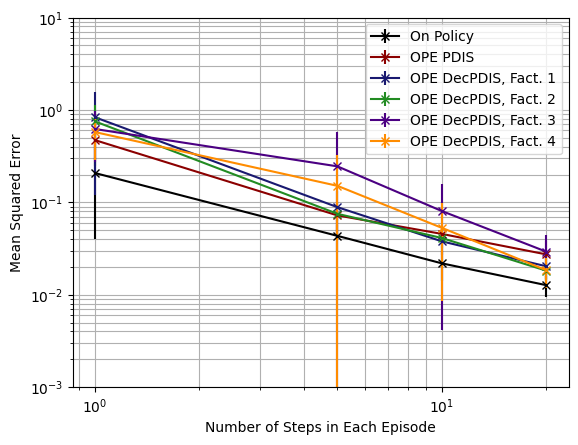

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-3), 10**1, shorter_D, estimator='PDIS')

On Policy-----[0.20729101 0.04336634 0.02187078 0.01270441]
OPE PDWIS-----[0.55710191 0.49439318 0.51605807 0.49137751]
OPE DecPDWIS, Fact. 1-----[0.56280622 0.49821575 0.5203266  0.49597924]
OPE DecPDWIS, Fact. 2-----[0.55941401 0.49492637 0.51717985 0.49326374]
OPE DecPDWIS, Fact. 3-----[0.561174   0.49703414 0.51895511 0.49511401]
OPE DecPDWIS, Fact. 4-----[0.56205543 0.49695548 0.51915482 0.49529377]


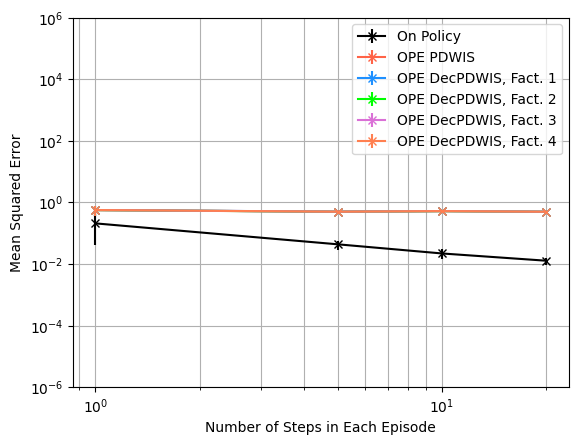

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[ 1.  5. 10. 20.]
OPE IS-----[ 0.64185837  4.5921537   5.97117494 12.59669289]
OPE DecIS, Fact. 1-----[ 0.40705919  2.96069323  5.3655269  11.60645909]
OPE DecIS, Fact. 2-----[ 0.32212005  2.83333605  6.58586804 15.56192801]
OPE DecIS, Fact. 3-----[ 0.48796648  4.96475578  4.45691301 11.16768964]
OPE DecIS, Fact. 4-----[ 0.42228733  2.96704432  5.89883942 14.31886976]


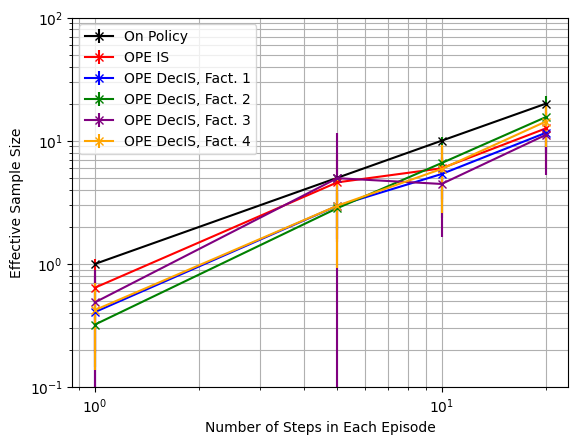

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-1), 10**2, shorter_D, estimator='IS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDIS-----[ 0.64185837  4.5921537   5.97117494 12.59669289]
OPE DecPDIS, Fact. 1-----[ 0.51911817  3.70406411  6.51291717 14.83276449]
OPE DecPDIS, Fact. 2-----[ 0.36581217  3.10732217  6.42775198 16.47889302]
OPE DecPDIS, Fact. 3-----[ 0.55305379  4.83644083  4.61861459 11.64760915]
OPE DecPDIS, Fact. 4-----[ 0.50216672  3.53096044  6.27631491 17.49843543]


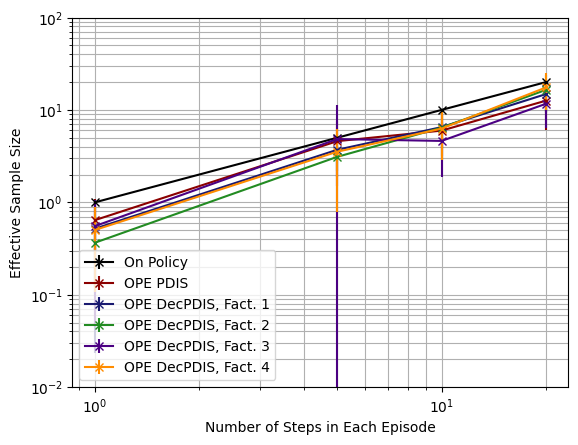

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-2), 10**2, shorter_D, estimator='PDIS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDWIS-----[ 561.08299912 2474.28526477 3758.34915299 9645.14754166]
OPE DecPDWIS, Fact. 1-----[  697.14884469  2770.4737705   4464.4777785  11948.87353093]
OPE DecPDWIS, Fact. 2-----[  598.6284819   2208.37440696  3816.91663525 10848.60825075]
OPE DecPDWIS, Fact. 3-----[ 621.98585728 2762.14934698 3592.82959779 9338.42734471]
OPE DecPDWIS, Fact. 4-----[  673.6947672   2610.67513336  4118.96311257 12366.37583507]


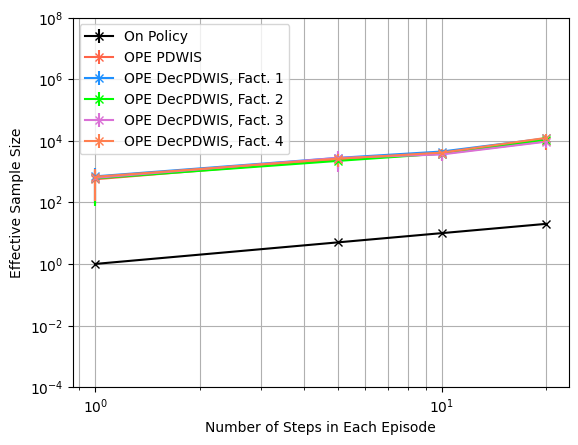

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

## From Patient State 56, With Diabetes

In [ ]:
#The patient has diabetes
PROB_DIAB = 1.0

### State Analysis

In [ ]:
#Instantiate a state based on the idx and get the state vector
testState = State(state_idx = 56, diabetic_idx=1)
vec = testState.get_state_vector()

print(vec)
print(f'Num abnormals: {testState.get_num_abnormal()}\n')

print(f'Heart Rate: {hr_state_mapping[vec[0]]}')
print(f'Systolic Blood Pressure: {sbp_state_mapping[vec[1]]}')
print(f'Percent Oxygen: {o2_state_mapping[vec[2]]}')
print(f'Glucose Level: {glu_state_mapping[vec[3]]}')
print(f'Antibiotics: {abx_state_mapping[vec[4]]}')
print(f'Vasopressors: {vaso_state_mapping[vec[5]]}')
print(f'Ventilator: {vent_state_mapping[vec[6]]}')
print(f'Diabetes: {testState.diabetic_idx}')

[0 0 1 2 0 0 0]
Num abnormals: 2

Heart Rate: Low
Systolic Blood Pressure: Low
Percent Oxygen: Normal
Glucose Level: Normal
Antibiotics: Off
Vasopressors: Off
Ventilator: Off
Diabetes: 1


### Generate Data From Behaviour Policy

Run the data generator

In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=randPol, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

Convert data into array format

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_b = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_b.shape

(100000, 20, 5)

In [ ]:
f_tr_b1, f_tr_b2, f_tr_b3, f_tr_b4 = factorise_dataset(nf_tr_b)

In [ ]:
print(nf_tr_b)

[[[  0.  56.   0.  -1.  88.]
  [  1.  88.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0.  56.   3.  -1. 227.]
  [  1. 227.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0.  56.   7.   0. 143.]
  [  1. 143.   3.  -1. 227.]
  [  2. 227.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 ...

 [[  0.  56.   1.   0. 146.]
  [  1. 146.   4.  -1. 116.]
  [  2. 116.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0.  56.   3.   0. 147.]
  [  1. 147.   6.   0. 141.]
  [  2. 141.   2.   0. 137.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0.  56.   6.   0.  61.]
  [  1.  61.   5.  -1. 190.]
  [  2. 190.  -1.   0.  -1

In [ ]:
print(f_tr_b1)

[[[[  0.   56.    0.   -0.5  88. ]
   [  0.   56.    0.   -0.5  88. ]]

  [[  1.   88.    1.    0.   -1. ]
   [  1.   88.   -1.    0.   -1. ]]

  [[  2.   -1.    1.    0.   -1. ]
   [  2.   -1.   -1.    0.   -1. ]]

  ...

  [[ 17.   -1.    1.    0.   -1. ]
   [ 17.   -1.   -1.    0.   -1. ]]

  [[ 18.   -1.    1.    0.   -1. ]
   [ 18.   -1.   -1.    0.   -1. ]]

  [[ 19.   -1.    1.    0.   -1. ]
   [ 19.   -1.   -1.    0.   -1. ]]]


 [[[  0.   56.    1.   -0.5 227. ]
   [  0.   56.    1.   -0.5 227. ]]

  [[  1.  227.    1.    0.   -1. ]
   [  1.  227.   -1.    0.   -1. ]]

  [[  2.   -1.    1.    0.   -1. ]
   [  2.   -1.   -1.    0.   -1. ]]

  ...

  [[ 17.   -1.    1.    0.   -1. ]
   [ 17.   -1.   -1.    0.   -1. ]]

  [[ 18.   -1.    1.    0.   -1. ]
   [ 18.   -1.   -1.    0.   -1. ]]

  [[ 19.   -1.    1.    0.   -1. ]
   [ 19.   -1.   -1.    0.   -1. ]]]


 [[[  0.   56.    1.    0.  143. ]
   [  0.   56.    3.    0.  143. ]]

  [[  1.  143.    1.   -0.5 227. ]
   [  1.  1

In [ ]:
factored_randPol1 = factor_policy_1(randPol)
factored_randPol2 = factor_policy_2(randPol)
factored_randPol3 = factor_policy_3(randPol)
factored_randPol4 = factor_policy_4(randPol)

In [ ]:
randPol = pad_policy(randPol)

factored_randPol1[0] = pad_policy(factored_randPol1[0])
factored_randPol1[1] = pad_policy(factored_randPol1[1])

factored_randPol2[0] = pad_policy(factored_randPol2[0])
factored_randPol2[1] = pad_policy(factored_randPol2[1])

factored_randPol3[0] = pad_policy(factored_randPol3[0])
factored_randPol3[1] = pad_policy(factored_randPol3[1])

factored_randPol4[0] = pad_policy(factored_randPol4[0])
factored_randPol4[1] = pad_policy(factored_randPol4[1])
factored_randPol4[2] = pad_policy(factored_randPol4[2])

### Varying Episodes $\epsilon_{e} = 0.4$ (Policy Divergence $4.8^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
EVAL_EPSILON = 0.4

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

4.8


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.7907753172194076. Variance of on policy Q estimate: 0.011855483548266363
Mean OPE IS estimate: -1.1308437679688157. Bias1: 0.3400684507494084. Bias2: 0.34006845074940806. Variance: 5.199126876605237. MSE: 5.31477342780034
Mean OPE PDIS estimate: -1.1308437679688157. Bias1: 0.3400684507494084. Bias2: 0.34006845074940806. Variance: 5.199126876605237. MSE: 5.31477342780034
Mean OPE PDWIS estimate: -0.04625249806822581. Bias1: 0.7445228191511818. Bias2: 0.7445228191511818. Variance: 2.0503410750948327e-05. MSE: 0.5543347316475743
Mean OPE DecIS: Fact. 1 estimate: -1.325144074727234. Bias1: 0.5343687575078263. Bias2: 0.5343687575078264. Variance: 0.9999961909665572. MSE: 1.2855461599670153
Mean OPE DecPDIS: Fact. 1 estimate: -0.927662641562742. Bias1: 0.13688732434333456. Bias2: 0.1368873243433344. Variance: 0.4542387931475244. MSE: 0.4729769327134017
Mean OPE DecPDWIS: Fact. 1 estimate: -0.03562336946249607. 

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.17790997 0.0688322  0.06959555 0.03674366 0.02531608]
OPE DecIS, Fact. 1-----[0.40600485 0.37748351 0.40176931 0.48396823 0.54468714]
OPE DecIS, Fact. 2-----[0.19878333 0.18937283 0.21598632 0.19007956 0.18226881]
OPE DecIS, Fact. 3-----[0.06118514 0.03958464 0.04159634 0.02753122 0.01683019]
OPE DecIS, Fact. 4-----[0.1590642  0.15188207 0.15026866 0.19863807 0.23796872]


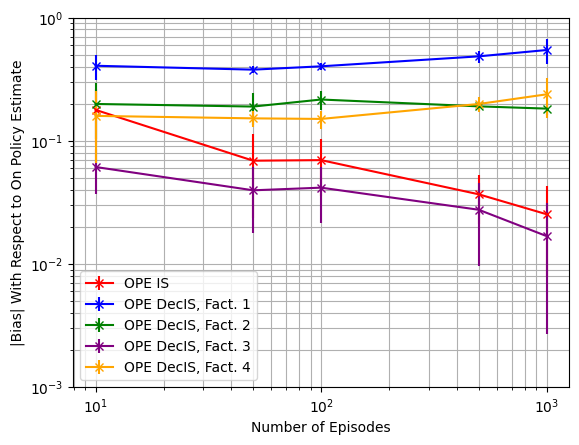

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.17790997 0.0688322  0.06959555 0.03674366 0.02531608]
OPE DecPDIS, Fact. 1-----[0.0593356  0.02801086 0.02537115 0.08837679 0.12012767]
OPE DecPDIS, Fact. 2-----[0.27974061 0.09519593 0.06188747 0.0682544  0.0715651 ]
OPE DecPDIS, Fact. 3-----[0.20876672 0.08162646 0.06543181 0.11256901 0.08480226]
OPE DecPDIS, Fact. 4-----[0.19569311 0.08086948 0.07784035 0.10713308 0.12415168]


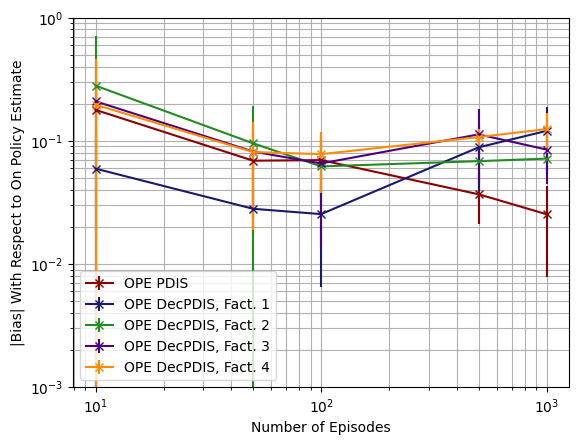

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.77412002 0.77391842 0.77856021 0.77496553 0.77796974]
OPE DecPDWIS, Fact. 1-----[0.78373357 0.78273414 0.78746049 0.78359081 0.78679858]
OPE DecPDWIS, Fact. 2-----[0.75024899 0.75204887 0.75726517 0.75504091 0.75808408]
OPE DecPDWIS, Fact. 3-----[0.7705095  0.76960213 0.77395123 0.76945088 0.77304829]
OPE DecPDWIS, Fact. 4-----[0.76425631 0.76489075 0.77013983 0.76737963 0.77048302]


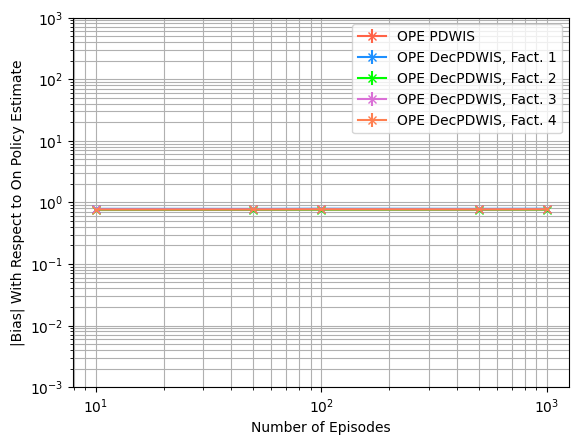

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.02090238 0.00381707 0.00207391 0.00045146 0.00023544]
OPE IS-----[1.31708592 0.19890883 0.11842557 0.04147915 0.03324173]
OPE DecIS, Fact. 1-----[0.46690954 0.07850272 0.04237744 0.05312002 0.45648087]
OPE DecIS, Fact. 2-----[0.35778373 0.04009081 0.01786545 0.00769415 0.00968944]
OPE DecIS, Fact. 3-----[0.29941978 0.03982073 0.01806147 0.01854657 0.00791003]
OPE DecIS, Fact. 4-----[0.20368507 0.03028993 0.01305488 0.00976499 0.19263394]


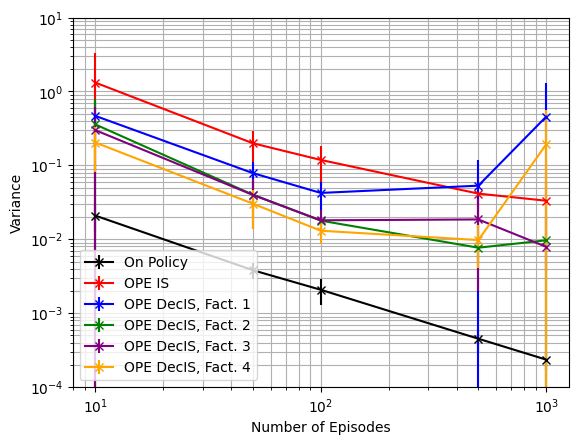

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**1, shorter_D, estimator='IS')

On Policy-----[0.02090238 0.00381707 0.00207391 0.00045146 0.00023544]
OPE PDIS-----[1.31708592 0.19890883 0.11842557 0.04147915 0.03324173]
OPE DecPDIS, Fact. 1-----[0.23691929 0.04624009 0.02818783 0.04358556 0.14875276]
OPE DecPDIS, Fact. 2-----[3.53339856 0.16128841 0.06537748 0.01416829 0.01098933]
OPE DecPDIS, Fact. 3-----[2.40511619 0.15493335 0.08137748 0.15465909 0.04303932]
OPE DecPDIS, Fact. 4-----[1.5222217  0.0700994  0.02721329 0.00779849 0.05881796]


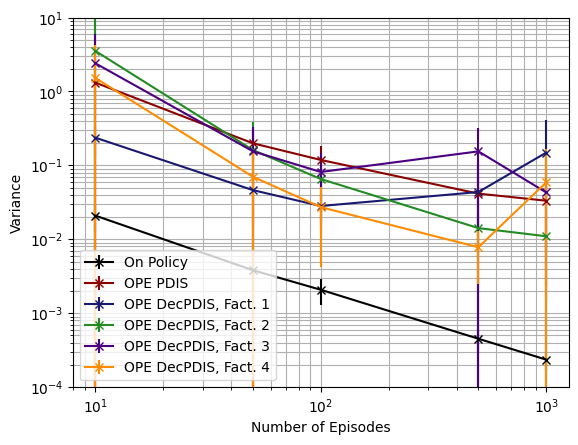

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**1, shorter_D, estimator='PDIS')

On Policy-----[0.02090238 0.00381707 0.00207391 0.00045146 0.00023544]
OPE PDWIS-----[1.86320551e-05 3.79170575e-05 1.84616115e-05 4.70905539e-05
 3.63783771e-05]
OPE DecPDWIS, Fact. 1-----[1.28246694e-05 1.42616215e-05 6.65568102e-06 6.37876621e-06
 1.30563531e-05]
OPE DecPDWIS, Fact. 2-----[4.58711687e-04 1.60057878e-04 9.71847651e-05 3.59843024e-05
 2.54614295e-05]
OPE DecPDWIS, Fact. 3-----[2.61086501e-04 1.05498610e-04 7.75285678e-05 5.95948649e-05
 2.50938487e-05]
OPE DecPDWIS, Fact. 4-----[2.08352501e-04 6.78593029e-05 4.29492716e-05 1.95081135e-05
 1.17906758e-05]


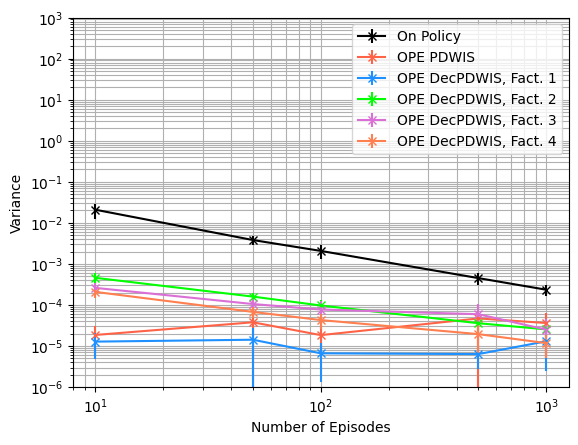

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.02090238 0.00381707 0.00207391 0.00045146 0.00023544]
OPE IS-----[1.35612921 0.20568092 0.12440628 0.0430701  0.03419014]
OPE DecIS, Fact. 1-----[0.64047968 0.22155903 0.20436262 0.29044761 0.76895338]
OPE DecIS, Fact. 2-----[0.40632769 0.07911809 0.06592373 0.04408831 0.04337316]
OPE DecIS, Fact. 3-----[0.30376589 0.04186386 0.02019655 0.01962769 0.00839303]
OPE DecIS, Fact. 4-----[0.23770806 0.05384039 0.03625139 0.04993966 0.25655734]


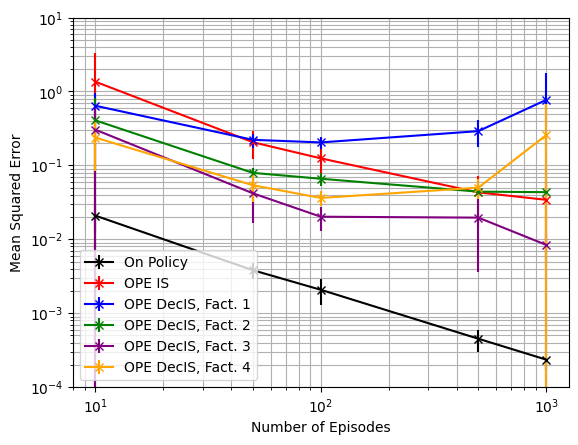

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**1, shorter_D, estimator='IS')

On Policy-----[0.02090238 0.00381707 0.00207391 0.00045146 0.00023544]
OPE PDIS-----[1.35612921 0.20568092 0.12440628 0.0430701  0.03419014]
OPE DecPDIS, Fact. 1-----[0.2423247  0.04714259 0.02918654 0.05380712 0.1676199 ]
OPE DecPDIS, Fact. 2-----[3.79563643 0.17952021 0.07022158 0.01911659 0.01641429]
OPE DecPDIS, Fact. 3-----[2.50743623 0.16503735 0.08836935 0.17186045 0.05185861]
OPE DecPDIS, Fact. 4-----[1.62927193 0.08046939 0.03486773 0.01956476 0.07617045]


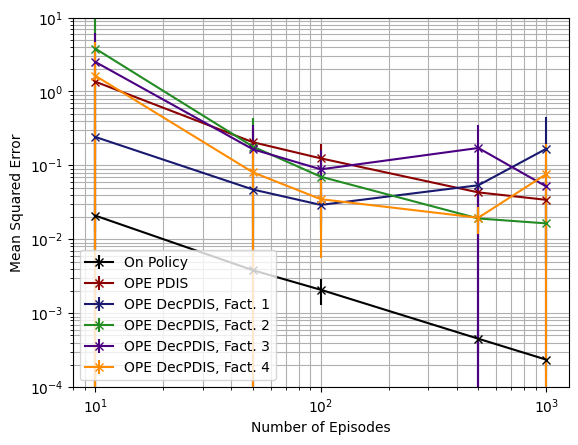

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**1, shorter_D, estimator='PDIS')

On Policy-----[0.02090238 0.00381707 0.00207391 0.00045146 0.00023544]
OPE PDWIS-----[0.59974935 0.59905337 0.60625168 0.60063131 0.6052842 ]
OPE DecPDWIS, Fact. 1-----[0.61469656 0.61274503 0.62018216 0.61403309 0.61907732]
OPE DecPDWIS, Fact. 2-----[0.5637106  0.5658409  0.57365167 0.57013394 0.57472725]
OPE DecPDWIS, Fact. 3-----[0.59434766 0.59248969 0.59918327 0.59212468 0.59764391]
OPE DecPDWIS, Fact. 4-----[0.58469269 0.58521525 0.59325814 0.58890216 0.59366769]


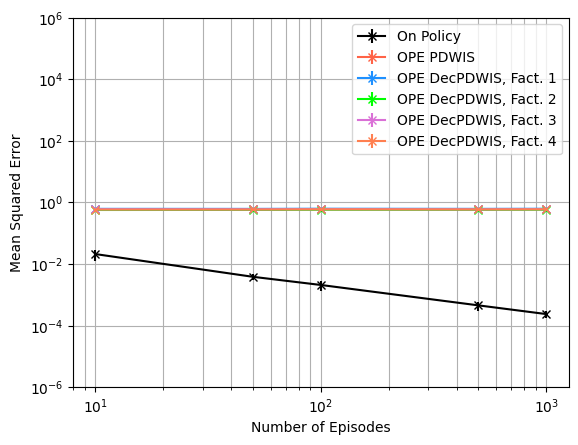

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[0.82340824 1.6303126  1.94699193 7.00557442 9.46608274]
OPE DecIS, Fact. 1-----[ 0.64408753  2.9997008   5.39995763 12.23883227 10.92265675]
OPE DecIS, Fact. 2-----[ 1.68698244  7.60507176 11.36842935 30.90788089 43.35881324]
OPE DecIS, Fact. 3-----[ 1.38294524  7.2718058  13.86981923 47.02645341 48.363681  ]
OPE DecIS, Fact. 4-----[ 1.40560823  7.85617656 18.55978354 34.52707556 45.25267653]


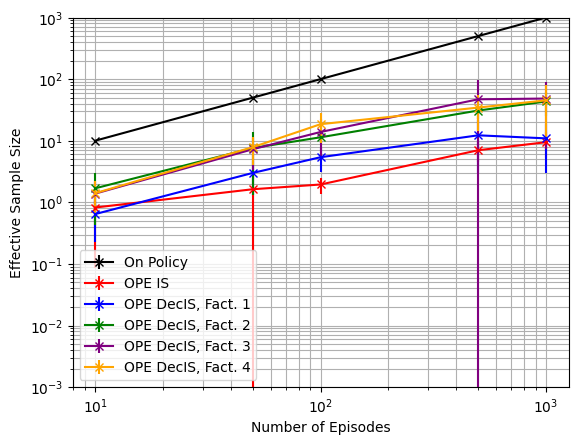

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-3), 10**3, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[0.82340824 1.6303126  1.94699193 7.00557442 9.46608274]
OPE DecPDIS, Fact. 1-----[ 1.15401526  6.102263    8.04392652 21.20116307 17.45085874]
OPE DecPDIS, Fact. 2-----[ 0.85595982  4.58024993  5.91061601 19.88878627 37.76862939]
OPE DecPDIS, Fact. 3-----[ 0.72814636  3.24835938  5.075625    9.83362357 21.05733159]
OPE DecPDIS, Fact. 4-----[ 1.51655991  8.77978823 18.01208405 46.44610373 70.21493863]


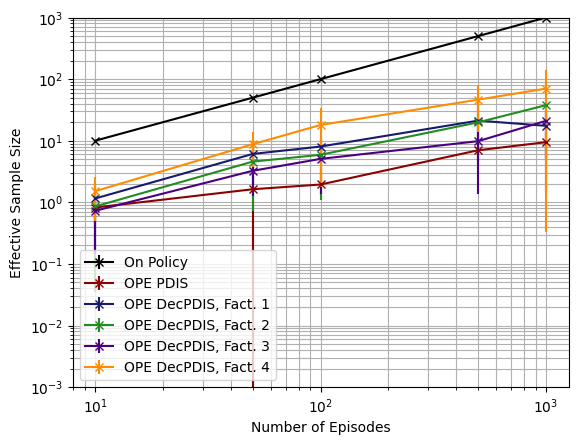

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[19887.99087487 12072.81297723 18104.50219419 12705.1985726
 47293.17796406]
OPE DecPDWIS, Fact. 1-----[24381.20829109 29510.90908798 44095.07180978 56034.43967671
 40330.20822559]
OPE DecPDWIS, Fact. 2-----[  552.63292797  1332.36899719  2633.14018044  7487.90185133
 10080.88560593]
OPE DecPDWIS, Fact. 3-----[  870.49671081  2359.1037676   3765.8047105   6744.10250973
 17481.46751567]
OPE DecPDWIS, Fact. 4-----[ 1184.83589469  3232.44926797  6128.61127542 15162.09287364
 29034.16273039]


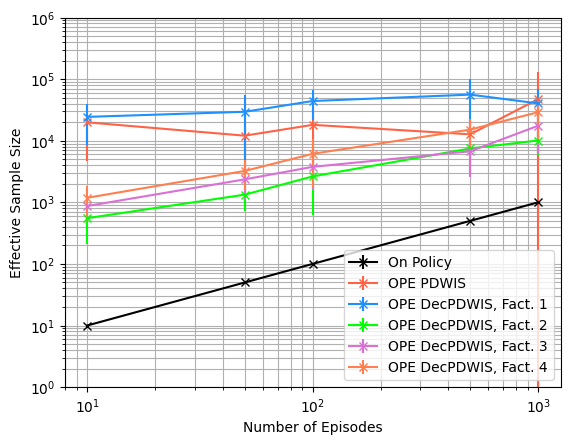

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**(6), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.6$ (Policy Divergence $3.2^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc

gc.collect()
EVAL_EPSILON = 0.6

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

3.2


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.8940805758032455. Variance of on policy Q estimate: 0.011534626149300092
Mean OPE IS estimate: -1.0125242702397323. Bias1: 0.11844369443648738. Bias2: 0.11844369443648683. Variance: 1.1086989865772423. MSE: 1.1227278953290063
Mean OPE PDIS estimate: -1.0125242702397323. Bias1: 0.11844369443648738. Bias2: 0.11844369443648683. Variance: 1.1086989865772423. MSE: 1.1227278953290063
Mean OPE PDWIS estimate: -0.0474941043615205. Bias1: 0.846586471441725. Bias2: 0.846586471441725. Variance: 1.335591403709761e-05. MSE: 0.7167220095421878
Mean OPE DecIS: Fact. 1 estimate: -1.2274774704095912. Bias1: 0.3333968946063454. Bias2: 0.3333968946063457. Variance: 0.3571938817005227. MSE: 0.4683473710336773
Mean OPE DecPDIS: Fact. 1 estimate: -0.9259802753638902. Bias1: 0.03189969956064487. Bias2: 0.031899699560644645. Variance: 0.1936894611095821. MSE: 0.1947070519416415
Mean OPE DecPDWIS: Fact. 1 estimate: -0.03820328112

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.04638663 0.03406684 0.03921543 0.00744593 0.01647209]
OPE DecIS, Fact. 1-----[0.3054943  0.28940114 0.29760132 0.34404853 0.35261726]
OPE DecIS, Fact. 2-----[0.13524875 0.1568306  0.16994681 0.15554839 0.15097959]
OPE DecIS, Fact. 3-----[0.04402683 0.01330031 0.00714518 0.01713603 0.0174182 ]
OPE DecIS, Fact. 4-----[0.11080845 0.0999655  0.09665017 0.12371269 0.12901627]


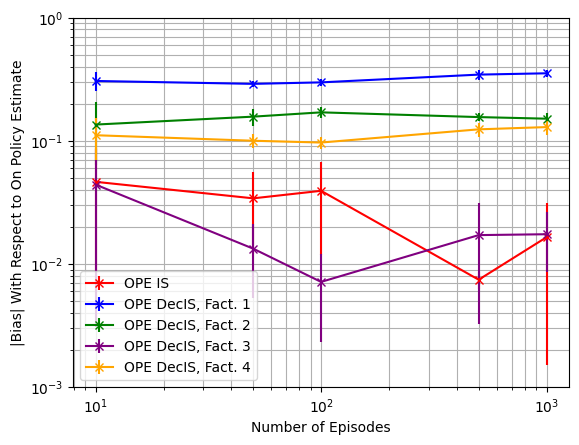

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.04638663 0.03406684 0.03921543 0.00744593 0.01647209]
OPE DecPDIS, Fact. 1-----[0.04095075 0.01771111 0.01195404 0.03470796 0.03637302]
OPE DecPDIS, Fact. 2-----[0.10521242 0.03479972 0.0161372  0.01912526 0.02048639]
OPE DecPDIS, Fact. 3-----[0.07307955 0.02840285 0.01695764 0.01899782 0.01781325]
OPE DecPDIS, Fact. 4-----[0.07006452 0.02715255 0.01373949 0.03262999 0.03249743]


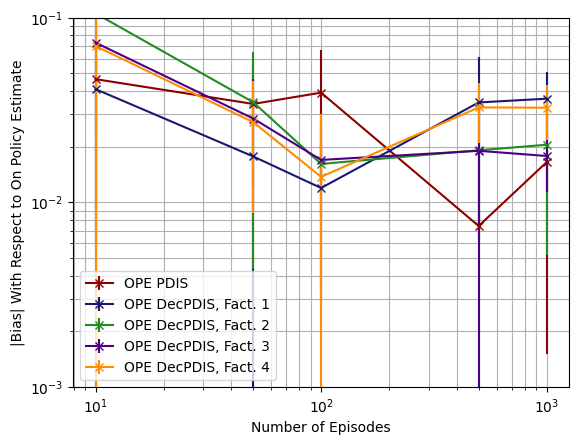

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**(-1), shorter_D, estimator='PDIS')

OPE PDWIS-----[0.84814446 0.8571561  0.86214236 0.86309884 0.86385479]
OPE DecPDWIS, Fact. 1-----[0.85675699 0.8652752  0.8702902  0.87113715 0.8721367 ]
OPE DecPDWIS, Fact. 2-----[0.8373509  0.84664761 0.85156348 0.85292519 0.8538229 ]
OPE DecPDWIS, Fact. 3-----[0.84919231 0.85812347 0.86298031 0.86364461 0.8647379 ]
OPE DecPDWIS, Fact. 4-----[0.84649889 0.85548993 0.86048377 0.86167065 0.86259315]


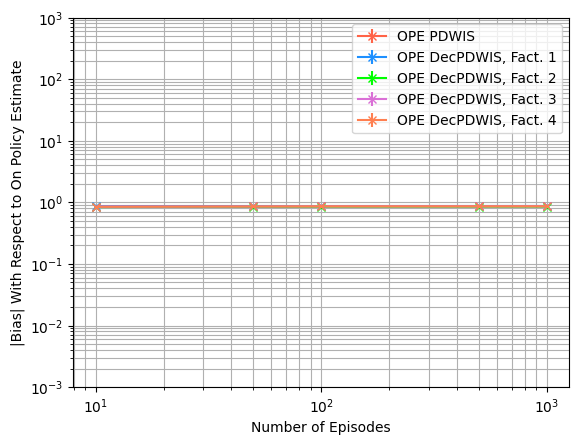

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[1.09340215e-02 2.10113384e-03 9.24675982e-04 1.97070920e-04
 8.26375711e-05]
OPE IS-----[0.34918104 0.05258771 0.03695503 0.00825766 0.01672038]
OPE DecIS, Fact. 1-----[0.17943093 0.03216666 0.01765497 0.02001097 0.02459343]
OPE DecIS, Fact. 2-----[0.13284496 0.01711842 0.00889091 0.00349996 0.00607079]
OPE DecIS, Fact. 3-----[0.11166198 0.01668004 0.00980268 0.00463768 0.00217048]
OPE DecIS, Fact. 4-----[0.08862624 0.01258299 0.00653994 0.00330391 0.00877847]


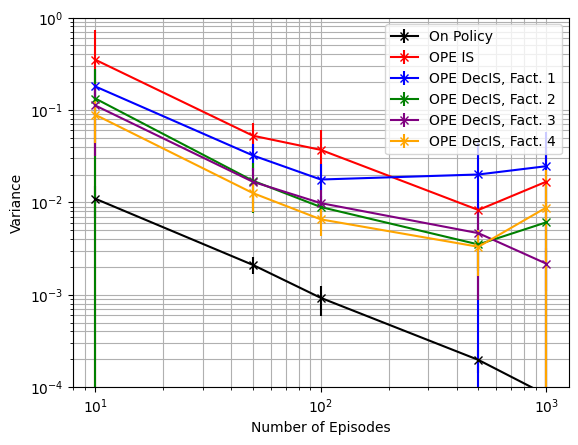

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

On Policy-----[1.09340215e-02 2.10113384e-03 9.24675982e-04 1.97070920e-04
 8.26375711e-05]
OPE PDIS-----[0.34918104 0.05258771 0.03695503 0.00825766 0.01672038]
OPE DecPDIS, Fact. 1-----[0.10211297 0.01994675 0.012023   0.01704182 0.01236295]
OPE DecPDIS, Fact. 2-----[0.50258164 0.02948993 0.01816972 0.00477653 0.00607022]
OPE DecPDIS, Fact. 3-----[0.2831832  0.03212401 0.02079819 0.01121164 0.00401333]
OPE DecPDIS, Fact. 4-----[0.22024464 0.01323911 0.0084211  0.00262206 0.00371329]


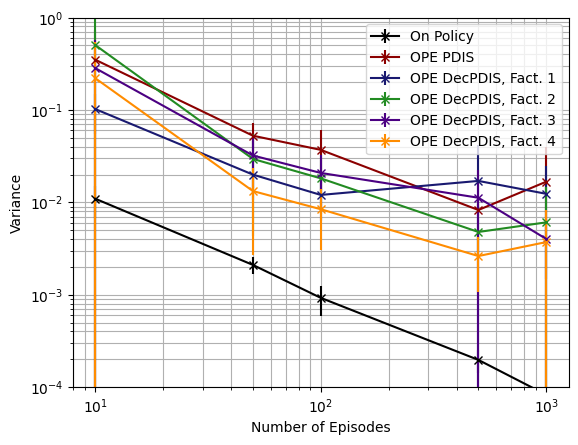

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

On Policy-----[1.09340215e-02 2.10113384e-03 9.24675982e-04 1.97070920e-04
 8.26375711e-05]
OPE PDWIS-----[7.83104758e-06 1.67272844e-05 1.07527252e-05 1.19468426e-05
 1.39933632e-05]
OPE DecPDWIS, Fact. 1-----[6.26453974e-06 4.70562739e-06 3.04094606e-06 3.78301580e-06
 4.62881785e-06]
OPE DecPDWIS, Fact. 2-----[9.81318963e-05 2.83883487e-05 2.05146699e-05 8.23304039e-06
 7.04857622e-06]
OPE DecPDWIS, Fact. 3-----[5.90629155e-05 2.06184494e-05 1.58936051e-05 8.83184916e-06
 3.13182230e-06]
OPE DecPDWIS, Fact. 4-----[4.45051591e-05 1.24887523e-05 1.01315546e-05 4.99905965e-06
 2.41271263e-06]


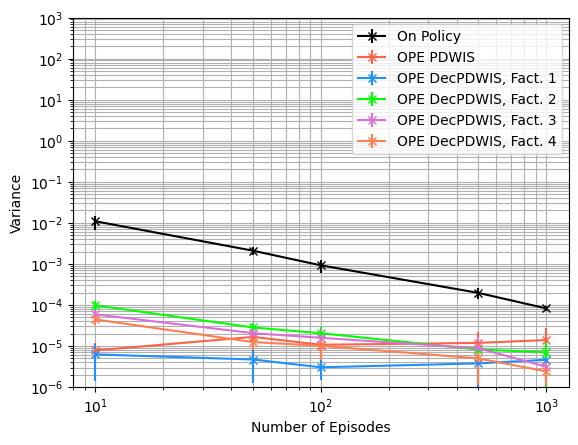

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[1.09340215e-02 2.10113384e-03 9.24675982e-04 1.97070920e-04
 8.26375711e-05]
OPE IS-----[0.35298573 0.05423532 0.0392456  0.00831448 0.01721582]
OPE DecIS, Fact. 1-----[0.2756135  0.11624392 0.10652698 0.13941782 0.14952761]
OPE DecIS, Fact. 2-----[0.15629538 0.04229906 0.03807101 0.02783201 0.02916896]
OPE DecIS, Fact. 3-----[0.11527699 0.01692061 0.00987715 0.00512443 0.00255122]
OPE DecIS, Fact. 4-----[0.10260358 0.02273247 0.01599318 0.0188523  0.02573789]


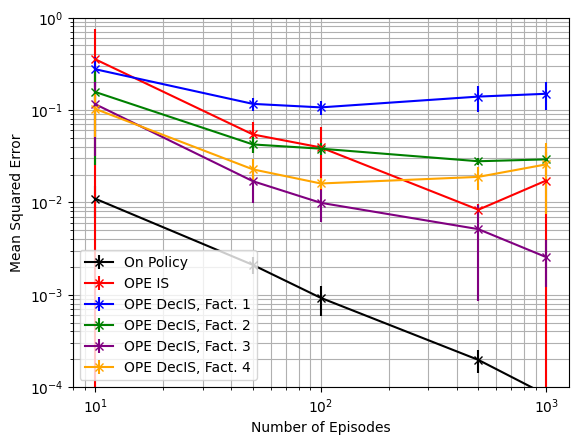

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

On Policy-----[1.09340215e-02 2.10113384e-03 9.24675982e-04 1.97070920e-04
 8.26375711e-05]
OPE PDIS-----[0.35298573 0.05423532 0.0392456  0.00831448 0.01721582]
OPE DecPDIS, Fact. 1-----[0.10409662 0.02055018 0.01224754 0.01896564 0.01389563]
OPE DecPDIS, Fact. 2-----[0.53213902 0.03162877 0.01859255 0.00530912 0.00672422]
OPE DecPDIS, Fact. 3-----[0.2925918  0.03326678 0.0211601  0.01189905 0.00437302]
OPE DecPDIS, Fact. 4-----[0.23206196 0.01431468 0.00887622 0.00382229 0.00488732]


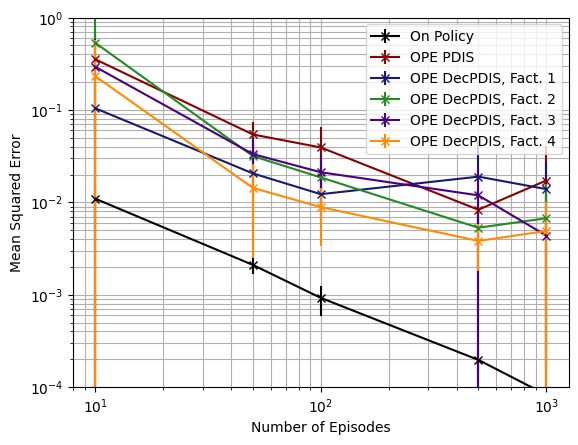

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

On Policy-----[1.09340215e-02 2.10113384e-03 9.24675982e-04 1.97070920e-04
 8.26375711e-05]
OPE PDWIS-----[0.72065847 0.73489339 0.74343515 0.74495916 0.74626193]
OPE DecPDWIS, Fact. 1-----[0.73536284 0.74887234 0.75754072 0.75889089 0.76062983]
OPE DecPDWIS, Fact. 2-----[0.70262422 0.7170244  0.72532146 0.72749863 0.72902383]
OPE DecPDWIS, Fact. 3-----[0.72249244 0.73656568 0.74488258 0.74589701 0.7477777 ]
OPE DecPDWIS, Fact. 4-----[0.71795868 0.73205626 0.74058275 0.7424895  0.74407258]


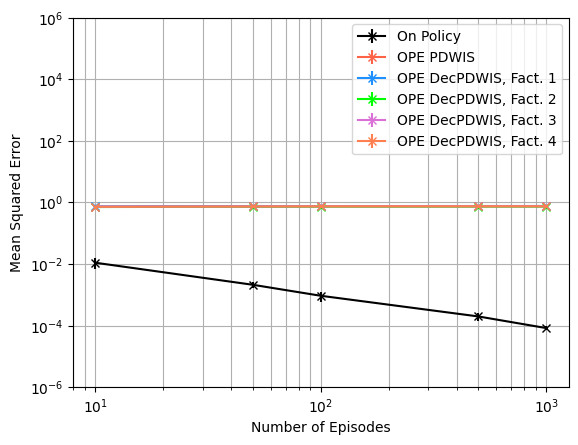

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[ 0.7393741   2.40817554  3.53896471 12.09006594 14.88799358]
OPE DecIS, Fact. 1-----[ 0.71643318  3.87592131  6.46297761 19.98432343 10.67052561]
OPE DecIS, Fact. 2-----[ 1.83629791  8.07516654 11.89373355 39.67646304 52.69339051]
OPE DecIS, Fact. 3-----[ 1.255164    7.47300493 10.34313165 50.63818393 50.43667634]
OPE DecIS, Fact. 4-----[ 1.44169115  9.58573176 15.5958864  51.11831249 42.88072065]


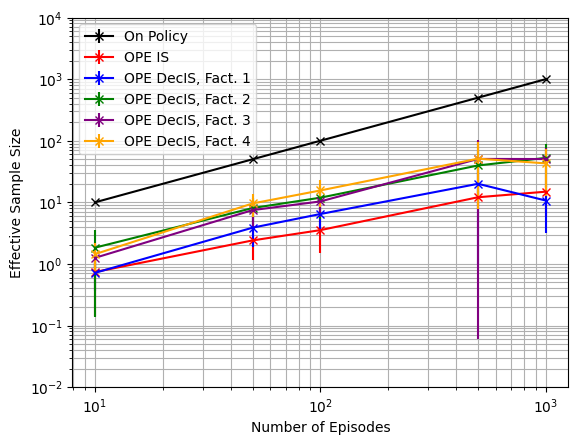

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-2), 10**4, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[ 0.7393741   2.40817554  3.53896471 12.09006594 14.88799358]
OPE DecPDIS, Fact. 1-----[ 1.17855754  7.14943629  9.43848749 34.32605513 15.86584997]
OPE DecPDIS, Fact. 2-----[ 0.77607498  5.56051142  6.21962206 29.23955927 50.99744047]
OPE DecPDIS, Fact. 3-----[ 0.84136612  4.01260315  5.46310167 22.74758069 28.95122715]
OPE DecPDIS, Fact. 4-----[ 1.40348156 12.65412752 15.77172154 71.62737924 57.65165086]


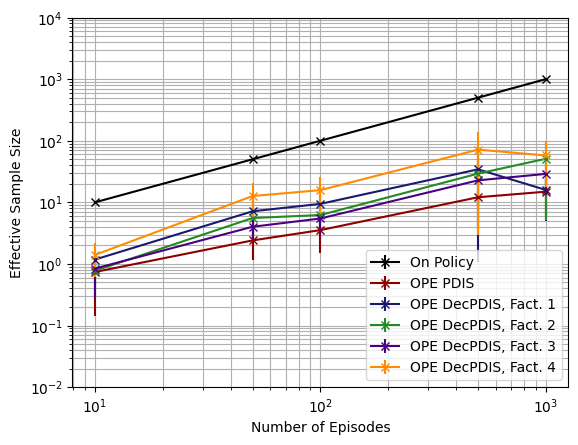

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-2), 10**4, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[25800.56156415 19023.07844935 13046.60175912 17988.75496979
 22937.73520084]
OPE DecPDWIS, Fact. 1-----[30281.22090796 35859.71571533 36326.2554469  76103.58439344
 31964.78070102]
OPE DecPDWIS, Fact. 2-----[ 1331.22508365  3889.26484098  4951.6037122  23561.79083699
 19207.61655505]
OPE DecPDWIS, Fact. 3-----[ 2128.08991653  5736.91581029  7169.53834821 20298.60335893
 40023.0004713 ]
OPE DecPDWIS, Fact. 4-----[ 2822.08117913  9354.15592795 10902.75045829 30934.12281283
 51106.98118603]


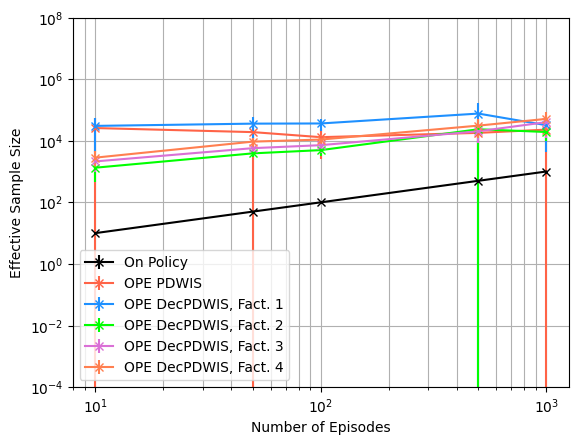

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{20}$)



Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc
gc.collect()
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.9364972046856523. Variance of on policy Q estimate: 0.005197178945264277
Mean OPE IS estimate: -0.9451580877164568. Bias1: 0.008660883030804253. Bias2: 0.008660883030804478. Variance: 0.0268967198980714. MSE: 0.026971730792944675
Mean OPE PDIS estimate: -0.9451580877164568. Bias1: 0.008660883030804253. Bias2: 0.008660883030804478. Variance: 0.0268967198980714. MSE: 0.026971730792944675
Mean OPE PDWIS estimate: -0.048074469198573014. Bias1: 0.8884227354870794. Bias2: 0.8884227354870793. Variance: 8.596598726292522e-06. MSE: 0.7893035535290713
Mean OPE DecIS: Fact. 1 estimate: -1.0651722569821913. Bias1: 0.12867505229653897. Bias2: 0.12867505229653897. Variance: 0.026049320365447787. MSE: 0.042606589448964824
Mean OPE DecPDIS: Fact. 1 estimate: -0.936813628439365. Bias1: 0.0003164237537177542. Bias2: 0.00031642375371265796. Variance: 0.020529429975566692. MSE: 0.02052953009955861
Mean OPE DecPDWIS: Fact. 1 

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.01379824 0.01345388 0.00804795 0.00177936 0.00140703]
OPE DecIS, Fact. 1-----[0.13624945 0.12989306 0.13041737 0.13542604 0.13487499]
OPE DecIS, Fact. 2-----[0.03468878 0.04568161 0.04560272 0.04261478 0.04301022]
OPE DecIS, Fact. 3-----[0.03787794 0.03060396 0.03071289 0.03474798 0.03477678]
OPE DecIS, Fact. 4-----[0.0619974  0.05629099 0.05599032 0.0609517  0.06064222]


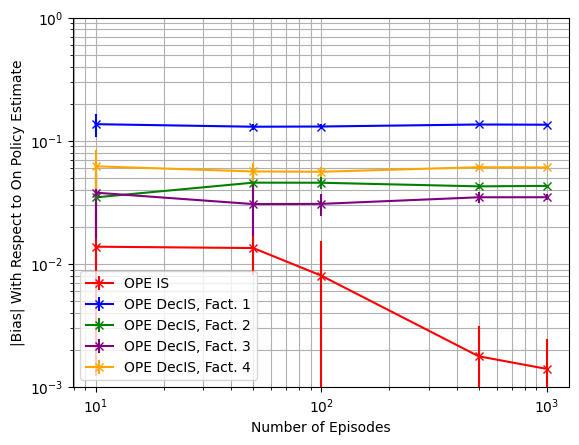

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.01379824 0.01345388 0.00804795 0.00177936 0.00140703]
OPE DecPDIS, Fact. 1-----[0.01842089 0.00739364 0.00522321 0.00391232 0.00274847]
OPE DecPDIS, Fact. 2-----[0.01512624 0.01425861 0.00440935 0.00219623 0.00074065]
OPE DecPDIS, Fact. 3-----[0.01498145 0.01169494 0.00856616 0.00293156 0.00186113]
OPE DecPDIS, Fact. 4-----[0.01447192 0.00974403 0.00422948 0.00337101 0.00139692]


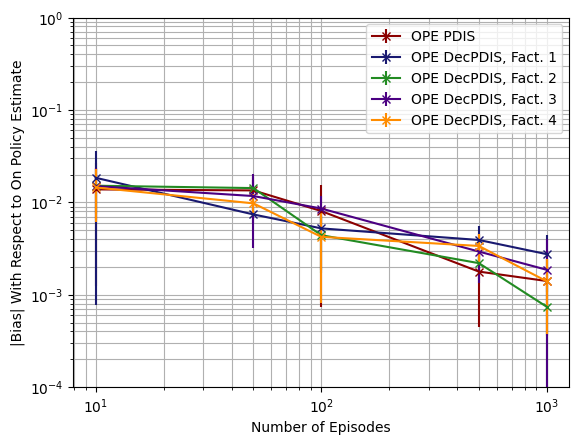

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.89700335 0.9060687  0.90706585 0.90785984 0.90693504]
OPE DecPDWIS, Fact. 1-----[0.9016588  0.91055894 0.91159107 0.91236854 0.91144288]
OPE DecPDWIS, Fact. 2-----[0.89522854 0.90430751 0.90528582 0.90608978 0.90522141]
OPE DecPDWIS, Fact. 3-----[0.8988668  0.90794932 0.90892092 0.90964556 0.90876773]
OPE DecPDWIS, Fact. 4-----[0.89894065 0.90794834 0.90893546 0.90969447 0.90880421]


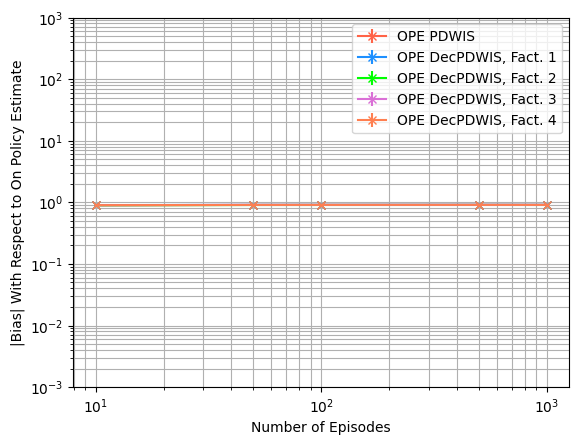

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[6.23091995e-03 7.47437030e-04 3.84833304e-04 7.75818178e-05
 3.61746004e-05]
OPE IS-----[0.01465746 0.00318756 0.00192168 0.00035912 0.00020448]
OPE DecIS, Fact. 1-----[0.01374561 0.00344823 0.00183361 0.00036222 0.00019908]
OPE DecIS, Fact. 2-----[0.01046749 0.00172591 0.00121083 0.00021156 0.00011664]
OPE DecIS, Fact. 3-----[0.01220976 0.0023522  0.00154483 0.00029293 0.00015329]
OPE DecIS, Fact. 4-----[0.00957223 0.00182957 0.00116359 0.00020863 0.00011665]


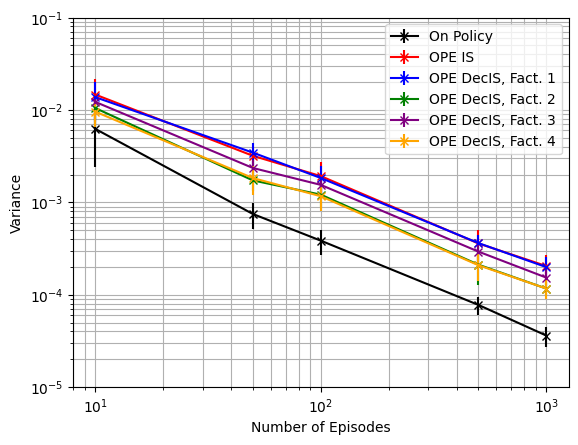

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-5), 10**(-1), shorter_D, estimator='IS')

On Policy-----[6.23091995e-03 7.47437030e-04 3.84833304e-04 7.75818178e-05
 3.61746004e-05]
OPE PDIS-----[0.01465746 0.00318756 0.00192168 0.00035912 0.00020448]
OPE DecPDIS, Fact. 1-----[0.010861   0.0027061  0.00147196 0.00028464 0.00015671]
OPE DecPDIS, Fact. 2-----[0.01240671 0.00198776 0.0015782  0.00026207 0.00014469]
OPE DecPDIS, Fact. 3-----[0.01183027 0.00254675 0.00174586 0.00031267 0.00017065]
OPE DecPDIS, Fact. 4-----[0.00894628 0.00160768 0.00119209 0.00019978 0.00011364]


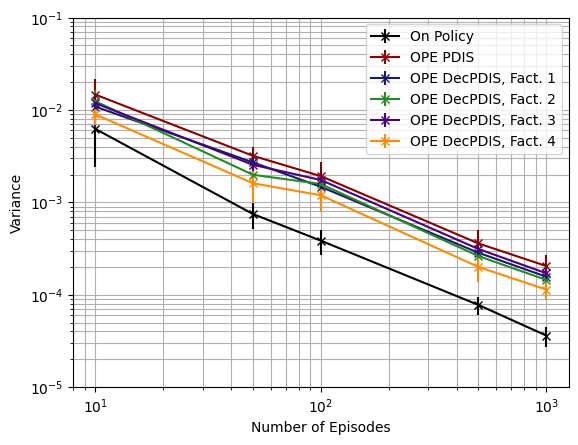

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-5), 10**(-1), shorter_D, estimator='PDIS')

On Policy-----[6.23091995e-03 7.47437030e-04 3.84833304e-04 7.75818178e-05
 3.61746004e-05]
OPE PDWIS-----[4.34905373e-06 2.58227615e-06 1.49255577e-06 4.00173322e-07
 2.03135318e-07]
OPE DecPDWIS, Fact. 1-----[4.00682166e-06 1.35398930e-06 8.33457628e-07 2.94695579e-07
 1.53360431e-07]
OPE DecPDWIS, Fact. 2-----[8.57209105e-06 2.44203709e-06 1.89701137e-06 4.73188002e-07
 2.26855246e-07]
OPE DecPDWIS, Fact. 3-----[7.48378170e-06 2.81167660e-06 1.84975518e-06 4.20726343e-07
 2.20033690e-07]
OPE DecPDWIS, Fact. 4-----[5.48805534e-06 1.73489530e-06 1.32020339e-06 3.38033775e-07
 1.65606956e-07]


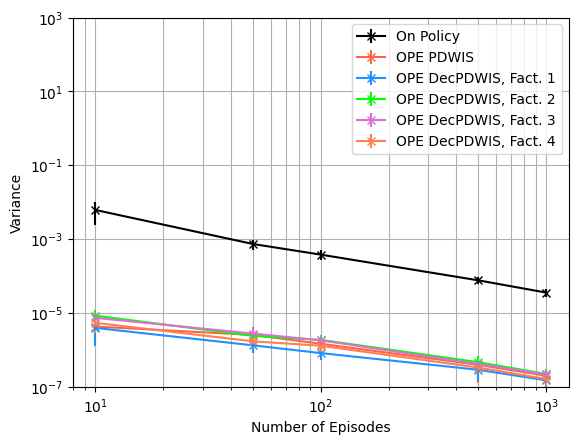

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[6.23091995e-03 7.47437030e-04 3.84833304e-04 7.75818178e-05
 3.61746004e-05]
OPE IS-----[0.01500574 0.00339655 0.00203999 0.00036406 0.00020756]
OPE DecIS, Fact. 1-----[0.03314805 0.02037691 0.01888924 0.01871025 0.01839474]
OPE DecIS, Fact. 2-----[0.01198381 0.00402555 0.00331915 0.00203232 0.00196759]
OPE DecIS, Fact. 3-----[0.01413157 0.00347494 0.00252587 0.00151144 0.00136646]
OPE DecIS, Fact. 4-----[0.01387136 0.00509365 0.00432229 0.00393217 0.00379607]


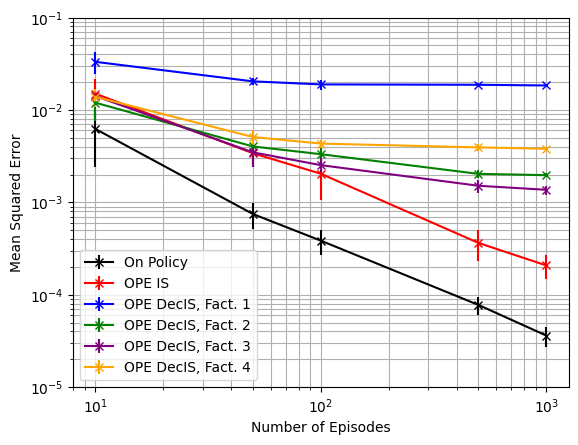

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-5), 10**(-1), shorter_D, estimator='IS')

On Policy-----[6.23091995e-03 7.47437030e-04 3.84833304e-04 7.75818178e-05
 3.61746004e-05]
OPE PDIS-----[0.01500574 0.00339655 0.00203999 0.00036406 0.00020756]
OPE DecPDIS, Fact. 1-----[0.01151165 0.00276264 0.00151048 0.00030251 0.00016708]
OPE DecPDIS, Fact. 2-----[0.01269377 0.00220089 0.00160478 0.00026743 0.00014584]
OPE DecPDIS, Fact. 3-----[0.01212786 0.00275601 0.00182895 0.00032375 0.00017864]
OPE DecPDIS, Fact. 4-----[0.00922608 0.00170931 0.00122158 0.00021249 0.00011664]


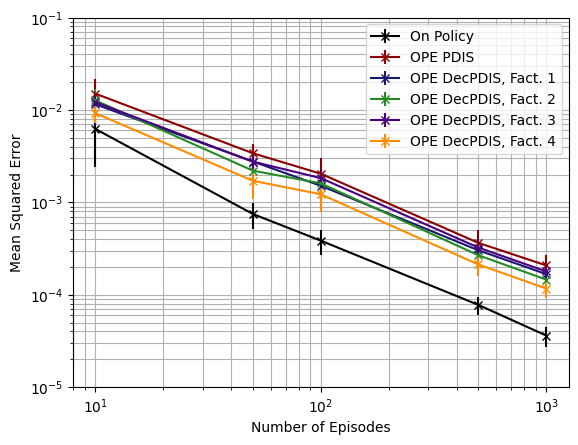

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-5), 10**(-1), shorter_D, estimator='PDIS')

On Policy-----[6.23091995e-03 7.47437030e-04 3.84833304e-04 7.75818178e-05
 3.61746004e-05]
OPE PDWIS-----[0.80483849 0.82101686 0.82278433 0.82421176 0.82253367]
OPE DecPDWIS, Fact. 1-----[0.81321399 0.82917188 0.8310135  0.83241845 0.83073061]
OPE DecPDWIS, Fact. 2-----[0.80166227 0.81782699 0.81955794 0.82100101 0.81942826]
OPE DecPDWIS, Fact. 3-----[0.80818721 0.82442615 0.82615212 0.82745727 0.82586128]
OPE DecPDWIS, Fact. 4-----[0.8083196  0.82442414 0.82617869 0.82754614 0.82592754]


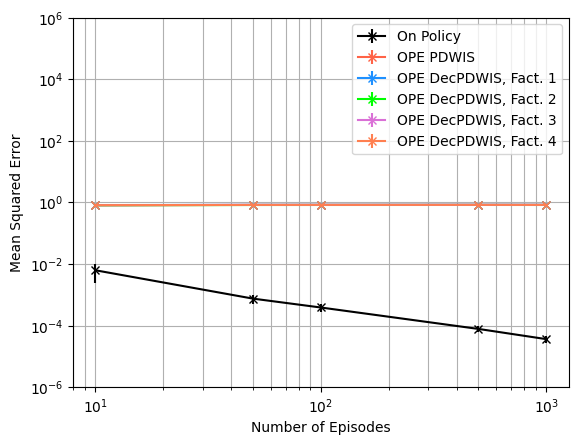

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[  5.79120128  11.93507969  24.71980372 130.77602917 208.8238072 ]
OPE DecIS, Fact. 1-----[  5.72888325  11.91808406  23.31527181 110.8164488  191.94729925]
OPE DecIS, Fact. 2-----[  7.46667726  23.33423383  34.34753778 246.43993747 333.38379483]
OPE DecIS, Fact. 3-----[  5.46726633  16.56107391  25.7536931  151.60721692 259.16777371]
OPE DecIS, Fact. 4-----[  7.21085174  23.91191094  36.9481306  225.06076722 338.17926159]


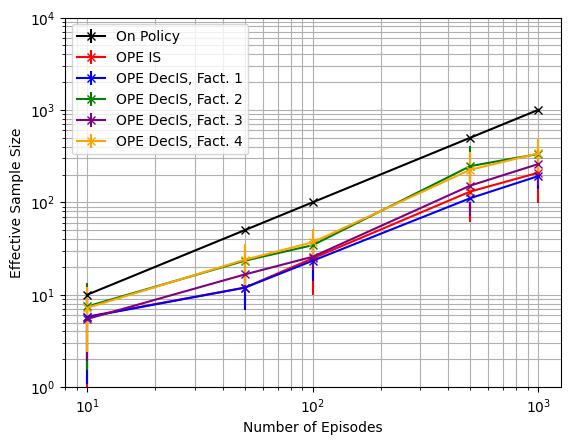

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**4, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[  5.79120128  11.93507969  24.71980372 130.77602917 208.8238072 ]
OPE DecPDIS, Fact. 1-----[  7.38743522  15.58409853  28.79120369 140.66446682 243.20175725]
OPE DecPDIS, Fact. 2-----[  5.93065795  21.45088905  28.04495513 174.94532131 282.32764735]
OPE DecPDIS, Fact. 3-----[  5.7110214   16.917372    23.22249941 136.31567152 232.4185044 ]
OPE DecPDIS, Fact. 4-----[  7.48192014  27.93073106  38.07348906 232.07265535 351.14182762]


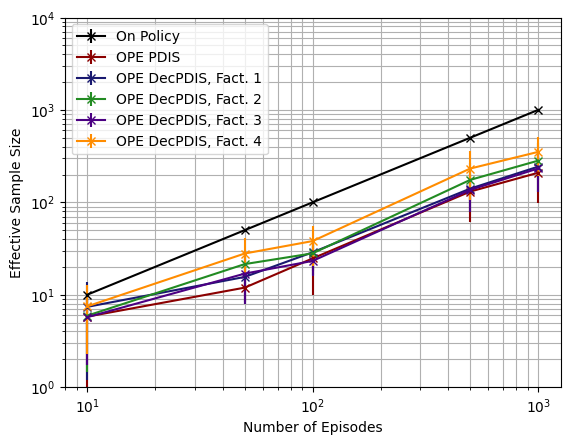

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**4, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[ 22559.08464231  23564.38928169  29024.71725718 135114.16151374
 228841.39309495]
OPE DecPDWIS, Fact. 1-----[ 28543.14866818  35999.63457417  51093.78849841 159011.36395294
 274862.56198533]
OPE DecPDWIS, Fact. 2-----[  9901.19539721  19193.50788588  23463.24747014  96993.66611359
 181288.8999789 ]
OPE DecPDWIS, Fact. 3-----[ 12150.66775576  16832.66053509  22523.49089827 103801.33743863
 183997.81436459]
OPE DecPDWIS, Fact. 4-----[ 15846.18065576  26001.91545448  33033.55809629 128136.50174279
 257012.10562234]


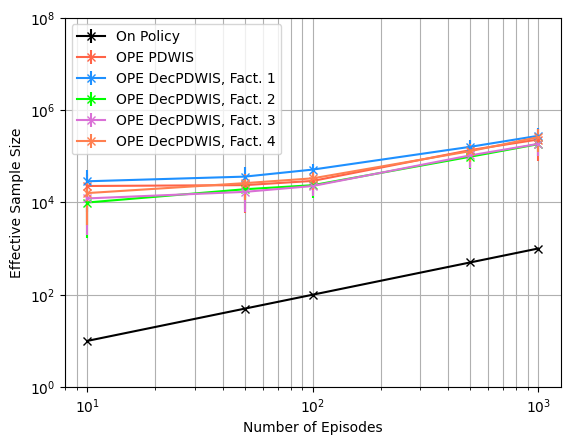

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**(8), shorter_D, estimator='PDWIS')

### Varying Episode Length $T$ With $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{T}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc

gc.collect()
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
LENGTHS = [1, 5, 10, 20]

bias_means = np.zeros((len(LENGTHS), 16))
bias_stds = np.zeros((len(LENGTHS), 16))
var_means = np.zeros((len(LENGTHS), 16))
var_stds = np.zeros((len(LENGTHS), 16))
MSE_means = np.zeros((len(LENGTHS), 16))
MSE_stds = np.zeros((len(LENGTHS), 16))
ESS_means = np.zeros((len(LENGTHS), 16))
ESS_stds = np.zeros((len(LENGTHS), 16))

RUNS = 20

for id in range(len(LENGTHS)):
  e = LENGTHS[id]
  print(f'{e} Steps, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

1 Steps, 20 ----------------------------------

Mean on policy Q estimate: -0.888614302495. Variance of on policy Q estimate: 0.08792955553196487
Mean OPE IS estimate: -1.0761653504149273. Bias1: 0.18755104791992736. Bias2: 0.18755104791992738. Variance: 0.10641218384146248. MSE: 0.14158757941732536
Mean OPE PDIS estimate: -1.0761653504149273. Bias1: 0.18755104791992736. Bias2: 0.18755104791992738. Variance: 0.10641218384146248. MSE: 0.14158757941732536
Mean OPE PDWIS estimate: -0.049992855362286835. Bias1: 0.838621447132713. Bias2: 0.8386214471327131. Variance: 5.178518466633564e-07. MSE: 0.7032864494428125
Mean OPE DecIS: Fact. 1 estimate: -1.1369085677382118. Bias1: 0.24829426524321208. Bias2: 0.24829426524321185. Variance: 0.08339786841133033. MSE: 0.14504791056399688
Mean OPE DecPDIS: Fact. 1 estimate: -1.0008868421183774. Bias1: 0.11227253962337745. Bias2: 0.11227253962337747. Variance: 0.06642363168024132. MSE: 0.07902875483372418
Mean OPE DecPDWIS: Fact. 1 estimate: -0.04490197

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.13345558 0.06147508 0.01471423 0.01283462]
OPE DecIS, Fact. 1-----[0.18498155 0.12720077 0.12391777 0.12625352]
OPE DecIS, Fact. 2-----[0.10666288 0.05486947 0.04702046 0.05331574]
OPE DecIS, Fact. 3-----[0.12515186 0.05638689 0.02692529 0.02102127]
OPE DecIS, Fact. 4-----[0.12190186 0.06306302 0.04966572 0.04970057]


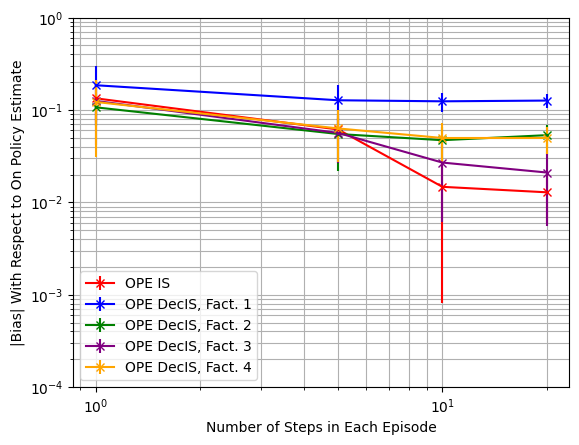

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.13345558 0.06147508 0.01471423 0.01283462]
OPE DecPDIS, Fact. 1-----[0.11241033 0.04696361 0.02074931 0.01694859]
OPE DecPDIS, Fact. 2-----[0.11382198 0.05105739 0.01449608 0.01474653]
OPE DecPDIS, Fact. 3-----[0.10716942 0.05769034 0.01892843 0.01571719]
OPE DecPDIS, Fact. 4-----[0.10247106 0.04479675 0.01692223 0.01380154]


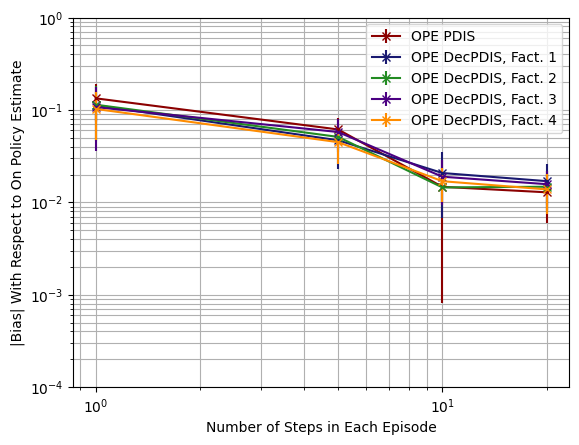

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.88565333 0.89695673 0.90933503 0.90936708]
OPE DecPDWIS, Fact. 1-----[0.89069188 0.90157721 0.91399047 0.91384847]
OPE DecPDWIS, Fact. 2-----[0.88399424 0.89522554 0.90756021 0.90735278]
OPE DecPDWIS, Fact. 3-----[0.88720986 0.89879753 0.91119848 0.91106451]
OPE DecPDWIS, Fact. 4-----[0.88797098 0.8989131  0.91127233 0.91104842]


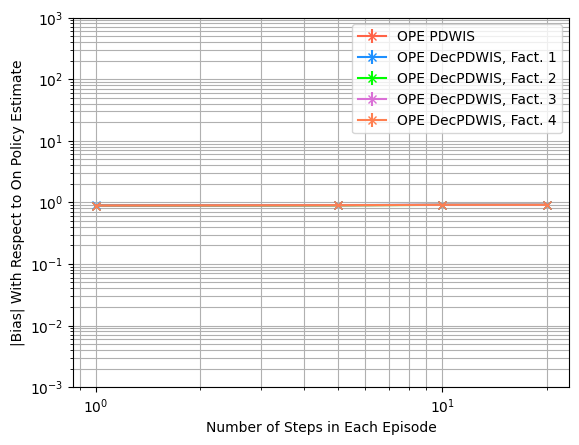

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.05999575 0.00897557 0.00362281 0.00162509]
OPE IS-----[0.26079773 0.03154334 0.01465746 0.00723471]
OPE DecIS, Fact. 1-----[0.19366011 0.03321692 0.01374561 0.00730769]
OPE DecIS, Fact. 2-----[0.12076005 0.02454554 0.01046749 0.00501448]
OPE DecIS, Fact. 3-----[0.09267548 0.02178282 0.01220976 0.00649916]
OPE DecIS, Fact. 4-----[0.09342718 0.02037148 0.00957223 0.0050768 ]


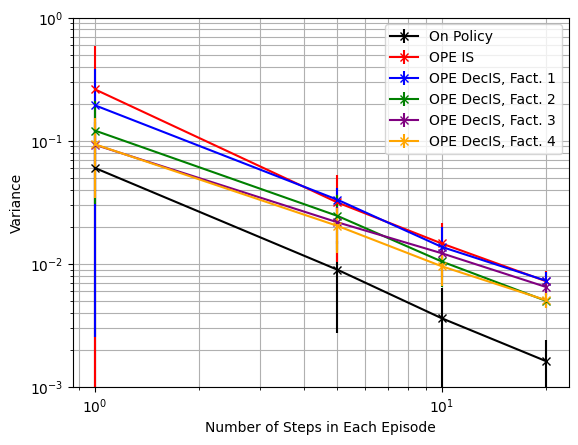

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

On Policy-----[0.05999575 0.00897557 0.00362281 0.00162509]
OPE PDIS-----[0.26079773 0.03154334 0.01465746 0.00723471]
OPE DecPDIS, Fact. 1-----[0.15020228 0.02531499 0.010861   0.00582208]
OPE DecPDIS, Fact. 2-----[0.14236707 0.03147256 0.01240671 0.00609095]
OPE DecPDIS, Fact. 3-----[0.09943914 0.02187287 0.01183027 0.00679742]
OPE DecPDIS, Fact. 4-----[0.08544172 0.02016836 0.00894628 0.00480799]


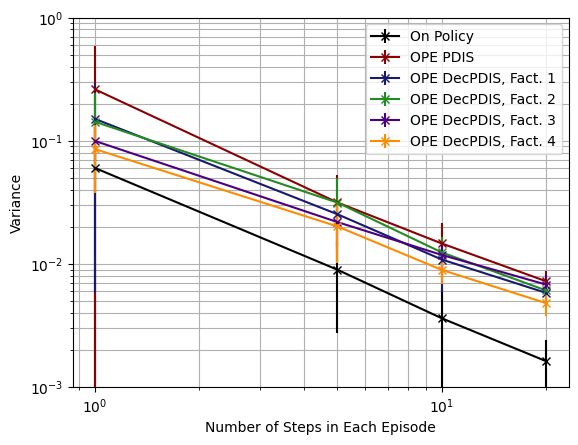

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.05999575 0.00897557 0.00362281 0.00162509]
OPE PDWIS-----[2.52227433e-05 9.85276527e-06 4.34905373e-06 5.38545071e-06]
OPE DecPDWIS, Fact. 1-----[2.06676914e-05 9.49463795e-06 4.00682166e-06 3.44558254e-06]
OPE DecPDWIS, Fact. 2-----[5.93462893e-05 1.68870438e-05 8.57209105e-06 6.26785889e-06]
OPE DecPDWIS, Fact. 3-----[5.02438611e-05 1.47592747e-05 7.48378170e-06 6.42240200e-06]
OPE DecPDWIS, Fact. 4-----[3.77448852e-05 1.21052411e-05 5.48805534e-06 4.20677785e-06]


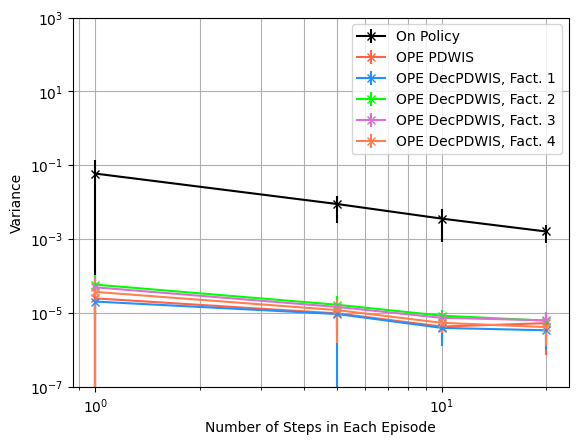

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.05999575 0.00897557 0.00362281 0.00162509]
OPE IS-----[0.28213    0.03573991 0.01506709 0.00744707]
OPE DecIS, Fact. 1-----[0.24124886 0.05273079 0.02996573 0.02368695]
OPE DecIS, Fact. 2-----[0.13375457 0.02865611 0.01303085 0.0080783 ]
OPE DecIS, Fact. 3-----[0.11524453 0.02586645 0.01336942 0.00717937]
OPE DecIS, Fact. 4-----[0.11660161 0.02564442 0.01255691 0.00780451]


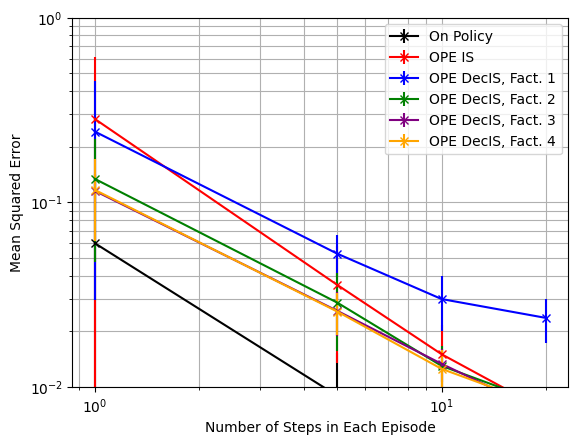

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-2), 10**0, shorter_D, estimator='IS')

On Policy-----[0.05999575 0.00897557 0.00362281 0.00162509]
OPE PDIS-----[0.28213    0.03573991 0.01506709 0.00744707]
OPE DecPDIS, Fact. 1-----[0.16416867 0.0281013  0.01148909 0.00618574]
OPE DecPDIS, Fact. 2-----[0.15994576 0.03428401 0.0126316  0.00635599]
OPE DecPDIS, Fact. 3-----[0.1159415  0.0257201  0.01228117 0.00708446]
OPE DecPDIS, Fact. 4-----[0.09898842 0.02252806 0.00927867 0.00503748]


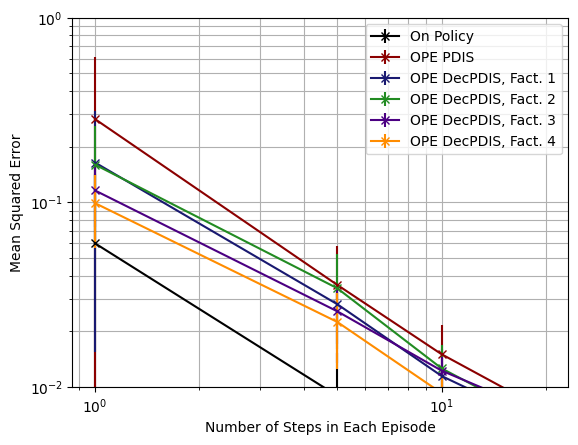

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-2), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.05999575 0.00897557 0.00362281 0.00162509]
OPE PDWIS-----[0.78837343 0.80506815 0.8271555  0.82706104]
OPE DecPDWIS, Fact. 1-----[0.79731592 0.81337248 0.83564342 0.83522849]
OPE DecPDWIS, Fact. 2-----[0.78554169 0.80197806 0.82393425 0.82340133]
OPE DecPDWIS, Fact. 3-----[0.79121335 0.80838319 0.83055178 0.8301514 ]
OPE DecPDWIS, Fact. 4-----[0.79254391 0.80858429 0.83068427 0.83011958]


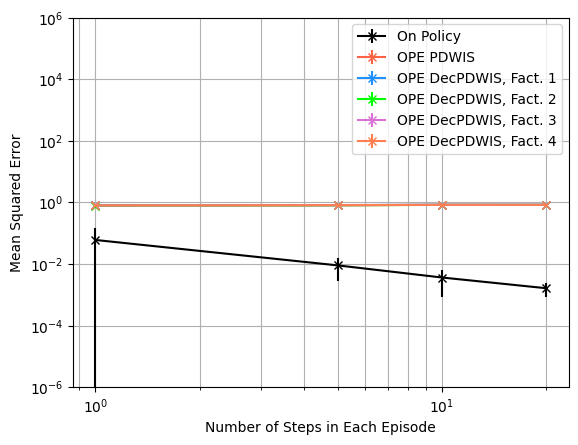

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[ 1.  5. 10. 20.]
OPE IS-----[0.4730867  1.42630849 2.14373347 4.2669606 ]
OPE DecIS, Fact. 1-----[0.72807724 1.54202018 2.44038775 4.2730332 ]
OPE DecIS, Fact. 2-----[0.72469351 2.13964237 3.38160595 6.41140719]
OPE DecIS, Fact. 3-----[0.96235428 2.15246015 3.08137147 5.18806758]
OPE DecIS, Fact. 4-----[1.17709272 2.59277921 4.06561724 6.57910211]


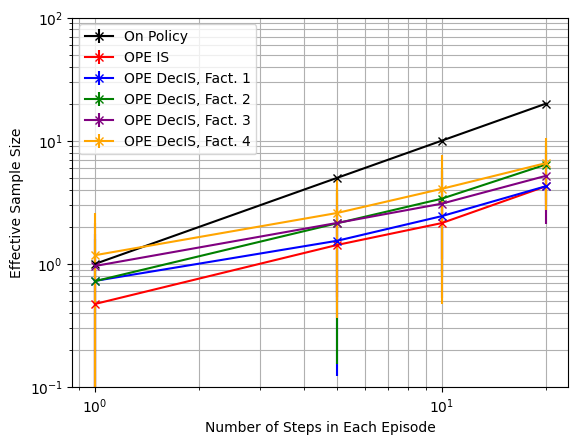

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-1), 10**2, shorter_D, estimator='IS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDIS-----[0.4730867  1.42630849 2.14373347 4.2669606 ]
OPE DecPDIS, Fact. 1-----[0.92722774 2.01703118 3.08283851 5.33315303]
OPE DecPDIS, Fact. 2-----[0.53304593 1.59909954 2.55746765 5.04692702]
OPE DecPDIS, Fact. 3-----[0.94115158 1.91012128 2.78814686 4.79580314]
OPE DecPDIS, Fact. 4-----[1.04157594 2.50466536 3.76349404 6.73547853]


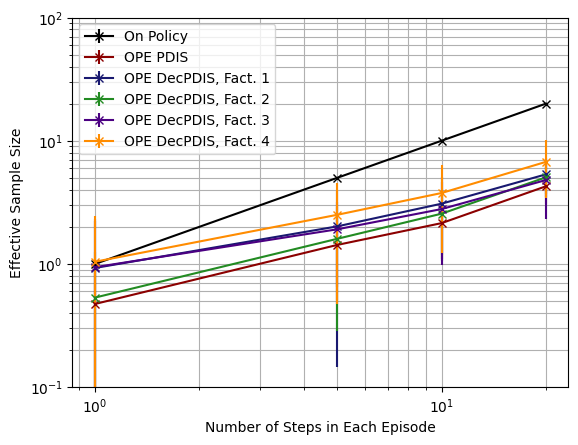

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-1), 10**2, shorter_D, estimator='PDIS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDWIS-----[46792.13725992 10349.40500264  8915.29180416  8953.59717469]
OPE DecPDWIS, Fact. 1-----[100887.15305107  12961.11024748  18681.55286805  11671.92847353]
OPE DecPDWIS, Fact. 2-----[1581.77312251 4366.91936686 4019.71975479 6303.26568882]
OPE DecPDWIS, Fact. 3-----[1851.70997091 4081.86825634 4798.77810587 6487.26111806]
OPE DecPDWIS, Fact. 4-----[ 3237.38287357  6595.69313198  6991.89900012 10101.44976872]


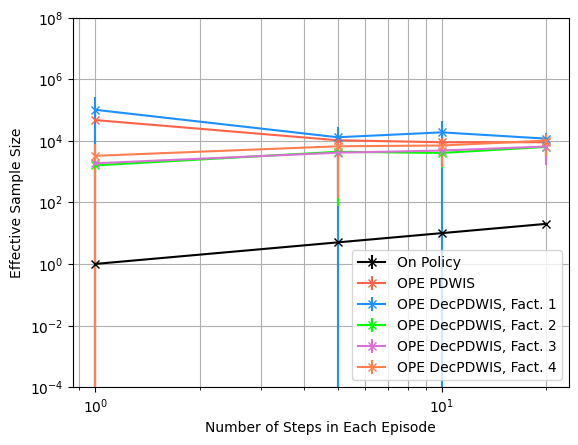

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

## From Patient State 377, Without Diabetes

In [ ]:
#The patient has no diabetes
PROB_DIAB = 0.0

### State Analysis

In [ ]:
#Instantiate a state based on the idx and get the state vector
testState = State(state_idx = 377, diabetic_idx=0)
vec = testState.get_state_vector()

print(vec)
print(f'Num abnormals: {testState.get_num_abnormal()}\n')

print(f'Heart Rate: {hr_state_mapping[vec[0]]}')
print(f'Systolic Blood Pressure: {sbp_state_mapping[vec[1]]}')
print(f'Percent Oxygen: {o2_state_mapping[vec[2]]}')
print(f'Glucose Level: {glu_state_mapping[vec[3]]}')
print(f'Antibiotics: {abx_state_mapping[vec[4]]}')
print(f'Vasopressors: {vaso_state_mapping[vec[5]]}')
print(f'Ventilator: {vent_state_mapping[vec[6]]}')
print(f'Diabetes: {testState.diabetic_idx}')

[1 1 1 2 0 0 1]
Num abnormals: 0

Heart Rate: Normal
Systolic Blood Pressure: Normal
Percent Oxygen: Normal
Glucose Level: Normal
Antibiotics: Off
Vasopressors: Off
Ventilator: On
Diabetes: 0


### Generate Data From Behaviour Policy

Run the data generator

In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=randPol, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

Convert data into array format

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_b = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_b.shape

(100000, 20, 5)

In [ ]:
f_tr_b1, f_tr_b2, f_tr_b3, f_tr_b4 = factorise_dataset(nf_tr_b)

In [ ]:
print(nf_tr_b)

[[[  0. 377.   0.  -1. 528.]
  [  1. 528.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 377.   3.   0. 459.]
  [  1. 459.   5.   0. 462.]
  [  2. 462.   5.   0. 462.]
  ...
  [ 17. 373.   7.   0. 455.]
  [ 18. 455.   6.   0. 453.]
  [ 19. 453.   6.   0. 373.]]

 [[  0. 377.   3.   0. 379.]
  [  1. 379.   4.   0. 380.]
  [  2. 380.   4.   0. 380.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 ...

 [[  0. 377.   6.   0. 381.]
  [  1. 381.   5.   0. 462.]
  [  2. 462.   7.   0. 463.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 377.   2.   0. 369.]
  [  1. 369.   4.   0. 372.]
  [  2. 372.   5.   0. 374.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 377.   6.   0. 381.]
  [  1. 381.   6.   0. 381.]
  [  2. 381.   0.   0. 616

In [ ]:
print(f_tr_b1)

[[[[ 0.00e+00  3.77e+02  0.00e+00 -5.00e-01  5.28e+02]
   [ 0.00e+00  3.77e+02  0.00e+00 -5.00e-01  5.28e+02]]

  [[ 1.00e+00  5.28e+02  1.00e+00  0.00e+00 -1.00e+00]
   [ 1.00e+00  5.28e+02 -1.00e+00  0.00e+00 -1.00e+00]]

  [[ 2.00e+00 -1.00e+00  1.00e+00  0.00e+00 -1.00e+00]
   [ 2.00e+00 -1.00e+00 -1.00e+00  0.00e+00 -1.00e+00]]

  ...

  [[ 1.70e+01 -1.00e+00  1.00e+00  0.00e+00 -1.00e+00]
   [ 1.70e+01 -1.00e+00 -1.00e+00  0.00e+00 -1.00e+00]]

  [[ 1.80e+01 -1.00e+00  1.00e+00  0.00e+00 -1.00e+00]
   [ 1.80e+01 -1.00e+00 -1.00e+00  0.00e+00 -1.00e+00]]

  [[ 1.90e+01 -1.00e+00  1.00e+00  0.00e+00 -1.00e+00]
   [ 1.90e+01 -1.00e+00 -1.00e+00  0.00e+00 -1.00e+00]]]


 [[[ 0.00e+00  3.77e+02  1.00e+00  0.00e+00  4.59e+02]
   [ 0.00e+00  3.77e+02  1.00e+00  0.00e+00  4.59e+02]]

  [[ 1.00e+00  4.59e+02  0.00e+00  0.00e+00  4.62e+02]
   [ 1.00e+00  4.59e+02  3.00e+00  0.00e+00  4.62e+02]]

  [[ 2.00e+00  4.62e+02  0.00e+00  0.00e+00  4.62e+02]
   [ 2.00e+00  4.62e+02  3.00e+00  0.00e

In [ ]:
factored_randPol1 = factor_policy_1(randPol)
factored_randPol2 = factor_policy_2(randPol)
factored_randPol3 = factor_policy_3(randPol)
factored_randPol4 = factor_policy_4(randPol)

In [ ]:
randPol = pad_policy(randPol)

factored_randPol1[0] = pad_policy(factored_randPol1[0])
factored_randPol1[1] = pad_policy(factored_randPol1[1])

factored_randPol2[0] = pad_policy(factored_randPol2[0])
factored_randPol2[1] = pad_policy(factored_randPol2[1])

factored_randPol3[0] = pad_policy(factored_randPol3[0])
factored_randPol3[1] = pad_policy(factored_randPol3[1])

factored_randPol4[0] = pad_policy(factored_randPol4[0])
factored_randPol4[1] = pad_policy(factored_randPol4[1])
factored_randPol4[2] = pad_policy(factored_randPol4[2])

### Varying Episodes $\epsilon_{e} = 0.4$ (Policy Divergence $4.8^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
EVAL_EPSILON = 0.4

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

4.8


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: 0.16887846044715432. Variance of on policy Q estimate: 0.05747970657915413
Mean OPE IS estimate: 0.21247077839833092. Bias1: 0.043592317951176913. Bias2: 0.0435923179511766. Variance: 0.1890738420184091. MSE: 0.1909741322027656
Mean OPE PDIS estimate: 0.21247077839833092. Bias1: 0.043592317951176913. Bias2: 0.0435923179511766. Variance: 0.1890738420184091. MSE: 0.1909741322027656
Mean OPE PDWIS estimate: 0.008410412939985117. Bias1: 0.1604680475071692. Bias2: 0.1604680475071692. Variance: 0.0007665571066829714. MSE: 0.026516551377446084
Mean OPE DecIS: Fact. 1 estimate: -0.18133575818861386. Bias1: 0.3502142186357682. Bias2: 0.3502142186357682. Variance: 0.20907486587696203. MSE: 0.33172486481162367
Mean OPE DecPDIS: Fact. 1 estimate: -0.008086132847780056. Bias1: 0.17696459329493444. Bias2: 0.17696459329493439. Variance: 0.13668875078379716. MSE: 0.16800521806383872
Mean OPE DecPDWIS: Fact. 1 estimate: 0.00

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.15785626 0.05091064 0.07287914 0.06208971 0.02332867]
OPE DecIS, Fact. 1-----[0.50717644 0.53181074 0.53749394 0.54753145 0.57440505]
OPE DecIS, Fact. 2-----[0.47603535 0.30561816 0.319813   0.31966374 0.33596143]
OPE DecIS, Fact. 3-----[0.33068827 0.28238648 0.28652299 0.31809663 0.3386816 ]
OPE DecIS, Fact. 4-----[0.52138247 0.56400291 0.56015034 0.58454181 0.60668315]


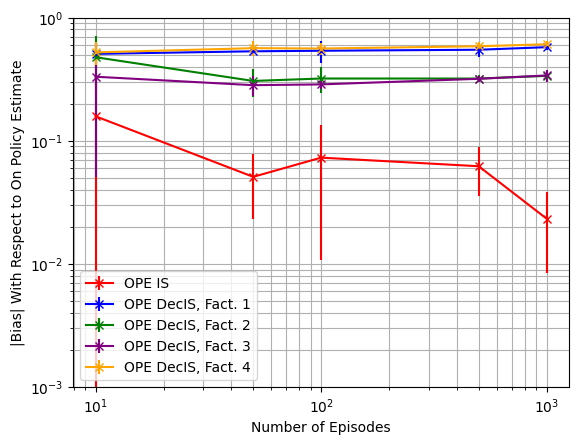

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**-3, 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.15785626 0.05091064 0.07287914 0.06208971 0.02332867]
OPE DecPDIS, Fact. 1-----[0.24016031 0.25554847 0.28268605 0.28242882 0.28793498]
OPE DecPDIS, Fact. 2-----[0.43514825 0.26225913 0.25672615 0.24992339 0.26987195]
OPE DecPDIS, Fact. 3-----[0.19164585 0.16643606 0.15707309 0.18729588 0.21211824]
OPE DecPDIS, Fact. 4-----[0.28156822 0.35092204 0.34822052 0.36131315 0.37164344]


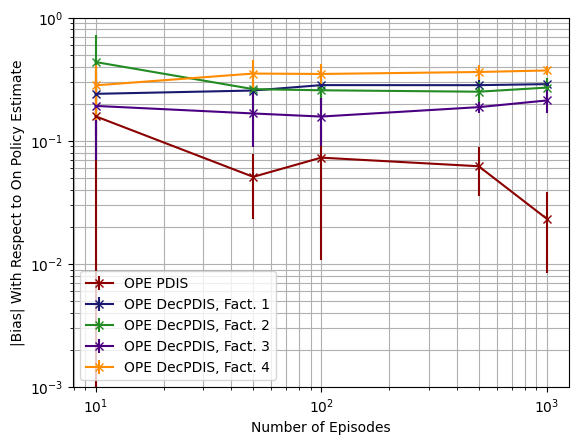

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.23789719 0.24476256 0.25348509 0.25416143 0.25647207]
OPE DecPDWIS, Fact. 1-----[0.24004581 0.25705495 0.26632825 0.26934345 0.27182965]
OPE DecPDWIS, Fact. 2-----[0.23782093 0.25610657 0.2658489  0.26862837 0.27111887]
OPE DecPDWIS, Fact. 3-----[0.23391465 0.24973302 0.26080504 0.26245915 0.26464299]
OPE DecPDWIS, Fact. 4-----[0.24047893 0.26214128 0.27183817 0.2751487  0.27724565]


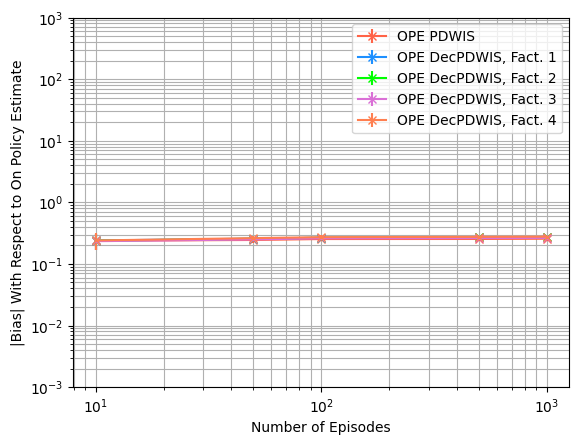

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.05446718 0.01582572 0.00522591 0.00113231 0.00057471]
OPE IS-----[0.23350288 0.52431692 1.37290787 0.0942269  0.1100252 ]
OPE DecIS, Fact. 1-----[0.74483921 0.37842711 0.24110426 0.10209425 0.1448499 ]
OPE DecIS, Fact. 2-----[2.95603834 0.24138245 0.1814327  0.03831159 0.03416239]
OPE DecIS, Fact. 3-----[1.13111741 0.17634775 0.06100263 0.02127624 0.0810147 ]
OPE DecIS, Fact. 4-----[0.36901589 0.23692938 0.13232862 0.05179052 0.05717094]


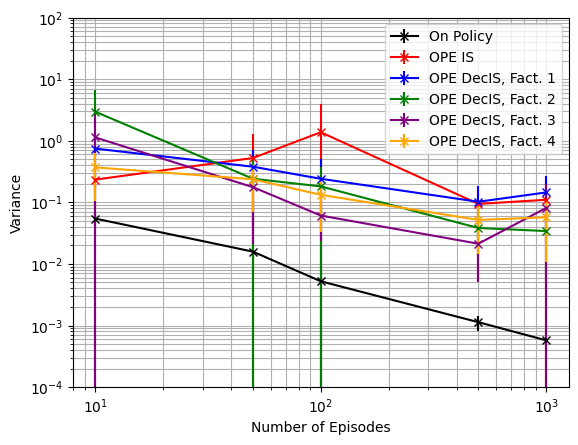

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**2, shorter_D, estimator='IS')

On Policy-----[0.05446718 0.01582572 0.00522591 0.00113231 0.00057471]
OPE PDIS-----[0.23350288 0.52431692 1.37290787 0.0942269  0.1100252 ]
OPE DecPDIS, Fact. 1-----[0.31358534 0.14443876 0.16523385 0.04457079 0.05855889]
OPE DecPDIS, Fact. 2-----[2.9518155  0.31758847 0.13699681 0.04565674 0.04509295]
OPE DecPDIS, Fact. 3-----[0.40886147 0.2537349  0.16379729 0.02081948 0.07656303]
OPE DecPDIS, Fact. 4-----[0.18682935 0.14344818 0.06795145 0.03002869 0.03158389]


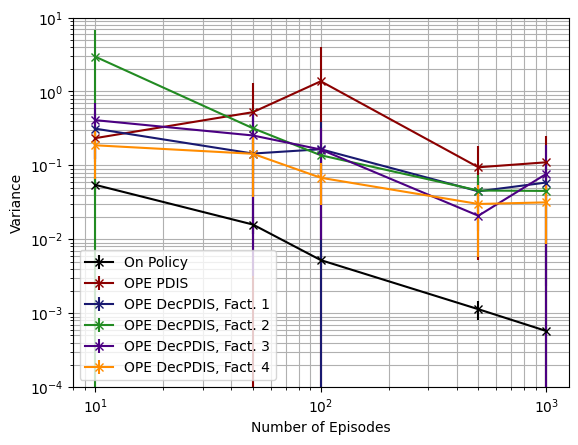

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**1, shorter_D, estimator='PDIS')

On Policy-----[0.05446718 0.01582572 0.00522591 0.00113231 0.00057471]
OPE PDWIS-----[0.00056897 0.00025722 0.00022552 0.00011819 0.00014595]
OPE DecPDWIS, Fact. 1-----[8.79063144e-04 1.78848510e-04 1.18121473e-04 6.43137313e-05
 5.41308556e-05]
OPE DecPDWIS, Fact. 2-----[1.12758162e-03 2.96990348e-04 1.64541209e-04 1.28753378e-04
 9.83804181e-05]
OPE DecPDWIS, Fact. 3-----[8.31483628e-04 5.10757001e-04 3.00128658e-04 9.44414805e-05
 7.78005664e-05]
OPE DecPDWIS, Fact. 4-----[9.86559295e-04 2.08763011e-04 9.29926557e-05 7.28687599e-05
 5.30727792e-05]


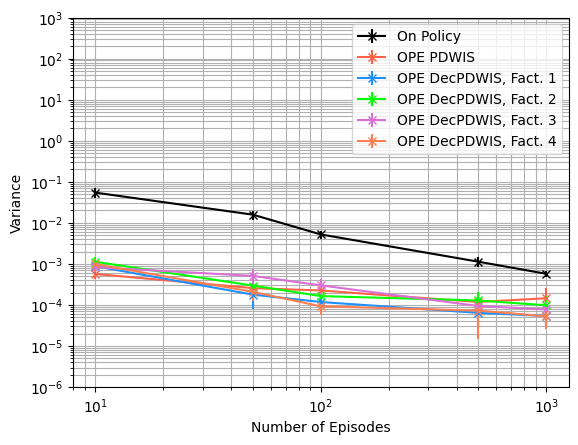

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.05446718 0.01582572 0.00522591 0.00113231 0.00057471]
OPE IS-----[0.28304677 0.52768218 1.38206769 0.09880032 0.11079294]
OPE DecIS, Fact. 1-----[1.02155641 0.66238529 0.54208751 0.40640584 0.47587519]
OPE DecIS, Fact. 2-----[3.23883502 0.34102707 0.28927893 0.1408899  0.14818503]
OPE DecIS, Fact. 3-----[1.31893527 0.25890173 0.14375281 0.12277785 0.19709144]
OPE DecIS, Fact. 4-----[0.65273978 0.56089577 0.45056378 0.39528303 0.42662999]


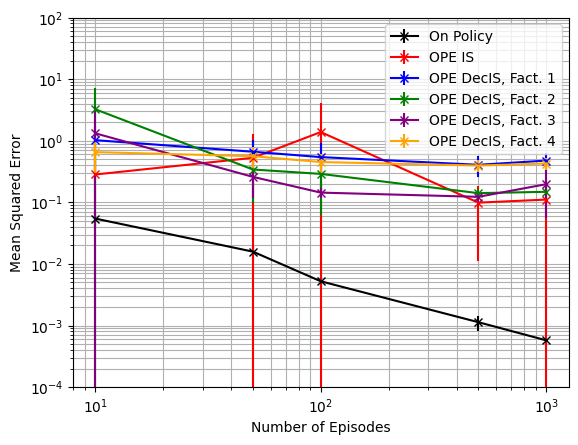

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**2, shorter_D, estimator='IS')

On Policy-----[0.05446718 0.01582572 0.00522591 0.00113231 0.00057471]
OPE PDIS-----[0.28304677 0.52768218 1.38206769 0.09880032 0.11079294]
OPE DecPDIS, Fact. 1-----[0.38842799 0.21068801 0.25073116 0.12618759 0.1416656 ]
OPE DecPDIS, Fact. 2-----[3.22653573 0.40147553 0.21081524 0.11077724 0.12053049]
OPE DecPDIS, Fact. 3-----[0.46042497 0.28755057 0.19285323 0.05631897 0.12357165]
OPE DecPDIS, Fact. 4-----[0.2839883  0.27674962 0.19440706 0.1630221  0.17062595]


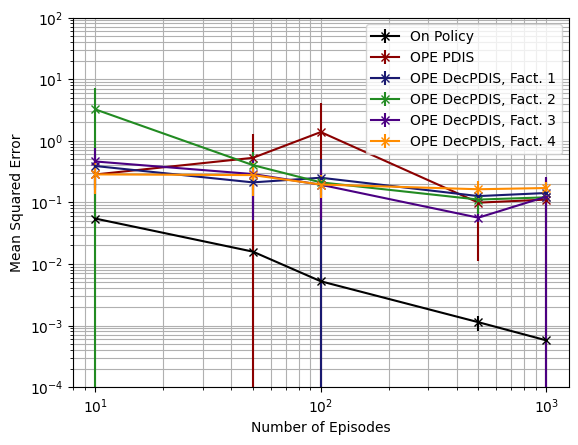

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**2, shorter_D, estimator='PDIS')

On Policy-----[0.05446718 0.01582572 0.00522591 0.00113231 0.00057471]
OPE PDWIS-----[0.06193495 0.06079791 0.06485039 0.06481921 0.06594265]
OPE DecPDWIS, Fact. 1-----[0.06350797 0.06679994 0.07134238 0.07273563 0.07396886]
OPE DecPDWIS, Fact. 2-----[0.06289072 0.06652394 0.07124097 0.07244422 0.07364288]
OPE DecPDWIS, Fact. 3-----[0.06025539 0.06348288 0.06865067 0.06907703 0.0701383 ]
OPE DecPDWIS, Fact. 4-----[0.06401371 0.06950089 0.07434942 0.0759263  0.07695472]


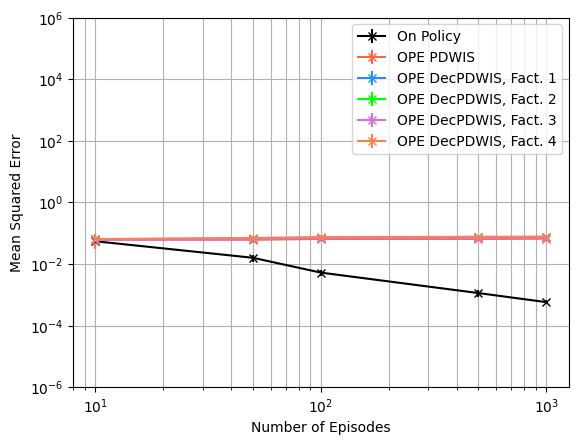

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[ 2.8351645  11.39097488  9.9849319  18.99404945 19.87672053]
OPE DecIS, Fact. 1-----[2.43519634 3.76826758 5.06583947 8.51620256 9.95815882]
OPE DecIS, Fact. 2-----[ 8.9351194  14.41196023 10.25286779 22.62458599 29.06679259]
OPE DecIS, Fact. 3-----[ 3.71086773 12.76657654 12.92992682 39.69539994 65.64528413]
OPE DecIS, Fact. 4-----[ 5.77202451  5.88043808 11.84598272 17.85980384 29.53180898]


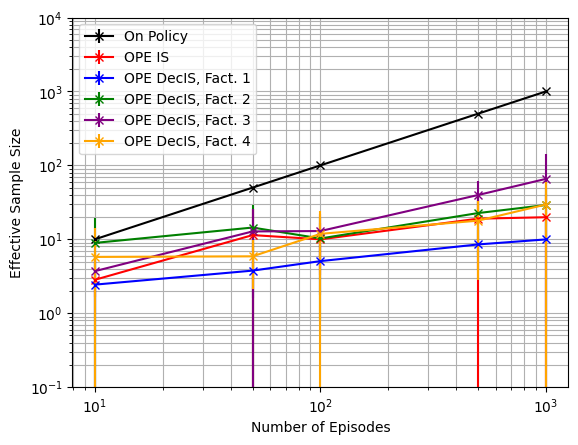

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-1), 10**4, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[ 2.8351645  11.39097488  9.9849319  18.99404945 19.87672053]
OPE DecPDIS, Fact. 1-----[ 3.31494667 10.29160934  8.74906433 13.45853915 19.31375565]
OPE DecPDIS, Fact. 2-----[ 4.90526231  8.15699801  5.80310211 18.65404032 30.43144541]
OPE DecPDIS, Fact. 3-----[ 2.67627006 12.9294817   7.32055618 35.94059586 39.90879173]
OPE DecPDIS, Fact. 4-----[ 5.50061416 10.00911327 13.55176849 26.94368666 43.89093823]


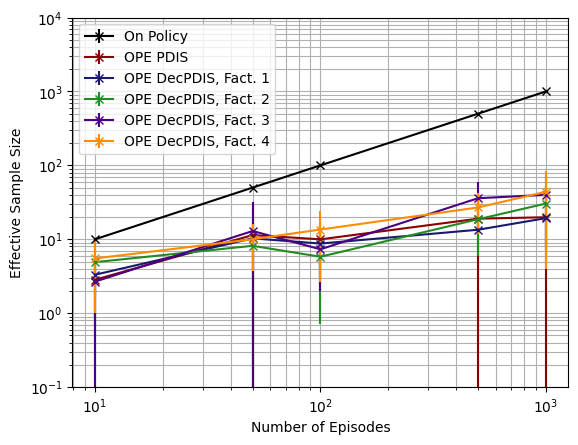

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-1), 10**4, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[1001.48404301 3650.64772273 3394.89008346 6876.33059917 8740.37044805]
OPE DecPDWIS, Fact. 1-----[  716.54414507  7450.95035912  4993.79210282  8915.3655098
 12696.94170612]
OPE DecPDWIS, Fact. 2-----[ 567.24121238 3098.53619484 3285.67906807 5376.7620387  8734.78736289]
OPE DecPDWIS, Fact. 3-----[ 728.06020011 2511.4450074  2127.10635264 7095.46019614 9068.4558648 ]
OPE DecPDWIS, Fact. 4-----[  694.35020702  5035.11285826  6390.80509825 10771.59262139
 16364.87871012]


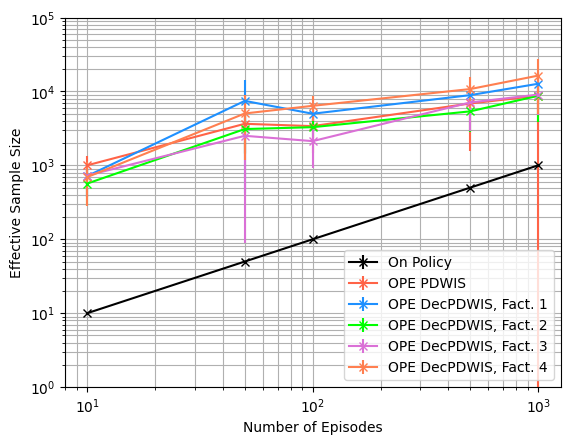

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**(5), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.6$ (Policy Divergence $3.2^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc

gc.collect()
EVAL_EPSILON = 0.6

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

3.2


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: 0.04654850559301435. Variance of on policy Q estimate: 0.05484261999519198
Mean OPE IS estimate: 0.04087743104279805. Bias1: 0.005671074550225117. Bias2: 0.005671074550216301. Variance: 0.22907506030133679. MSE: 0.229107221387891
Mean OPE PDIS estimate: 0.04087743104279805. Bias1: 0.005671074550225117. Bias2: 0.005671074550216301. Variance: 0.22907506030133679. MSE: 0.229107221387891
Mean OPE PDWIS estimate: -0.0015452404532857104. Bias1: 0.048093746046300054. Bias2: 0.04809374604630006. Variance: 0.0006328081478244737. MSE: 0.002945816556590476
Mean OPE DecIS: Fact. 1 estimate: -0.2904591478120184. Bias1: 0.33700765340503275. Bias2: 0.3370076534050328. Variance: 0.21743801802887988. MSE: 0.3310121764824466
Mean OPE DecPDIS: Fact. 1 estimate: -0.1087622326393052. Bias1: 0.1553107382323197. Bias2: 0.15531073823231956. Variance: 0.15929072482777978. MSE: 0.1834121502380479
Mean OPE DecPDWIS: Fact. 1 estimate: 

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.11239808 0.0520173  0.04239354 0.04129752 0.02851909]
OPE DecIS, Fact. 1-----[0.37654965 0.36914877 0.38514475 0.40293198 0.40923051]
OPE DecIS, Fact. 2-----[0.26120845 0.19332153 0.19168196 0.18193444 0.19026517]
OPE DecIS, Fact. 3-----[0.20324747 0.18161653 0.16018607 0.1802313  0.19939548]
OPE DecIS, Fact. 4-----[0.37258081 0.38640381 0.3736382  0.40249441 0.40322378]


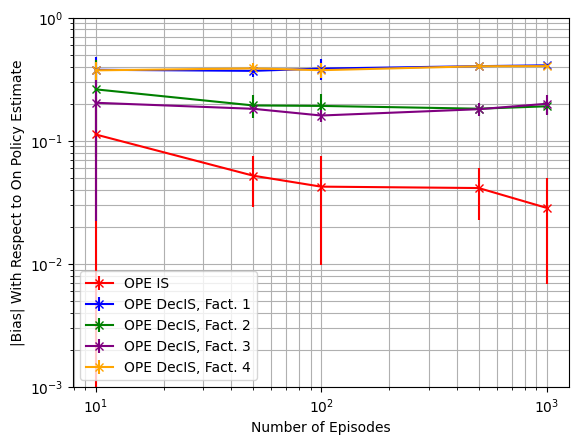

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.11239808 0.0520173  0.04239354 0.04129752 0.02851909]
OPE DecPDIS, Fact. 1-----[0.15089341 0.14572846 0.16684619 0.17774156 0.17709137]
OPE DecPDIS, Fact. 2-----[0.2408591  0.17291316 0.16685382 0.15368754 0.16359173]
OPE DecPDIS, Fact. 3-----[0.12509823 0.12586704 0.09984227 0.11906388 0.14015763]
OPE DecPDIS, Fact. 4-----[0.18983475 0.22385136 0.21155373 0.23353619 0.23068207]


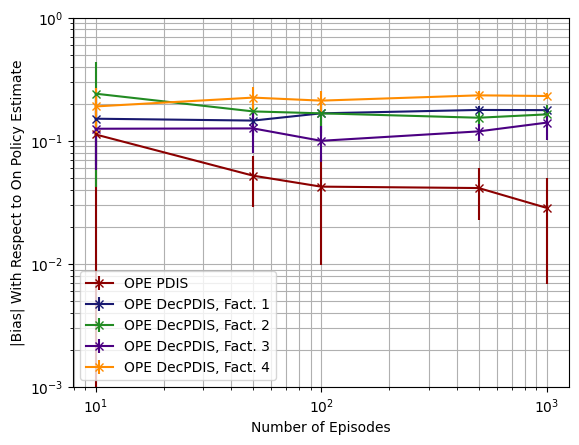

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.06333388 0.04562369 0.03845724 0.04917911 0.04571464]
OPE DecPDWIS, Fact. 1-----[0.06597844 0.05176857 0.04464281 0.05765251 0.05382765]
OPE DecPDWIS, Fact. 2-----[0.06642357 0.05345259 0.04634572 0.05786602 0.05424769]
OPE DecPDWIS, Fact. 3-----[0.0638764  0.05089913 0.0439254  0.05535475 0.05157211]
OPE DecPDWIS, Fact. 4-----[0.06836173 0.05619346 0.04872399 0.06149182 0.0574332 ]


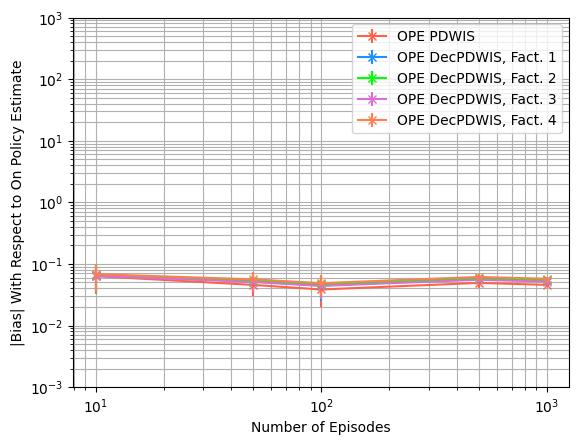

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.05934215 0.00935719 0.00689734 0.00113753 0.00070014]
OPE IS-----[0.23215546 0.19152215 0.48814572 0.03967639 0.04158998]
OPE DecIS, Fact. 1-----[0.3756382  0.11667174 0.11683392 0.02784412 0.0206703 ]
OPE DecIS, Fact. 2-----[0.83226941 0.09782846 0.06688961 0.02044911 0.01778978]
OPE DecIS, Fact. 3-----[0.6924482  0.11326056 0.04960717 0.01119973 0.05211272]
OPE DecIS, Fact. 4-----[0.20054103 0.08114909 0.05223698 0.0158409  0.00891773]


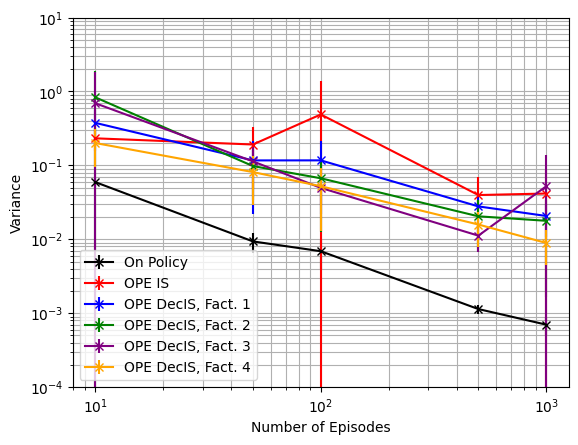

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**1, shorter_D, estimator='IS')

On Policy-----[0.05934215 0.00935719 0.00689734 0.00113753 0.00070014]
OPE PDIS-----[0.23215546 0.19152215 0.48814572 0.03967639 0.04158998]
OPE DecPDIS, Fact. 1-----[0.21420677 0.06425908 0.08838046 0.01726198 0.01158831]
OPE DecPDIS, Fact. 2-----[0.85167516 0.1275813  0.06680238 0.02288011 0.01949201]
OPE DecPDIS, Fact. 3-----[0.25189942 0.14915006 0.08480143 0.01209483 0.05138   ]
OPE DecPDIS, Fact. 4-----[0.13250294 0.06798374 0.03591762 0.01272701 0.0071077 ]


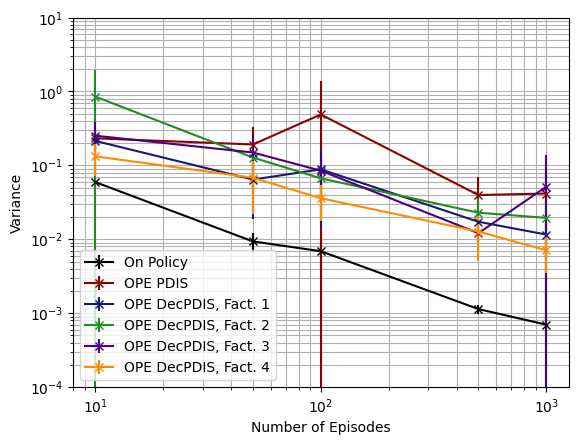

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**1, shorter_D, estimator='PDIS')

On Policy-----[0.05934215 0.00935719 0.00689734 0.00113753 0.00070014]
OPE PDWIS-----[4.90786545e-04 1.96804653e-04 1.71841582e-04 6.47418803e-05
 6.93617337e-05]
OPE DecPDWIS, Fact. 1-----[4.62713687e-04 9.97643309e-05 7.25355444e-05 3.25370360e-05
 2.13700836e-05]
OPE DecPDWIS, Fact. 2-----[5.60869687e-04 1.63180738e-04 9.55510636e-05 5.20513716e-05
 3.51035288e-05]
OPE DecPDWIS, Fact. 3-----[4.67121406e-04 2.11421242e-04 1.25615952e-04 3.67988352e-05
 2.17712692e-05]
OPE DecPDWIS, Fact. 4-----[4.53226509e-04 1.06893427e-04 5.08445255e-05 2.96343008e-05
 1.69353275e-05]


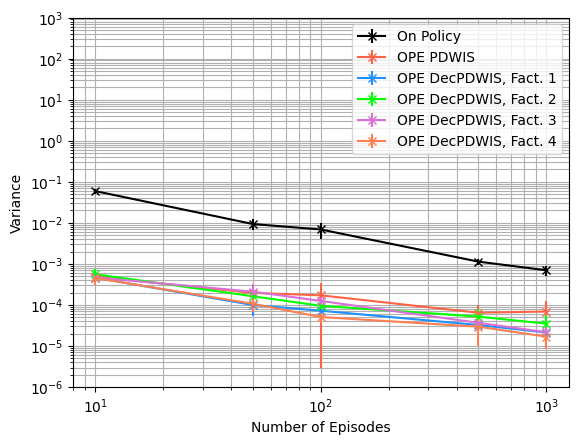

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.05934215 0.00935719 0.00689734 0.00113753 0.00070014]
OPE IS-----[0.25733063 0.19477048 0.49100097 0.04173155 0.04287068]
OPE DecIS, Fact. 1-----[0.52692211 0.25466935 0.27108779 0.19055749 0.1881539 ]
OPE DecIS, Fact. 2-----[0.93548381 0.13686819 0.10607667 0.05385083 0.05464007]
OPE DecIS, Fact. 3-----[0.76647275 0.14634728 0.07561293 0.04413512 0.09326636]
OPE DecIS, Fact. 4-----[0.34329563 0.23201564 0.19438715 0.17820542 0.17166494]


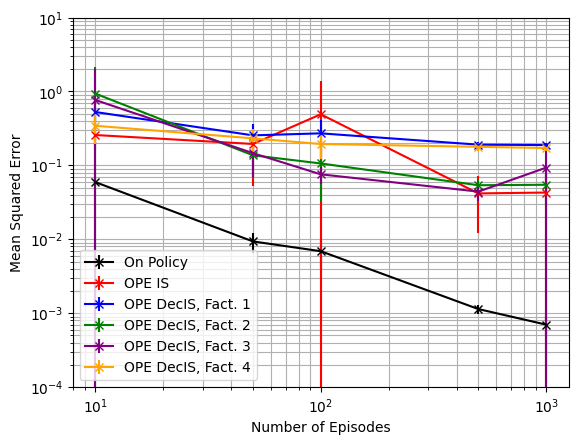

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**1, shorter_D, estimator='IS')

On Policy-----[0.05934215 0.00935719 0.00689734 0.00113753 0.00070014]
OPE PDIS-----[0.25733063 0.19477048 0.49100097 0.04173155 0.04287068]
OPE DecPDIS, Fact. 1-----[0.24463324 0.08682645 0.11944641 0.04906239 0.04297246]
OPE DecPDIS, Fact. 2-----[0.94907593 0.16092707 0.09724524 0.04709016 0.04717955]
OPE DecPDIS, Fact. 3-----[0.27212876 0.16710066 0.09579553 0.02662103 0.07251068]
OPE DecPDIS, Fact. 4-----[0.17502967 0.12058875 0.08255389 0.06767933 0.06047773]


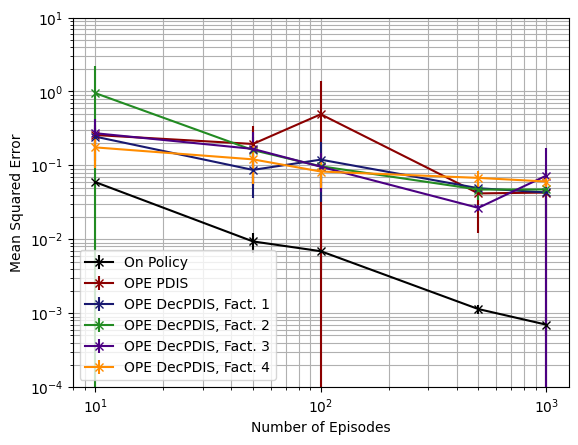

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**1, shorter_D, estimator='PDIS')

On Policy-----[0.05934215 0.00935719 0.00689734 0.00113753 0.00070014]
OPE PDWIS-----[0.00548956 0.00253169 0.0019794  0.00255551 0.00217587]
OPE DecPDWIS, Fact. 1-----[0.00581365 0.00307582 0.00245437 0.00341976 0.00293326]
OPE DecPDWIS, Fact. 2-----[0.00600689 0.00327734 0.00256964 0.00345435 0.00299161]
OPE DecPDWIS, Fact. 3-----[0.00538641 0.00305575 0.00235734 0.00317205 0.00269285]
OPE DecPDWIS, Fact. 4-----[0.0061228  0.00353358 0.00276227 0.00386963 0.00332868]


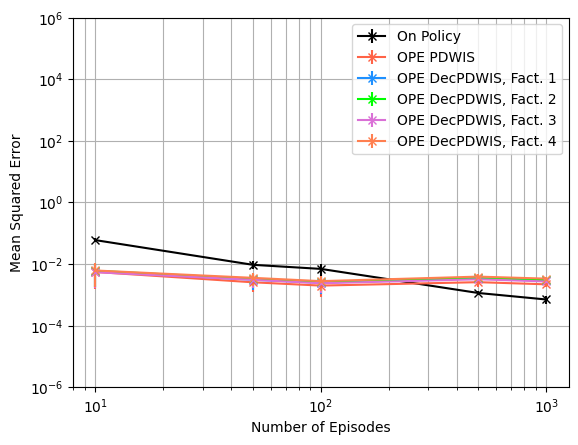

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[ 2.74706999  4.39168491 15.24542863 30.67644514 33.79918413]
OPE DecIS, Fact. 1-----[ 1.83923349  6.18101759  8.33125018 23.14681216 38.46647215]
OPE DecIS, Fact. 2-----[ 6.34703662  7.32002058 22.66601255 38.66789857 77.98140064]
OPE DecIS, Fact. 3-----[  3.83452441   8.02193613  19.07568286  58.84879664 113.19273922]
OPE DecIS, Fact. 4-----[  4.61487346   8.22708178  32.432587    45.98706119 110.24867339]


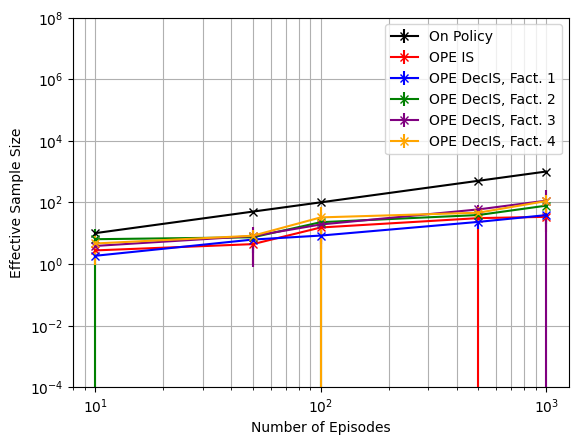

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[ 2.74706999  4.39168491 15.24542863 30.67644514 33.79918413]
OPE DecPDIS, Fact. 1-----[ 2.8784096  12.47560447 12.07574198 36.31227578 66.71450258]
OPE DecPDIS, Fact. 2-----[ 4.24507504  5.31808533 16.2111983  36.38904071 72.21120992]
OPE DecPDIS, Fact. 3-----[ 3.00103889  8.44134817 11.77449845 48.69079549 88.19810587]
OPE DecPDIS, Fact. 4-----[  5.56879684  10.14274384  28.12324934  61.64397134 139.34316718]


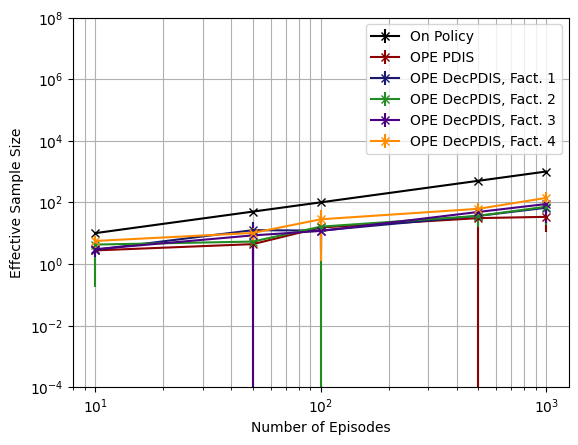

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[ 1257.67789967  2812.50798231  6857.8889553  13467.87157236
 15193.9805217 ]
OPE DecPDWIS, Fact. 1-----[ 1296.03098932  6862.03797513 10614.86373927 19126.39525879
 34343.0332679 ]
OPE DecPDWIS, Fact. 2-----[ 1162.09444392  3300.10338895  7527.11937339 14443.95134328
 27306.04687321]
OPE DecPDWIS, Fact. 3-----[ 1369.05119031  3513.2512048   6242.49049037 16515.99499806
 36003.43202388]
OPE DecPDWIS, Fact. 4-----[ 1414.26740616  5250.3067024  15469.50121173 28332.95238461
 55688.56282799]


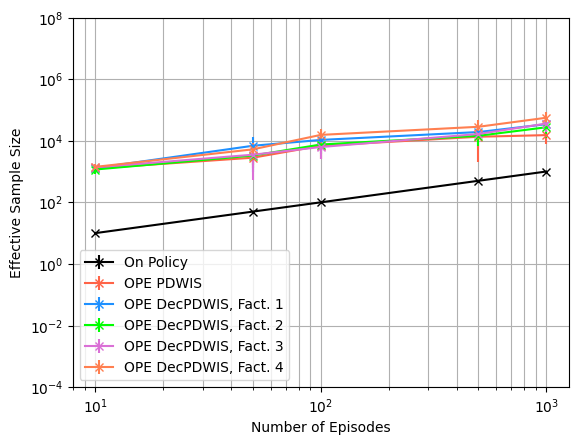

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{20}$)



Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc
gc.collect()
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.24026960621545695. Variance of on policy Q estimate: 0.07032231015732751
Mean OPE IS estimate: -0.28591754550905646. Bias1: 0.04564793929359936. Bias2: 0.045647939293599504. Variance: 0.07834536163652314. MSE: 0.08042909599827527
Mean OPE PDIS estimate: -0.28591754550905646. Bias1: 0.04564793929359936. Bias2: 0.045647939293599504. Variance: 0.07834536163652314. MSE: 0.08042909599827527
Mean OPE PDWIS estimate: -0.015130139140423207. Bias1: 0.22513946707503374. Bias2: 0.22513946707503374. Variance: 0.0002206302117509058. MSE: 0.05090840984658111
Mean OPE DecIS: Fact. 1 estimate: -0.4217859669916121. Bias1: 0.18151636077615504. Bias2: 0.18151636077615513. Variance: 0.08777666276050636. MSE: 0.12072485198992564
Mean OPE DecPDIS: Fact. 1 estimate: -0.3211263023922431. Bias1: 0.08085669617678609. Bias2: 0.08085669617678615. Variance: 0.08100572011927235. MSE: 0.08754352543589744
Mean OPE DecPDWIS: Fact. 1 esti

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.13110611 0.02663495 0.02717417 0.00794167 0.00214994]
OPE DecIS, Fact. 1-----[0.15839907 0.14357135 0.13467576 0.14123459 0.14028702]
OPE DecIS, Fact. 2-----[0.14156126 0.03271091 0.02688409 0.02267704 0.02030327]
OPE DecIS, Fact. 3-----[0.12943232 0.0440729  0.0323163  0.03298893 0.03241147]
OPE DecIS, Fact. 4-----[0.14097    0.11863388 0.10826874 0.11375667 0.11189049]


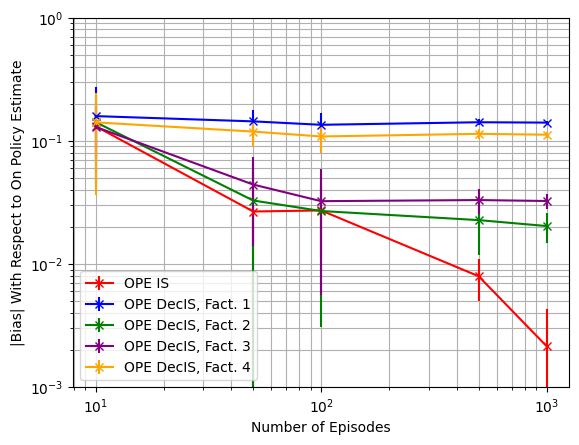

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.13110611 0.02663495 0.02717417 0.00794167 0.00214994]
OPE DecPDIS, Fact. 1-----[0.12972321 0.04545812 0.03856719 0.04289937 0.04219632]
OPE DecPDIS, Fact. 2-----[0.1452081  0.04213229 0.03308773 0.03344956 0.03130865]
OPE DecPDIS, Fact. 3-----[0.12619073 0.0366016  0.02821135 0.02725717 0.0265511 ]
OPE DecPDIS, Fact. 4-----[0.12953675 0.05950598 0.05005711 0.05538154 0.05383362]


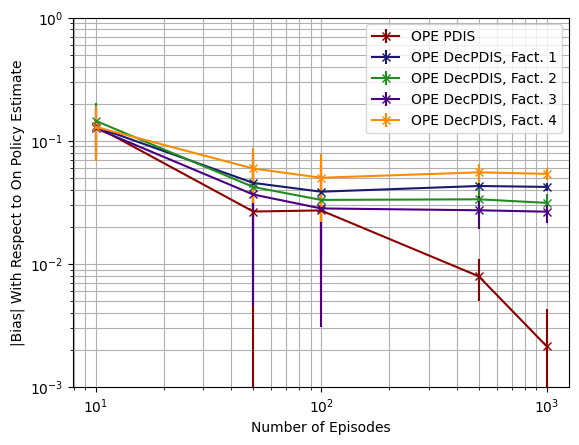

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.2188837  0.23537494 0.24436242 0.24228272 0.24352863]
OPE DecPDWIS, Fact. 1-----[0.21814445 0.23424723 0.24299923 0.24052326 0.24178415]
OPE DecPDWIS, Fact. 2-----[0.21726208 0.23325392 0.24211094 0.23994171 0.24128406]
OPE DecPDWIS, Fact. 3-----[0.21823191 0.23397615 0.24290759 0.24071711 0.24195801]
OPE DecPDWIS, Fact. 4-----[0.21690717 0.23287046 0.2417079  0.23930298 0.24059951]


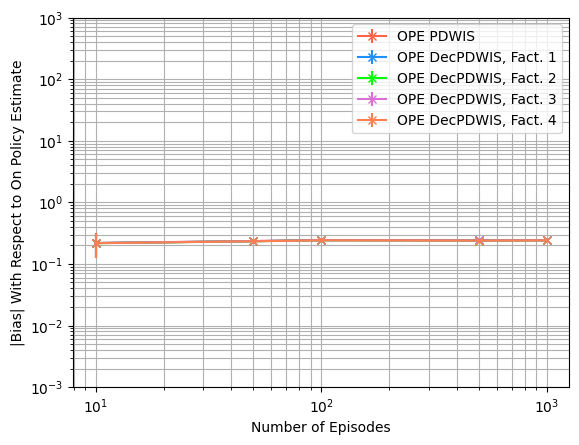

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.06179081 0.01592935 0.00787576 0.00117036 0.00057429]
OPE IS-----[0.07223963 0.01664199 0.00942905 0.00210041 0.00086737]
OPE DecIS, Fact. 1-----[0.07393042 0.01432932 0.00792009 0.00227249 0.00086141]
OPE DecIS, Fact. 2-----[0.05641641 0.01195051 0.00667542 0.00179685 0.00069803]
OPE DecIS, Fact. 3-----[0.06538085 0.01384342 0.00674719 0.00171387 0.00062617]
OPE DecIS, Fact. 4-----[0.05667869 0.01123385 0.00580995 0.00169895 0.00060833]


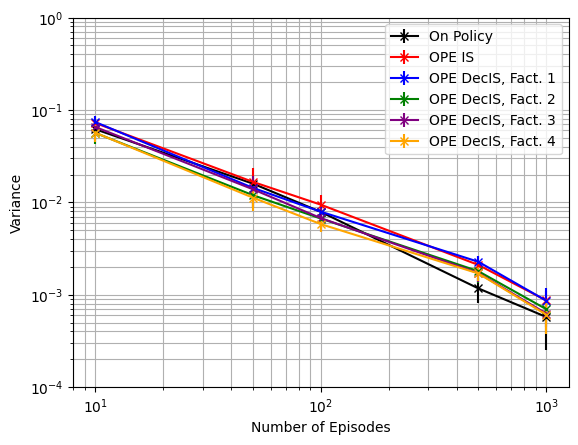

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

On Policy-----[0.06179081 0.01592935 0.00787576 0.00117036 0.00057429]
OPE PDIS-----[0.07223963 0.01664199 0.00942905 0.00210041 0.00086737]
OPE DecPDIS, Fact. 1-----[0.06914207 0.01295875 0.00742813 0.00209821 0.00080444]
OPE DecPDIS, Fact. 2-----[0.06720632 0.01410316 0.00775185 0.00216226 0.00081186]
OPE DecPDIS, Fact. 3-----[0.06977295 0.01494439 0.0076485  0.00193152 0.00068411]
OPE DecPDIS, Fact. 4-----[0.06095266 0.01203383 0.00623509 0.00185002 0.00065453]


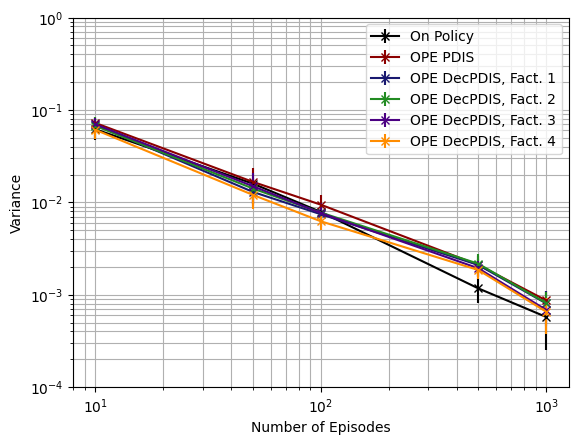

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.06179081 0.01592935 0.00787576 0.00117036 0.00057429]
OPE PDWIS-----[1.88950965e-04 3.89564744e-05 2.19614280e-05 5.25500759e-06
 2.21836662e-06]
OPE DecPDWIS, Fact. 1-----[1.59840385e-04 2.83020727e-05 1.55157719e-05 4.52548357e-06
 1.80063960e-06]
OPE DecPDWIS, Fact. 2-----[1.83549216e-04 3.65879020e-05 1.91966278e-05 5.72519603e-06
 2.13420135e-06]
OPE DecPDWIS, Fact. 3-----[1.89905007e-04 3.68883039e-05 1.90459410e-05 4.90791925e-06
 1.73425094e-06]
OPE DecPDWIS, Fact. 4-----[1.58687414e-04 2.96945663e-05 1.46618082e-05 4.47613720e-06
 1.61654461e-06]


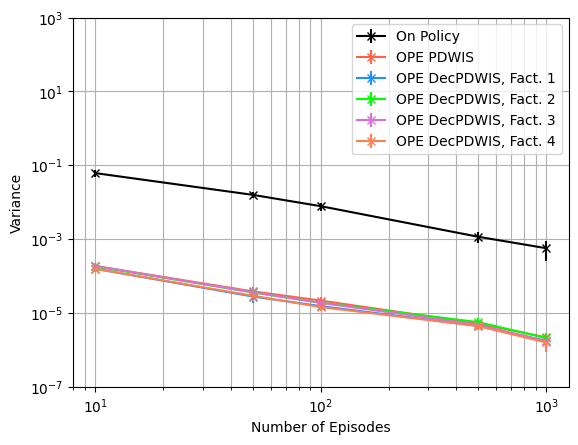

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.06179081 0.01592935 0.00787576 0.00117036 0.00057429]
OPE IS-----[0.09275765 0.01822422 0.01042076 0.00217224 0.0008765 ]
OPE DecIS, Fact. 1-----[0.11201728 0.03605682 0.0270868  0.02228592 0.02055407]
OPE DecIS, Fact. 2-----[0.07935128 0.01412551 0.00796514 0.00242751 0.00114151]
OPE DecIS, Fact. 3-----[0.08556868 0.01668883 0.00850294 0.00286252 0.0016993 ]
OPE DecIS, Fact. 4-----[0.08749079 0.02611845 0.01834029 0.01473854 0.01316433]


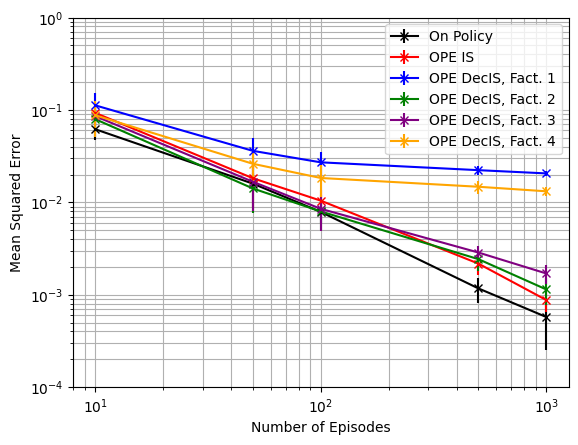

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

On Policy-----[0.06179081 0.01592935 0.00787576 0.00117036 0.00057429]
OPE PDIS-----[0.09275765 0.01822422 0.01042076 0.00217224 0.0008765 ]
OPE DecPDIS, Fact. 1-----[0.08850865 0.01605495 0.00972305 0.00400194 0.00259675]
OPE DecPDIS, Fact. 2-----[0.09145695 0.01704403 0.00967892 0.00339342 0.00182197]
OPE DecPDIS, Fact. 3-----[0.08898861 0.01731286 0.00907665 0.0027396  0.00141381]
OPE DecPDIS, Fact. 4-----[0.08151883 0.01635881 0.00953378 0.00501301 0.0035886 ]


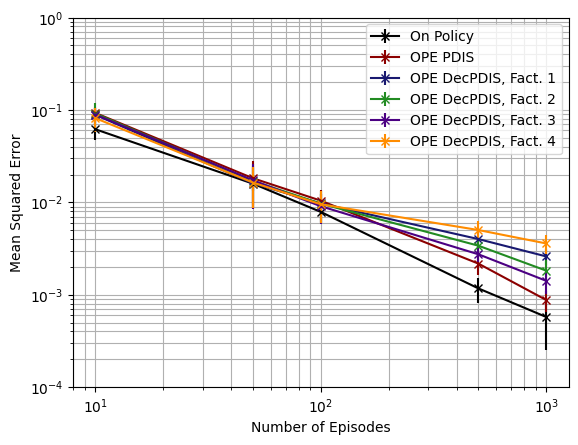

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.06179081 0.01592935 0.00787576 0.00117036 0.00057429]
OPE PDWIS-----[0.05673354 0.05583367 0.0600951  0.05876844 0.05933115]
OPE DecPDWIS, Fact. 1-----[0.05626518 0.0552905  0.05942337 0.05791899 0.05848536]
OPE DecPDWIS, Fact. 2-----[0.05602241 0.05483616 0.05899278 0.05764239 0.05824446]
OPE DecPDWIS, Fact. 3-----[0.05630542 0.05517079 0.05937776 0.05801257 0.0585693 ]
OPE DecPDWIS, Fact. 4-----[0.05569654 0.05464606 0.05879303 0.05733499 0.05791458]


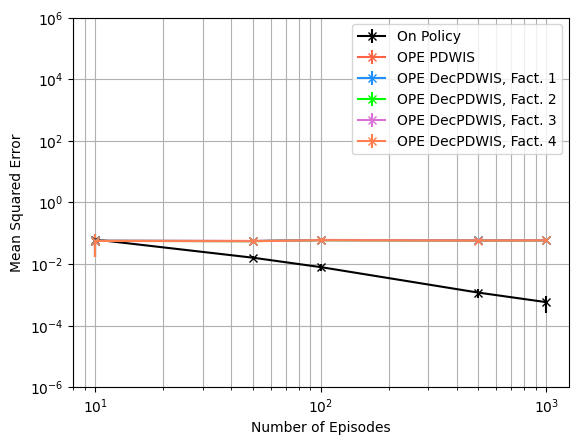

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[  8.52372816  55.6373215   94.66668215 280.99507677 769.6692404 ]
OPE DecIS, Fact. 1-----[  8.42681029  59.26774246 103.81426824 257.82510829 794.00941769]
OPE DecIS, Fact. 2-----[ 11.19092998  73.87730853 121.29825841 328.45178636 906.11530764]
OPE DecIS, Fact. 3-----[   9.39706894   69.04416121  131.39840874  347.44472781 1090.38555378]
OPE DecIS, Fact. 4-----[  11.00507264   79.61408606  139.34776493  345.80940598 1125.62622864]


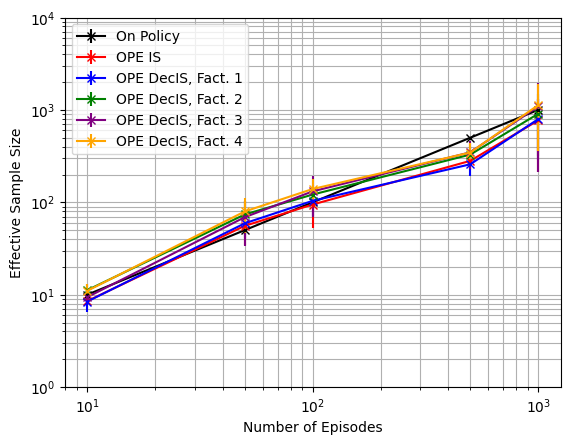

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**4, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[  8.52372816  55.6373215   94.66668215 280.99507677 769.6692404 ]
OPE DecPDIS, Fact. 1-----[  9.02022924  67.19243815 112.24679986 279.58636696 839.43710404]
OPE DecPDIS, Fact. 2-----[  9.44388717  62.65519356 104.63712052 273.24774673 799.98695831]
OPE DecPDIS, Fact. 3-----[   8.85212881   65.29754793  117.06889571  308.92496661 1011.24345609]
OPE DecPDIS, Fact. 4-----[  10.25887287   74.87162804  131.36373906  319.26769344 1071.64460081]


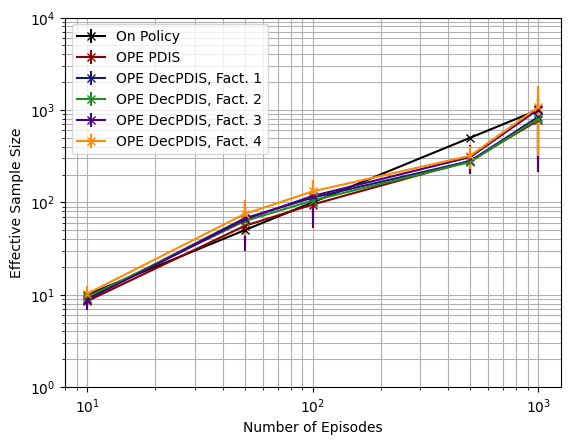

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**4, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[  3298.8454961   23041.03094953  39674.18281424 112852.64848058
 303754.41921733]
OPE DecPDWIS, Fact. 1-----[  3870.03751037  32476.81987112  53775.88575576 131723.7842517
 383644.83307188]
OPE DecPDWIS, Fact. 2-----[  3413.55998308  23512.34426105  41714.97513783 104267.61328508
 314528.91118447]
OPE DecPDWIS, Fact. 3-----[  3270.70809614  24185.45375847  46047.13663952 124122.25337836
 396336.56090548]
OPE DecPDWIS, Fact. 4-----[  3893.4646902   29484.37491605  56081.28880467 134225.7607888
 448055.06252895]


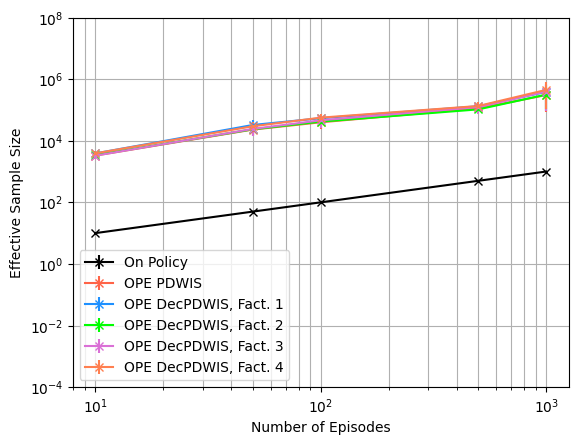

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

### Varying Episode Length $T$ With $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{T}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc

gc.collect()
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
LENGTHS = [1, 5, 10, 20]

bias_means = np.zeros((len(LENGTHS), 16))
bias_stds = np.zeros((len(LENGTHS), 16))
var_means = np.zeros((len(LENGTHS), 16))
var_stds = np.zeros((len(LENGTHS), 16))
MSE_means = np.zeros((len(LENGTHS), 16))
MSE_stds = np.zeros((len(LENGTHS), 16))
ESS_means = np.zeros((len(LENGTHS), 16))
ESS_stds = np.zeros((len(LENGTHS), 16))

RUNS = 20

for id in range(len(LENGTHS)):
  e = LENGTHS[id]
  print(f'{e} Steps, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

1 Steps, 100 ----------------------------------

Mean on policy Q estimate: -0.20343883153094042. Variance of on policy Q estimate: 0.7284016860982847
Mean OPE IS estimate: -0.31711225508510354. Bias1: 0.11367342355416425. Bias2: 0.11367342355416313. Variance: 0.7966498405754866. MSE: 0.809571487798011
Mean OPE PDIS estimate: -0.31711225508510354. Bias1: 0.11367342355416425. Bias2: 0.11367342355416313. Variance: 0.7966498405754866. MSE: 0.809571487798011
Mean OPE PDWIS estimate: -0.01928379382156191. Bias1: 0.18415503770937852. Bias2: 0.18415503770937852. Variance: 0.00123797178722712. MSE: 0.035151049700969744
Mean OPE DecIS: Fact. 1 estimate: -0.4707760491429705. Bias1: 0.26733721761203044. Bias2: 0.2673372176120301. Variance: 0.8069555535244086. MSE: 0.8784247414449508
Mean OPE DecPDIS: Fact. 1 estimate: -0.3666391388973971. Bias1: 0.16320030736645608. Bias2: 0.16320030736645666. Variance: 0.7415140799709318. MSE: 0.7681484202954375
Mean OPE DecPDWIS: Fact. 1 estimate: -0.0159358005

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.10492979 0.04905039 0.02557503 0.02729698]
OPE DecIS, Fact. 1-----[0.15742548 0.12545232 0.134726   0.14437657]
OPE DecIS, Fact. 2-----[0.10234486 0.0430281  0.03195877 0.03458214]
OPE DecIS, Fact. 3-----[0.09426483 0.05205109 0.0399823  0.04201711]
OPE DecIS, Fact. 4-----[0.1327322  0.09256725 0.10978852 0.11796954]


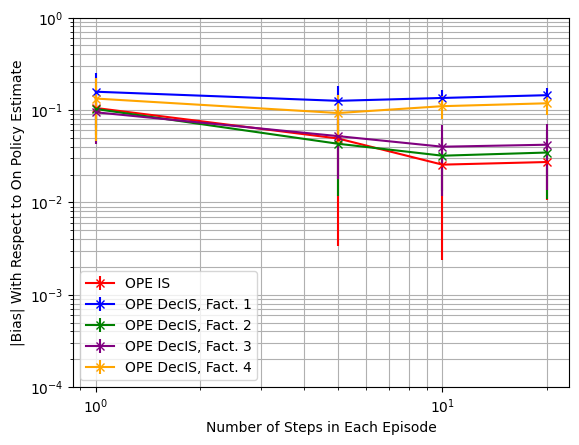

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.10492979 0.04905039 0.02557503 0.02729698]
OPE DecPDIS, Fact. 1-----[0.10217243 0.05187077 0.03836427 0.04655455]
OPE DecPDIS, Fact. 2-----[0.11043621 0.05053401 0.03881867 0.04274312]
OPE DecPDIS, Fact. 3-----[0.09860923 0.0487427  0.03736322 0.03812275]
OPE DecPDIS, Fact. 4-----[0.09882498 0.05506075 0.05066062 0.05975792]


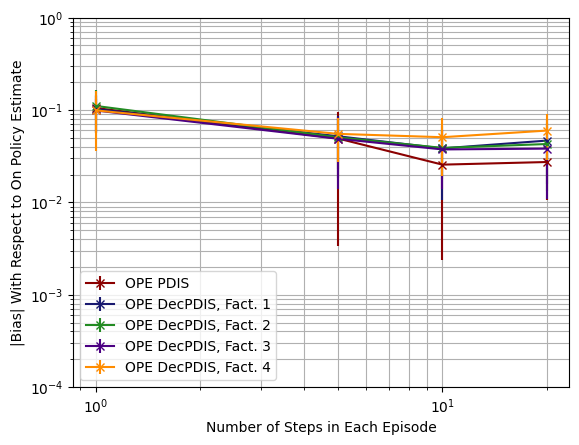

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.24523207 0.26208549 0.24395337 0.23451045]
OPE DecPDWIS, Fact. 1-----[0.24906276 0.26253416 0.24348403 0.23350151]
OPE DecPDWIS, Fact. 2-----[0.24623971 0.26126005 0.24237938 0.23254714]
OPE DecPDWIS, Fact. 3-----[0.24656594 0.2618702  0.24307386 0.23330233]
OPE DecPDWIS, Fact. 4-----[0.24820999 0.2614746  0.24224    0.23225407]


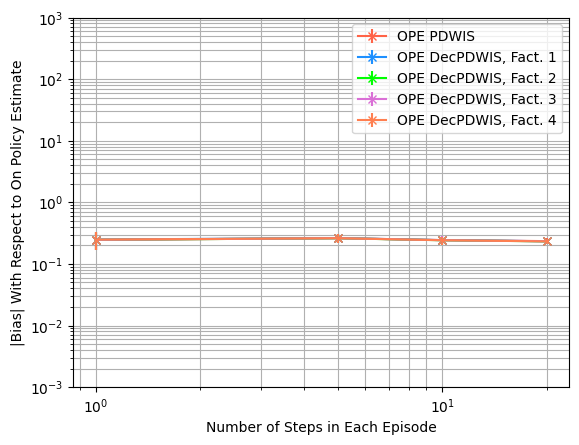

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.63688602 0.13052077 0.06182759 0.03275886]
OPE IS-----[0.84155112 0.19215611 0.09039916 0.04965184]
OPE DecIS, Fact. 1-----[0.84598552 0.16385578 0.08143333 0.04428602]
OPE DecIS, Fact. 2-----[0.60461858 0.14934284 0.0652948  0.03411405]
OPE DecIS, Fact. 3-----[0.72838446 0.16025504 0.0763397  0.03995205]
OPE DecIS, Fact. 4-----[0.59716966 0.12818644 0.06301988 0.03310353]


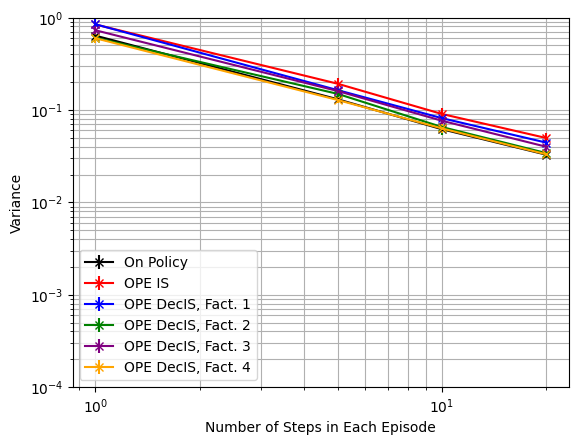

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

On Policy-----[0.63688602 0.13052077 0.06182759 0.03275886]
OPE PDIS-----[0.84155112 0.19215611 0.09039916 0.04965184]
OPE DecPDIS, Fact. 1-----[0.79447965 0.15471312 0.07569656 0.0412052 ]
OPE DecPDIS, Fact. 2-----[0.72169873 0.17352643 0.07761225 0.04023039]
OPE DecPDIS, Fact. 3-----[0.75224741 0.17080893 0.08247544 0.04309353]
OPE DecPDIS, Fact. 4-----[0.64598177 0.13978706 0.0681468  0.03555127]


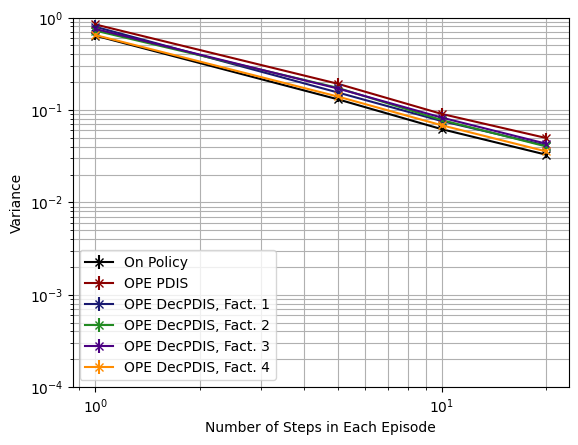

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.63688602 0.13052077 0.06182759 0.03275886]
OPE PDWIS-----[0.0012391  0.00040022 0.0002089  0.00011484]
OPE DecPDWIS, Fact. 1-----[1.23552239e-03 3.20410517e-04 1.65209519e-04 8.90189671e-05]
OPE DecPDWIS, Fact. 2-----[0.00138858 0.00040133 0.00020103 0.00010445]
OPE DecPDWIS, Fact. 3-----[0.00125506 0.00038486 0.00019485 0.00010453]
OPE DecPDWIS, Fact. 4-----[1.32497557e-03 3.36047907e-04 1.66617874e-04 8.58325870e-05]


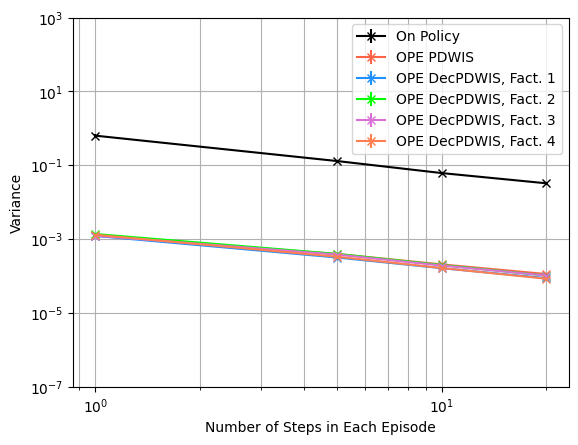

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.63688602 0.13052077 0.06182759 0.03275886]
OPE IS-----[0.85323075 0.19664632 0.09159243 0.05067396]
OPE DecIS, Fact. 1-----[0.87946944 0.18276372 0.1003768  0.06604973]
OPE DecIS, Fact. 2-----[0.6174518  0.15218146 0.06666299 0.03586775]
OPE DecIS, Fact. 3-----[0.73990437 0.16413402 0.07873986 0.04252789]
OPE DecIS, Fact. 4-----[0.62220548 0.13942716 0.07597269 0.04786357]


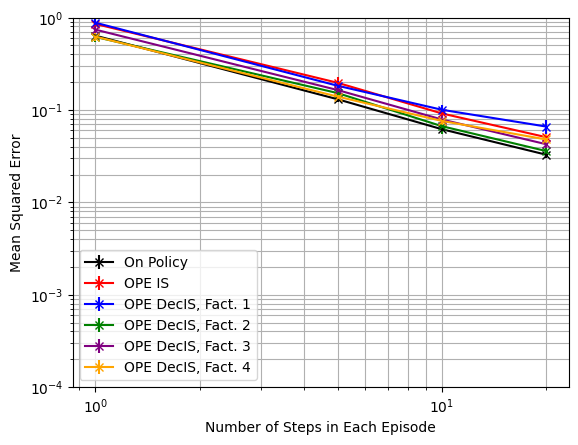

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

On Policy-----[0.63688602 0.13052077 0.06182759 0.03275886]
OPE PDIS-----[0.85323075 0.19664632 0.09159243 0.05067396]
OPE DecPDIS, Fact. 1-----[0.80685821 0.15853188 0.07794544 0.04432217]
OPE DecPDIS, Fact. 2-----[0.73679358 0.17683609 0.07956442 0.04292424]
OPE DecPDIS, Fact. 3-----[0.76370535 0.17438687 0.08441709 0.04529426]
OPE DecPDIS, Fact. 4-----[0.65965045 0.14358772 0.07170988 0.04009823]


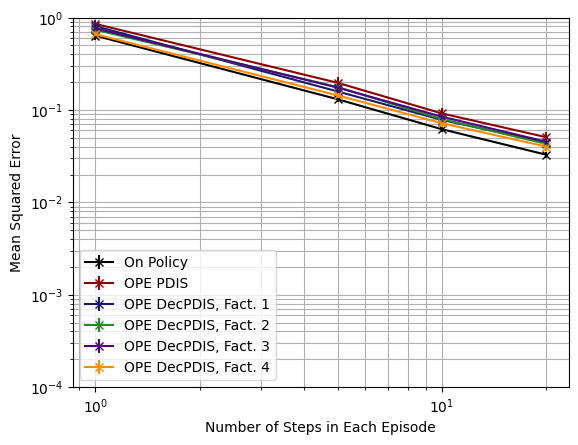

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.63688602 0.13052077 0.06182759 0.03275886]
OPE PDWIS-----[0.06740246 0.07117    0.06101069 0.05572725]
OPE DecPDWIS, Fact. 1-----[0.06934907 0.07128776 0.06072982 0.05523144]
OPE DecPDWIS, Fact. 2-----[0.06807484 0.07067843 0.06022814 0.05480031]
OPE DecPDWIS, Fact. 3-----[0.06811939 0.07100139 0.06056995 0.05515573]
OPE DecPDWIS, Fact. 4-----[0.06900615 0.07073235 0.06013282 0.05464726]


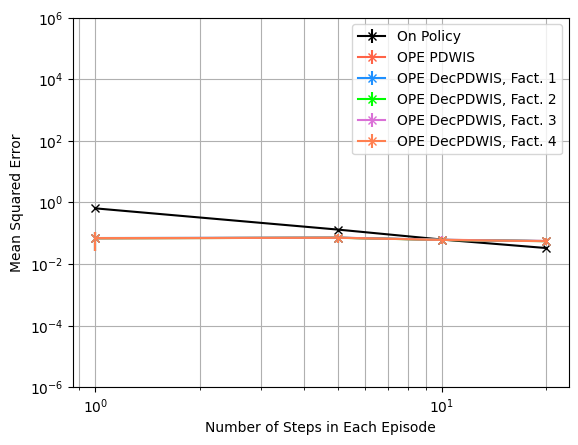

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[ 1.  5. 10. 20.]
OPE IS-----[ 0.75767872  3.46072644  6.96772997 13.42495978]
OPE DecIS, Fact. 1-----[ 0.78193078  3.99917079  7.63561207 14.91990441]
OPE DecIS, Fact. 2-----[ 1.0602068   4.40812119  9.73405663 19.52313294]
OPE DecIS, Fact. 3-----[ 0.90007667  4.118853    8.20851099 16.5870114 ]
OPE DecIS, Fact. 4-----[ 1.08115698  5.10223861  9.90256102 19.94674912]


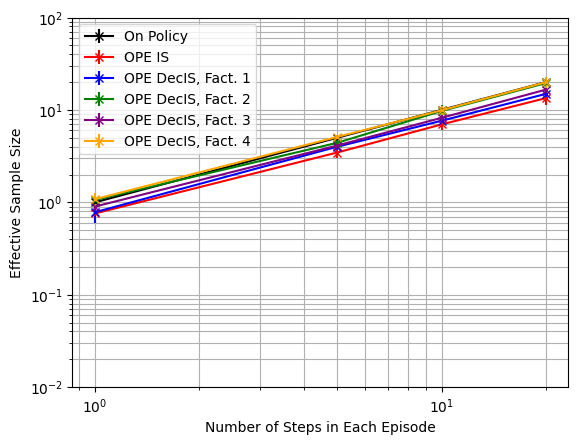

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-2), 10**2, shorter_D, estimator='IS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDIS-----[ 0.75767872  3.46072644  6.96772997 13.42495978]
OPE DecPDIS, Fact. 1-----[ 0.83267897  4.23709247  8.23184346 16.00233984]
OPE DecPDIS, Fact. 2-----[ 0.88547893  3.7906166   8.17399978 16.4904279 ]
OPE DecPDIS, Fact. 3-----[ 0.85477821  3.86697081  7.66744027 15.37146492]
OPE DecPDIS, Fact. 4-----[ 0.99411423  4.68247354  9.1857006  18.55437343]


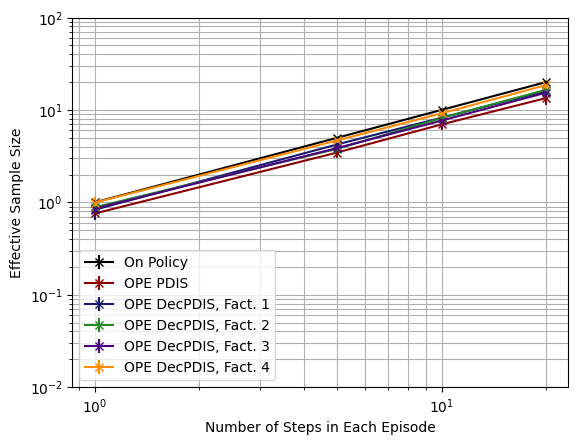

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-2), 10**2, shorter_D, estimator='PDIS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDWIS-----[ 517.55540665 1639.7366061  2985.41093807 5737.25408196]
OPE DecPDWIS, Fact. 1-----[ 519.08290123 2052.18912813 3771.54107746 7400.74321757]
OPE DecPDWIS, Fact. 2-----[ 460.37511604 1630.80311927 3106.19386376 6314.69144083]
OPE DecPDWIS, Fact. 3-----[ 510.16976751 1703.94957583 3213.94432503 6339.42790459]
OPE DecPDWIS, Fact. 4-----[ 482.89594637 1949.84819283 3748.20098281 7676.50688952]


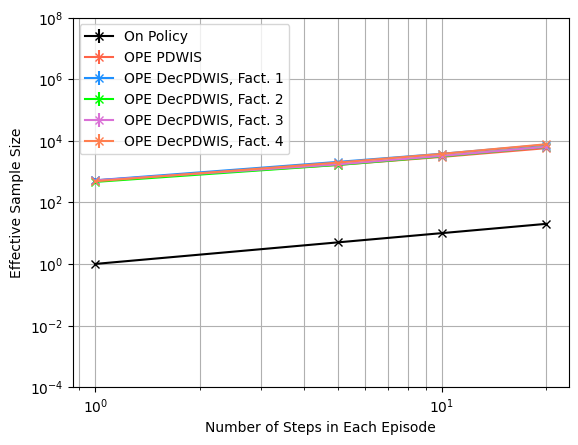

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

## From Patient State 377, With Diabetes

In [ ]:
#The patient has diabetes
PROB_DIAB = 1.0

### State Analysis

In [ ]:
#Instantiate a state based on the idx and get the state vector
testState = State(state_idx = 377, diabetic_idx=1)
vec = testState.get_state_vector()

print(vec)
print(f'Num abnormals: {testState.get_num_abnormal()}\n')

print(f'Heart Rate: {hr_state_mapping[vec[0]]}')
print(f'Systolic Blood Pressure: {sbp_state_mapping[vec[1]]}')
print(f'Percent Oxygen: {o2_state_mapping[vec[2]]}')
print(f'Glucose Level: {glu_state_mapping[vec[3]]}')
print(f'Antibiotics: {abx_state_mapping[vec[4]]}')
print(f'Vasopressors: {vaso_state_mapping[vec[5]]}')
print(f'Ventilator: {vent_state_mapping[vec[6]]}')
print(f'Diabetes: {testState.diabetic_idx}')

[1 1 1 2 0 0 1]
Num abnormals: 0

Heart Rate: Normal
Systolic Blood Pressure: Normal
Percent Oxygen: Normal
Glucose Level: Normal
Antibiotics: Off
Vasopressors: Off
Ventilator: On
Diabetes: 1


### Generate Data From Behaviour Policy

Run the data generator

In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=randPol, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

Convert data into array format

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_b = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_b.shape

(100000, 20, 5)

In [ ]:
f_tr_b1, f_tr_b2, f_tr_b3, f_tr_b4 = factorise_dataset(nf_tr_b)

In [ ]:
factored_randPol1 = factor_policy_1(randPol)
factored_randPol2 = factor_policy_2(randPol)
factored_randPol3 = factor_policy_3(randPol)
factored_randPol4 = factor_policy_4(randPol)

In [ ]:
randPol = pad_policy(randPol)

factored_randPol1[0] = pad_policy(factored_randPol1[0])
factored_randPol1[1] = pad_policy(factored_randPol1[1])

factored_randPol2[0] = pad_policy(factored_randPol2[0])
factored_randPol2[1] = pad_policy(factored_randPol2[1])

factored_randPol3[0] = pad_policy(factored_randPol3[0])
factored_randPol3[1] = pad_policy(factored_randPol3[1])

factored_randPol4[0] = pad_policy(factored_randPol4[0])
factored_randPol4[1] = pad_policy(factored_randPol4[1])
factored_randPol4[2] = pad_policy(factored_randPol4[2])

### Varying Episodes $\epsilon_{e} = 0.4$ (Policy Divergence $4.8^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
EVAL_EPSILON = 0.4

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

4.8


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
print(nf_tr_b)

[[[  0. 377.   6.   0. 389.]
  [  1. 389.   5.   0. 478.]
  [  2. 478.   5.   0. 478.]
  ...
  [ 17. 479.   3.   0. 475.]
  [ 18. 475.   3.   0. 475.]
  [ 19. 475.   1.   0. 474.]]

 [[  0. 377.   6.   0. 373.]
  [  1. 373.   5.   0. 454.]
  [  2. 454.   1.   0. 450.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 377.   5.   0. 470.]
  [  1. 470.   2.   0. 457.]
  [  2. 457.   7.   0. 463.]
  ...
  [ 17. 696.   4.   0. 380.]
  [ 18. 380.   0.   0. 456.]
  [ 19. 456.   7.   0. 471.]]

 ...

 [[  0. 377.   7.   0. 463.]
  [  1. 463.   5.   0. 422.]
  [  2. 422.   0.   0. 416.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 377.   2.   0. 289.]
  [  1. 289.   2.   0. 297.]
  [  2. 297.   1.   0. 306.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 377.   5.   0. 422.]
  [  1. 422.   2.  -1. 409.]
  [  2. 409.  -1.   0.  -1

In [ ]:
print(f_tr_b1)

[[[[ 0.00e+00  3.77e+02  1.00e+00  0.00e+00  3.89e+02]
   [ 0.00e+00  3.77e+02  2.00e+00  0.00e+00  3.89e+02]]

  [[ 1.00e+00  3.89e+02  0.00e+00  0.00e+00  4.78e+02]
   [ 1.00e+00  3.89e+02  3.00e+00  0.00e+00  4.78e+02]]

  [[ 2.00e+00  4.78e+02  0.00e+00  0.00e+00  4.78e+02]
   [ 2.00e+00  4.78e+02  3.00e+00  0.00e+00  4.78e+02]]

  ...

  [[ 1.70e+01  4.79e+02  1.00e+00  0.00e+00  4.75e+02]
   [ 1.70e+01  4.79e+02  1.00e+00  0.00e+00  4.75e+02]]

  [[ 1.80e+01  4.75e+02  1.00e+00  0.00e+00  4.75e+02]
   [ 1.80e+01  4.75e+02  1.00e+00  0.00e+00  4.75e+02]]

  [[ 1.90e+01  4.75e+02  0.00e+00  0.00e+00  4.74e+02]
   [ 1.90e+01  4.75e+02  1.00e+00  0.00e+00  4.74e+02]]]


 [[[ 0.00e+00  3.77e+02  1.00e+00  0.00e+00  3.73e+02]
   [ 0.00e+00  3.77e+02  2.00e+00  0.00e+00  3.73e+02]]

  [[ 1.00e+00  3.73e+02  0.00e+00  0.00e+00  4.54e+02]
   [ 1.00e+00  3.73e+02  3.00e+00  0.00e+00  4.54e+02]]

  [[ 2.00e+00  4.54e+02  0.00e+00  0.00e+00  4.50e+02]
   [ 2.00e+00  4.54e+02  1.00e+00  0.00e

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.014067393049910457. Variance of on policy Q estimate: 0.044364927252957535
Mean OPE IS estimate: -0.14330979436461272. Bias1: 0.12924240131470202. Bias2: 0.12924240131470227. Variance: 0.4254232605813145. MSE: 0.442126858878905
Mean OPE PDIS estimate: -0.14330979436461272. Bias1: 0.12924240131470202. Bias2: 0.12924240131470227. Variance: 0.4254232605813145. MSE: 0.442126858878905
Mean OPE PDWIS estimate: -0.000805712198975301. Bias1: 0.01326168085093514. Bias2: 0.013261680850935155. Variance: 0.0009018776103048725. MSE: 0.0010777497892969323
Mean OPE DecIS: Fact. 1 estimate: -0.6872063311373195. Bias1: 0.6731389380874092. Bias2: 0.6731389380874091. Variance: 0.5956881845586108. MSE: 1.0488042145280558
Mean OPE DecPDIS: Fact. 1 estimate: -0.3485838663961204. Bias1: 0.3345164733462099. Bias2: 0.33451647334620993. Variance: 0.1941969597255119. MSE: 0.30609823066549746
Mean OPE DecPDWIS: Fact. 1 estimate: -0.

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.20615083 0.08051301 0.05346146 0.08505253 0.06872179]
OPE DecIS, Fact. 1-----[0.51735142 0.62277114 0.57707089 0.65571666 0.68743759]
OPE DecIS, Fact. 2-----[0.77603525 0.16843676 0.16269557 0.17704058 0.2603606 ]
OPE DecIS, Fact. 3-----[1.74232161 0.56642995 0.35037798 0.30910442 0.27595602]
OPE DecIS, Fact. 4-----[0.48147082 0.55717403 0.50349766 0.54554434 0.5880197 ]


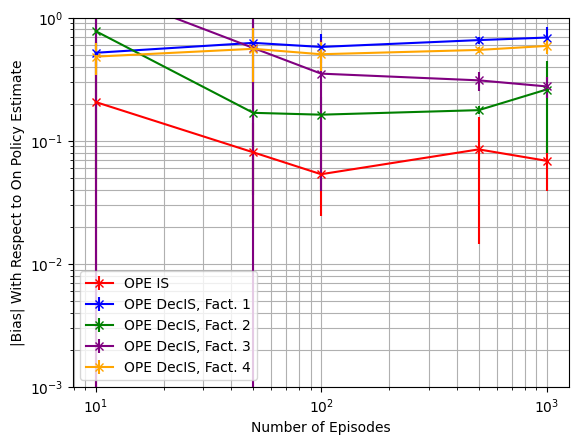

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**-3, 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.20615083 0.08051301 0.05346146 0.08505253 0.06872179]
OPE DecPDIS, Fact. 1-----[0.25699851 0.31252363 0.27472892 0.3393807  0.33460494]
OPE DecPDIS, Fact. 2-----[0.86065622 0.20727754 0.23892906 0.28874685 0.3748075 ]
OPE DecPDIS, Fact. 3-----[0.94386157 0.3914136  0.23905488 0.3284195  0.31246442]
OPE DecPDIS, Fact. 4-----[0.34243231 0.37623621 0.35275868 0.40912455 0.42909587]


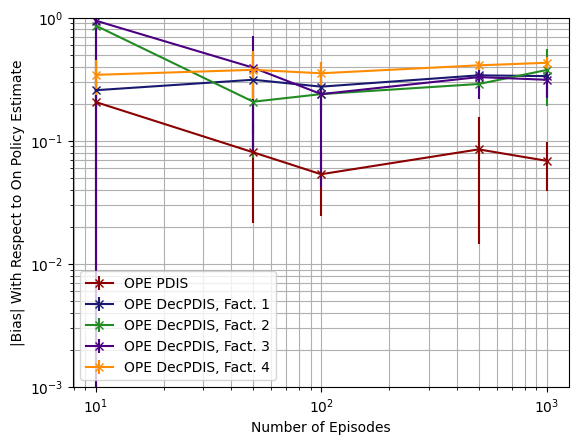

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.03920364 0.02512441 0.02663686 0.02283179 0.02548786]
OPE DecPDWIS, Fact. 1-----[0.03824694 0.02343136 0.0216162  0.01368008 0.01558997]
OPE DecPDWIS, Fact. 2-----[0.03245257 0.020783   0.01616726 0.00694351 0.00776192]
OPE DecPDWIS, Fact. 3-----[0.03863477 0.02284623 0.022727   0.01037911 0.01079824]
OPE DecPDWIS, Fact. 4-----[0.03350965 0.0208538  0.01573644 0.00539263 0.00659604]


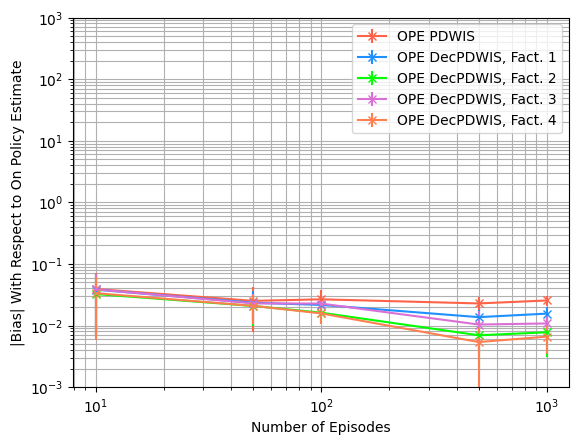

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.06619678 0.01559867 0.00761185 0.00132273 0.0005639 ]
OPE IS-----[1.64975408 0.16071897 0.1356154  0.09121104 0.04260555]
OPE DecIS, Fact. 1-----[0.59762368 0.81687729 0.27018824 0.1260702  0.62074426]
OPE DecIS, Fact. 2-----[20.37414041  0.86955425  0.27851196  0.02843101  0.73135003]
OPE DecIS, Fact. 3-----[1.71639563e+02 7.03102749e+00 1.79109721e+00 2.00990646e-01
 5.64713697e-02]
OPE DecIS, Fact. 4-----[0.4744213  0.57363894 0.19102467 0.06204322 0.22157451]


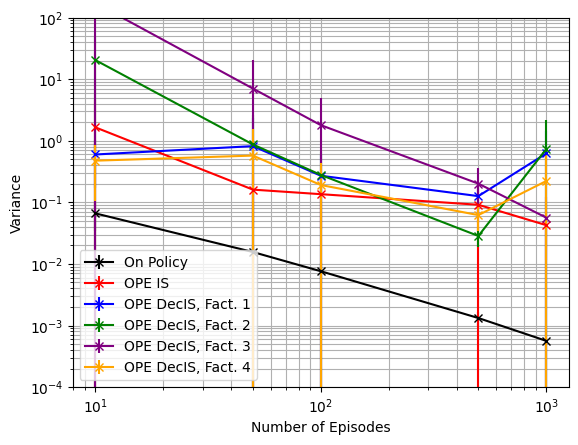

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**2, shorter_D, estimator='IS')

On Policy-----[0.06619678 0.01559867 0.00761185 0.00132273 0.0005639 ]
OPE PDIS-----[1.64975408 0.16071897 0.1356154  0.09121104 0.04260555]
OPE DecPDIS, Fact. 1-----[0.41713587 0.27260487 0.08943392 0.05069721 0.28952727]
OPE DecPDIS, Fact. 2-----[20.38718244  0.86015196  0.32522613  0.0444161   0.74839771]
OPE DecPDIS, Fact. 3-----[27.82741027  1.35119968  0.39394952  0.35181204  0.12664326]
OPE DecPDIS, Fact. 4-----[0.36494374 0.29507631 0.10823324 0.03841276 0.07338496]


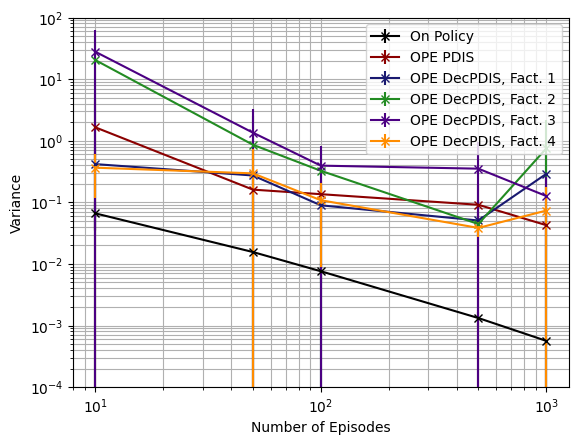

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**2, shorter_D, estimator='PDIS')

On Policy-----[0.06619678 0.01559867 0.00761185 0.00132273 0.0005639 ]
OPE PDWIS-----[6.98787984e-04 2.08767589e-04 1.80806848e-04 8.76491904e-05
 7.94715840e-05]
OPE DecPDWIS, Fact. 1-----[4.68310887e-04 8.61300103e-05 5.48009077e-05 4.22643141e-05
 4.83459312e-05]
OPE DecPDWIS, Fact. 2-----[1.29524497e-03 3.04215768e-04 2.00262348e-04 8.06052992e-05
 1.17392868e-04]
OPE DecPDWIS, Fact. 3-----[0.00109109 0.00048261 0.00040566 0.00024415 0.00021747]
OPE DecPDWIS, Fact. 4-----[7.85312433e-04 1.80878652e-04 1.07666113e-04 4.41494697e-05
 3.30874251e-05]


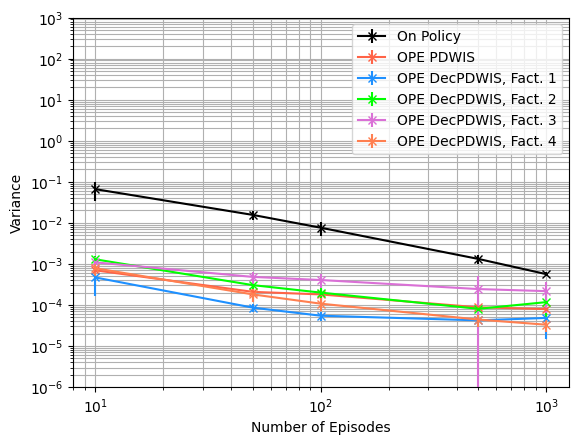

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.06619678 0.01559867 0.00761185 0.00132273 0.0005639 ]
OPE IS-----[1.76427391 0.17067183 0.13932218 0.10341611 0.04818578]
OPE DecIS, Fact. 1-----[0.87740327 1.31653365 0.62646357 0.55788307 1.11654461]
OPE DecIS, Fact. 2-----[21.50357782  0.9153353   0.30883804  0.05994985  0.83173691]
OPE DecIS, Fact. 3-----[1.82660120e+02 7.71425899e+00 2.01067207e+00 2.99460813e-01
 1.35305803e-01]
OPE DecIS, Fact. 4-----[0.72627053 0.95143271 0.46240293 0.36054523 0.5737369 ]


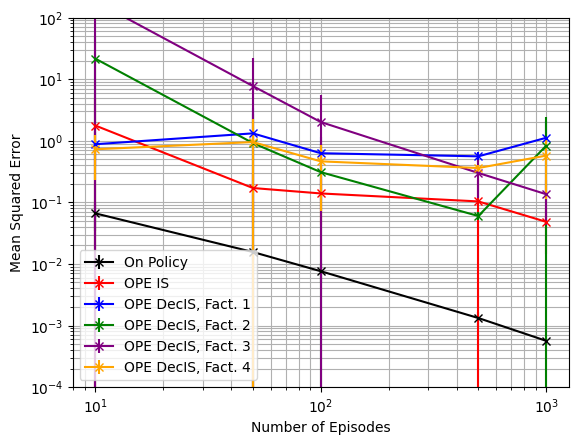

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**2, shorter_D, estimator='IS')

On Policy-----[0.06619678 0.01559867 0.00761185 0.00132273 0.0005639 ]
OPE PDIS-----[1.76427391 0.17067183 0.13932218 0.10341611 0.04818578]
OPE DecPDIS, Fact. 1-----[0.48877962 0.40995772 0.17409379 0.1672378  0.41345005]
OPE DecPDIS, Fact. 2-----[21.58858168  0.92138936  0.3879311   0.12861064  0.92209133]
OPE DecPDIS, Fact. 3-----[29.64355667  1.60158361  0.48998965  0.47158872  0.23211708]
OPE DecPDIS, Fact. 4-----[0.49347536 0.46220842 0.23890444 0.20678641 0.25970854]


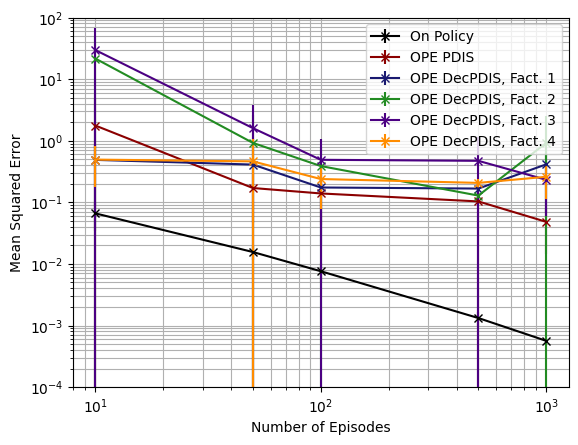

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**2, shorter_D, estimator='PDIS')

On Policy-----[0.06619678 0.01559867 0.00761185 0.00132273 0.0005639 ]
OPE PDWIS-----[0.00323057 0.00113682 0.00100039 0.0006421  0.00075509]
OPE DecPDWIS, Fact. 1-----[0.00291941 0.00079541 0.00056255 0.00024959 0.0003089 ]
OPE DecPDWIS, Fact. 2-----[0.00302339 0.00086012 0.00049041 0.00015164 0.00019979]
OPE DecPDWIS, Fact. 3-----[0.00348325 0.00110474 0.0009339  0.00040009 0.00036387]
OPE DecPDWIS, Fact. 4-----[2.67839373e-03 7.18835418e-04 3.83180505e-04 9.35971579e-05
 8.69034042e-05]


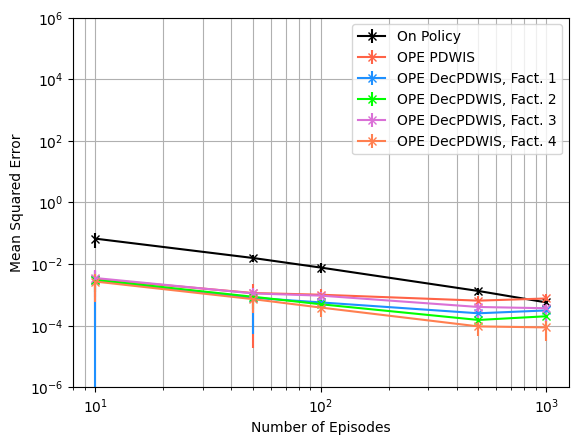

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[ 5.32718303 21.74097509 29.79534103 24.99450987 25.3919139 ]
OPE DecIS, Fact. 1-----[ 2.32452273  8.32450275 12.13086714  6.78160913  6.40814037]
OPE DecIS, Fact. 2-----[ 4.89642206 47.6805002  67.23439429 26.76991831 29.94589886]
OPE DecIS, Fact. 3-----[ 9.00882761 13.46875918 12.54721593 11.76092614 26.8119748 ]
OPE DecIS, Fact. 4-----[ 4.02378045 13.01046622 16.40288361 12.96388019 14.05089673]


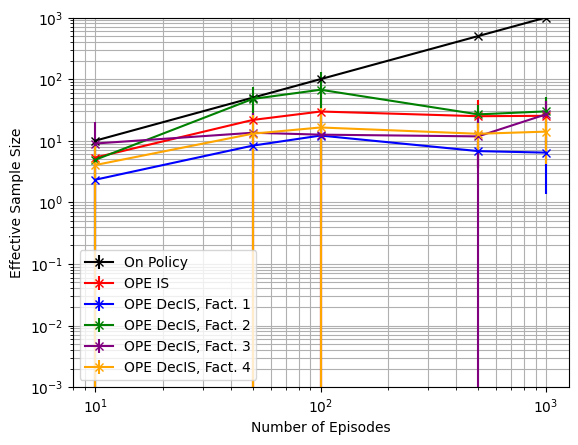

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-3), 10**3, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[ 5.32718303 21.74097509 29.79534103 24.99450987 25.3919139 ]
OPE DecPDIS, Fact. 1-----[ 4.47164949 17.60465737 22.3049405  16.13080632 14.89424221]
OPE DecPDIS, Fact. 2-----[ 3.48778267 24.19510072 21.70828417 16.52730538 17.51708695]
OPE DecPDIS, Fact. 3-----[ 6.09319155  5.65872339  8.02716254 13.75331514 12.97149613]
OPE DecPDIS, Fact. 4-----[ 5.93100407 18.50767857 13.69199952 18.52266889 24.38451797]


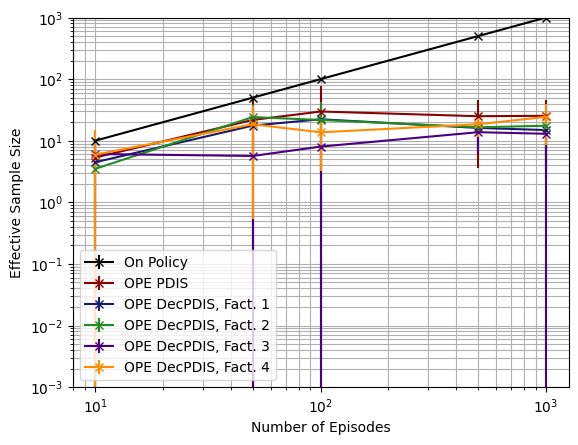

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[1071.11345185 4383.63222564 6200.51235056 9178.27759418 8507.34025969]
OPE DecPDWIS, Fact. 1-----[ 1953.9937666   9123.12996429 14224.54266012 18459.61325851
 17385.87201504]
OPE DecPDWIS, Fact. 2-----[ 557.70304649 3183.99354315 4038.46593515 8379.14500649 8549.84171769]
OPE DecPDWIS, Fact. 3-----[ 777.40311711 1736.29248857 2466.14164663 5652.16723052 4462.8164707 ]
OPE DecPDWIS, Fact. 4-----[ 1010.97323983  4870.7489243   7316.44159624 17409.74402118
 19522.28110698]


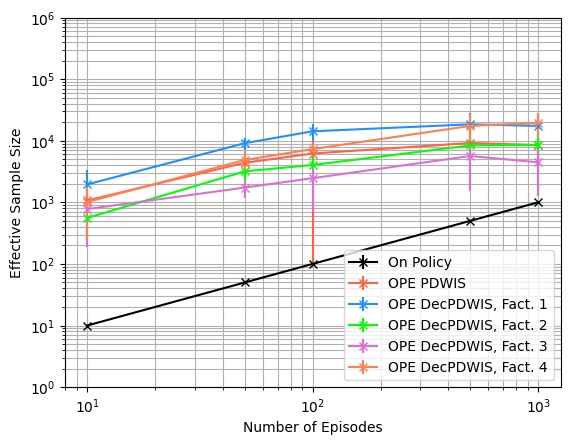

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**(6), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.6$ (Policy Divergence $3.2^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc

gc.collect()
EVAL_EPSILON = 0.6

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

3.2


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.383472965100892. Variance of on policy Q estimate: 0.03695991885093007
Mean OPE IS estimate: -0.44169929100766436. Bias1: 0.05822632590677465. Bias2: 0.05822632590677235. Variance: 0.5852463910133572. MSE: 0.5886366960419591
Mean OPE PDIS estimate: -0.44169929100766436. Bias1: 0.05822632590677465. Bias2: 0.05822632590677235. Variance: 0.5852463910133572. MSE: 0.5886366960419591
Mean OPE PDWIS estimate: -0.01308501996284068. Bias1: 0.37038794513805134. Bias2: 0.37038794513805134. Variance: 0.0006592325174765264. MSE: 0.13784646242106466
Mean OPE DecIS: Fact. 1 estimate: -0.8442410104056902. Bias1: 0.4607680453047982. Bias2: 0.4607680453047982. Variance: 0.525028647026786. MSE: 0.7373358386007905
Mean OPE DecPDIS: Fact. 1 estimate: -0.5283339717515976. Bias1: 0.14486100665070564. Bias2: 0.14486100665070556. Variance: 0.32365415505946327. MSE: 0.34463886630731905
Mean OPE DecPDWIS: Fact. 1 estimate: -0.01605

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.12448015 0.04325742 0.03228865 0.03018545 0.02235512]
OPE DecIS, Fact. 1-----[0.32285621 0.37766021 0.34771196 0.39469452 0.40491785]
OPE DecIS, Fact. 2-----[0.54329128 0.10622987 0.07288291 0.02968919 0.05086559]
OPE DecIS, Fact. 3-----[0.40681061 0.14405006 0.08484166 0.05391882 0.03918357]
OPE DecIS, Fact. 4-----[0.24576195 0.27221515 0.23382175 0.25535763 0.26216651]


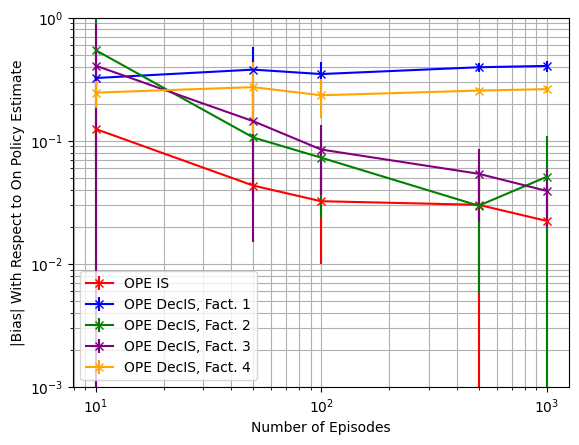

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.12448015 0.04325742 0.03228865 0.03018545 0.02235512]
OPE DecPDIS, Fact. 1-----[0.08639234 0.11549512 0.09194976 0.13677143 0.13869049]
OPE DecPDIS, Fact. 2-----[0.60846588 0.05424005 0.05537438 0.09272158 0.13710434]
OPE DecPDIS, Fact. 3-----[0.31274304 0.13286624 0.07680315 0.12310257 0.10830267]
OPE DecPDIS, Fact. 4-----[0.13807921 0.15064434 0.12963258 0.16501609 0.16653052]


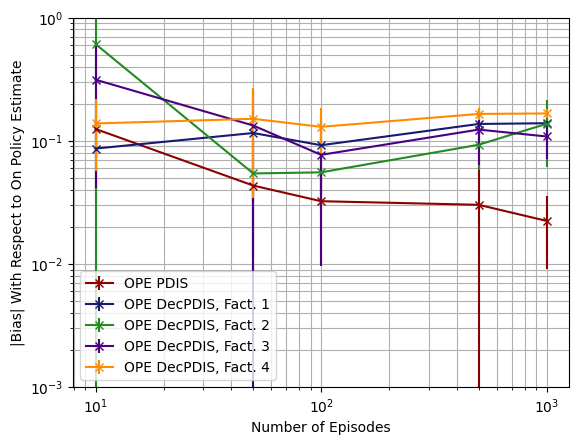

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.31605707 0.33302838 0.3398676  0.33751222 0.33929915]
OPE DecPDWIS, Fact. 1-----[0.3169061  0.33266422 0.33831219 0.33556583 0.33702975]
OPE DecPDWIS, Fact. 2-----[0.3092459  0.32793621 0.33313337 0.32921928 0.33001533]
OPE DecPDWIS, Fact. 3-----[0.31238863 0.32699802 0.33475145 0.33092628 0.3320421 ]
OPE DecPDWIS, Fact. 4-----[0.31099173 0.32705754 0.33264019 0.32959533 0.33076481]


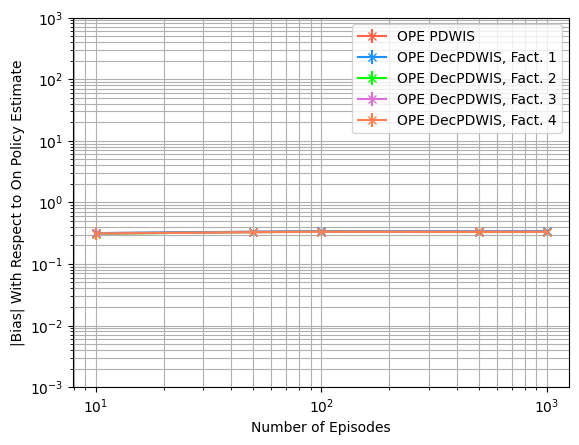

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.04571823 0.01183084 0.00648117 0.00101606 0.00052068]
OPE IS-----[0.44953015 0.06761164 0.04425173 0.02468716 0.0137419 ]
OPE DecIS, Fact. 1-----[0.33830737 0.30473859 0.10440219 0.04743818 0.04397548]
OPE DecIS, Fact. 2-----[1.47510475e+01 6.24300946e-01 2.09467841e-01 1.33957910e-02
 1.43283280e-01]
OPE DecIS, Fact. 3-----[7.1988531  0.35018517 0.10278824 0.04145221 0.01380641]
OPE DecIS, Fact. 4-----[0.2979657  0.2484601  0.07918331 0.01689949 0.01435088]


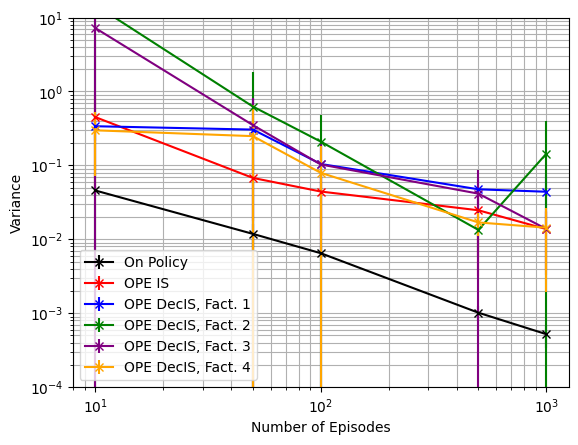

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**1, shorter_D, estimator='IS')

On Policy-----[0.04571823 0.01183084 0.00648117 0.00101606 0.00052068]
OPE PDIS-----[0.44953015 0.06761164 0.04425173 0.02468716 0.0137419 ]
OPE DecPDIS, Fact. 1-----[0.22401513 0.12954779 0.04792011 0.02898041 0.02762643]
OPE DecPDIS, Fact. 2-----[14.77173514  0.62736281  0.23061339  0.0191908   0.14822101]
OPE DecPDIS, Fact. 3-----[5.11747513 0.26242263 0.08880524 0.09530889 0.03108971]
OPE DecPDIS, Fact. 4-----[0.26686242 0.15002958 0.05212766 0.01204494 0.00759519]


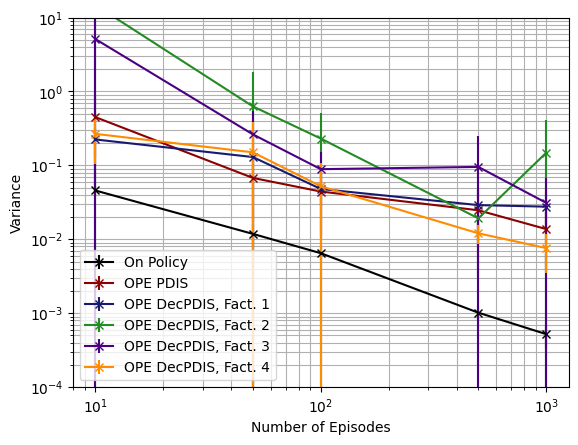

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**1, shorter_D, estimator='PDIS')

On Policy-----[0.04571823 0.01183084 0.00648117 0.00101606 0.00052068]
OPE PDWIS-----[4.77846847e-04 1.17903047e-04 8.45158449e-05 4.26212580e-05
 2.88023563e-05]
OPE DecPDWIS, Fact. 1-----[3.30590863e-04 5.76540380e-05 3.76501576e-05 2.53059707e-05
 2.64811724e-05]
OPE DecPDWIS, Fact. 2-----[6.41843546e-04 1.50990272e-04 1.19232427e-04 3.78070871e-05
 4.90703305e-05]
OPE DecPDWIS, Fact. 3-----[6.47505284e-04 1.50743586e-04 1.16582798e-04 7.49143289e-05
 5.12634398e-05]
OPE DecPDWIS, Fact. 4-----[4.27539577e-04 8.89571634e-05 5.59512898e-05 1.56074183e-05
 1.03147182e-05]


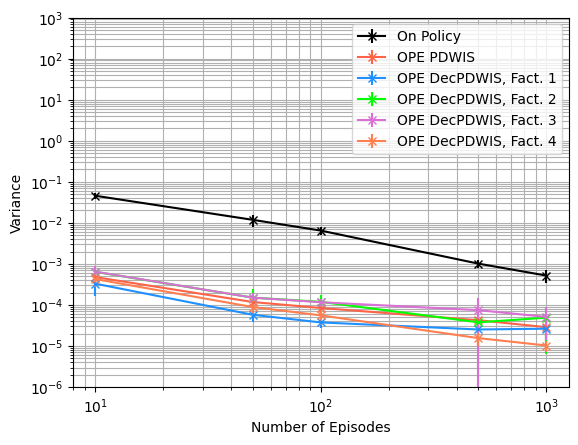

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.04571823 0.01183084 0.00648117 0.00101606 0.00052068]
OPE IS-----[0.46779794 0.06961014 0.04578802 0.02662452 0.01441795]
OPE DecIS, Fact. 1-----[0.44823184 0.48550816 0.23237126 0.20443896 0.20970636]
OPE DecIS, Fact. 2-----[1.55090438e+01 6.40620169e-01 2.17223844e-01 1.48508881e-02
 1.49164503e-01]
OPE DecIS, Fact. 3-----[7.58850057 0.38755626 0.11234372 0.04537628 0.01570718]
OPE DecIS, Fact. 4-----[0.36193734 0.34803968 0.14033871 0.08231135 0.08338752]


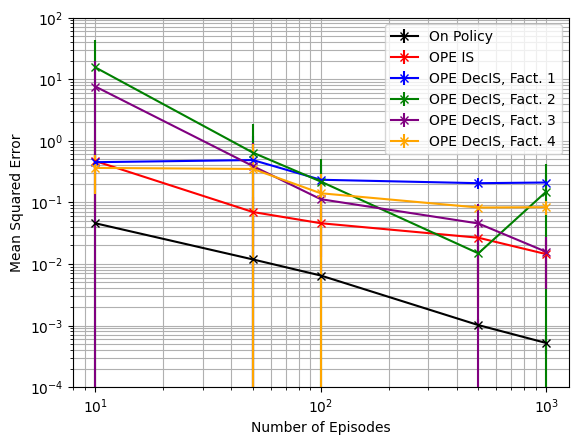

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**2, shorter_D, estimator='IS')

On Policy-----[0.04571823 0.01183084 0.00648117 0.00101606 0.00052068]
OPE PDIS-----[0.46779794 0.06961014 0.04578802 0.02662452 0.01441795]
OPE DecPDIS, Fact. 1-----[0.23415454 0.16216474 0.06056313 0.04903764 0.04800847]
OPE DecPDIS, Fact. 2-----[15.54385424  0.63213801  0.23405394  0.02901416  0.17279075]
OPE DecPDIS, Fact. 3-----[5.28877096 0.29542934 0.0992286  0.11400677 0.04420317]
OPE DecPDIS, Fact. 4-----[0.29259715 0.18632645 0.07194207 0.03963362 0.03551965]


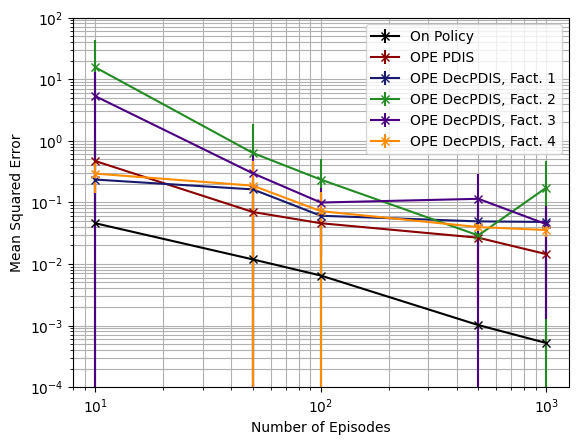

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**2, shorter_D, estimator='PDIS')

On Policy-----[0.04571823 0.01183084 0.00648117 0.00101606 0.00052068]
OPE PDWIS-----[0.10495908 0.11143396 0.11582488 0.11399359 0.1151619 ]
OPE DecPDWIS, Fact. 1-----[0.1051196  0.11110295 0.11471318 0.11267158 0.11362452]
OPE DecPDWIS, Fact. 2-----[0.10075589 0.10807208 0.11129882 0.10846987 0.10896503]
OPE DecPDWIS, Fact. 3-----[0.10268971 0.10749859 0.11242854 0.10962472 0.11031386]
OPE DecPDWIS, Fact. 4-----[0.10154618 0.10743812 0.11091922 0.10869643 0.10942261]


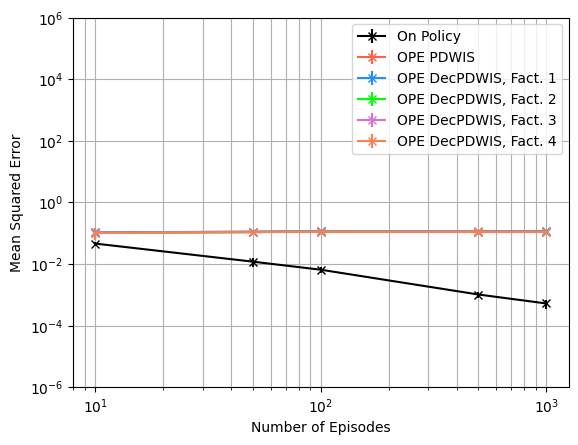

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[ 3.03071571 14.13071107 40.60396118 44.69751475 52.49792934]
OPE DecIS, Fact. 1-----[ 1.62442425  8.4401665  10.86110669 12.45217458 15.1016643 ]
OPE DecIS, Fact. 2-----[ 2.42890829 34.71443282 31.68228751 45.18207674 72.18309403]
OPE DecIS, Fact. 3-----[ 4.31232006 15.07747571 22.20610715 25.89120977 49.66498698]
OPE DecIS, Fact. 4-----[ 2.63719072 10.93919416 24.63420317 33.58217059 55.71826984]


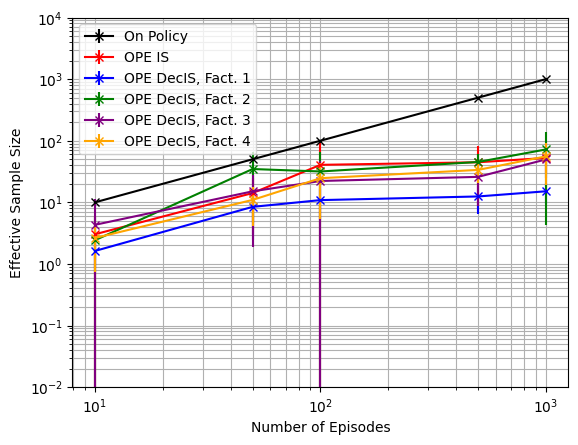

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-2), 10**4, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[ 3.03071571 14.13071107 40.60396118 44.69751475 52.49792934]
OPE DecPDIS, Fact. 1-----[ 2.59514146 16.67137709 18.43601133 24.8015391  23.40060092]
OPE DecPDIS, Fact. 2-----[ 0.91624342 18.69648601 17.21221004 33.24862227 53.50421244]
OPE DecPDIS, Fact. 3-----[ 2.70779712  9.64851758 13.58153928 22.80217529 29.08933113]
OPE DecPDIS, Fact. 4-----[ 2.34420892 16.0787779  24.52601671 48.11228482 86.30817871]


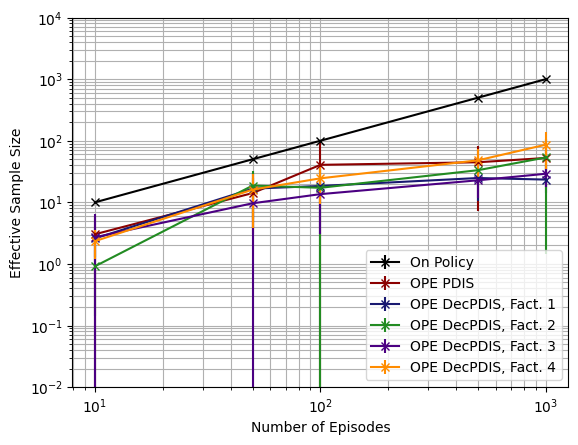

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-2), 10**4, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[ 1157.49712386  5940.59276398  9448.87760261 21295.1304522
 22815.86171743]
OPE DecPDWIS, Fact. 1-----[ 1862.30671688 10686.02802139 17616.03022524 26847.68213571
 21585.26210583]
OPE DecPDWIS, Fact. 2-----[  761.1100213   5135.30309258  6691.25770583 15963.18107144
 22079.85607927]
OPE DecPDWIS, Fact. 3-----[  929.48172452  4094.88278549  6278.81841947 12380.86286833
 13032.70028921]
OPE DecPDWIS, Fact. 4-----[ 1230.06447298  7077.32619042 12954.33063658 38216.51954044
 61558.12751408]


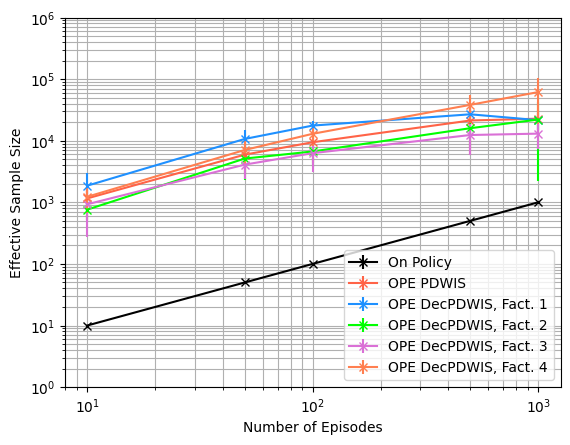

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**(6), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{20}$)



Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc
gc.collect()
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.5704785052636282. Variance of on policy Q estimate: 0.038890601164749246
Mean OPE IS estimate: -0.6013263758513658. Bias1: 0.03084787058773769. Bias2: 0.030847870587737636. Variance: 0.06448287323185939. MSE: 0.0654344643516572
Mean OPE PDIS estimate: -0.6013263758513658. Bias1: 0.03084787058773769. Bias2: 0.030847870587737636. Variance: 0.06448287323185939. MSE: 0.0654344643516572
Mean OPE PDWIS estimate: -0.028564225570519332. Bias1: 0.5419142796931088. Bias2: 0.5419142796931089. Variance: 0.0001028664434446781. MSE: 0.2937739529787457
Mean OPE DecIS: Fact. 1 estimate: -0.7344408471515791. Bias1: 0.163962341887951. Bias2: 0.1639623418879509. Variance: 0.06841388929472514. MSE: 0.09529753885210647
Mean OPE DecPDIS: Fact. 1 estimate: -0.6176444273815179. Bias1: 0.04716592211788976. Bias2: 0.047165922117889725. Variance: 0.062314160462586844. MSE: 0.06453878467181769
Mean OPE DecPDWIS: Fact. 1 estimate: -0

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.06031436 0.01095954 0.01320199 0.00382973 0.00867713]
OPE DecIS, Fact. 1-----[0.11480922 0.12561707 0.11634289 0.12168173 0.12070158]
OPE DecIS, Fact. 2-----[0.08779739 0.0749535  0.0832331  0.07320297 0.07472695]
OPE DecIS, Fact. 3-----[0.0582685  0.03338811 0.04594775 0.04008343 0.0414709 ]
OPE DecIS, Fact. 4-----[0.05803748 0.04241532 0.03269514 0.03723389 0.03637323]


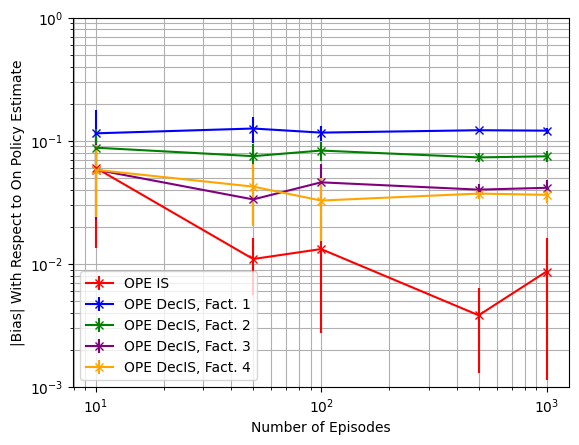

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.06031436 0.01095954 0.01320199 0.00382973 0.00867713]
OPE DecPDIS, Fact. 1-----[0.05779868 0.02420827 0.01490637 0.01013773 0.00919768]
OPE DecPDIS, Fact. 2-----[0.0562821  0.01959451 0.01324739 0.0060188  0.00666259]
OPE DecPDIS, Fact. 3-----[0.04690385 0.01275745 0.01591846 0.00443517 0.00597806]
OPE DecPDIS, Fact. 4-----[0.04821034 0.0215432  0.01605399 0.01216652 0.01103503]


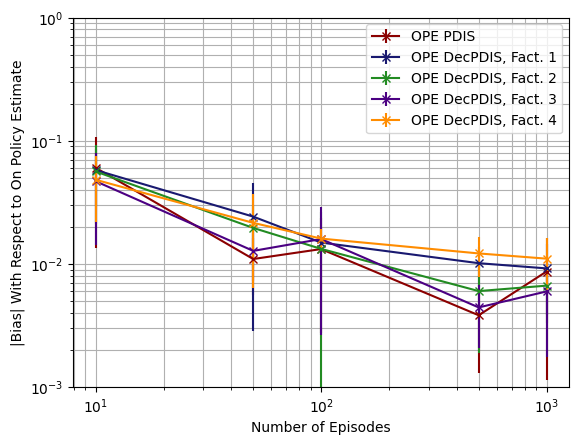

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.58972508 0.58803273 0.59029611 0.58940394 0.59174644]
OPE DecPDWIS, Fact. 1-----[0.59124431 0.58930388 0.59139511 0.59046409 0.59274287]
OPE DecPDWIS, Fact. 2-----[0.58749435 0.58598613 0.58796402 0.58676556 0.58902059]
OPE DecPDWIS, Fact. 3-----[0.58866557 0.58669133 0.58898799 0.58804946 0.59028645]
OPE DecPDWIS, Fact. 4-----[0.58873581 0.58704605 0.58907195 0.58810233 0.59033782]


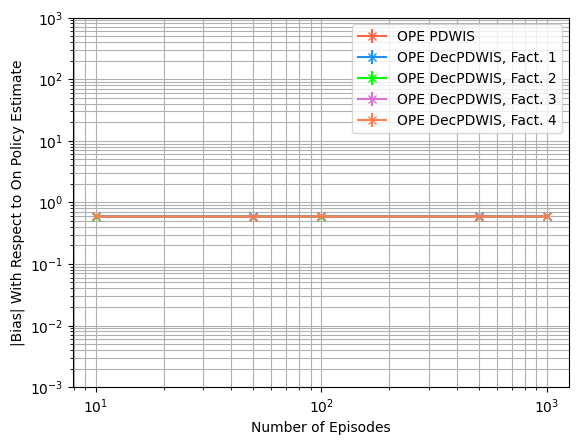

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.03237253 0.00970456 0.00470697 0.00058299 0.00027518]
OPE IS-----[0.07395951 0.01137361 0.00633999 0.00115219 0.00065928]
OPE DecIS, Fact. 1-----[0.08252933 0.01403649 0.00725978 0.00131287 0.00073939]
OPE DecIS, Fact. 2-----[0.08206548 0.0087657  0.00481433 0.00091223 0.00055235]
OPE DecIS, Fact. 3-----[0.09280208 0.00831627 0.00453329 0.00110448 0.00059892]
OPE DecIS, Fact. 4-----[0.06646052 0.00917018 0.00479165 0.00093008 0.00052098]


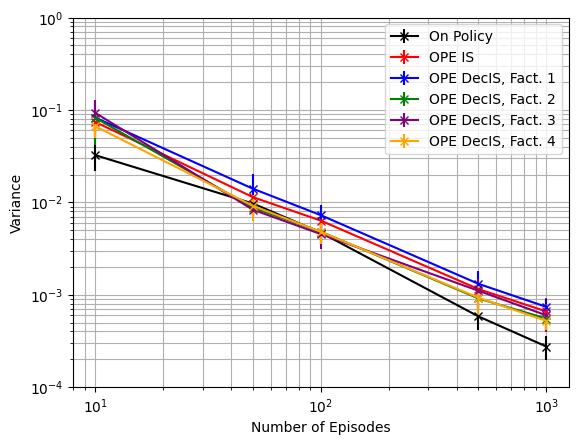

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

On Policy-----[0.03237253 0.00970456 0.00470697 0.00058299 0.00027518]
OPE PDIS-----[0.07395951 0.01137361 0.00633999 0.00115219 0.00065928]
OPE DecPDIS, Fact. 1-----[0.07298069 0.01187305 0.00626682 0.00115437 0.0006626 ]
OPE DecPDIS, Fact. 2-----[0.09431825 0.01104616 0.00607595 0.00116294 0.00069476]
OPE DecPDIS, Fact. 3-----[0.10046786 0.00985411 0.00523463 0.00123107 0.00066615]
OPE DecPDIS, Fact. 4-----[0.06972841 0.00947506 0.00495809 0.00098866 0.00055878]


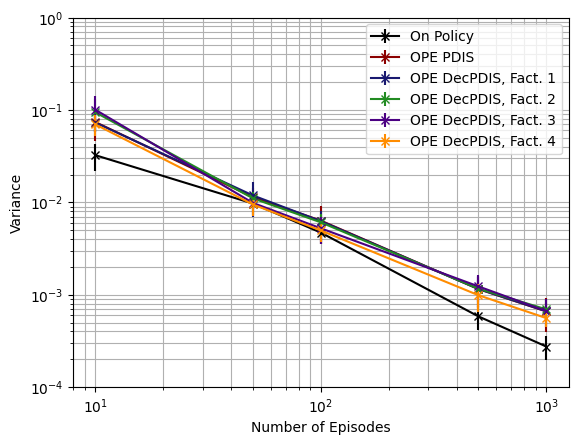

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.03237253 0.00970456 0.00470697 0.00058299 0.00027518]
OPE PDWIS-----[1.64928381e-04 2.64777548e-05 1.58786044e-05 2.64706688e-06
 1.69766019e-06]
OPE DecPDWIS, Fact. 1-----[1.32160829e-04 2.16666636e-05 1.24761891e-05 1.89926424e-06
 1.22773563e-06]
OPE DecPDWIS, Fact. 2-----[1.98677815e-04 3.18353930e-05 1.67735930e-05 2.94854570e-06
 1.93393571e-06]
OPE DecPDWIS, Fact. 3-----[1.82812533e-04 2.73994817e-05 1.52062818e-05 2.51349435e-06
 1.63563132e-06]
OPE DecPDWIS, Fact. 4-----[1.45921699e-04 2.40313093e-05 1.26131660e-05 2.07327307e-06
 1.31779267e-06]


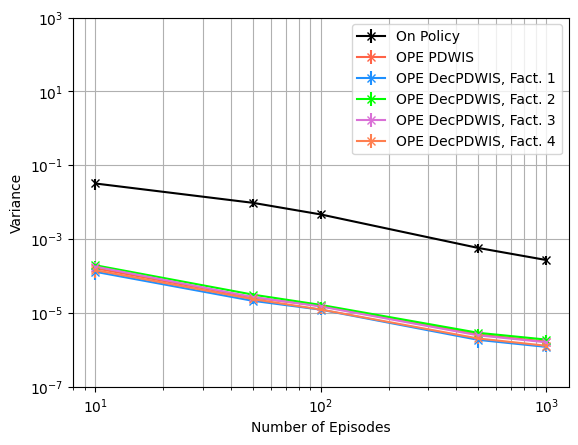

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.03237253 0.00970456 0.00470697 0.00058299 0.00027518]
OPE IS-----[0.07978121 0.011522   0.00662385 0.00117326 0.0007912 ]
OPE DecIS, Fact. 1-----[0.09958256 0.03071301 0.02105476 0.01613109 0.01534849]
OPE DecIS, Fact. 2-----[0.0911972  0.0147699  0.01197403 0.00630665 0.00618906]
OPE DecIS, Fact. 3-----[0.09745243 0.00959138 0.00701094 0.00273112 0.00236027]
OPE DecIS, Fact. 4-----[0.07099888 0.01145282 0.00616499 0.00232937 0.00187068]


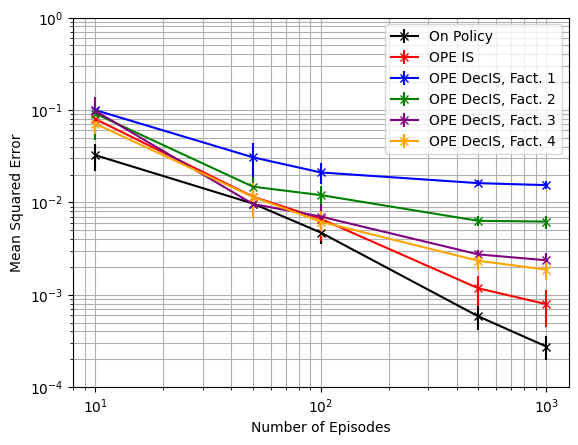

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

On Policy-----[0.03237253 0.00970456 0.00470697 0.00058299 0.00027518]
OPE PDIS-----[0.07978121 0.011522   0.00662385 0.00117326 0.0007912 ]
OPE DecPDIS, Fact. 1-----[0.07708555 0.01291512 0.00649481 0.00126999 0.0007761 ]
OPE DecPDIS, Fact. 2-----[0.09872391 0.01153733 0.00641943 0.00121625 0.00075017]
OPE DecPDIS, Fact. 3-----[0.10373251 0.0100474  0.00566351 0.00125626 0.0007197 ]
OPE DecPDIS, Fact. 4-----[0.07274867 0.01016876 0.00522658 0.00115522 0.00070784]


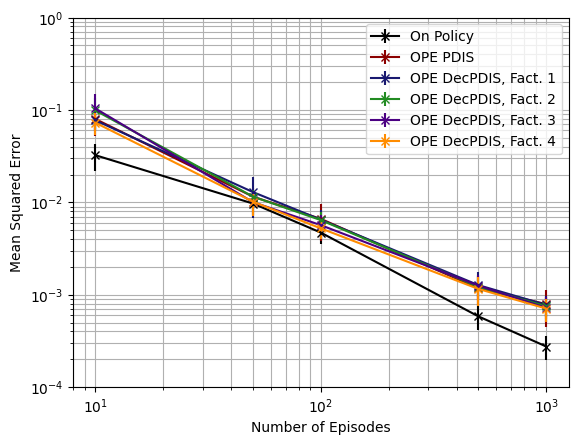

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.03237253 0.00970456 0.00470697 0.00058299 0.00027518]
OPE PDWIS-----[0.35035352 0.34597676 0.34857759 0.34740617 0.35018284]
OPE DecPDWIS, Fact. 1-----[0.35208549 0.34747442 0.34987373 0.34865631 0.35136163]
OPE DecPDWIS, Fact. 2-----[0.34766311 0.34358796 0.34583151 0.34430328 0.34696331]
OPE DecPDWIS, Fact. 3-----[0.34910805 0.34440471 0.34703578 0.34581131 0.34845613]
OPE DecPDWIS, Fact. 4-----[0.34912023 0.34481834 0.34713237 0.3458731  0.34851583]


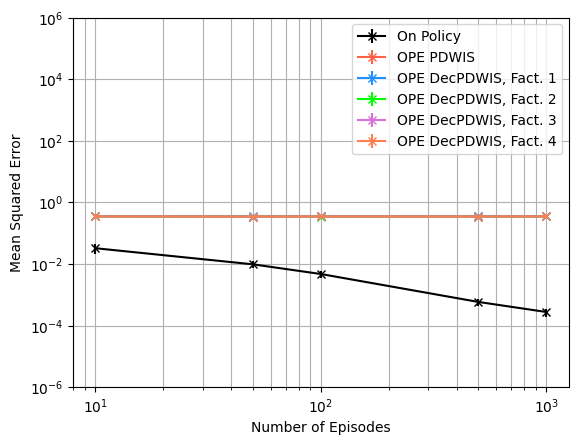

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[  4.61391143  45.17888044  93.25229082 301.40195412 469.76217131]
OPE DecIS, Fact. 1-----[  4.01729213  43.57812731  71.73216689 237.95091659 379.69099344]
OPE DecIS, Fact. 2-----[  4.51500703  60.95602022 103.88983051 327.0630856  530.11256015]
OPE DecIS, Fact. 3-----[  4.18138873  61.70327651 126.17694338 281.15343826 488.53916424]
OPE DecIS, Fact. 4-----[  5.18273783  60.96059171 110.75067263 331.96347775 541.66754128]


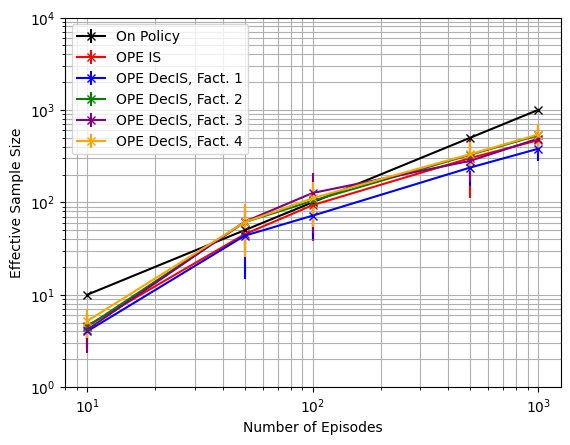

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**4, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[  4.61391143  45.17888044  93.25229082 301.40195412 469.76217131]
OPE DecPDIS, Fact. 1-----[  4.5074906   49.84045262  82.35080271 273.33249728 422.99133674]
OPE DecPDIS, Fact. 2-----[  3.68669329  47.08990863  84.87477391 260.95594146 420.46044665]
OPE DecPDIS, Fact. 3-----[  3.88909459  51.59950184 108.56295189 258.24808448 444.32018846]
OPE DecPDIS, Fact. 4-----[  4.93517798  55.99862316 107.66433375 318.80749309 504.2294349 ]


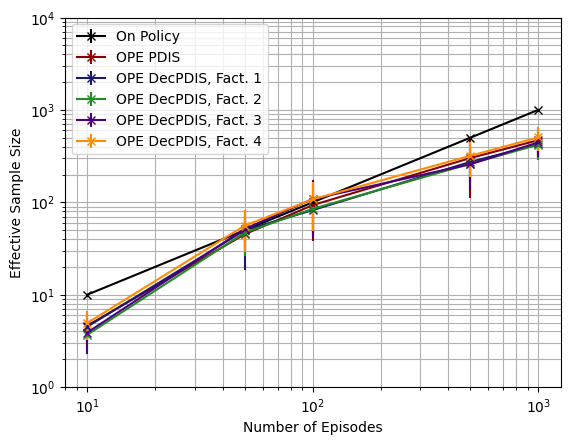

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**4, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[  2277.23930435  18443.90854157  33442.6727907  122756.82967
 177433.54031454]
OPE DecPDWIS, Fact. 1-----[  2817.99312908  24142.78003517  41898.59535446 170573.43614144
 237801.20493446]
OPE DecPDWIS, Fact. 2-----[  1700.11247329  15504.7959853   30001.91064116 108160.09811027
 155690.96058735]
OPE DecPDWIS, Fact. 3-----[  2026.27924751  17634.34847603  34020.52476074 121849.22284064
 187005.76725521]
OPE DecPDWIS, Fact. 4-----[  2523.7682912   20825.34069124  41993.29802383 154257.69995663
 224278.56500966]


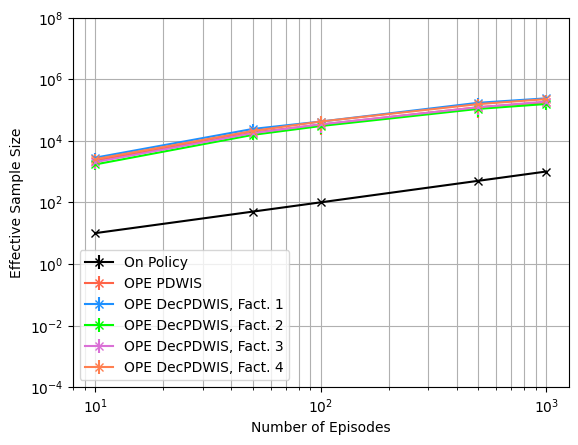

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

### Varying Episode Length $T$ With $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{T}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc

gc.collect()
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
LENGTHS = [1, 5, 10, 20]

bias_means = np.zeros((len(LENGTHS), 16))
bias_stds = np.zeros((len(LENGTHS), 16))
var_means = np.zeros((len(LENGTHS), 16))
var_stds = np.zeros((len(LENGTHS), 16))
MSE_means = np.zeros((len(LENGTHS), 16))
MSE_stds = np.zeros((len(LENGTHS), 16))
ESS_means = np.zeros((len(LENGTHS), 16))
ESS_stds = np.zeros((len(LENGTHS), 16))

RUNS = 100

for id in range(len(LENGTHS)):
  e = LENGTHS[id]
  print(f'{e} Steps, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

1 Steps, 100 ----------------------------------

Mean on policy Q estimate: -0.6291729607050353. Variance of on policy Q estimate: 0.3954192139580689
Mean OPE IS estimate: -0.6033980009621027. Bias1: 0.025774959742933413. Bias2: 0.025774959742932535. Variance: 0.7510725210430202. MSE: 0.7517368695927701
Mean OPE PDIS estimate: -0.6033980009621027. Bias1: 0.025774959742933413. Bias2: 0.025774959742932535. Variance: 0.7510725210430202. MSE: 0.7517368695927701
Mean OPE PDWIS estimate: -0.03361968264224279. Bias1: 0.5955532780627926. Bias2: 0.5955532780627925. Variance: 0.000767808830220099. MSE: 0.355451515841558
Mean OPE DecIS: Fact. 1 estimate: -0.6574545868220102. Bias1: 0.028281626116974077. Bias2: 0.028281626116974934. Variance: 0.8587715114064501. MSE: 0.8595713617822704
Mean OPE DecPDIS: Fact. 1 estimate: -0.5453993399719678. Bias1: 0.08377362073306784. Bias2: 0.08377362073306749. Variance: 0.8834102857524931. MSE: 0.890428305283221
Mean OPE DecPDWIS: Fact. 1 estimate: -0.029273172

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.03956975 0.02691965 0.02326746 0.01661845]
OPE DecIS, Fact. 1-----[0.1098612  0.11676758 0.12959653 0.11764527]
OPE DecIS, Fact. 2-----[0.1080608  0.07781608 0.07097404 0.08193072]
OPE DecIS, Fact. 3-----[0.06356387 0.04519998 0.03498569 0.04464537]
OPE DecIS, Fact. 4-----[0.05871161 0.04218601 0.05040116 0.03399752]


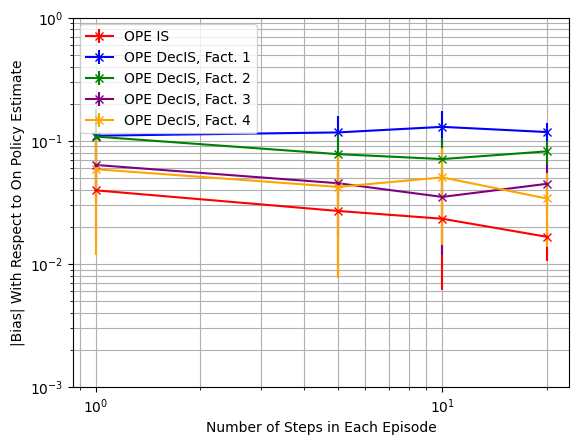

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.03956975 0.02691965 0.02326746 0.01661845]
OPE DecPDIS, Fact. 1-----[0.06438423 0.02883996 0.03354525 0.01522087]
OPE DecPDIS, Fact. 2-----[0.06797404 0.04155597 0.02817079 0.01775334]
OPE DecPDIS, Fact. 3-----[0.05098215 0.02870675 0.02291562 0.01835807]
OPE DecPDIS, Fact. 4-----[0.0599654  0.03500547 0.03379393 0.01525262]


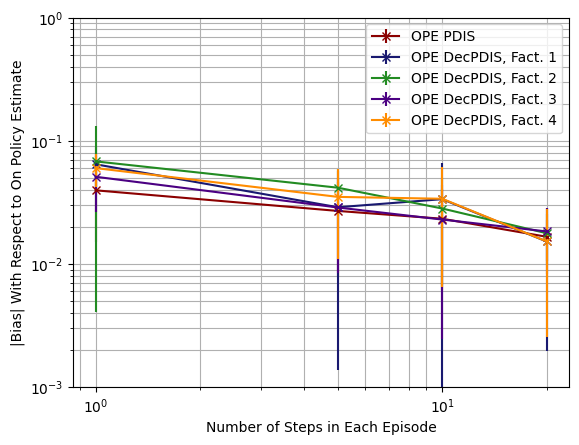

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.59779758 0.59278149 0.58388448 0.58888579]
OPE DecPDWIS, Fact. 1-----[0.60195749 0.59479921 0.58542692 0.5901427 ]
OPE DecPDWIS, Fact. 2-----[0.59621964 0.59074496 0.58183163 0.58658953]
OPE DecPDWIS, Fact. 3-----[0.59760732 0.59179053 0.58273213 0.58769027]
OPE DecPDWIS, Fact. 4-----[0.59930014 0.59245321 0.5831592  0.58782827]


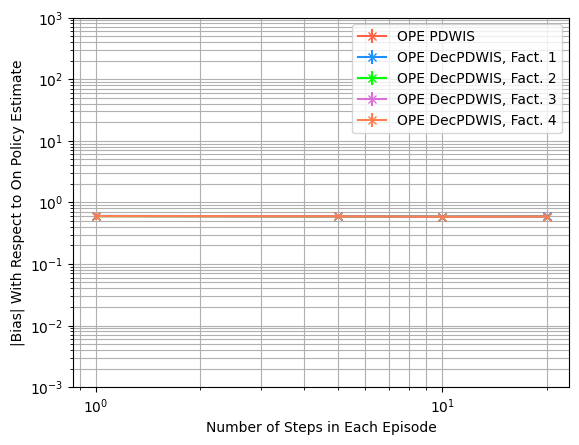

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.36694296 0.07611569 0.04184984 0.01940952]
OPE IS-----[0.73135275 0.13109173 0.06962622 0.03708813]
OPE DecIS, Fact. 1-----[0.74439993 0.14238789 0.07319004 0.03479915]
OPE DecIS, Fact. 2-----[1.12095097 0.12335082 0.05379732 0.02774216]
OPE DecIS, Fact. 3-----[0.7718323  0.12366798 0.05993732 0.03051407]
OPE DecIS, Fact. 4-----[0.58164406 0.1035043  0.05108253 0.0257328 ]


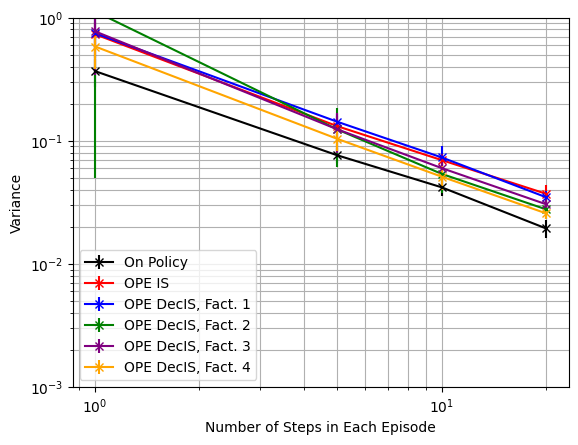

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

On Policy-----[0.36694296 0.07611569 0.04184984 0.01940952]
OPE PDIS-----[0.73135275 0.13109173 0.06962622 0.03708813]
OPE DecPDIS, Fact. 1-----[0.67304464 0.12740099 0.06433313 0.03117065]
OPE DecPDIS, Fact. 2-----[1.24628037 0.14959039 0.06628159 0.03528818]
OPE DecPDIS, Fact. 3-----[0.76562553 0.13736801 0.0672463  0.0346094 ]
OPE DecPDIS, Fact. 4-----[0.61813401 0.11158766 0.05449448 0.02841318]


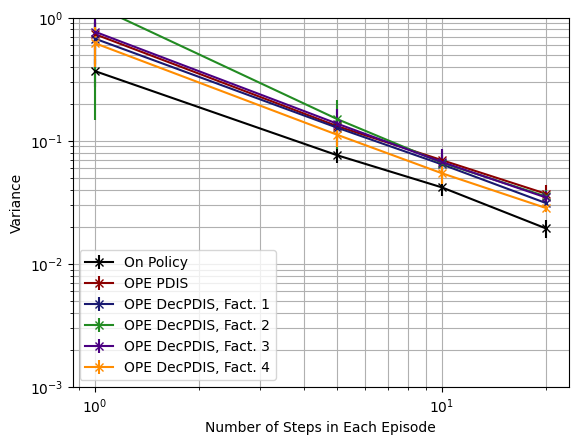

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.36694296 0.07611569 0.04184984 0.01940952]
OPE PDWIS-----[7.63207321e-04 2.65505175e-04 1.48260878e-04 8.26399875e-05]
OPE DecPDWIS, Fact. 1-----[7.53281352e-04 2.14834958e-04 1.10012325e-04 5.97716318e-05]
OPE DecPDWIS, Fact. 2-----[9.38165021e-04 3.11844777e-04 1.65680531e-04 9.17499185e-05]
OPE DecPDWIS, Fact. 3-----[8.35311733e-04 2.79276546e-04 1.46713745e-04 8.17101006e-05]
OPE DecPDWIS, Fact. 4-----[8.59759794e-04 2.40094711e-04 1.22541841e-04 6.74498447e-05]


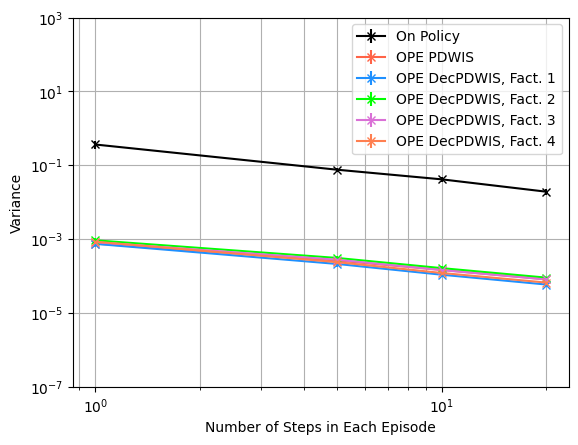

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.36694296 0.07611569 0.04184984 0.01940952]
OPE IS-----[0.73351524 0.13217491 0.07046225 0.03740146]
OPE DecIS, Fact. 1-----[0.76146776 0.15768485 0.09210608 0.0490617 ]
OPE DecIS, Fact. 2-----[1.13780504 0.13123662 0.06004658 0.03474515]
OPE DecIS, Fact. 3-----[0.77675936 0.12653358 0.06170088 0.03289665]
OPE DecIS, Fact. 4-----[0.58729051 0.10647397 0.05493454 0.0272976 ]


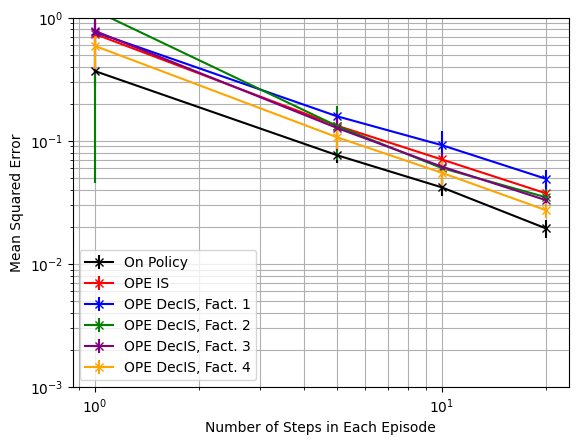

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

On Policy-----[0.36694296 0.07611569 0.04184984 0.01940952]
OPE PDIS-----[0.73351524 0.13217491 0.07046225 0.03740146]
OPE DecPDIS, Fact. 1-----[0.67780924 0.12898623 0.06653179 0.03157816]
OPE DecPDIS, Fact. 2-----[1.25498858 0.15160792 0.06753629 0.03566489]
OPE DecPDIS, Fact. 3-----[0.76882227 0.13860043 0.06819027 0.03504662]
OPE DecPDIS, Fact. 4-----[0.62206074 0.11338654 0.05638123 0.02880771]


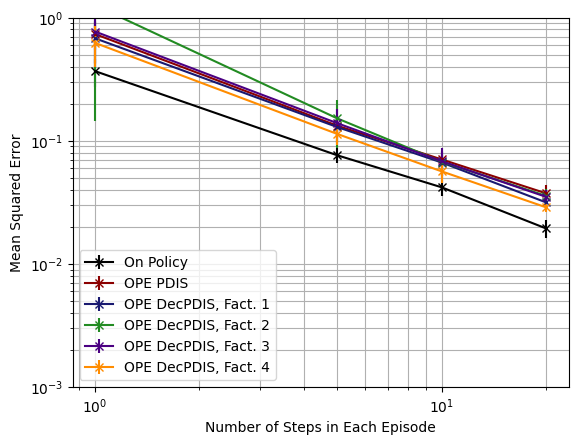

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.36694296 0.07611569 0.04184984 0.01940952]
OPE PDWIS-----[0.36376337 0.35270759 0.34182207 0.34701138]
OPE DecPDWIS, Fact. 1-----[0.36878983 0.35505165 0.34359911 0.3484721 ]
OPE DecPDWIS, Fact. 2-----[0.36209119 0.35036532 0.33945531 0.34432206]
OPE DecPDWIS, Fact. 3-----[0.36365518 0.35155511 0.34048247 0.34560347]
OPE DecPDWIS, Fact. 4-----[0.36571013 0.35231328 0.34096383 0.34575293]


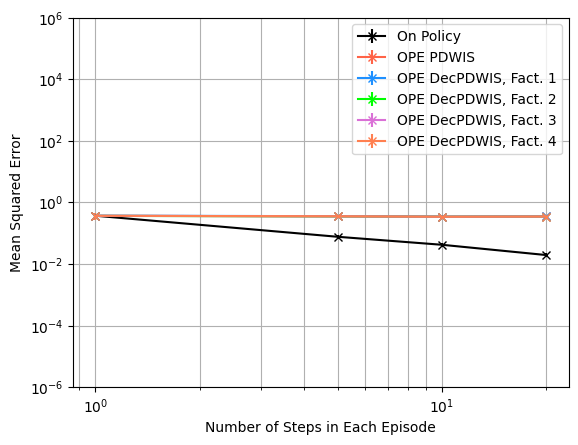

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[ 1.  5. 10. 20.]
OPE IS-----[ 0.52520279  3.03433207  5.98656663 10.76939842]
OPE DecIS, Fact. 1-----[ 0.53799881  2.71440417  5.91178375 11.1256044 ]
OPE DecIS, Fact. 2-----[ 0.50602927  3.59221047  8.14333232 14.39840718]
OPE DecIS, Fact. 3-----[ 0.58050659  3.43665515  7.40239714 12.76570532]
OPE DecIS, Fact. 4-----[ 0.68190677  3.8305592   8.46521905 15.03131734]


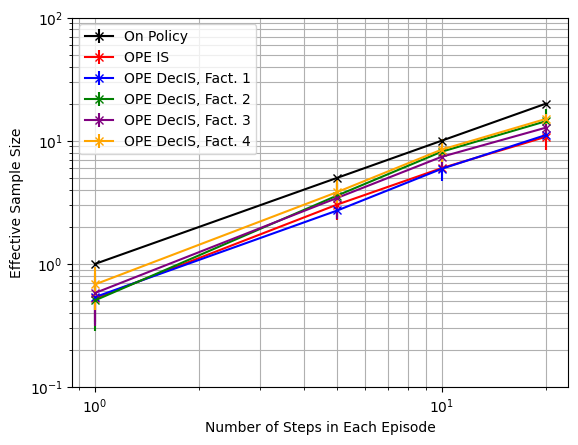

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-1), 10**2, shorter_D, estimator='IS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDIS-----[ 0.52520279  3.03433207  5.98656663 10.76939842]
OPE DecPDIS, Fact. 1-----[ 0.60063904  3.03100732  6.65191786 12.43498149]
OPE DecPDIS, Fact. 2-----[ 0.42826632  2.86316568  6.50500543 11.24583603]
OPE DecPDIS, Fact. 3-----[ 0.54512201  3.03788009  6.520474   11.28020578]
OPE DecPDIS, Fact. 4-----[ 0.64371869  3.54638348  7.82212913 13.60697801]


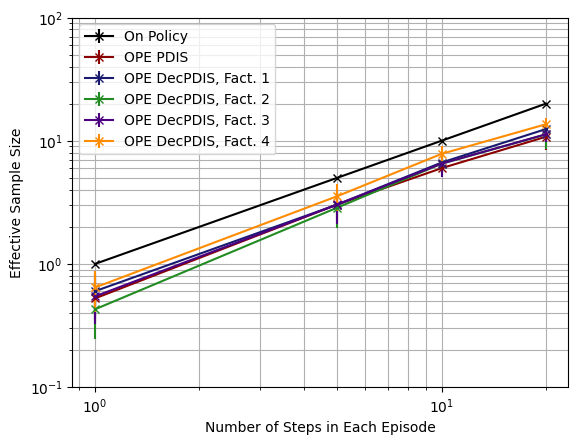

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-1), 10**2, shorter_D, estimator='PDIS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDWIS-----[ 476.90037298 1475.3121627  2813.51898842 4764.44562108]
OPE DecPDWIS, Fact. 1-----[ 486.41755459 1824.5758045  3810.79680806 6486.41534288]
OPE DecPDWIS, Fact. 2-----[ 389.83608901 1252.12295521 2535.36993735 4248.40894611]
OPE DecPDWIS, Fact. 3-----[ 437.04362709 1394.73365634 2876.65943326 4776.94611319]
OPE DecPDWIS, Fact. 4-----[ 425.99723305 1624.98665899 3420.95814596 5743.16952774]


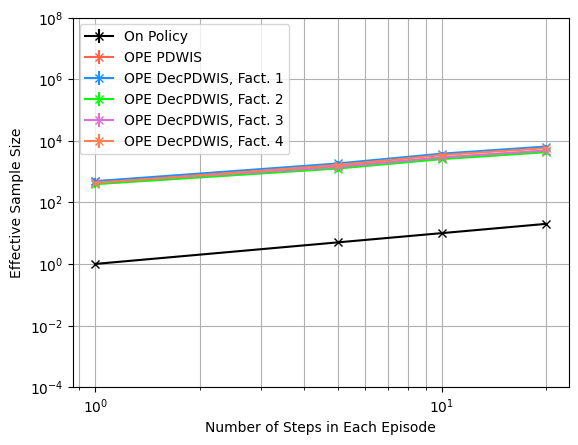

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

## From Patient State 696, Without Diabetes

In [ ]:
#The patient has no diabetes
PROB_DIAB = 0.0

### State Analysis

In [ ]:
#Instantiate a state based on the idx and get the state vector
testState = State(state_idx = 696, diabetic_idx=0)
vec = testState.get_state_vector()

print(vec)
print(f'Num abnormals: {testState.get_num_abnormal()}\n')

print(f'Heart Rate: {hr_state_mapping[vec[0]]}')
print(f'Systolic Blood Pressure: {sbp_state_mapping[vec[1]]}')
print(f'Percent Oxygen: {o2_state_mapping[vec[2]]}')
print(f'Glucose Level: {glu_state_mapping[vec[3]]}')
print(f'Antibiotics: {abx_state_mapping[vec[4]]}')
print(f'Vasopressors: {vaso_state_mapping[vec[5]]}')
print(f'Ventilator: {vent_state_mapping[vec[6]]}')
print(f'Diabetes: {testState.diabetic_idx}')

[2 2 1 2 0 0 0]
Num abnormals: 2

Heart Rate: High
Systolic Blood Pressure: High
Percent Oxygen: Normal
Glucose Level: Normal
Antibiotics: Off
Vasopressors: Off
Ventilator: Off
Diabetes: 0


### Generate Data From Behaviour Policy

Run the data generator

In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=randPol, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

Convert data into array format

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_b = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_b.shape

(100000, 20, 5)

In [ ]:
f_tr_b1, f_tr_b2, f_tr_b3, f_tr_b4 = factorise_dataset(nf_tr_b)

In [ ]:
print(nf_tr_b)

[[[  0. 696.   0.  -1. 648.]
  [  1. 648.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 696.   3.   0. 699.]
  [  1. 699.   5.   0. 422.]
  [  2. 422.   3.   0. 459.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 696.   4.   0. 620.]
  [  1. 620.   0.   0. 616.]
  [  2. 616.   2.   0. 697.]
  ...
  [ 17. 410.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 ...

 [[  0. 696.   6.   0. 461.]
  [  1. 461.   4.   0. 380.]
  [  2. 380.   7.   0. 463.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 696.   0.   0. 696.]
  [  1. 696.   0.   0. 696.]
  [  2. 696.   6.   0. 461.]
  ...
  [ 17. 449.   7.   0. 455.]
  [ 18. 455.   2.   0. 449.]
  [ 19. 449.   0.   0. 448.]]

 [[  0. 696.   7.   0. 703.]
  [  1. 703.   1.   0. 698.]
  [  2. 698.   7.   0. 703

In [ ]:
print(f_tr_b1)

[[[[ 0.00e+00  6.96e+02  0.00e+00 -5.00e-01  6.48e+02]
   [ 0.00e+00  6.96e+02  0.00e+00 -5.00e-01  6.48e+02]]

  [[ 1.00e+00  6.48e+02  1.00e+00  0.00e+00 -1.00e+00]
   [ 1.00e+00  6.48e+02 -1.00e+00  0.00e+00 -1.00e+00]]

  [[ 2.00e+00 -1.00e+00  1.00e+00  0.00e+00 -1.00e+00]
   [ 2.00e+00 -1.00e+00 -1.00e+00  0.00e+00 -1.00e+00]]

  ...

  [[ 1.70e+01 -1.00e+00  1.00e+00  0.00e+00 -1.00e+00]
   [ 1.70e+01 -1.00e+00 -1.00e+00  0.00e+00 -1.00e+00]]

  [[ 1.80e+01 -1.00e+00  1.00e+00  0.00e+00 -1.00e+00]
   [ 1.80e+01 -1.00e+00 -1.00e+00  0.00e+00 -1.00e+00]]

  [[ 1.90e+01 -1.00e+00  1.00e+00  0.00e+00 -1.00e+00]
   [ 1.90e+01 -1.00e+00 -1.00e+00  0.00e+00 -1.00e+00]]]


 [[[ 0.00e+00  6.96e+02  1.00e+00  0.00e+00  6.99e+02]
   [ 0.00e+00  6.96e+02  1.00e+00  0.00e+00  6.99e+02]]

  [[ 1.00e+00  6.99e+02  0.00e+00  0.00e+00  4.22e+02]
   [ 1.00e+00  6.99e+02  3.00e+00  0.00e+00  4.22e+02]]

  [[ 2.00e+00  4.22e+02  1.00e+00  0.00e+00  4.59e+02]
   [ 2.00e+00  4.22e+02  1.00e+00  0.00e

In [ ]:
factored_randPol1 = factor_policy_1(randPol)
factored_randPol2 = factor_policy_2(randPol)
factored_randPol3 = factor_policy_3(randPol)
factored_randPol4 = factor_policy_4(randPol)

In [ ]:
randPol = pad_policy(randPol)

factored_randPol1[0] = pad_policy(factored_randPol1[0])
factored_randPol1[1] = pad_policy(factored_randPol1[1])

factored_randPol2[0] = pad_policy(factored_randPol2[0])
factored_randPol2[1] = pad_policy(factored_randPol2[1])

factored_randPol3[0] = pad_policy(factored_randPol3[0])
factored_randPol3[1] = pad_policy(factored_randPol3[1])

factored_randPol4[0] = pad_policy(factored_randPol4[0])
factored_randPol4[1] = pad_policy(factored_randPol4[1])
factored_randPol4[2] = pad_policy(factored_randPol4[2])

### Varying Episodes $\epsilon_{e} = 0.4$ (Policy Divergence $4.8^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
EVAL_EPSILON = 0.4

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

4.8


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.0595811951275803. Variance of on policy Q estimate: 0.06963633891624262
Mean OPE IS estimate: 0.3049230770742117. Bias1: 0.36450427220179266. Bias2: 0.364504272201792. Variance: 5.995477667393267. MSE: 6.128341031846626
Mean OPE PDIS estimate: 0.3049230770742117. Bias1: 0.36450427220179266. Bias2: 0.364504272201792. Variance: 5.995477667393267. MSE: 6.128341031846626
Mean OPE PDWIS estimate: -0.012313509387380815. Bias1: 0.047267685740199475. Bias2: 0.04726768574019948. Variance: 0.0003835555927560769. MSE: 0.002617789707990334
Mean OPE DecIS: Fact. 1 estimate: -0.2604380058716186. Bias1: 0.20085681074403822. Bias2: 0.20085681074403827. Variance: 0.3148282651018138. MSE: 0.35517172352408016
Mean OPE DecPDIS: Fact. 1 estimate: -0.10360468894674475. Bias1: 0.04402349381916428. Bias2: 0.044023493819164455. Variance: 0.24469473426732993. MSE: 0.24663280227537593
Mean OPE DecPDWIS: Fact. 1 estimate: -0.0075592

#### Plot Graphs

##### Plot Bias

OPE IS-----[2.55139175 0.58655425 0.36136261 0.14114651 0.11420325]
OPE DecIS, Fact. 1-----[0.28968001 0.38044983 0.74364595 0.5057005  0.52436628]
OPE DecIS, Fact. 2-----[0.23359774 0.2399549  0.21422871 0.25545997 0.25198986]
OPE DecIS, Fact. 3-----[0.49873264 0.24653101 0.22133332 0.28536846 0.31042919]
OPE DecIS, Fact. 4-----[0.31506582 0.42571833 0.50439903 0.5031396  0.55480741]


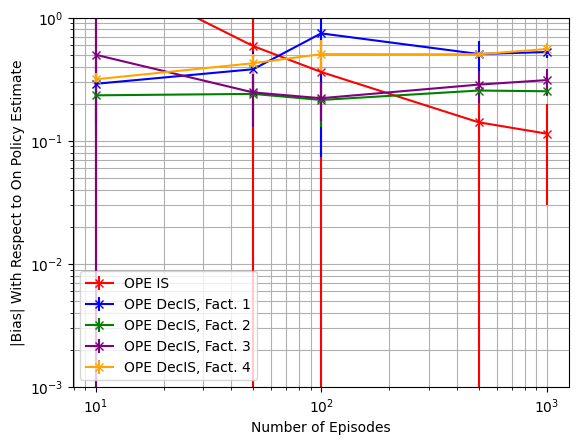

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**-3, 10**0, shorter_D, estimator='IS')

OPE PDIS-----[2.55139175 0.58655425 0.36136261 0.14114651 0.11420325]
OPE DecPDIS, Fact. 1-----[0.21220297 0.21204559 0.46849015 0.27065561 0.26950229]
OPE DecPDIS, Fact. 2-----[0.23097833 0.16658091 0.14625864 0.1844256  0.16957572]
OPE DecPDIS, Fact. 3-----[0.50214465 0.15943736 0.14351582 0.16303945 0.2335279 ]
OPE DecPDIS, Fact. 4-----[0.1664858  0.23118182 0.27564845 0.29908677 0.32995532]


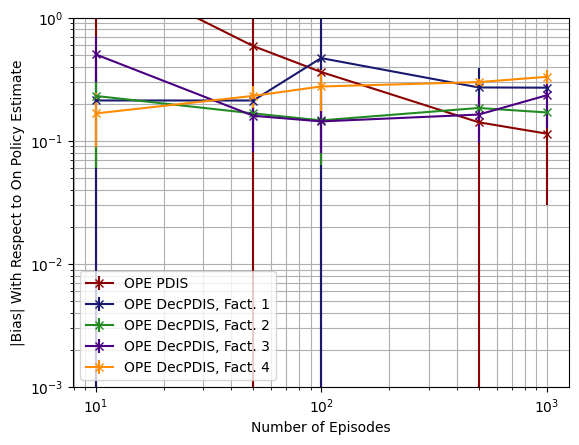

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.04519143 0.06192711 0.05652626 0.06234765 0.0593057 ]
OPE DecPDWIS, Fact. 1-----[0.04772349 0.0661389  0.06223059 0.07121654 0.0688304 ]
OPE DecPDWIS, Fact. 2-----[0.04707327 0.06690738 0.06042383 0.07045957 0.06650318]
OPE DecPDWIS, Fact. 3-----[0.04781011 0.06639432 0.06092096 0.06960979 0.06823835]
OPE DecPDWIS, Fact. 4-----[0.04815343 0.06868386 0.06440796 0.07466656 0.07240429]


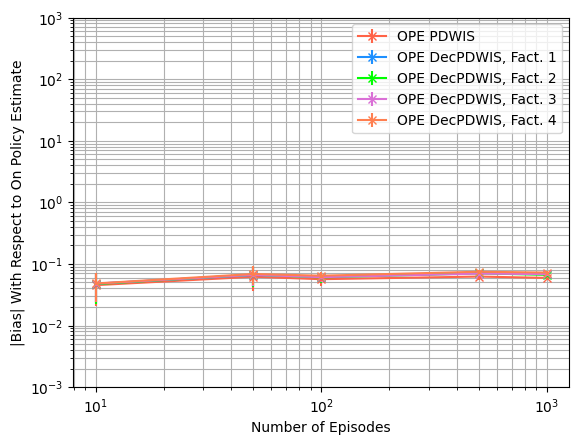

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.05815982 0.01088637 0.00475979 0.00127698 0.00054947]
OPE IS-----[5.70248685e+02 2.31500810e+01 6.01809683e+00 1.38447903e+00
 4.72577554e-01]
OPE DecIS, Fact. 1-----[2.3897652  0.21980501 5.7504908  0.30468858 0.12454259]
OPE DecIS, Fact. 2-----[2.28073031 0.22200429 0.10478596 0.0450802  0.02953063]
OPE DecIS, Fact. 3-----[10.38020617  0.43132963  0.13042336  0.37768346  0.23044009]
OPE DecIS, Fact. 4-----[0.19389591 0.05708079 0.58661301 0.07923627 0.10589939]


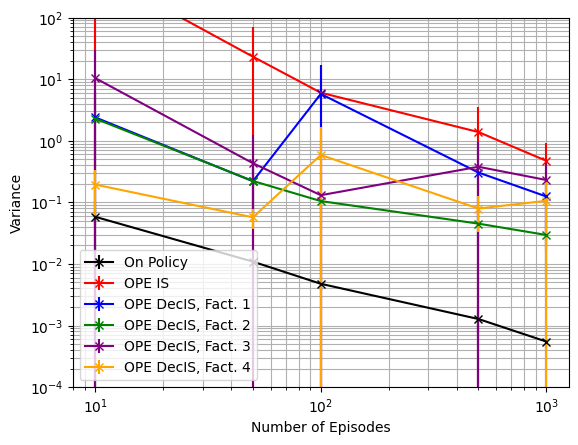

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**2, shorter_D, estimator='IS')

On Policy-----[0.05815982 0.01088637 0.00475979 0.00127698 0.00054947]
OPE PDIS-----[5.70248685e+02 2.31500810e+01 6.01809683e+00 1.38447903e+00
 4.72577554e-01]
OPE DecPDIS, Fact. 1-----[2.82317528 0.20773322 5.00115298 0.27389691 0.1021955 ]
OPE DecPDIS, Fact. 2-----[2.50242711 0.21470482 0.10985808 0.02985096 0.02478547]
OPE DecPDIS, Fact. 3-----[5.09053238 0.2890244  0.10409561 0.21444179 0.19515717]
OPE DecPDIS, Fact. 4-----[0.31263731 0.05250912 0.19905577 0.04686468 0.08484693]


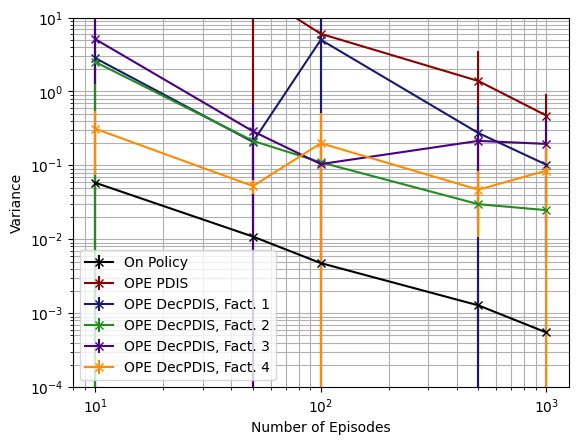

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**1, shorter_D, estimator='PDIS')

On Policy-----[0.05815982 0.01088637 0.00475979 0.00127698 0.00054947]
OPE PDWIS-----[0.00047766 0.00029921 0.00026005 0.00020624 0.00017582]
OPE DecPDWIS, Fact. 1-----[2.73716958e-04 1.45906768e-04 1.83952871e-04 1.01027911e-04
 8.95193347e-05]
OPE DecPDWIS, Fact. 2-----[5.45761089e-04 1.88991499e-04 1.64232329e-04 6.49312283e-05
 5.51663252e-05]
OPE DecPDWIS, Fact. 3-----[0.00052801 0.00030916 0.00017771 0.00016697 0.00012711]
OPE DecPDWIS, Fact. 4-----[3.54115869e-04 1.15909611e-04 8.22730672e-05 4.30829640e-05
 4.80602138e-05]


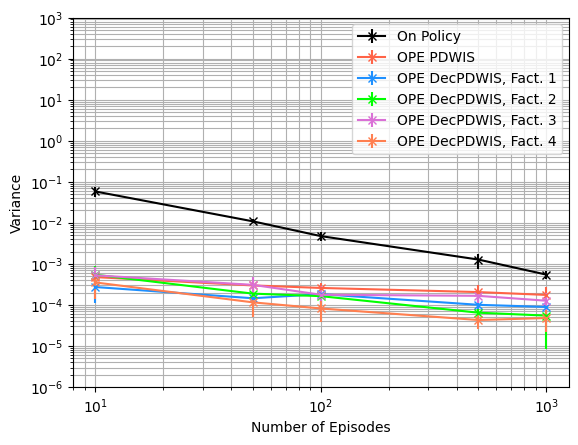

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.05815982 0.01088637 0.00475979 0.00127698 0.00054947]
OPE IS-----[6.00119082e+02 2.44018436e+01 6.34536078e+00 1.42939969e+00
 4.92657667e-01]
OPE DecIS, Fact. 1-----[2.4959593  0.38913343 6.75158294 0.57922651 0.40275166]
OPE DecIS, Fact. 2-----[2.35058291 0.29137504 0.15791676 0.11090078 0.09356212]
OPE DecIS, Fact. 3-----[10.98964651  0.50568851  0.18531638  0.46588206  0.33239327]
OPE DecIS, Fact. 4-----[0.29457527 0.24430693 0.86299455 0.33282719 0.41745909]


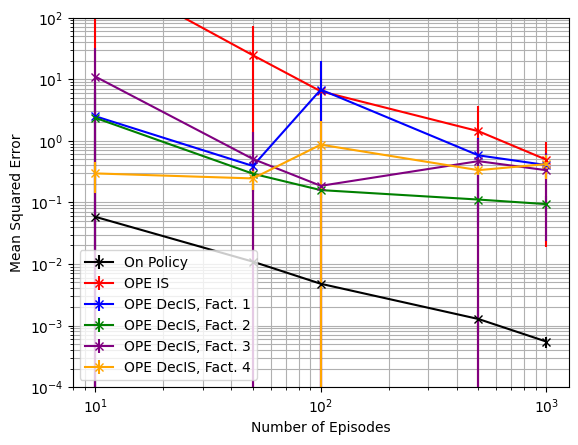

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**2, shorter_D, estimator='IS')

On Policy-----[0.05815982 0.01088637 0.00475979 0.00127698 0.00054947]
OPE PDIS-----[6.00119082e+02 2.44018436e+01 6.34536078e+00 1.42939969e+00
 4.92657667e-01]
OPE DecPDIS, Fact. 1-----[2.93508359 0.25486775 5.57227468 0.36045428 0.17670001]
OPE DecPDIS, Fact. 2-----[2.58491071 0.24885307 0.13804362 0.06478899 0.05528408]
OPE DecPDIS, Fact. 3-----[5.38436291 0.32066841 0.12869947 0.24560229 0.26106883]
OPE DecPDIS, Fact. 4-----[0.34647614 0.10818191 0.28526179 0.13656452 0.19545273]


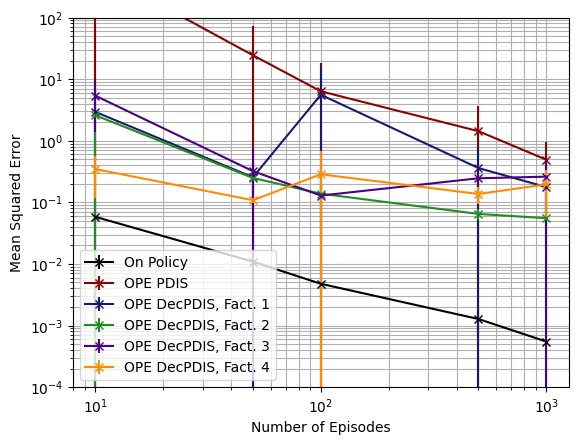

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**2, shorter_D, estimator='PDIS')

On Policy-----[0.05815982 0.01088637 0.00475979 0.00127698 0.00054947]
OPE PDWIS-----[0.00311528 0.00481178 0.00362797 0.0041464  0.00370112]
OPE DecPDWIS, Fact. 1-----[0.00314981 0.00511449 0.00419601 0.00519278 0.0048426 ]
OPE DecPDWIS, Fact. 2-----[0.0033654  0.00523892 0.00393252 0.00508348 0.0045037 ]
OPE DecPDWIS, Fact. 3-----[0.00335856 0.0052509  0.00399996 0.00505452 0.00479409]
OPE DecPDWIS, Fact. 4-----[0.00324139 0.00537375 0.00433679 0.0056578  0.00530668]


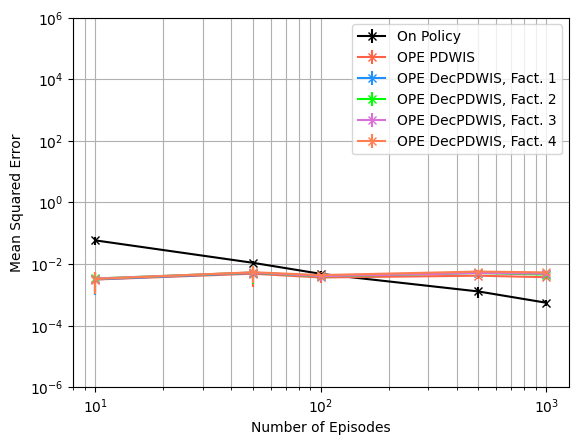

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[ 5.34168732  8.51766355  6.01591415 15.25765282  5.28820826]
OPE DecIS, Fact. 1-----[ 1.85751961  4.65529119  4.79120804 20.4921562  10.26632981]
OPE DecIS, Fact. 2-----[ 4.73331398  5.24289887  5.62703216 17.51531779 31.59867385]
OPE DecIS, Fact. 3-----[ 1.53422036 23.88833399 15.26694019 11.30487553 11.39555634]
OPE DecIS, Fact. 4-----[ 3.79863436 10.83883395 11.60163171 16.58563301 13.80925864]


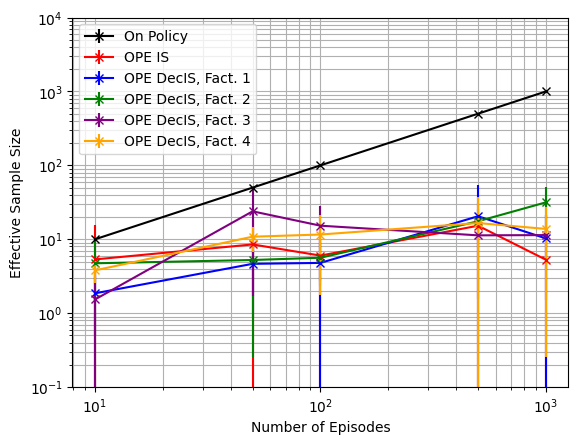

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-1), 10**4, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[ 5.34168732  8.51766355  6.01591415 15.25765282  5.28820826]
OPE DecPDIS, Fact. 1-----[ 2.37968748  5.70440308  5.83386607 24.58838293 17.86741449]
OPE DecPDIS, Fact. 2-----[ 4.95657226  7.79765891  8.49899767 25.06825301 42.88102494]
OPE DecPDIS, Fact. 3-----[ 1.29514392 12.55816488 12.32697014  8.03965711 10.17728604]
OPE DecPDIS, Fact. 4-----[ 3.66700294 10.95371416 11.79507857 27.69154397 20.21874222]


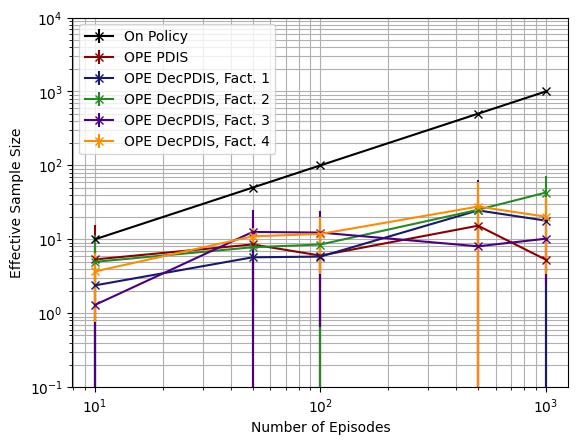

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-1), 10**4, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[1535.37019533 2240.15201502 2049.4034858  4480.60896815 3751.01942503]
OPE DecPDWIS, Fact. 1-----[ 3414.47403028  4294.51966033  3507.80351415 11226.81251663
 10223.12076814]
OPE DecPDWIS, Fact. 2-----[ 2159.91626806  3779.31444503  3231.48749859 10945.56393227
 19111.58050191]
OPE DecPDWIS, Fact. 3-----[2340.29001509 2580.79205723 4472.83926837 3948.84423766 5621.04327788]
OPE DecPDWIS, Fact. 4-----[ 3050.89751191  6418.05605036  6828.05978904 20526.25434836
 14760.9897204 ]


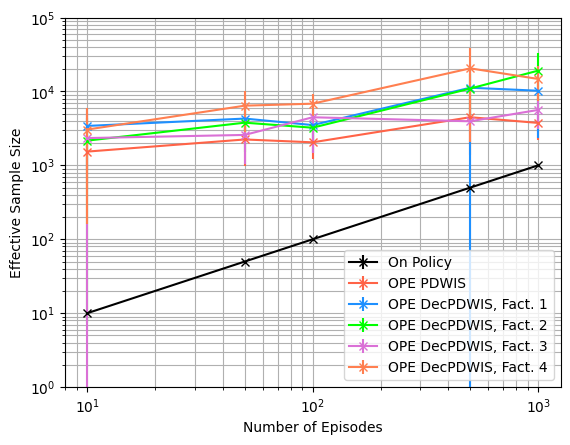

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**(5), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.6$ (Policy Divergence $3.2^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc

gc.collect()
EVAL_EPSILON = 0.6

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

3.2


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.16391803996347812. Variance of on policy Q estimate: 0.0542607292761864
Mean OPE IS estimate: -0.26757231960177563. Bias1: 0.10365427963829796. Bias2: 0.10365427963829751. Variance: 0.8580029283266717. MSE: 0.8687471380140062
Mean OPE PDIS estimate: -0.26757231960177563. Bias1: 0.10365427963829796. Bias2: 0.10365427963829751. Variance: 0.8580029283266717. MSE: 0.8687471380140062
Mean OPE PDWIS estimate: -0.016824222462722808. Bias1: 0.14709381750075531. Bias2: 0.14709381750075531. Variance: 0.00036166168570157575. MSE: 0.021998252832647083
Mean OPE DecIS: Fact. 1 estimate: -0.5177546085411607. Bias1: 0.35383656857768236. Bias2: 0.35383656857768264. Variance: 0.39068147262174086. MSE: 0.5158817898845698
Mean OPE DecPDIS: Fact. 1 estimate: -0.3388617192427244. Bias1: 0.17494367927924626. Bias2: 0.17494367927924628. Variance: 0.2725034254631686. MSE: 0.30310871638292836
Mean OPE DecPDWIS: Fact. 1 estimate: -

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.40692636 0.16399736 0.09857208 0.0332087  0.04131996]
OPE DecIS, Fact. 1-----[0.18511796 0.26122494 0.54079222 0.34796562 0.34987192]
OPE DecIS, Fact. 2-----[0.0567637  0.09784648 0.06474305 0.08537404 0.08986562]
OPE DecIS, Fact. 3-----[0.24544308 0.0934047  0.0858087  0.11514413 0.12945718]
OPE DecIS, Fact. 4-----[0.13840572 0.23457914 0.28078013 0.28751323 0.31177488]


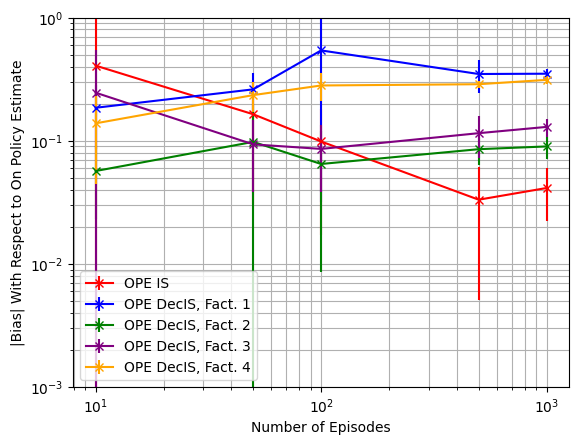

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.40692636 0.16399736 0.09857208 0.0332087  0.04131996]
OPE DecPDIS, Fact. 1-----[0.19804235 0.09878614 0.32596265 0.13767564 0.13246304]
OPE DecPDIS, Fact. 2-----[0.07605303 0.08618792 0.05362854 0.067031   0.06605592]
OPE DecPDIS, Fact. 3-----[0.20360752 0.06915594 0.04173629 0.0630899  0.09695316]
OPE DecPDIS, Fact. 4-----[0.08151624 0.08152102 0.11926161 0.13509122 0.15096249]


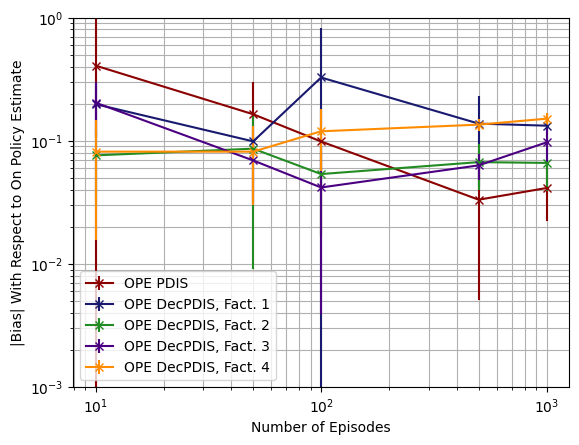

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.22939377 0.20386647 0.19039774 0.19010431 0.19075642]
OPE DecPDWIS, Fact. 1-----[0.22945268 0.20229318 0.18820839 0.18624962 0.18707945]
OPE DecPDWIS, Fact. 2-----[0.22856815 0.20072812 0.18904191 0.186028   0.18746092]
OPE DecPDWIS, Fact. 3-----[0.22909702 0.20164593 0.18881761 0.1868024  0.18660156]
OPE DecPDWIS, Fact. 4-----[0.22827675 0.20006298 0.18687702 0.18410412 0.18482745]


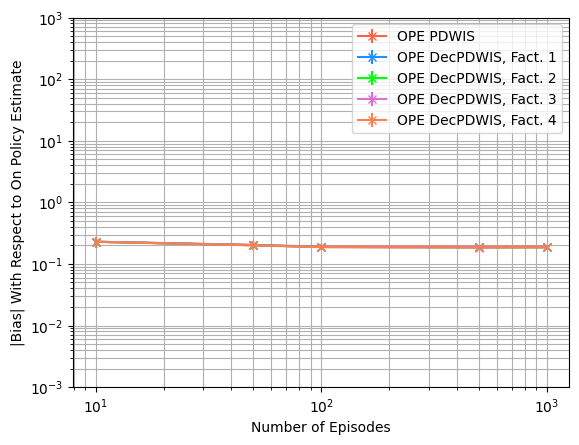

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.06379992 0.01250106 0.00634494 0.00099478 0.00062408]
OPE IS-----[10.30487739  0.66678996  0.25169922  0.078148    0.04970797]
OPE DecIS, Fact. 1-----[0.58233962 0.11670174 4.4865195  0.19164603 0.06563334]
OPE DecIS, Fact. 2-----[0.35300724 0.10477134 0.04052644 0.01861661 0.00998815]
OPE DecIS, Fact. 3-----[3.79799593 0.17837107 0.07575606 0.10257874 0.03484004]
OPE DecIS, Fact. 4-----[0.1592872  0.04132446 0.10999027 0.01997156 0.01676712]


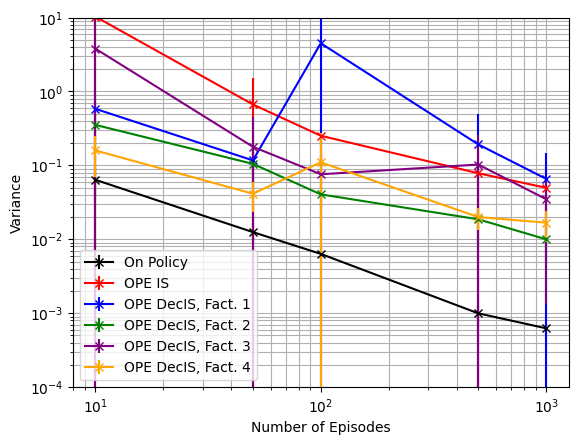

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**1, shorter_D, estimator='IS')

On Policy-----[0.06379992 0.01250106 0.00634494 0.00099478 0.00062408]
OPE PDIS-----[10.30487739  0.66678996  0.25169922  0.078148    0.04970797]
OPE DecPDIS, Fact. 1-----[0.65303343 0.10553842 4.39820111 0.185145   0.06064178]
OPE DecPDIS, Fact. 2-----[0.41088555 0.10703261 0.0416436  0.01614596 0.00980749]
OPE DecPDIS, Fact. 3-----[1.29759026 0.11623343 0.0651193  0.05345083 0.02660052]
OPE DecPDIS, Fact. 4-----[0.17518732 0.03861357 0.05128652 0.013286   0.01289817]


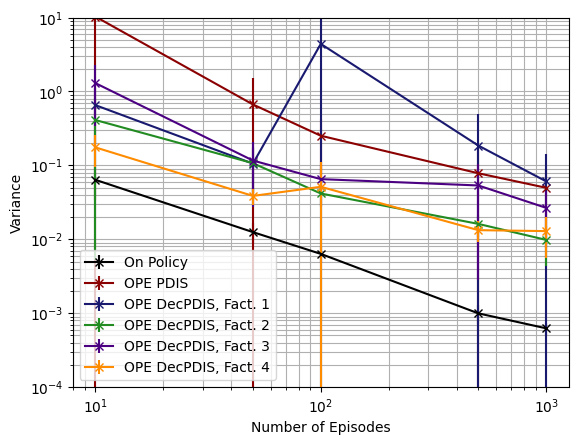

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**1, shorter_D, estimator='PDIS')

On Policy-----[0.06379992 0.01250106 0.00634494 0.00099478 0.00062408]
OPE PDWIS-----[4.89547738e-04 2.23588373e-04 1.73619160e-04 9.74521474e-05
 5.91435509e-05]
OPE DecPDWIS, Fact. 1-----[2.53221916e-04 8.86163283e-05 1.53840821e-04 6.45873671e-05
 5.03010818e-05]
OPE DecPDWIS, Fact. 2-----[3.67899392e-04 1.36113245e-04 8.57726379e-05 3.31055518e-05
 2.13922008e-05]
OPE DecPDWIS, Fact. 3-----[3.37933019e-04 1.64712102e-04 9.42563471e-05 7.81579760e-05
 4.49307687e-05]
OPE DecPDWIS, Fact. 4-----[2.28179570e-04 7.10208675e-05 4.59996786e-05 2.05921772e-05
 1.90080765e-05]


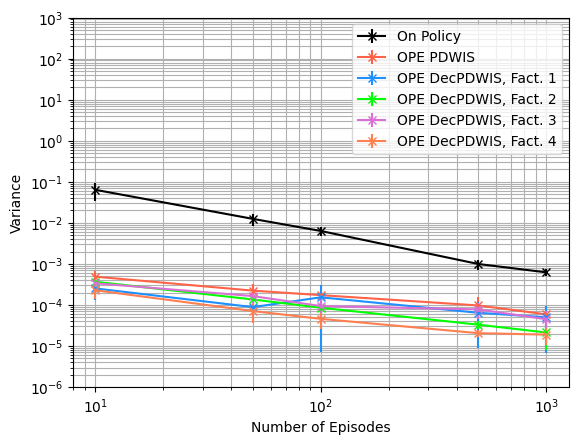

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.06379992 0.01250106 0.00634494 0.00099478 0.00062408]
OPE IS-----[10.9021722   0.71150808  0.26805129  0.080039    0.05177873]
OPE DecIS, Fact. 1-----[0.62640104 0.19387358 5.03805563 0.32321233 0.18918816]
OPE DecIS, Fact. 2-----[0.35735645 0.12483814 0.04786396 0.02637751 0.01839317]
OPE DecIS, Fact. 3-----[3.94810882 0.19014582 0.08536953 0.11770614 0.05206444]
OPE DecIS, Fact. 4-----[0.18721895 0.10052289 0.19404469 0.10293653 0.11462896]


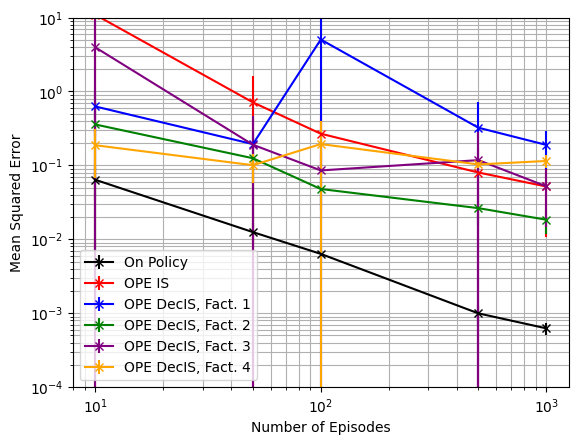

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**1, shorter_D, estimator='IS')

On Policy-----[0.06379992 0.01250106 0.00634494 0.00099478 0.00062408]
OPE PDIS-----[10.9021722   0.71150808  0.26805129  0.080039    0.05177873]
OPE DecPDIS, Fact. 1-----[0.70041536 0.11622231 4.74320428 0.21303274 0.07915661]
OPE DecPDIS, Fact. 2-----[0.41861528 0.12041357 0.04590522 0.02139803 0.01491148]
OPE DecPDIS, Fact. 3-----[1.3483347  0.12240592 0.06828884 0.05766156 0.03685643]
OPE DecPDIS, Fact. 4-----[0.18617447 0.04788047 0.06936698 0.03175879 0.03600505]


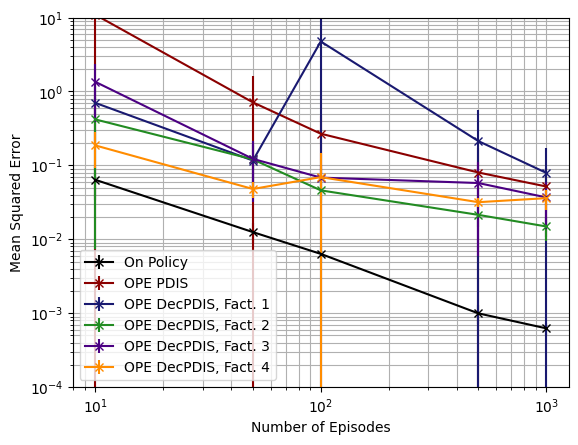

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**1, shorter_D, estimator='PDIS')

On Policy-----[0.06379992 0.01250106 0.00634494 0.00099478 0.00062408]
OPE PDWIS-----[0.05519787 0.04296687 0.03697072 0.03627396 0.03646753]
OPE DecPDWIS, Fact. 1-----[0.05478905 0.04206159 0.03606686 0.0347824  0.03507748]
OPE DecPDWIS, Fact. 2-----[0.05456399 0.04151798 0.03624303 0.03468452 0.03519403]
OPE DecPDWIS, Fact. 3-----[0.05468124 0.04190003 0.036171   0.03500695 0.03488635]
OPE DecPDWIS, Fact. 4-----[0.05421998 0.04110311 0.03540399 0.03394467 0.03420255]


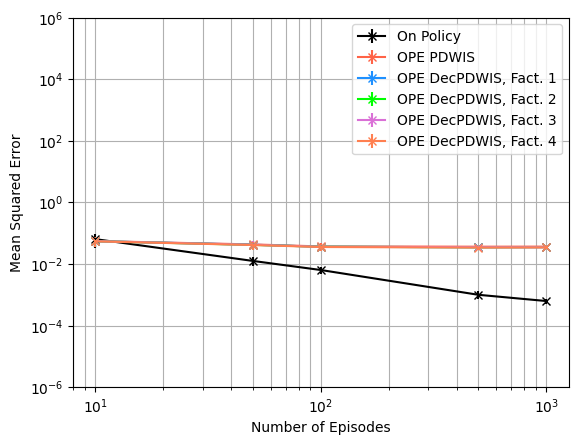

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[ 1.34941299 10.38054774  5.45900115 13.70006767 25.75859242]
OPE DecIS, Fact. 1-----[ 1.65038958  6.94856064  8.01195744 11.58027209 26.94147418]
OPE DecIS, Fact. 2-----[ 3.95820982 10.76570422 19.88173041 35.08974025 85.01298426]
OPE DecIS, Fact. 3-----[ 1.45775268 11.80523047 14.63679336 22.45360574 40.36206135]
OPE DecIS, Fact. 4-----[ 5.4626526  18.03650965 21.01741863 31.02766106 47.30775404]


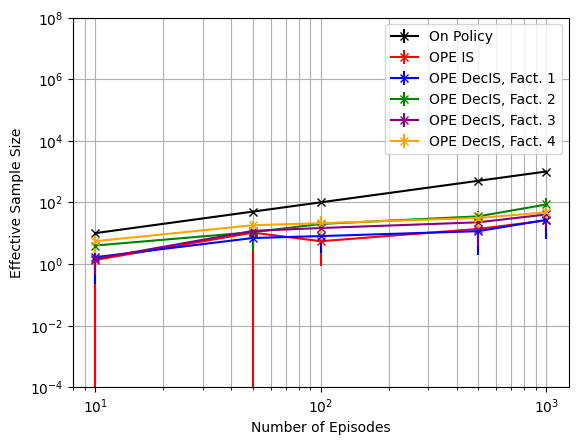

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[ 1.34941299 10.38054774  5.45900115 13.70006767 25.75859242]
OPE DecPDIS, Fact. 1-----[ 1.36750645  9.52456708  9.48756447 16.50872567 37.21911176]
OPE DecPDIS, Fact. 2-----[ 3.71754723  8.42209243 18.81828306 34.42057413 94.23958261]
OPE DecPDIS, Fact. 3-----[ 0.9114587   8.33374342 15.93801097 18.87994518 34.94908724]
OPE DecPDIS, Fact. 4-----[ 4.39230509 17.04625812 26.65862597 45.17406479 63.01740042]


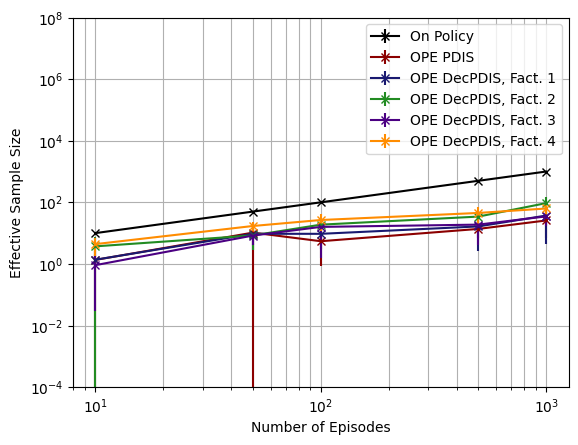

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**8, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[ 1356.01318494  3438.32164782  3669.03182454  6412.57209615
 13194.93810557]
OPE DecPDWIS, Fact. 1-----[ 2796.07305888  7824.88917019  6442.85139471 12316.06690447
 22891.71366913]
OPE DecPDWIS, Fact. 2-----[ 2011.94730569  5089.1883334   9012.61897263 14947.38724697
 45561.23260041]
OPE DecPDWIS, Fact. 3-----[ 2285.14932927  3892.34313918  9416.86402918  7890.42718876
 17814.16009053]
OPE DecPDWIS, Fact. 4-----[ 3202.54985166  9755.48009942 15781.81822592 25603.5489803
 40005.85474423]


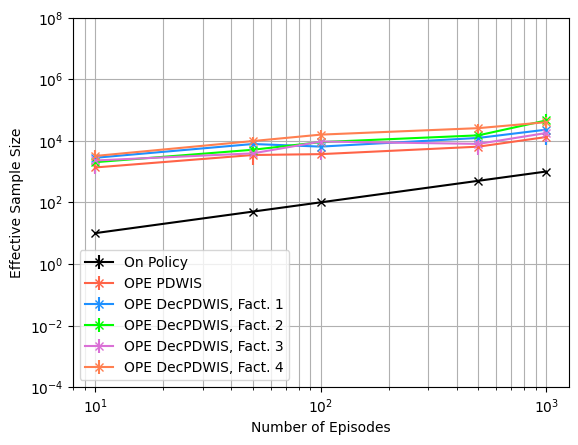

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{20}$)



Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc
gc.collect()
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.49603335858581427. Variance of on policy Q estimate: 0.030125884326874585
Mean OPE IS estimate: -0.5039414629687783. Bias1: 0.007908104382965013. Bias2: 0.00790810438296402. Variance: 0.09429304195273808. MSE: 0.09435558006766995
Mean OPE PDIS estimate: -0.5039414629687783. Bias1: 0.007908104382965013. Bias2: 0.00790810438296402. Variance: 0.09429304195273808. MSE: 0.09435558006766995
Mean OPE PDWIS estimate: -0.023567264205420352. Bias1: 0.47246609438039394. Bias2: 0.4724660943803939. Variance: 0.00014878658653481752. MSE: 0.22337299692559812
Mean OPE DecIS: Fact. 1 estimate: -0.5846971639169689. Bias1: 0.08866380533115453. Bias2: 0.08866380533115464. Variance: 0.09635927010813014. MSE: 0.104220540483931
Mean OPE DecPDIS: Fact. 1 estimate: -0.4920265094060027. Bias1: 0.00400684917981415. Bias2: 0.004006849179811589. Variance: 0.08670517391526389. MSE: 0.08672122875561367
Mean OPE DecPDWIS: Fact. 1 estima

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.04916962 0.0332636  0.02002013 0.0048857  0.00421068]
OPE DecIS, Fact. 1-----[0.04626443 0.09943079 0.10159924 0.11166533 0.11178518]
OPE DecIS, Fact. 2-----[0.07145089 0.05221287 0.03269012 0.01575742 0.01740268]
OPE DecIS, Fact. 3-----[0.05323371 0.03418224 0.02471624 0.00609799 0.00527206]
OPE DecIS, Fact. 4-----[0.02859698 0.04990439 0.05335234 0.0681625  0.06813128]


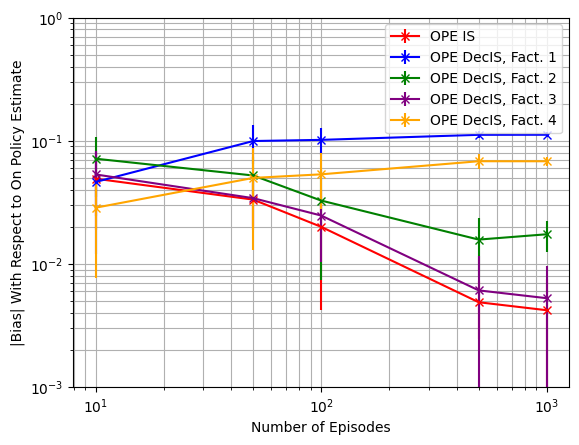

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.04916962 0.0332636  0.02002013 0.0048857  0.00421068]
OPE DecPDIS, Fact. 1-----[0.04707742 0.02735362 0.02367295 0.01552042 0.01553182]
OPE DecPDIS, Fact. 2-----[0.04777942 0.04173054 0.02831681 0.00914526 0.00526695]
OPE DecPDIS, Fact. 3-----[0.05288516 0.03210623 0.02335039 0.00635706 0.00580347]
OPE DecPDIS, Fact. 4-----[0.04614751 0.03110468 0.02323385 0.01838188 0.01842769]


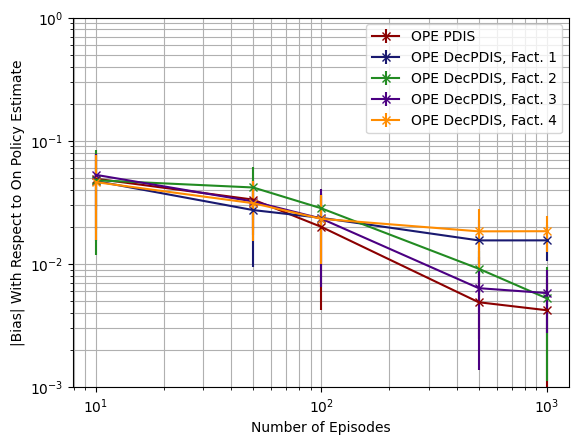

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.48235348 0.45407103 0.45030807 0.44423837 0.44520335]
OPE DecPDWIS, Fact. 1-----[0.48303249 0.4545564  0.45078783 0.44451005 0.44550117]
OPE DecPDWIS, Fact. 2-----[0.4816406  0.45331326 0.44964319 0.44323026 0.444308  ]
OPE DecPDWIS, Fact. 3-----[0.48246009 0.45407767 0.45041872 0.44413374 0.44506179]
OPE DecPDWIS, Fact. 4-----[0.4822308  0.4536978  0.44996682 0.44353695 0.44453485]


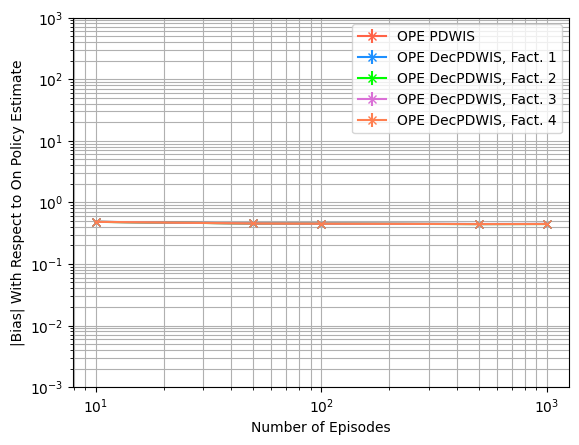

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.04723167 0.0104453  0.00484033 0.00073046 0.00044579]
OPE IS-----[0.08843427 0.01372986 0.00739425 0.00166039 0.00065063]
OPE DecIS, Fact. 1-----[0.07935406 0.01148609 0.00764093 0.00171421 0.00072326]
OPE DecIS, Fact. 2-----[0.05821163 0.00854617 0.0045939  0.00124411 0.00050455]
OPE DecIS, Fact. 3-----[0.06377476 0.00951894 0.00573462 0.00160151 0.00064217]
OPE DecIS, Fact. 4-----[0.05382456 0.0079711  0.00462619 0.00126904 0.00055723]


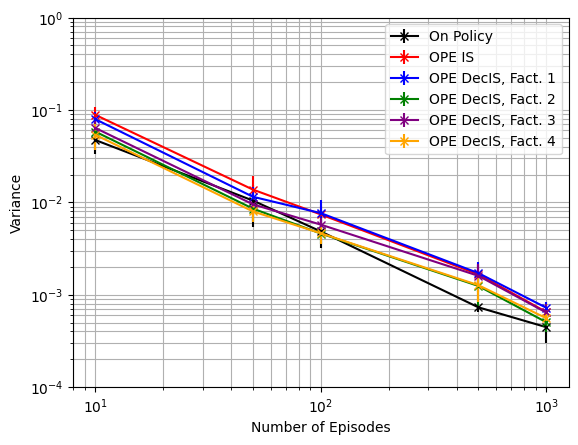

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

On Policy-----[0.04723167 0.0104453  0.00484033 0.00073046 0.00044579]
OPE PDIS-----[0.08843427 0.01372986 0.00739425 0.00166039 0.00065063]
OPE DecPDIS, Fact. 1-----[0.07255278 0.0103237  0.00680262 0.0015047  0.00064184]
OPE DecPDIS, Fact. 2-----[0.06803509 0.01008725 0.00517716 0.00132752 0.00053678]
OPE DecPDIS, Fact. 3-----[0.06638129 0.01025192 0.00579031 0.0016301  0.00065999]
OPE DecPDIS, Fact. 4-----[0.05553362 0.00825503 0.00452012 0.00121848 0.00053368]


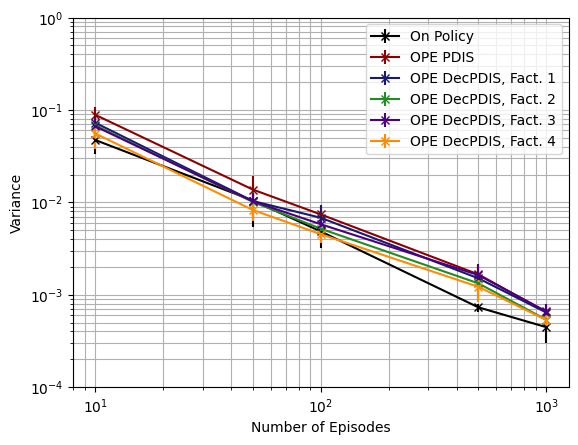

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.04723167 0.0104453  0.00484033 0.00073046 0.00044579]
OPE PDWIS-----[1.78515126e-04 3.18904130e-05 1.75821367e-05 4.38217762e-06
 1.74630103e-06]
OPE DecPDWIS, Fact. 1-----[1.26990075e-04 2.12575716e-05 1.40338863e-05 3.08055380e-06
 1.28465909e-06]
OPE DecPDWIS, Fact. 2-----[1.48599205e-04 2.64199562e-05 1.38600536e-05 3.68996847e-06
 1.40416019e-06]
OPE DecPDWIS, Fact. 3-----[1.38188994e-04 2.54169782e-05 1.36818832e-05 4.15971432e-06
 1.61995539e-06]
OPE DecPDWIS, Fact. 4-----[1.15967742e-04 1.96620626e-05 1.05305284e-05 2.92281316e-06
 1.18756577e-06]


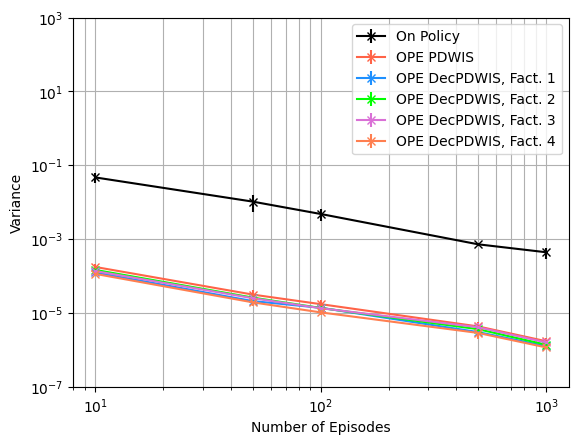

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.04723167 0.0104453  0.00484033 0.00073046 0.00044579]
OPE IS-----[0.09177097 0.01504073 0.00804353 0.00169008 0.00067909]
OPE DecIS, Fact. 1-----[0.08266499 0.02255028 0.01859971 0.01423707 0.01324312]
OPE DecIS, Fact. 2-----[0.06465829 0.01173634 0.0063009  0.00155534 0.00083208]
OPE DecIS, Fact. 3-----[0.06744319 0.0108787  0.00655413 0.00166823 0.00068898]
OPE DecIS, Fact. 4-----[0.0550822  0.01181753 0.00812855 0.00600493 0.00523138]


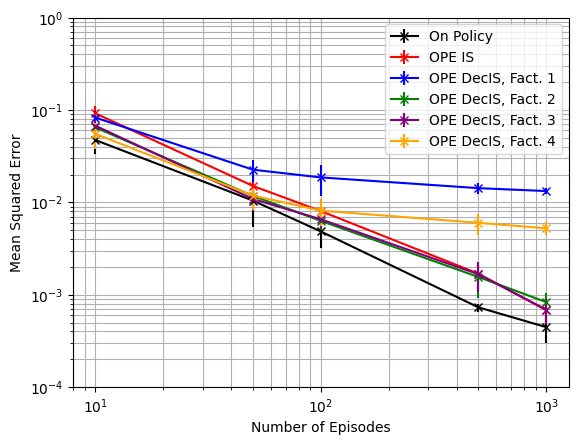

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

On Policy-----[0.04723167 0.0104453  0.00484033 0.00073046 0.00044579]
OPE PDIS-----[0.09177097 0.01504073 0.00804353 0.00169008 0.00067909]
OPE DecPDIS, Fact. 1-----[0.07576772 0.01139468 0.00753882 0.00179974 0.00090872]
OPE DecPDIS, Fact. 2-----[0.07161199 0.01218683 0.00606776 0.00142349 0.00058167]
OPE DecPDIS, Fact. 3-----[0.06982073 0.01150226 0.00662101 0.00169531 0.00070305]
OPE DecPDIS, Fact. 4-----[0.05858624 0.00947207 0.00523626 0.00164713 0.00090753]


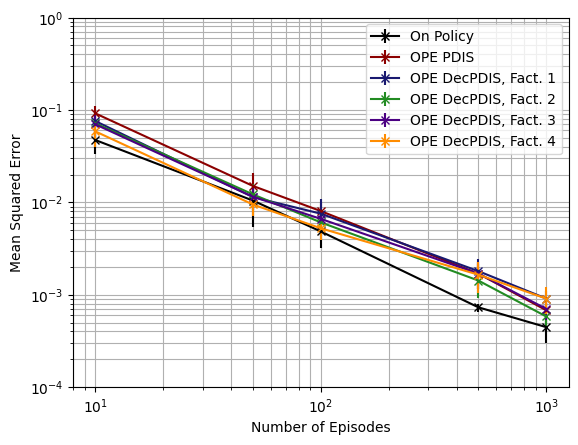

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.04723167 0.0104453  0.00484033 0.00073046 0.00044579]
OPE PDWIS-----[0.23448154 0.20686693 0.20308716 0.19737776 0.19821724]
OPE DecPDWIS, Fact. 1-----[0.23512233 0.20726974 0.20351033 0.19761867 0.19848178]
OPE DecPDWIS, Fact. 2-----[0.23373149 0.20617055 0.20248242 0.19648315 0.19742011]
OPE DecPDWIS, Fact. 3-----[0.23456937 0.20684553 0.20317751 0.19728524 0.19809101]
OPE DecPDWIS, Fact. 4-----[0.23433049 0.20649353 0.20276776 0.19675466 0.19762163]


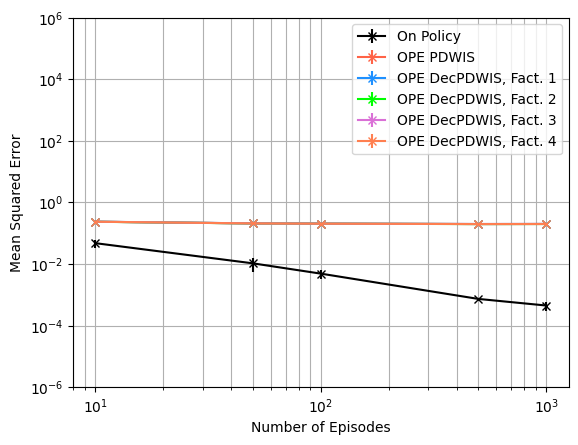

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[  5.4399583   46.47808362  69.1791369  241.9405459  709.29525537]
OPE DecIS, Fact. 1-----[  6.34727155  49.72348642  69.92389683 236.14875141 611.34852761]
OPE DecIS, Fact. 2-----[  9.18729695  64.74379833 109.75033199 347.31027821 928.30722632]
OPE DecIS, Fact. 3-----[  8.35272869  55.4252729   86.17770665 287.71356874 789.10364336]
OPE DecIS, Fact. 4-----[ 10.40180697  66.7271977  105.70073421 324.93752532 821.83501416]


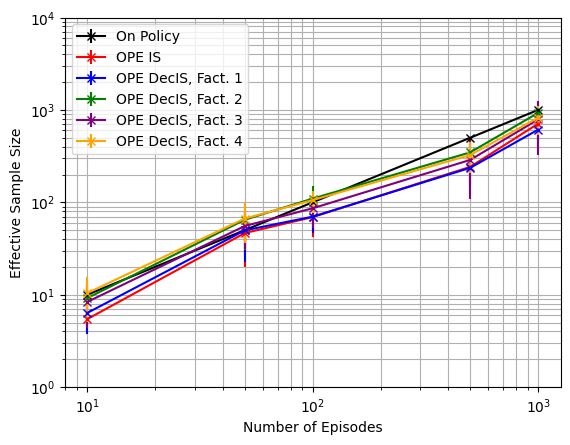

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**4, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[  5.4399583   46.47808362  69.1791369  241.9405459  709.29525537]
OPE DecPDIS, Fact. 1-----[  6.81066803  55.09929209  78.20482801 266.98660216 686.67752573]
OPE DecPDIS, Fact. 2-----[  7.9901834   56.36457862  98.47817458 319.96504638 864.62508669]
OPE DecPDIS, Fact. 3-----[  8.27823214  52.68462899  84.58874762 273.19648822 753.10093095]
OPE DecPDIS, Fact. 4-----[  9.98539834  65.27494655 108.4681996  333.42009995 861.77665746]


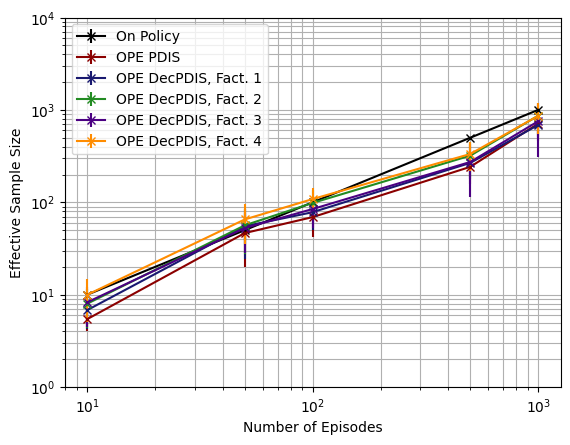

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**4, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[  2606.80697838  18422.89081629  30372.36741336  97512.20895131
 261410.02064949]
OPE DecPDWIS, Fact. 1-----[  3686.80828292  27124.59910994  39021.83870488 132651.39403277
 340436.89625637]
OPE DecPDWIS, Fact. 2-----[  3363.97711419  20608.4995114   36660.0284755  110404.90791801
 322660.80015622]
OPE DecPDWIS, Fact. 3-----[  3484.84781892  21092.44556604  36013.01786746 106038.41378679
 301255.92024734]
OPE DecPDWIS, Fact. 4-----[  4218.10203381  27742.62357297  47369.63970286 142886.56528786
 389985.06546649]


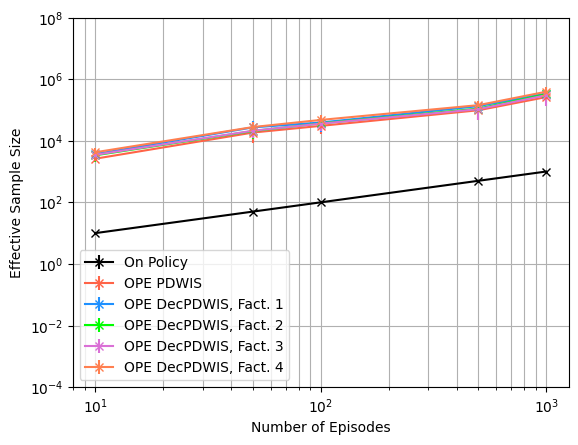

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

### Varying Episode Length $T$ With $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{T}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc

gc.collect()
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
LENGTHS = [1, 5, 10, 20]

bias_means = np.zeros((len(LENGTHS), 16))
bias_stds = np.zeros((len(LENGTHS), 16))
var_means = np.zeros((len(LENGTHS), 16))
var_stds = np.zeros((len(LENGTHS), 16))
MSE_means = np.zeros((len(LENGTHS), 16))
MSE_stds = np.zeros((len(LENGTHS), 16))
ESS_means = np.zeros((len(LENGTHS), 16))
ESS_stds = np.zeros((len(LENGTHS), 16))

RUNS = 20

for id in range(len(LENGTHS)):
  e = LENGTHS[id]
  print(f'{e} Steps, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

1 Steps, 20 ----------------------------------

Mean on policy Q estimate: -0.4661273721662279. Variance of on policy Q estimate: 0.4914785990401683
Mean OPE IS estimate: -0.5566431506058327. Bias1: 0.0905157784396042. Bias2: 0.09051577843960479. Variance: 0.47395137990885844. MSE: 0.48214448605538596
Mean OPE PDIS estimate: -0.5566431506058327. Bias1: 0.0905157784396042. Bias2: 0.09051577843960479. Variance: 0.47395137990885844. MSE: 0.48214448605538596
Mean OPE PDWIS estimate: -0.027500178990713643. Bias1: 0.43862719317551424. Bias2: 0.43862719317551424. Variance: 0.0010231578789068449. MSE: 0.19341697247193673
Mean OPE DecIS: Fact. 1 estimate: -0.6385517668586187. Bias1: 0.1724243946923898. Bias2: 0.1724243946923908. Variance: 0.8768245947053173. MSE: 0.9065547665903543
Mean OPE DecPDIS: Fact. 1 estimate: -0.5379004212296146. Bias1: 0.0717730490633868. Bias2: 0.07177304906338666. Variance: 0.918432902562099. MSE: 0.9235842731339543
Mean OPE DecPDWIS: Fact. 1 estimate: -0.02280535965

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.19890118 0.08884247 0.02852304 0.0261122 ]
OPE DecIS, Fact. 1-----[0.2582564  0.10994636 0.08821547 0.10741057]
OPE DecIS, Fact. 2-----[0.18980685 0.10643256 0.05734929 0.04097099]
OPE DecIS, Fact. 3-----[0.13176164 0.09930852 0.04400286 0.0360673 ]
OPE DecIS, Fact. 4-----[0.16588483 0.08172278 0.05585349 0.06472224]


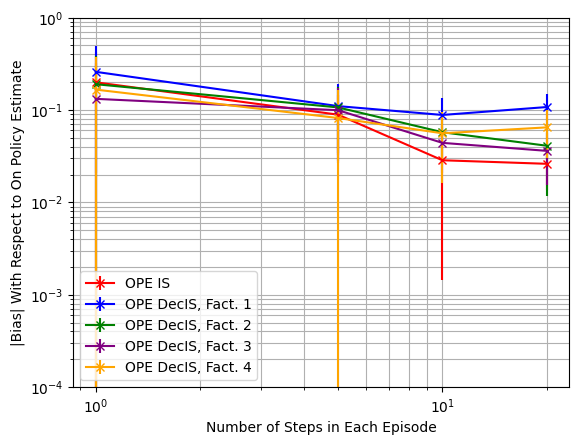

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.19890118 0.08884247 0.02852304 0.0261122 ]
OPE DecPDIS, Fact. 1-----[0.19397511 0.10052016 0.03326338 0.0331123 ]
OPE DecPDIS, Fact. 2-----[0.17332467 0.09184447 0.05242972 0.03969992]
OPE DecPDIS, Fact. 3-----[0.14321543 0.09790874 0.0363085  0.03352166]
OPE DecPDIS, Fact. 4-----[0.14289012 0.09497384 0.04460752 0.03451828]


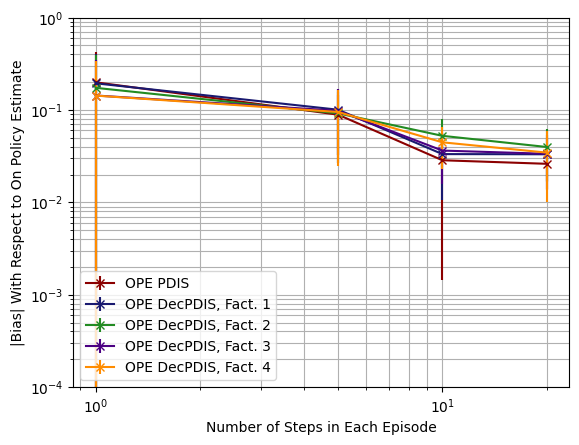

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.43788326 0.47012385 0.44040243 0.43828367]
OPE DecPDWIS, Fact. 1-----[0.44166684 0.47146997 0.44108144 0.43841086]
OPE DecPDWIS, Fact. 2-----[0.43834202 0.4698957  0.43968955 0.4371078 ]
OPE DecPDWIS, Fact. 3-----[0.43970711 0.47077373 0.44050904 0.43796645]
OPE DecPDWIS, Fact. 4-----[0.44073071 0.47079538 0.44027976 0.43750123]


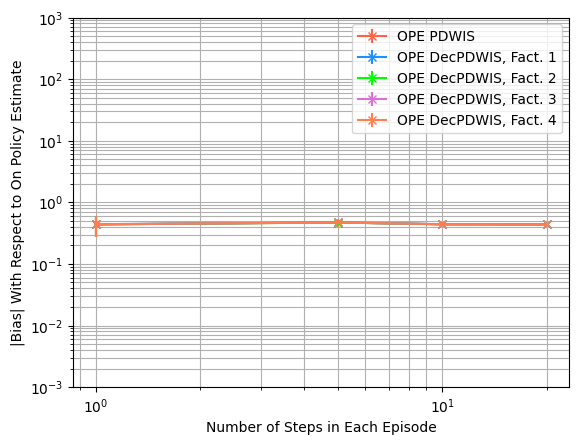

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.41050974 0.09083563 0.06483161 0.02824944]
OPE IS-----[0.81663391 0.15320699 0.08843427 0.03791772]
OPE DecIS, Fact. 1-----[0.86849785 0.14388142 0.07935406 0.03505392]
OPE DecIS, Fact. 2-----[0.53773124 0.09715811 0.05821163 0.02270482]
OPE DecIS, Fact. 3-----[0.64039634 0.10062146 0.06377476 0.02875832]
OPE DecIS, Fact. 4-----[0.56170204 0.0950579  0.05382456 0.02284897]


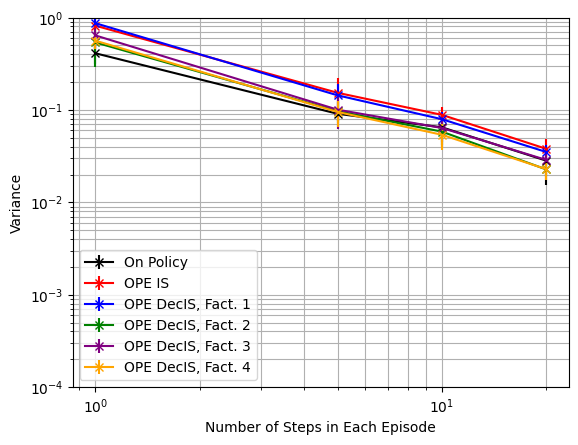

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

On Policy-----[0.41050974 0.09083563 0.06483161 0.02824944]
OPE PDIS-----[0.81663391 0.15320699 0.08843427 0.03791772]
OPE DecPDIS, Fact. 1-----[0.78475165 0.12508295 0.07255278 0.03089116]
OPE DecPDIS, Fact. 2-----[0.60469918 0.1185949  0.06803509 0.02771131]
OPE DecPDIS, Fact. 3-----[0.75392426 0.11666557 0.06638129 0.03193053]
OPE DecPDIS, Fact. 4-----[0.57518    0.09935564 0.05553362 0.02405975]


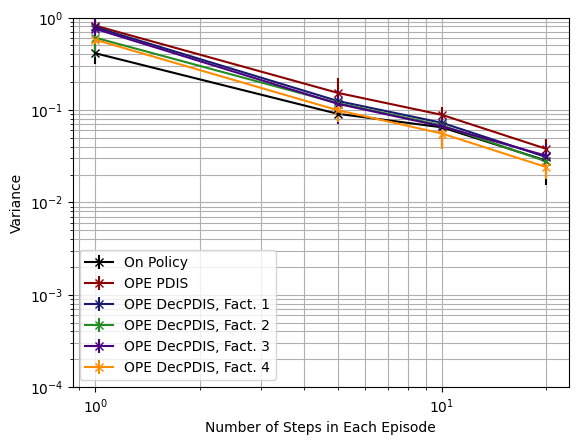

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.41050974 0.09083563 0.06483161 0.02824944]
OPE PDWIS-----[7.79175207e-04 2.68546041e-04 1.78515126e-04 8.28878410e-05]
OPE DecPDWIS, Fact. 1-----[7.38117287e-04 1.75762896e-04 1.26990075e-04 5.49642758e-05]
OPE DecPDWIS, Fact. 2-----[8.16511892e-04 2.38030226e-04 1.48599205e-04 6.59298640e-05]
OPE DecPDWIS, Fact. 3-----[7.88848304e-04 2.19700221e-04 1.38188994e-04 6.86397967e-05]
OPE DecPDWIS, Fact. 4-----[7.69346833e-04 1.85377988e-04 1.15967742e-04 5.23032811e-05]


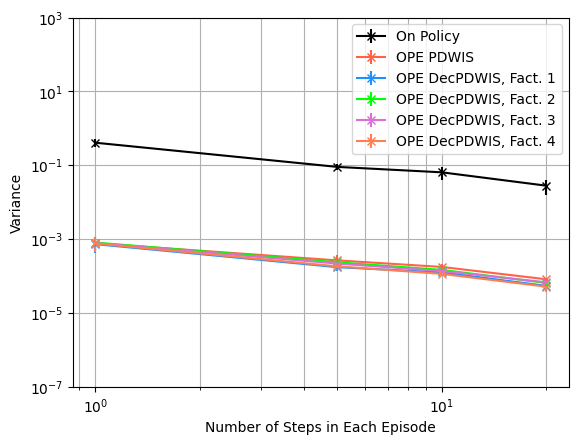

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.41050974 0.09083563 0.06483161 0.02824944]
OPE IS-----[0.90563698 0.16425604 0.08998135 0.03875524]
OPE DecIS, Fact. 1-----[0.99169552 0.16264163 0.08922064 0.04818085]
OPE DecIS, Fact. 2-----[0.61200064 0.11366474 0.06250694 0.02524007]
OPE DecIS, Fact. 3-----[0.69401914 0.11577976 0.0662479  0.03048995]
OPE DecIS, Fact. 4-----[0.63162695 0.10842652 0.0585104  0.02824322]


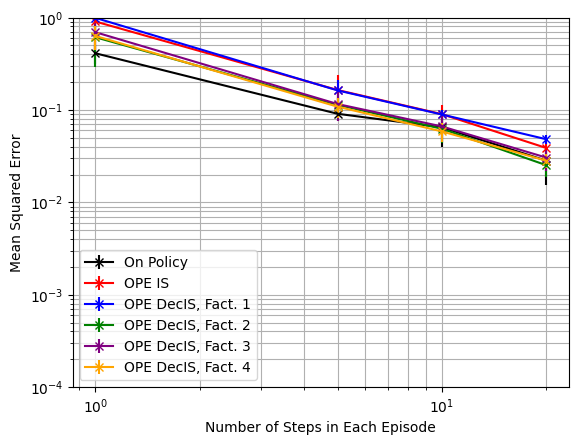

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

On Policy-----[0.41050974 0.09083563 0.06483161 0.02824944]
OPE PDIS-----[0.90563698 0.16425604 0.08998135 0.03875524]
OPE DecPDIS, Fact. 1-----[0.8650128  0.13983735 0.07416849 0.03224151]
OPE DecPDIS, Fact. 2-----[0.68384415 0.13124598 0.07156961 0.02982735]
OPE DecPDIS, Fact. 3-----[0.81572634 0.13134326 0.06811984 0.0334379 ]
OPE DecPDIS, Fact. 4-----[0.63282132 0.11332209 0.05798384 0.02584401]


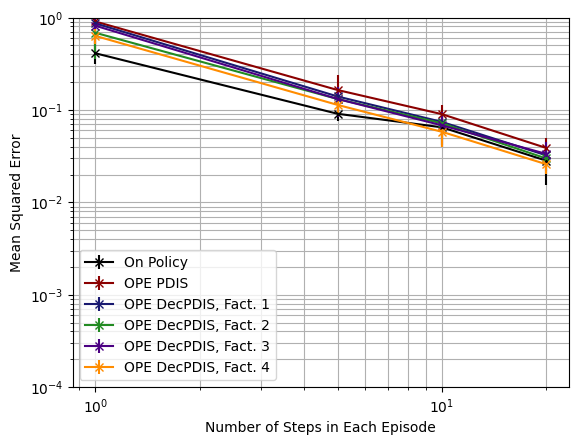

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.41050974 0.09083563 0.06483161 0.02824944]
OPE PDWIS-----[0.22042152 0.22591451 0.19522334 0.19270158]
OPE DecPDWIS, Fact. 1-----[0.22373508 0.22717951 0.19582587 0.19279369]
OPE DecPDWIS, Fact. 2-----[0.220589   0.22566184 0.19460945 0.19170305]
OPE DecPDWIS, Fact. 3-----[0.22173816 0.22658491 0.19535155 0.19243467]
OPE DecPDWIS, Fact. 4-----[0.22268189 0.22656408 0.1951259  0.19202225]


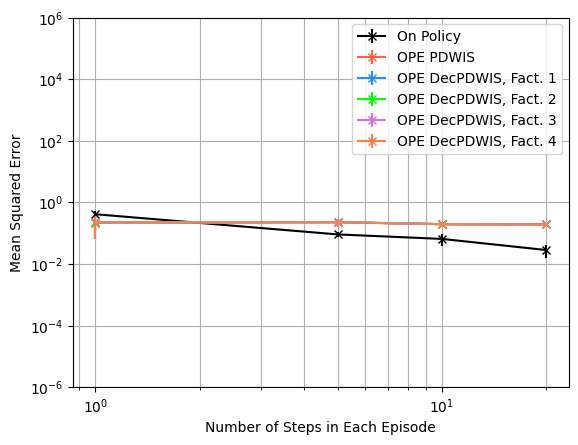

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[ 1.  5. 10. 20.]
OPE IS-----[ 0.59439186  3.65477969  8.49991145 15.70842821]
OPE DecIS, Fact. 1-----[ 0.47776958  3.43887023  8.73230578 17.21903054]
OPE DecIS, Fact. 2-----[ 0.86600763  4.8354848  11.92444062 25.23688429]
OPE DecIS, Fact. 3-----[ 0.70594645  5.35561403 12.23003489 22.10325578]
OPE DecIS, Fact. 4-----[ 0.75619012  5.0354808  13.46937381 26.25331089]


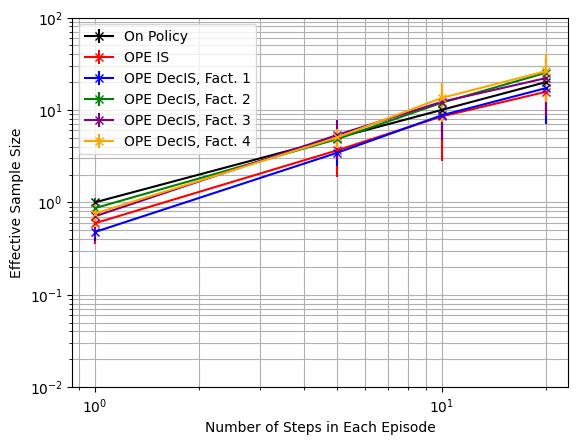

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-2), 10**2, shorter_D, estimator='IS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDIS-----[ 0.59439186  3.65477969  8.49991145 15.70842821]
OPE DecPDIS, Fact. 1-----[ 0.51763059  3.86386202  9.53500946 18.873069  ]
OPE DecPDIS, Fact. 2-----[ 0.7310056   3.89514001 10.46630039 20.98435462]
OPE DecPDIS, Fact. 3-----[ 0.60987184  4.69111655 12.16768879 21.76455675]
OPE DecPDIS, Fact. 4-----[ 0.71672591  4.74049372 13.07183392 25.23478627]


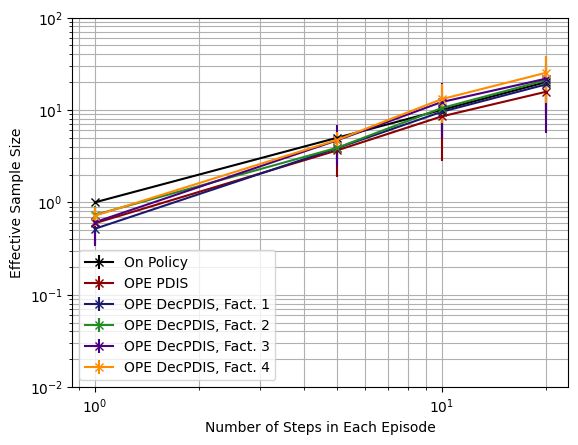

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-2), 10**2, shorter_D, estimator='PDIS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDWIS-----[ 614.03488644 2083.13576184 3971.53435112 6753.99686159]
OPE DecPDWIS, Fact. 1-----[  676.04985652  2876.09017398  5323.85507315 10217.46046518]
OPE DecPDWIS, Fact. 2-----[ 576.802188   2006.07031201 4449.88745381 8789.41289007]
OPE DecPDWIS, Fact. 3-----[ 605.85448512 2424.80168202 5071.14052463 9138.91396537]
OPE DecPDWIS, Fact. 4-----[  646.61475744  2604.8453817   5701.04829598 11378.58270099]


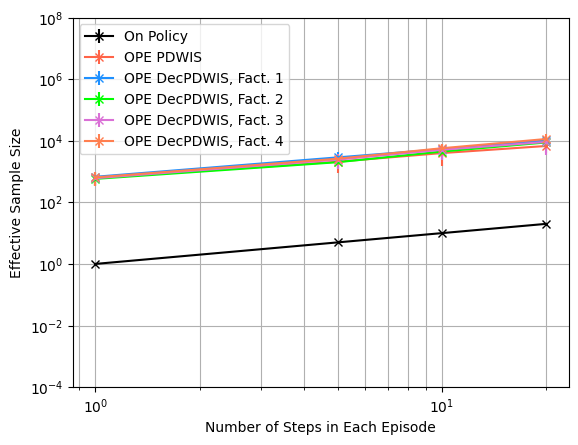

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

## From Patient State 696, With Diabetes

In [ ]:
#The patient has diabetes
PROB_DIAB = 1.0

### State Analysis

In [ ]:
#Instantiate a state based on the idx and get the state vector
testState = State(state_idx = 696, diabetic_idx=1)
vec = testState.get_state_vector()

print(vec)
print(f'Num abnormals: {testState.get_num_abnormal()}\n')

print(f'Heart Rate: {hr_state_mapping[vec[0]]}')
print(f'Systolic Blood Pressure: {sbp_state_mapping[vec[1]]}')
print(f'Percent Oxygen: {o2_state_mapping[vec[2]]}')
print(f'Glucose Level: {glu_state_mapping[vec[3]]}')
print(f'Antibiotics: {abx_state_mapping[vec[4]]}')
print(f'Vasopressors: {vaso_state_mapping[vec[5]]}')
print(f'Ventilator: {vent_state_mapping[vec[6]]}')
print(f'Diabetes: {testState.diabetic_idx}')

[2 2 1 2 0 0 0]
Num abnormals: 2

Heart Rate: High
Systolic Blood Pressure: High
Percent Oxygen: Normal
Glucose Level: Normal
Antibiotics: Off
Vasopressors: Off
Ventilator: Off
Diabetes: 1


### Generate Data From Behaviour Policy

Run the data generator

In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=randPol, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

Convert data into array format

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_b = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_b.shape

(100000, 20, 5)

In [ ]:
f_tr_b1, f_tr_b2, f_tr_b3, f_tr_b4 = factorise_dataset(nf_tr_b)

In [ ]:
factored_randPol1 = factor_policy_1(randPol)
factored_randPol2 = factor_policy_2(randPol)
factored_randPol3 = factor_policy_3(randPol)
factored_randPol4 = factor_policy_4(randPol)

In [ ]:
randPol = pad_policy(randPol)

factored_randPol1[0] = pad_policy(factored_randPol1[0])
factored_randPol1[1] = pad_policy(factored_randPol1[1])

factored_randPol2[0] = pad_policy(factored_randPol2[0])
factored_randPol2[1] = pad_policy(factored_randPol2[1])

factored_randPol3[0] = pad_policy(factored_randPol3[0])
factored_randPol3[1] = pad_policy(factored_randPol3[1])

factored_randPol4[0] = pad_policy(factored_randPol4[0])
factored_randPol4[1] = pad_policy(factored_randPol4[1])
factored_randPol4[2] = pad_policy(factored_randPol4[2])

### Varying Episodes $\epsilon_{e} = 0.4$ (Policy Divergence $4.8^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
EVAL_EPSILON = 0.4

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

4.8


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
print(nf_tr_b)

[[[  0. 696.   0.  -1. 648.]
  [  1. 648.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 696.   3.   0. 699.]
  [  1. 699.   5.   0. 422.]
  [  2. 422.   3.   0. 467.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 696.   1.   0. 698.]
  [  1. 698.   3.   0. 699.]
  [  2. 699.   0.   0. 696.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 ...

 [[  0. 696.   6.   0. 469.]
  [  1. 469.   5.   0. 470.]
  [  2. 470.   3.   0. 475.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 696.   6.  -1. 693.]
  [  1. 693.  -1.   0.  -1.]
  [  2.  -1.  -1.   0.  -1.]
  ...
  [ 17.  -1.  -1.   0.  -1.]
  [ 18.  -1.  -1.   0.  -1.]
  [ 19.  -1.  -1.   0.  -1.]]

 [[  0. 696.   6.   0. 469.]
  [  1. 469.   0.   0. 456.]
  [  2. 456.   7.   0. 471

In [ ]:
print(f_tr_b1)

[[[[ 0.00e+00  6.96e+02  0.00e+00 -5.00e-01  6.48e+02]
   [ 0.00e+00  6.96e+02  0.00e+00 -5.00e-01  6.48e+02]]

  [[ 1.00e+00  6.48e+02  1.00e+00  0.00e+00 -1.00e+00]
   [ 1.00e+00  6.48e+02 -1.00e+00  0.00e+00 -1.00e+00]]

  [[ 2.00e+00 -1.00e+00  1.00e+00  0.00e+00 -1.00e+00]
   [ 2.00e+00 -1.00e+00 -1.00e+00  0.00e+00 -1.00e+00]]

  ...

  [[ 1.70e+01 -1.00e+00  1.00e+00  0.00e+00 -1.00e+00]
   [ 1.70e+01 -1.00e+00 -1.00e+00  0.00e+00 -1.00e+00]]

  [[ 1.80e+01 -1.00e+00  1.00e+00  0.00e+00 -1.00e+00]
   [ 1.80e+01 -1.00e+00 -1.00e+00  0.00e+00 -1.00e+00]]

  [[ 1.90e+01 -1.00e+00  1.00e+00  0.00e+00 -1.00e+00]
   [ 1.90e+01 -1.00e+00 -1.00e+00  0.00e+00 -1.00e+00]]]


 [[[ 0.00e+00  6.96e+02  1.00e+00  0.00e+00  6.99e+02]
   [ 0.00e+00  6.96e+02  1.00e+00  0.00e+00  6.99e+02]]

  [[ 1.00e+00  6.99e+02  0.00e+00  0.00e+00  4.22e+02]
   [ 1.00e+00  6.99e+02  3.00e+00  0.00e+00  4.22e+02]]

  [[ 2.00e+00  4.22e+02  1.00e+00  0.00e+00  4.67e+02]
   [ 2.00e+00  4.22e+02  1.00e+00  0.00e

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.3914944273925299. Variance of on policy Q estimate: 0.060805160966409345
Mean OPE IS estimate: -0.48469524896542293. Bias1: 0.09320082157289282. Bias2: 0.09320082157289306. Variance: 0.2420406813957494. MSE: 0.2507270745376116
Mean OPE PDIS estimate: -0.48469524896542293. Bias1: 0.09320082157289282. Bias2: 0.09320082157289306. Variance: 0.2420406813957494. MSE: 0.2507270745376116
Mean OPE PDWIS estimate: -0.03838018214076626. Bias1: 0.3531142452517636. Bias2: 0.3531142452517636. Variance: 0.0001732271020685815. MSE: 0.12486289730179126
Mean OPE DecIS: Fact. 1 estimate: -0.9363575267122733. Bias1: 0.5448630993197435. Bias2: 0.5448630993197434. Variance: 0.18579400335640564. MSE: 0.4826698003567224
Mean OPE DecPDIS: Fact. 1 estimate: -0.6246642703084476. Bias1: 0.23316984291591786. Bias2: 0.23316984291591775. Variance: 0.07917922666691343. MSE: 0.13354740231234724
Mean OPE DecPDWIS: Fact. 1 estimate: -0.031

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.18478186 0.23761033 0.22579222 0.25645704 0.19388847]
OPE DecIS, Fact. 1-----[0.51835149 0.561825   0.57264971 0.67484144 0.65283226]
OPE DecIS, Fact. 2-----[0.1517342  0.09242792 0.08388583 0.12472469 0.07125075]
OPE DecIS, Fact. 3-----[0.7166649  0.17515724 0.11787077 0.15258166 0.08772128]
OPE DecIS, Fact. 4-----[0.72917001 0.38857667 0.35840039 0.47863931 0.42938698]


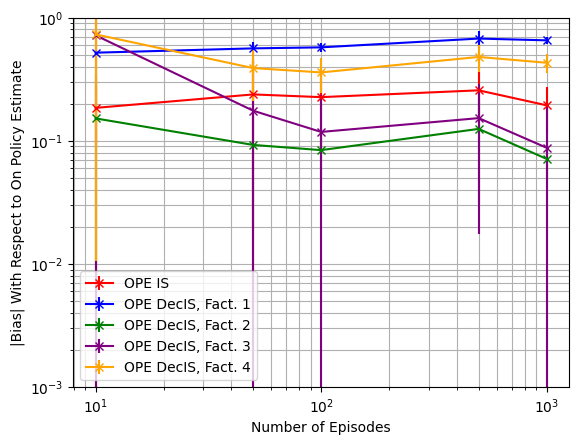

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**-3, 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.18478186 0.23761033 0.22579222 0.25645704 0.19388847]
OPE DecPDIS, Fact. 1-----[0.23650114 0.24339714 0.25078661 0.31232927 0.27712372]
OPE DecPDIS, Fact. 2-----[0.36481607 0.29428172 0.25342188 0.42231114 0.34971591]
OPE DecPDIS, Fact. 3-----[0.96009919 0.32222143 0.29427561 0.40633054 0.32250158]
OPE DecPDIS, Fact. 4-----[0.74268919 0.3577258  0.33051077 0.44736115 0.38208382]


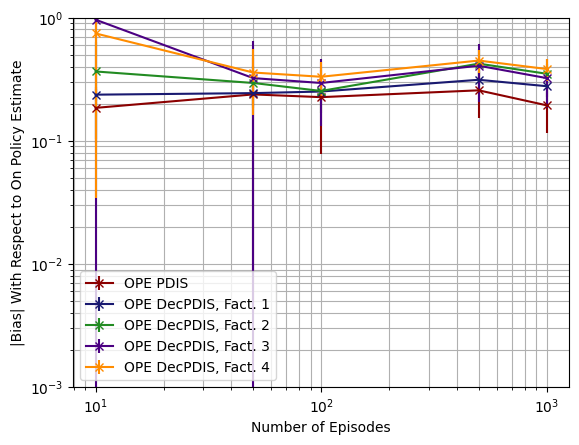

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.32877147 0.34661879 0.34671209 0.34138326 0.34667297]
OPE DecPDWIS, Fact. 1-----[0.33496177 0.35184763 0.35273909 0.34676067 0.3498737 ]
OPE DecPDWIS, Fact. 2-----[0.28866101 0.31175241 0.31697043 0.3125499  0.31649265]
OPE DecPDWIS, Fact. 3-----[0.30298506 0.32355368 0.32623986 0.31963885 0.32601964]
OPE DecPDWIS, Fact. 4-----[0.30582507 0.32753103 0.33103624 0.32510346 0.32851459]


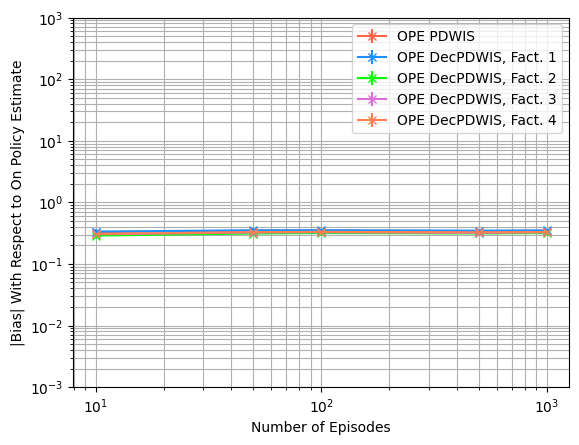

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.05051049 0.01050452 0.00446289 0.00124901 0.00059988]
OPE IS-----[0.35707738 0.98069417 0.29895132 0.26894163 0.12165356]
OPE DecIS, Fact. 1-----[0.1880451  0.10834423 0.06646431 0.25838881 0.08778728]
OPE DecIS, Fact. 2-----[1.43417993 0.38316368 0.10539724 0.4521827  0.14368931]
OPE DecIS, Fact. 3-----[15.50352001  1.20299324  0.33360236  0.31553864  0.08056748]
OPE DecIS, Fact. 4-----[6.73964604 0.55706194 0.16043348 0.23857719 0.06666999]


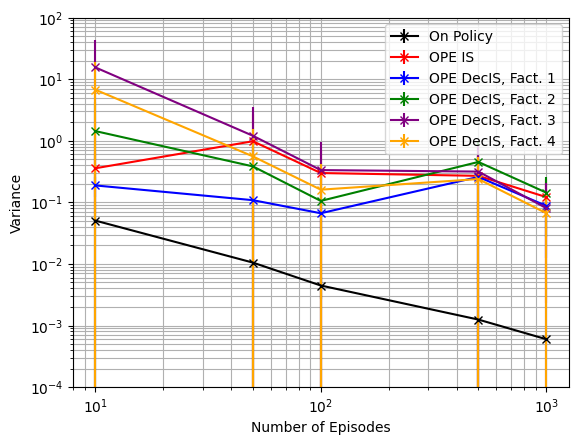

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**2, shorter_D, estimator='IS')

On Policy-----[0.05051049 0.01050452 0.00446289 0.00124901 0.00059988]
OPE PDIS-----[0.35707738 0.98069417 0.29895132 0.26894163 0.12165356]
OPE DecPDIS, Fact. 1-----[0.09596819 0.05324313 0.03047977 0.08249435 0.07401422]
OPE DecPDIS, Fact. 2-----[1.54395631 0.40963061 0.12055178 0.59641475 0.18686316]
OPE DecPDIS, Fact. 3-----[15.79029906  1.22563473  0.37119262  0.37033106  0.12473725]
OPE DecPDIS, Fact. 4-----[6.7874457  0.5446927  0.15823087 0.2329658  0.08175328]


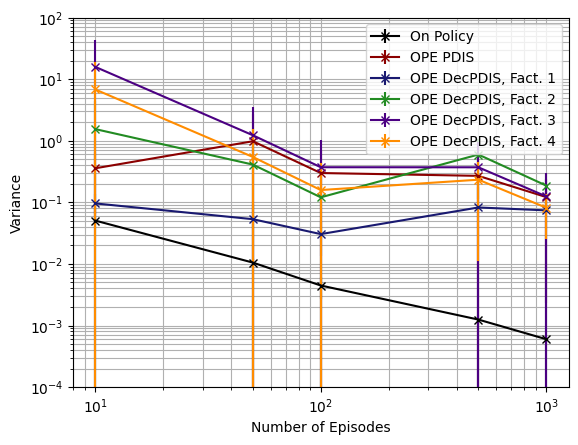

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**2, shorter_D, estimator='PDIS')

On Policy-----[0.05051049 0.01050452 0.00446289 0.00124901 0.00059988]
OPE PDWIS-----[1.13179871e-04 1.00441125e-04 8.39992780e-05 8.15889963e-05
 1.23387038e-04]
OPE DecPDWIS, Fact. 1-----[4.40152173e-05 2.84245428e-05 2.11729725e-05 1.08317062e-05
 3.86856339e-05]
OPE DecPDWIS, Fact. 2-----[0.00081314 0.00026467 0.00016071 0.00015855 0.00014102]
OPE DecPDWIS, Fact. 3-----[0.00053593 0.00024139 0.00020654 0.00012344 0.00012302]
OPE DecPDWIS, Fact. 4-----[3.94400599e-04 1.26443092e-04 7.89863078e-05 6.91486777e-05
 6.32273324e-05]


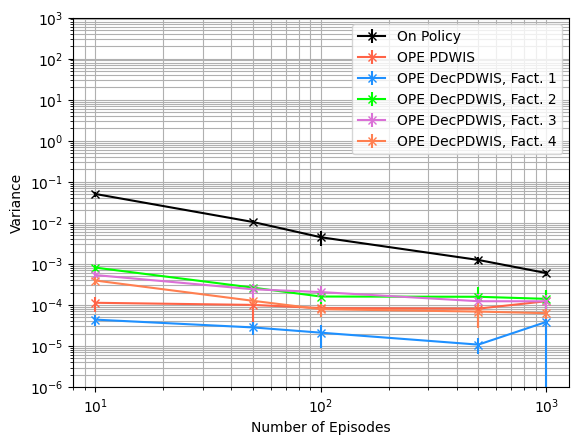

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.05051049 0.01050452 0.00446289 0.00124901 0.00059988]
OPE IS-----[0.39920786 1.09174084 0.37165538 0.34560431 0.16522984]
OPE DecIS, Fact. 1-----[0.45837604 0.42895975 0.3971114  0.7249621  0.51594779]
OPE DecIS, Fact. 2-----[1.4954684  0.39700966 0.11391232 0.4764811  0.14931532]
OPE DecIS, Fact. 3-----[17.16544354  1.30402868  0.36146278  0.35704778  0.099019  ]
OPE DecIS, Fact. 4-----[7.7877536  0.73961513 0.30163993 0.48141672 0.25692777]


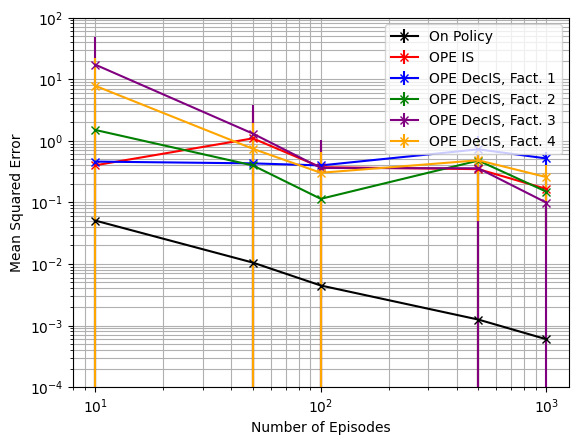

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**2, shorter_D, estimator='IS')

On Policy-----[0.05051049 0.01050452 0.00446289 0.00124901 0.00059988]
OPE PDIS-----[0.39920786 1.09174084 0.37165538 0.34560431 0.16522984]
OPE DecPDIS, Fact. 1-----[0.15260996 0.11522573 0.09517798 0.18427969 0.1534021 ]
OPE DecPDIS, Fact. 2-----[1.74595144 0.50857847 0.19214763 0.79223648 0.31446031]
OPE DecPDIS, Fact. 3-----[17.85899283  1.43277546  0.48455363  0.57549602  0.24771691]
OPE DecPDIS, Fact. 4-----[7.84071164 0.71091376 0.27895574 0.44190719 0.23383028]


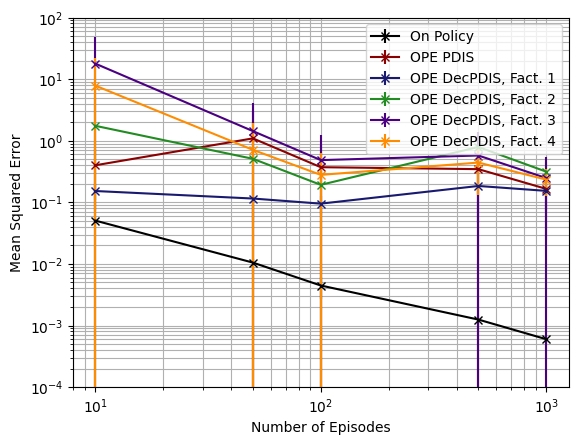

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**2, shorter_D, estimator='PDIS')

On Policy-----[0.05051049 0.01050452 0.00446289 0.00124901 0.00059988]
OPE PDWIS-----[0.10897207 0.12131698 0.12082427 0.11664029 0.12033178]
OPE DecPDWIS, Fact. 1-----[0.11303984 0.12489386 0.12494613 0.12027355 0.12246634]
OPE DecPDWIS, Fact. 2-----[0.08497329 0.0984329  0.10114421 0.09787445 0.10034252]
OPE DecPDWIS, Fact. 3-----[0.09306649 0.10598014 0.10719714 0.10233756 0.10645767]
OPE DecPDWIS, Fact. 4-----[0.09473191 0.10840132 0.11016463 0.10579797 0.10801576]


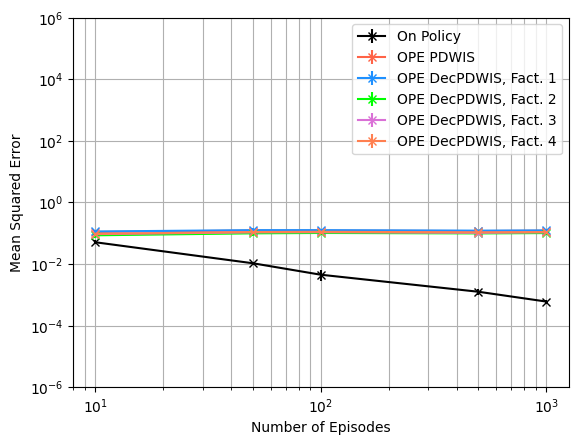

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[ 3.240835   15.08617496 11.26333638 15.44001354 18.0484147 ]
OPE DecIS, Fact. 1-----[ 3.18412073  9.06974498  9.56118903 17.84996476 23.35632272]
OPE DecIS, Fact. 2-----[13.50258967  9.75298719 30.77782904 32.24828199 68.7900592 ]
OPE DecIS, Fact. 3-----[ 7.32035674 24.01643458 23.2434104  10.42612655 30.48215987]
OPE DecIS, Fact. 4-----[ 4.61845076 10.05160767 15.08983389  8.88792932 21.19048962]


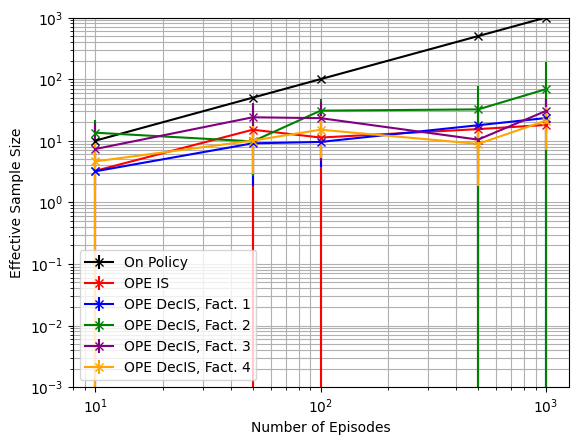

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-3), 10**3, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[ 3.240835   15.08617496 11.26333638 15.44001354 18.0484147 ]
OPE DecPDIS, Fact. 1-----[ 6.19540463 18.15341753 17.98861304 47.16844857 61.95222323]
OPE DecPDIS, Fact. 2-----[ 5.13773843  7.18704471 14.63032426 14.6067271  24.85463395]
OPE DecPDIS, Fact. 3-----[ 3.14191162 12.87687171 11.90472934  8.65956331 17.53209772]
OPE DecPDIS, Fact. 4-----[ 5.36293875 16.33043353 18.80008248  7.18735258 17.21793452]


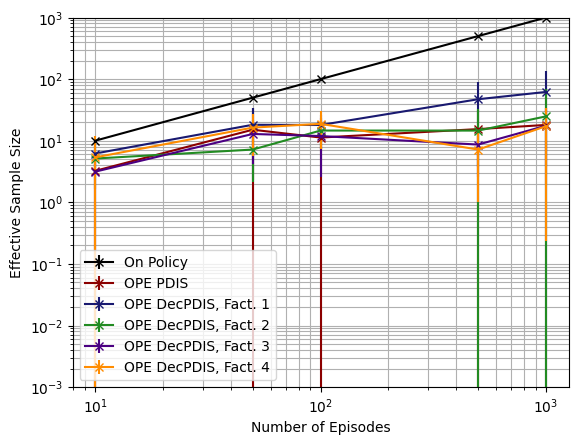

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[ 5395.65273868  7888.41296166  5892.40244762 12952.34802435
  8998.35141985]
OPE DecPDWIS, Fact. 1-----[12212.51517703 20565.70363915 25629.99030639 68501.40395255
 54758.67155261]
OPE DecPDWIS, Fact. 2-----[ 651.00651096 2084.12499665 2913.08550917 7528.96965172 7122.4172715 ]
OPE DecPDWIS, Fact. 3-----[ 982.51120751 2595.04316807 2495.30178674 6089.01674107 6156.96490415]
OPE DecPDWIS, Fact. 4-----[ 1357.71055725  4314.53166061  5813.05830413 12559.29201352
 10213.3374761 ]


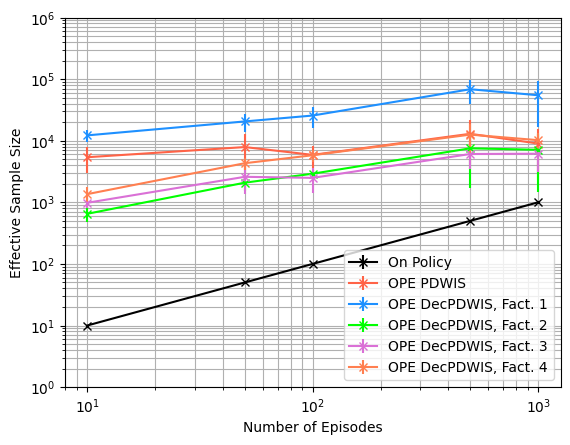

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**(6), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.6$ (Policy Divergence $3.2^{20}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc

gc.collect()
EVAL_EPSILON = 0.6

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

3.2


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.6003539499223188. Variance of on policy Q estimate: 0.026547550746133713
Mean OPE IS estimate: -0.6039957831384305. Bias1: 0.003641833216109937. Bias2: 0.0036418332161116673. Variance: 0.08318374946321909. MSE: 0.08319701241239305
Mean OPE PDIS estimate: -0.6039957831384305. Bias1: 0.003641833216109937. Bias2: 0.0036418332161116673. Variance: 0.08318374946321909. MSE: 0.08319701241239305
Mean OPE PDWIS estimate: -0.039422230143490715. Bias1: 0.560931719778828. Bias2: 0.5609317197788282. Variance: 0.00015584668139205762. MSE: 0.3148002409354258
Mean OPE DecIS: Fact. 1 estimate: -0.9999354181605742. Bias1: 0.39958146823825563. Bias2: 0.39958146823825536. Variance: 0.1424278535873249. MSE: 0.302093203346765
Mean OPE DecPDIS: Fact. 1 estimate: -0.7458526451005694. Bias1: 0.14549869517825062. Bias2: 0.14549869517825054. Variance: 0.0978618523280311. MSE: 0.1190317226266046
Mean OPE DecPDWIS: Fact. 1 estimate: 

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.15996749 0.11099303 0.11869391 0.13639341 0.1049985 ]
OPE DecIS, Fact. 1-----[0.34023181 0.35858839 0.37143109 0.40567362 0.39348797]
OPE DecIS, Fact. 2-----[0.17420413 0.12687267 0.12871489 0.0765291  0.09053335]
OPE DecIS, Fact. 3-----[0.50756264 0.18421553 0.10720615 0.05806237 0.07316571]
OPE DecIS, Fact. 4-----[0.41780361 0.17487143 0.15633737 0.19998002 0.17929918]


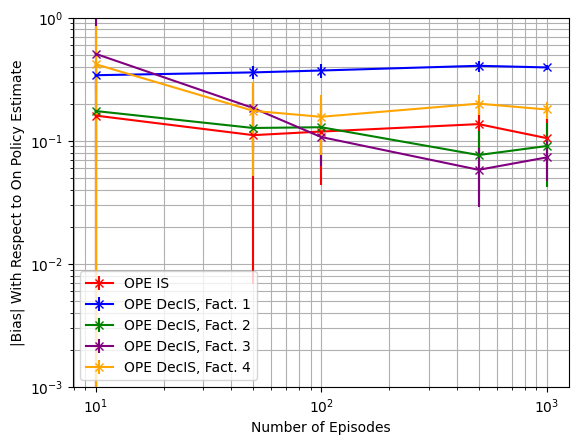

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.15996749 0.11099303 0.11869391 0.13639341 0.1049985 ]
OPE DecPDIS, Fact. 1-----[0.10992987 0.08801628 0.10027832 0.12217456 0.104889  ]
OPE DecPDIS, Fact. 2-----[0.2013232  0.12598268 0.10369404 0.19384739 0.14833851]
OPE DecPDIS, Fact. 3-----[0.60908817 0.12783798 0.11535487 0.1579763  0.11242384]
OPE DecPDIS, Fact. 4-----[0.42262848 0.14632235 0.13050814 0.17027068 0.14614777]


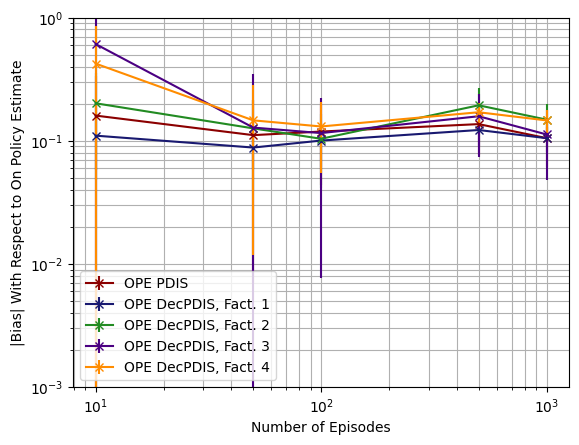

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.59382734 0.60467458 0.59867712 0.60297155 0.60485178]
OPE DecPDWIS, Fact. 1-----[0.59910693 0.60941807 0.60422615 0.60864582 0.60969546]
OPE DecPDWIS, Fact. 2-----[0.57337393 0.58541632 0.58190069 0.58617794 0.58741146]
OPE DecPDWIS, Fact. 3-----[0.58145469 0.59473562 0.58998449 0.5934673  0.59593259]
OPE DecPDWIS, Fact. 4-----[0.58356668 0.59545418 0.59124617 0.59516547 0.59620679]


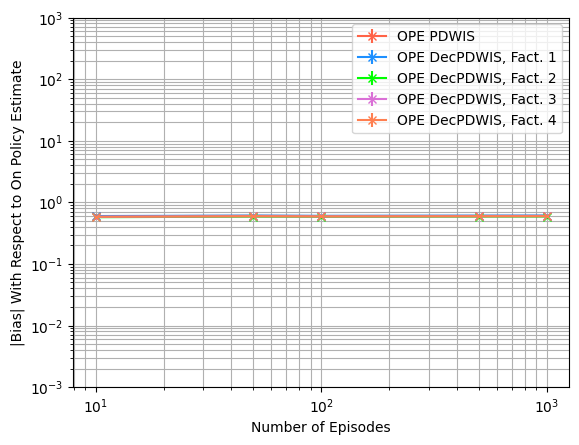

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.03191401 0.00863703 0.00496184 0.00069757 0.00035116]
OPE IS-----[0.48977901 0.24437323 0.10023542 0.10920198 0.04025083]
OPE DecIS, Fact. 1-----[0.1375196  0.0890827  0.05622542 0.0345622  0.0145673 ]
OPE DecIS, Fact. 2-----[0.52372125 0.24869044 0.06922949 0.22863294 0.05991155]
OPE DecIS, Fact. 3-----[7.48487956 0.51769914 0.14847595 0.06812521 0.02193093]
OPE DecIS, Fact. 4-----[3.24444319 0.2537546  0.07493298 0.0430682  0.01292641]


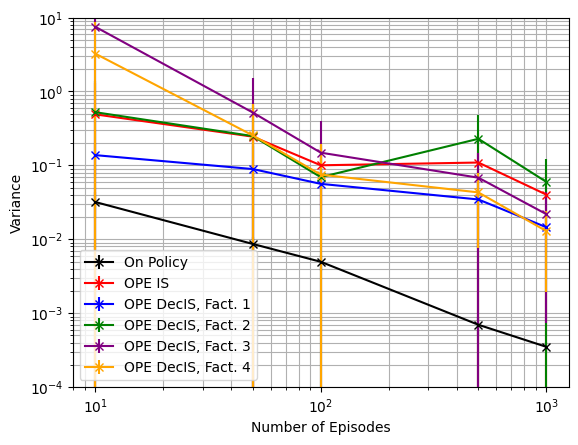

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**1, shorter_D, estimator='IS')

On Policy-----[0.03191401 0.00863703 0.00496184 0.00069757 0.00035116]
OPE PDIS-----[0.48977901 0.24437323 0.10023542 0.10920198 0.04025083]
OPE DecPDIS, Fact. 1-----[0.07784541 0.04708931 0.0333926  0.01611709 0.01262869]
OPE DecPDIS, Fact. 2-----[0.58611778 0.26126308 0.07614576 0.23603898 0.06426669]
OPE DecPDIS, Fact. 3-----[7.51985889 0.52266606 0.16347142 0.0766418  0.03028785]
OPE DecPDIS, Fact. 4-----[3.26400607 0.24159513 0.0718194  0.03888545 0.01398343]


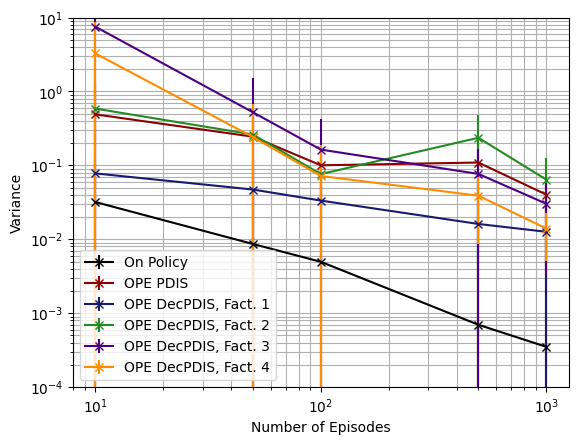

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**1, shorter_D, estimator='PDIS')

On Policy-----[0.03191401 0.00863703 0.00496184 0.00069757 0.00035116]
OPE PDWIS-----[1.14619570e-04 7.41894250e-05 5.56543978e-05 3.58259905e-05
 3.48470208e-05]
OPE DecPDWIS, Fact. 1-----[3.18740089e-05 2.30026642e-05 2.61706231e-05 5.60412297e-06
 1.14624975e-05]
OPE DecPDWIS, Fact. 2-----[2.68712484e-04 7.88758140e-05 5.14287648e-05 6.39205025e-05
 4.66457898e-05]
OPE DecPDWIS, Fact. 3-----[2.12430555e-04 9.94162896e-05 7.49051856e-05 4.51711162e-05
 4.82026592e-05]
OPE DecPDWIS, Fact. 4-----[1.42071347e-04 4.50030598e-05 3.32377256e-05 2.16586522e-05
 1.48532224e-05]


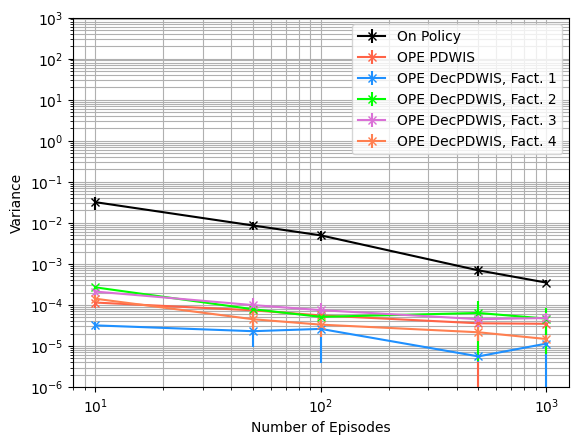

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-6), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.03191401 0.00863703 0.00496184 0.00069757 0.00035116]
OPE IS-----[0.54697512 0.26753823 0.11994701 0.13145958 0.05319034]
OPE DecIS, Fact. 1-----[0.26074373 0.21962543 0.19635456 0.20090666 0.16986898]
OPE DecIS, Fact. 2-----[0.56516523 0.26681395 0.08962522 0.23628821 0.07046655]
OPE DecIS, Fact. 3-----[8.10737236 0.56186724 0.16198558 0.07233458 0.02794377]
OPE DecIS, Fact. 4-----[3.61571409 0.29947151 0.10580986 0.0844189  0.04588763]


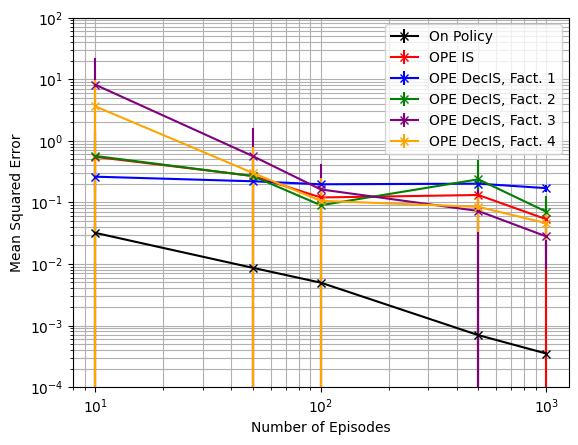

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**2, shorter_D, estimator='IS')

On Policy-----[0.03191401 0.00863703 0.00496184 0.00069757 0.00035116]
OPE PDIS-----[0.54697512 0.26753823 0.11994701 0.13145958 0.05319034]
OPE DecPDIS, Fact. 1-----[0.09264912 0.05570412 0.04498517 0.032032   0.02423063]
OPE DecPDIS, Fact. 2-----[0.65006654 0.28457209 0.09079772 0.27939593 0.08882782]
OPE DecPDIS, Fact. 3-----[8.33377925 0.58763057 0.18835896 0.10860817 0.04709446]
OPE DecPDIS, Fact. 4-----[3.63423409 0.28107737 0.09462564 0.06889111 0.03629509]


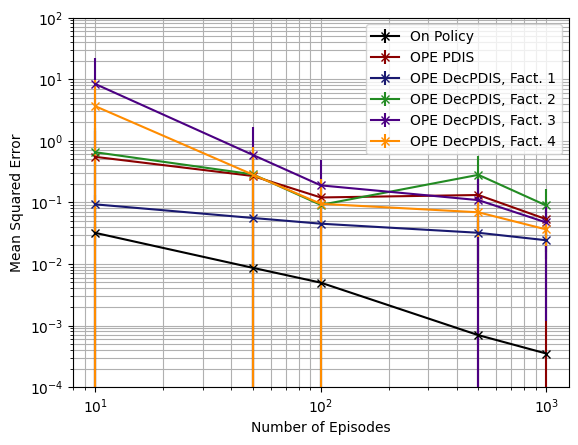

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**2, shorter_D, estimator='PDIS')

On Policy-----[0.03191401 0.00863703 0.00496184 0.00069757 0.00035116]
OPE PDWIS-----[0.35603169 0.36586181 0.35863719 0.36364704 0.36591034]
OPE DecPDWIS, Fact. 1-----[0.36219695 0.37156349 0.36527611 0.3704865  0.37175958]
OPE DecPDWIS, Fact. 2-----[0.33235213 0.34294597 0.33882419 0.34370028 0.34512685]
OPE DecPDWIS, Fact. 3-----[0.34157484 0.35398066 0.34835893 0.35227308 0.3552061 ]
OPE DecPDWIS, Fact. 4-----[0.34395336 0.35476207 0.34977156 0.35426518 0.35549668]


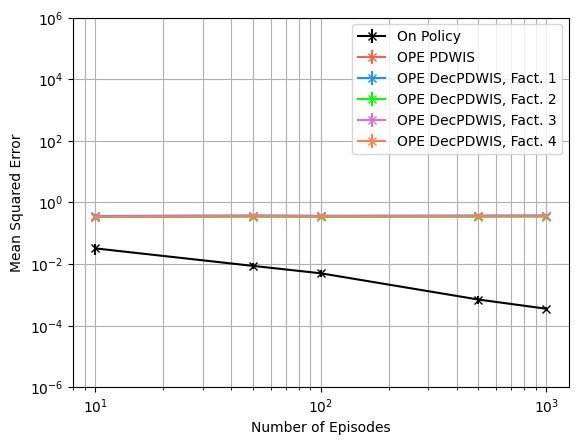

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[ 3.36946666  9.7191684  13.07676681 21.0501643  19.99080488]
OPE DecIS, Fact. 1-----[ 3.09047627 10.61462414 17.68843144 23.85630267 33.63621037]
OPE DecIS, Fact. 2-----[ 6.52590735  9.65411943 46.83539325 19.72245715 34.79550842]
OPE DecIS, Fact. 3-----[ 3.75980476 14.07412943 26.46084785 13.32081133 27.60843371]
OPE DecIS, Fact. 4-----[ 3.56574846 12.10152746 40.13832692 16.8978754  41.71904375]


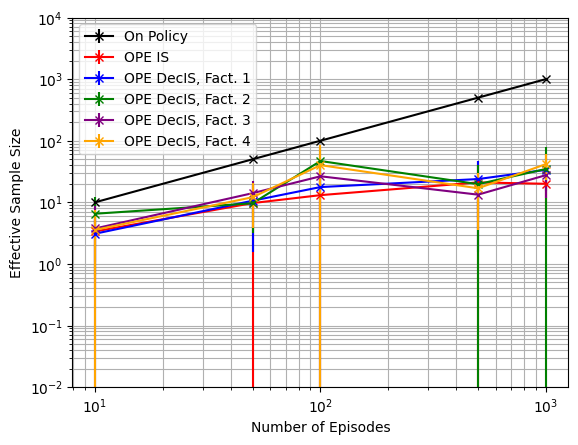

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-2), 10**4, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[ 3.36946666  9.7191684  13.07676681 21.0501643  19.99080488]
OPE DecPDIS, Fact. 1-----[ 5.05483404 18.70362401 26.37627664 44.24290629 59.76751856]
OPE DecPDIS, Fact. 2-----[ 2.67009821  8.28888311 26.48892056 16.19324597 19.99044797]
OPE DecPDIS, Fact. 3-----[ 2.30030266 12.21377032 18.37164175 11.88861012 18.23779785]
OPE DecPDIS, Fact. 4-----[ 3.76407957 17.87812955 38.87911917 15.29488108 40.41925201]


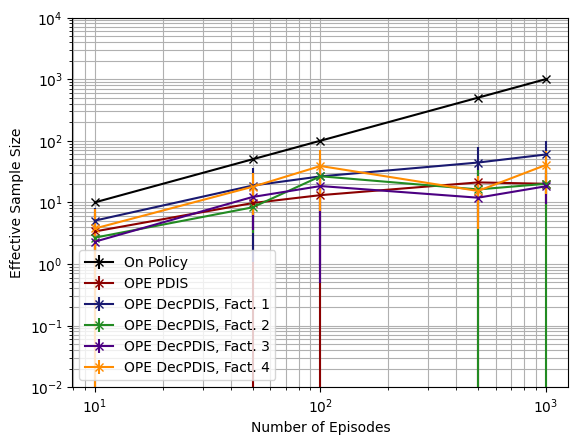

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-2), 10**4, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[ 3006.86095775  9508.32396276 11904.73158441 23527.5847158
 17864.08665854]
OPE DecPDWIS, Fact. 1-----[10808.77456406 27537.72952242 33685.04817609 64861.50734807
 77639.73348433]
OPE DecPDWIS, Fact. 2-----[ 1253.07528555  5792.18032424 12083.91626735  9629.40604603
 10608.7890059 ]
OPE DecPDWIS, Fact. 3-----[ 1872.91370968  5090.90686167  8779.10471597 11489.61179615
  9513.08394459]
OPE DecPDWIS, Fact. 4-----[ 2537.56392199 10869.77968122 20474.35181676 20609.41162525
 25894.07568574]


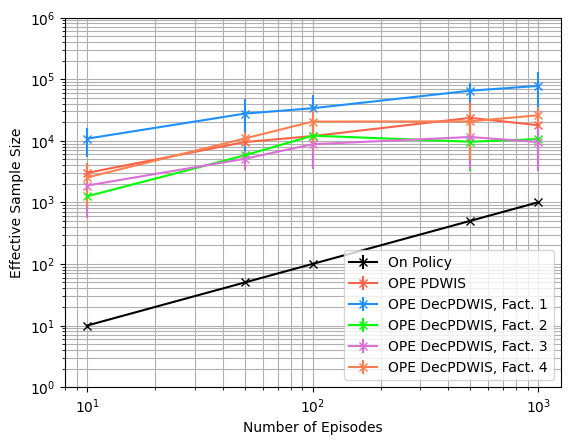

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**(6), shorter_D, estimator='PDWIS')

### Varying Episodes $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{20}$)



Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc
gc.collect()
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
EPISODES = [10, 50, 100, 500, 1000]

bias_means = np.zeros((len(EPISODES), 16))
bias_stds = np.zeros((len(EPISODES), 16))
var_means = np.zeros((len(EPISODES), 16))
var_stds = np.zeros((len(EPISODES), 16))
MSE_means = np.zeros((len(EPISODES), 16))
MSE_stds = np.zeros((len(EPISODES), 16))
ESS_means = np.zeros((len(EPISODES), 16))
ESS_stds = np.zeros((len(EPISODES), 16))

RUNS = 20

for id in range(len(EPISODES)):
  e = EPISODES[id]
  print(f'{e} Episodes, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

10 Episodes, 20 ----------------------------------

Mean on policy Q estimate: -0.855985858958617. Variance of on policy Q estimate: 0.01827742621364951
Mean OPE IS estimate: -0.8232098088500347. Bias1: 0.03277605010858225. Bias2: 0.03277605010858231. Variance: 0.02096417324753628. MSE: 0.022038442708256573
Mean OPE PDIS estimate: -0.8232098088500347. Bias1: 0.03277605010858225. Bias2: 0.03277605010858231. Variance: 0.02096417324753628. MSE: 0.022038442708256573
Mean OPE PDWIS estimate: -0.04274634918908521. Bias1: 0.8132395097695317. Bias2: 0.8132395097695317. Variance: 4.39666655241112e-05. MSE: 0.6614024669157125
Mean OPE DecIS: Fact. 1 estimate: -0.9623557127323163. Bias1: 0.10636985377369935. Bias2: 0.10636985377369934. Variance: 0.022273781656403886. MSE: 0.03358832744824207
Mean OPE DecPDIS: Fact. 1 estimate: -0.8455260808599825. Bias1: 0.010459778098634617. Bias2: 0.01045977809863452. Variance: 0.01826905424208898. MSE: 0.018378461199961657
Mean OPE DecPDWIS: Fact. 1 estimate: 

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.0653103  0.01568834 0.01292312 0.0179713  0.01605611]
OPE DecIS, Fact. 1-----[0.10681707 0.12434627 0.12944097 0.13803258 0.1376465 ]
OPE DecIS, Fact. 2-----[0.12244365 0.10067088 0.09989132 0.09220544 0.09250625]
OPE DecIS, Fact. 3-----[0.07877163 0.06386595 0.06042024 0.05100755 0.05337809]
OPE DecIS, Fact. 4-----[0.05810323 0.0167786  0.01500159 0.02491346 0.02457991]


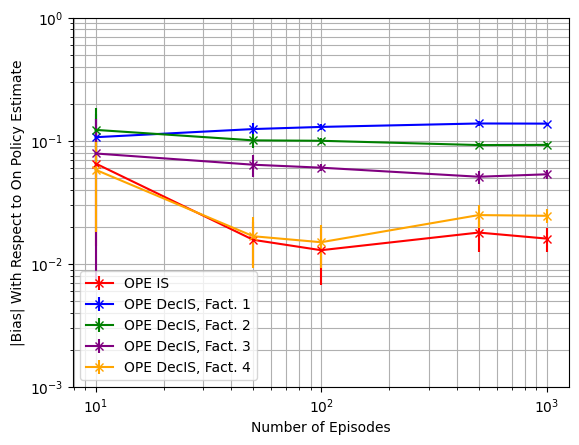

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.0653103  0.01568834 0.01292312 0.0179713  0.01605611]
OPE DecPDIS, Fact. 1-----[0.04373774 0.01187562 0.00889417 0.01636172 0.01571509]
OPE DecPDIS, Fact. 2-----[0.04563712 0.01048106 0.00689983 0.01399965 0.01373544]
OPE DecPDIS, Fact. 3-----[0.08294936 0.01181322 0.00338007 0.00789543 0.00457426]
OPE DecPDIS, Fact. 4-----[0.05902312 0.0104553  0.00574514 0.01460294 0.0141201 ]


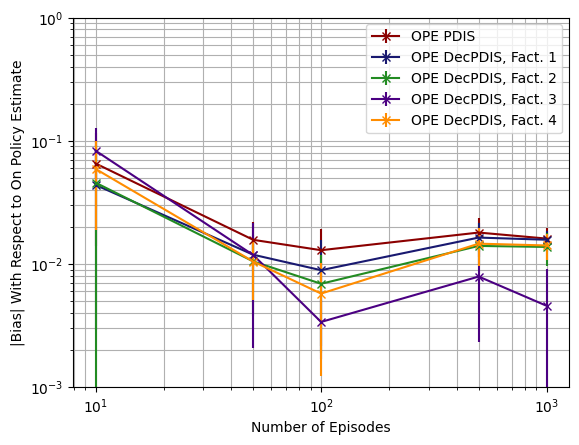

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.80843633 0.78142526 0.7857179  0.78263222 0.782314  ]
OPE DecPDWIS, Fact. 1-----[0.81174181 0.78458512 0.78911718 0.78600727 0.78564151]
OPE DecPDWIS, Fact. 2-----[0.80341421 0.776408   0.78100205 0.77798663 0.77758154]
OPE DecPDWIS, Fact. 3-----[0.80595758 0.77955842 0.78397349 0.7808234  0.78053384]
OPE DecPDWIS, Fact. 4-----[0.80719054 0.780285   0.78489096 0.78177902 0.78139821]


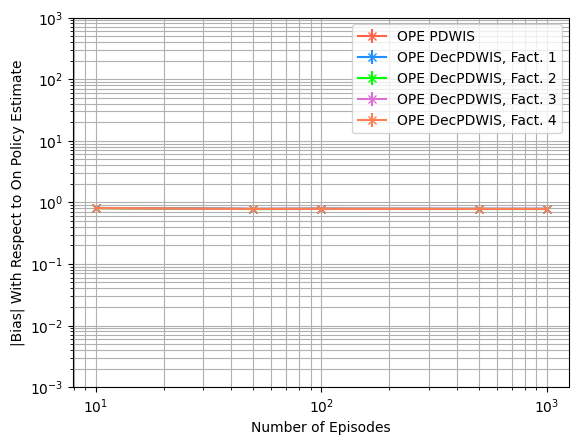

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.01675741 0.00444146 0.00160178 0.0003792  0.00018501]
OPE IS-----[0.02441733 0.00713322 0.00377071 0.00078386 0.00035633]
OPE DecIS, Fact. 1-----[0.02773651 0.00739604 0.00387815 0.00091627 0.00045802]
OPE DecIS, Fact. 2-----[0.02101233 0.0046454  0.00254381 0.00060877 0.00033233]
OPE DecIS, Fact. 3-----[0.04423424 0.00616167 0.00332564 0.00080039 0.00038848]
OPE DecIS, Fact. 4-----[0.02545328 0.00531082 0.00265926 0.00066872 0.00034553]


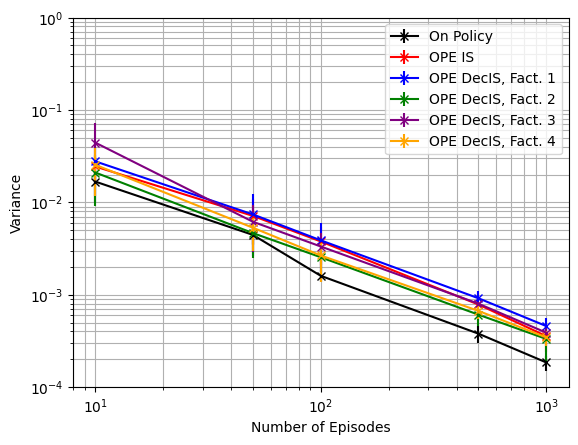

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

On Policy-----[0.01675741 0.00444146 0.00160178 0.0003792  0.00018501]
OPE PDIS-----[0.02441733 0.00713322 0.00377071 0.00078386 0.00035633]
OPE DecPDIS, Fact. 1-----[0.02152401 0.00613113 0.00323328 0.00074275 0.00037525]
OPE DecPDIS, Fact. 2-----[0.02638088 0.00600151 0.00322326 0.0007273  0.00041539]
OPE DecPDIS, Fact. 3-----[0.04789942 0.00695686 0.00374248 0.00088942 0.00044786]
OPE DecPDIS, Fact. 4-----[0.02573141 0.00555472 0.00280637 0.00065601 0.00035037]


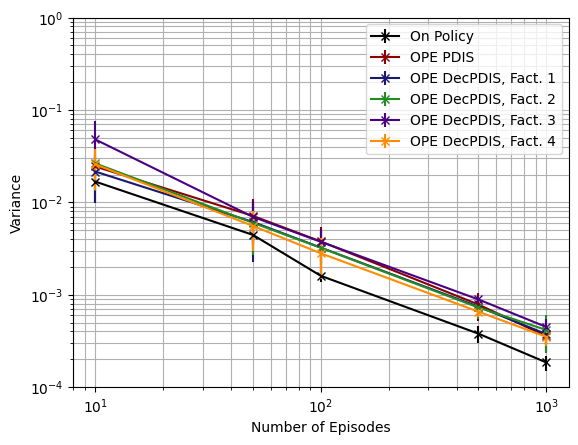

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.01675741 0.00444146 0.00160178 0.0003792  0.00018501]
OPE PDWIS-----[4.23808035e-05 1.33238251e-05 5.85375986e-06 1.16430678e-06
 7.58661790e-07]
OPE DecPDWIS, Fact. 1-----[2.41341112e-05 7.91761181e-06 3.96019480e-06 7.64479870e-07
 5.02735556e-07]
OPE DecPDWIS, Fact. 2-----[5.26058396e-05 1.44611475e-05 7.34230908e-06 1.58385307e-06
 1.04546481e-06]
OPE DecPDWIS, Fact. 3-----[4.97683641e-05 1.52773569e-05 7.60960973e-06 1.58878400e-06
 9.81701996e-07]
OPE DecPDWIS, Fact. 4-----[3.63452395e-05 1.06001412e-05 5.54318251e-06 1.13692368e-06
 6.67465580e-07]


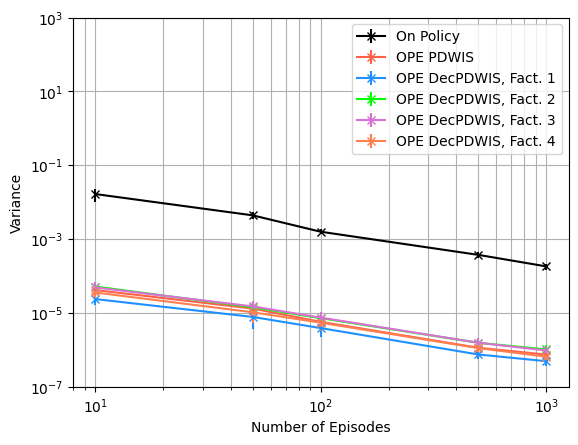

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.01675741 0.00444146 0.00160178 0.0003792  0.00018501]
OPE IS-----[0.03130677 0.00741663 0.0039761  0.00113661 0.00062634]
OPE DecIS, Fact. 1-----[0.04233714 0.02304422 0.02068876 0.0200025  0.01941246]
OPE DecIS, Fact. 2-----[0.03976964 0.01495914 0.01255694 0.00912722 0.00890408]
OPE DecIS, Fact. 3-----[0.05555767 0.01041721 0.00699038 0.00343947 0.0032574 ]
OPE DecIS, Fact. 4-----[0.03042871 0.00564809 0.00291715 0.00131694 0.00096025]


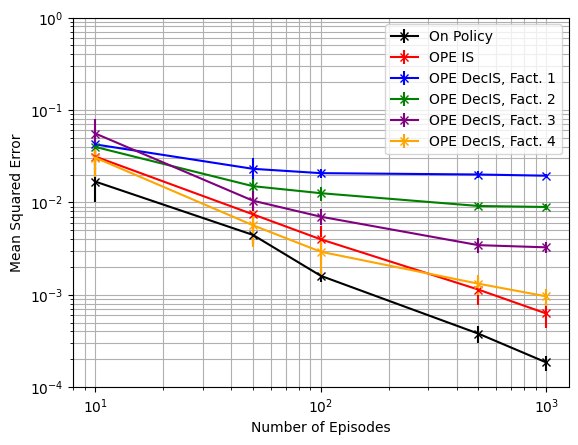

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**0, shorter_D, estimator='IS')

On Policy-----[0.01675741 0.00444146 0.00160178 0.0003792  0.00018501]
OPE PDIS-----[0.03130677 0.00741663 0.0039761  0.00113661 0.00062634]
OPE DecPDIS, Fact. 1-----[0.02510198 0.00628183 0.00335762 0.00103607 0.00062988]
OPE DecPDIS, Fact. 2-----[0.03061247 0.00615647 0.00329577 0.00094059 0.00062108]
OPE DecPDIS, Fact. 3-----[0.05661948 0.00719147 0.00375675 0.00098284 0.00048939]
OPE DecPDIS, Fact. 4-----[0.03082466 0.00569303 0.00285977 0.000894   0.00056139]


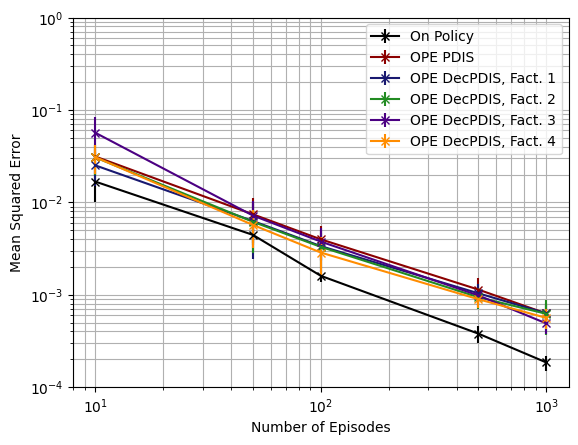

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-4), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.01675741 0.00444146 0.00160178 0.0003792  0.00018501]
OPE PDWIS-----[0.65509907 0.61099807 0.61753015 0.61252249 0.61202075]
OPE DecPDWIS, Fact. 1-----[0.66041883 0.61594051 0.62288651 0.61781618 0.61723788]
OPE DecPDWIS, Fact. 2-----[0.64696875 0.60318503 0.61014746 0.60527289 0.60463899]
OPE DecPDWIS, Fact. 3-----[0.65112065 0.6080759  0.61479131 0.60969435 0.60923857]
OPE DecPDWIS, Fact. 4-----[0.65306782 0.60921294 0.61623517 0.61118753 0.61058856]


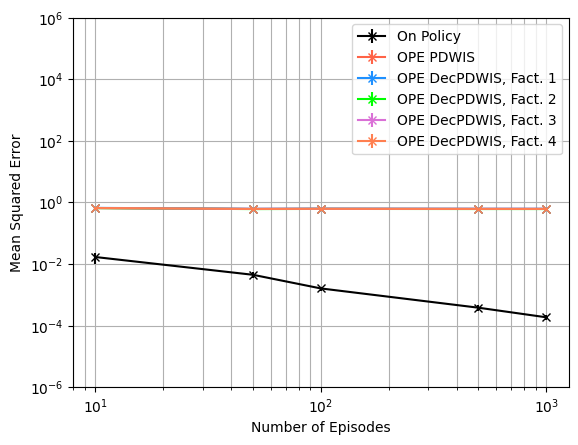

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[  10.   50.  100.  500. 1000.]
OPE IS-----[  6.67137094  37.75647765  48.55635996 281.82741165 606.11607862]
OPE DecIS, Fact. 1-----[  7.08074551  41.4590349   49.39478527 215.49361666 420.82758151]
OPE DecIS, Fact. 2-----[  8.65556683  58.22519362  71.89483411 337.2898026  702.50777294]
OPE DecIS, Fact. 3-----[  4.9924156   45.18719017  54.6676614  236.78236884 501.39897862]
OPE DecIS, Fact. 4-----[  7.99601863  52.54919203  69.42788596 291.81807854 558.3543584 ]


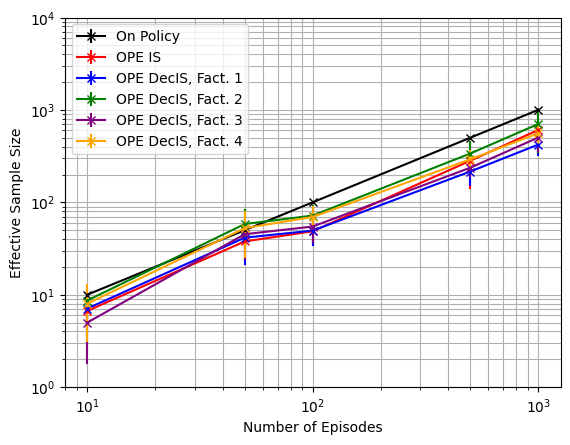

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**4, shorter_D, estimator='IS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDIS-----[  6.67137094  37.75647765  48.55635996 281.82741165 606.11607862]
OPE DecPDIS, Fact. 1-----[  9.0490793   49.15612181  57.93710694 264.37306306 518.51360145]
OPE DecPDIS, Fact. 2-----[  6.74159647  47.70663536  55.97403422 286.59733018 563.41306051]
OPE DecPDIS, Fact. 3-----[  4.70261808  39.75133474  48.55976576 214.10793761 440.57413382]
OPE DecPDIS, Fact. 4-----[  7.7490175   51.74859224  65.17852814 292.67345889 557.6045972 ]


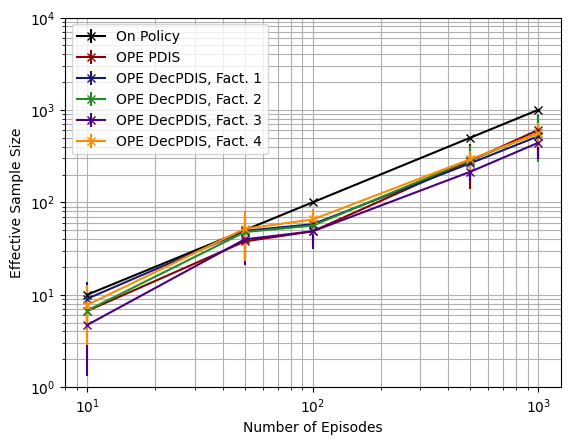

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(0), 10**4, shorter_D, estimator='PDIS')

On Policy-----[  10.   50.  100.  500. 1000.]
OPE PDWIS-----[  4569.50670495  20043.15880535  30032.70067931 189741.95268498
 287778.73354927]
OPE DecPDWIS, Fact. 1-----[  8402.66878291  35781.57551572  45756.8507267  258146.63206792
 415405.81089814]
OPE DecPDWIS, Fact. 2-----[  3452.0510047   18486.20237347  22973.32393009 129512.62235149
 205576.70161826]
OPE DecPDWIS, Fact. 3-----[  4162.21062328  18880.42309868  23714.35239607 127608.61005568
 211884.18853021]
OPE DecPDWIS, Fact. 4-----[  5377.94345836  27455.43004462  32245.71557924 173513.65626055
 299571.35266044]


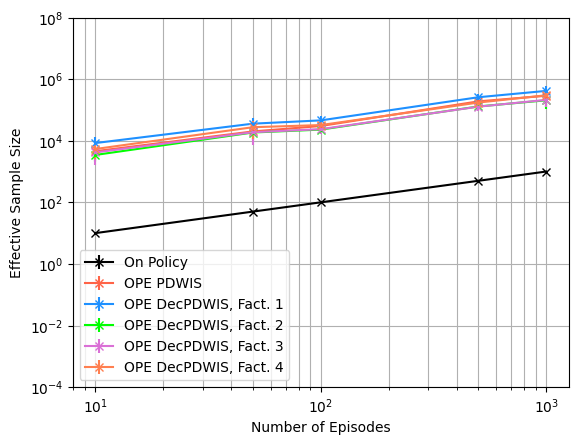

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')

### Varying Episode Length $T$ With $\epsilon_{e} = 0.8$ (Policy Divergence $1.6^{T}$)

Set up evaluation policy, generate data and convert into factored format

In [ ]:
import gc

gc.collect()
EVAL_EPSILON = 0.8

evalPolSoft = np.copy(fullPol)
evalPolSoft[evalPolSoft == 1] = 1 - EVAL_EPSILON
evalPolSoft[evalPolSoft == 0] = EVAL_EPSILON / (n_actions - 1)

In [ ]:
# Calculate policy divergence from Voloshin et al.
D = 0
for state in range(randPol.shape[0] - 1):
    for action in range(randPol.shape[1] - 1):
        difference = evalPolSoft[state, action]/randPol[state, action]
        D = max(D, difference)
print(D)
shorter_D = round(D,2)

1.5999999999999996


In [ ]:
dgen = DataGenerator()
states, actions, lengths, rewards, diab, emp_tx_totals, emp_r_totals = dgen.simulate(
    NSIMSAMPS, NSTEPS, policy=evalPolSoft, policy_idx_type='full',
    p_diabetes=PROB_DIAB, use_tqdm=False) #True, tqdm_desc='Behaviour Policy Simulation')

obs_samps = utils.format_dgen_samps(
    states, actions, rewards, diab, NSTEPS, NSIMSAMPS)

In [ ]:
time = np.arange(NSTEPS)
times = np.stack(axis=0, arrays=[time]*NSIMSAMPS)
times = times[..., np.newaxis]

nf_tr_e = np.concatenate((times, states[:, 0:NSTEPS, :], actions, rewards, states[:, 1:, :]), axis=2)
nf_tr_e.shape

(100000, 20, 5)

In [ ]:
f_tr_e1, f_tr_e2, f_tr_e3, f_tr_e4 = factorise_dataset(nf_tr_e)

In [ ]:
factored_evalPolSoft1 = factor_policy_1(evalPolSoft)
factored_evalPolSoft2 = factor_policy_2(evalPolSoft)
factored_evalPolSoft3 = factor_policy_3(evalPolSoft)
factored_evalPolSoft4 = factor_policy_4(evalPolSoft)

In [ ]:
evalPolSoft = pad_policy(evalPolSoft)

factored_evalPolSoft1[0] = pad_policy(factored_evalPolSoft1[0])
factored_evalPolSoft1[1] = pad_policy(factored_evalPolSoft1[1])

factored_evalPolSoft2[0] = pad_policy(factored_evalPolSoft2[0])
factored_evalPolSoft2[1] = pad_policy(factored_evalPolSoft2[1])

factored_evalPolSoft3[0] = pad_policy(factored_evalPolSoft3[0])
factored_evalPolSoft3[1] = pad_policy(factored_evalPolSoft3[1])

factored_evalPolSoft4[0] = pad_policy(factored_evalPolSoft4[0])
factored_evalPolSoft4[1] = pad_policy(factored_evalPolSoft4[1])
factored_evalPolSoft4[2] = pad_policy(factored_evalPolSoft4[2])

In [ ]:
import policy_estimators as pe
import gc

def evaluate_PE(RUNS, EPISODES, SHORTER_D, STEPS=NSTEPS):

  biases = np.zeros((5, 16))
  variances = np.zeros((5, 16))
  MSEs = np.zeros((5, 16))
  ESSs = np.zeros((5, 16))

  # Reshape data for processing
  T, ldim = nf_tr_b.shape[-2], nf_tr_b.shape[-1]
  nfb = nf_tr_b.reshape((-1, RUNS, EPISODES, T, ldim))
  nfe = nf_tr_e.reshape((-1, RUNS, EPISODES, T, ldim))

  T, D1, ldim = f_tr_b1.shape[-3], f_tr_b1.shape[-2], f_tr_b1.shape[-1]
  fb1 = f_tr_b1.reshape((-1, RUNS, EPISODES, T, D1, ldim))
  fe1 = f_tr_e1.reshape((-1, RUNS, EPISODES, T, D1, ldim))

  T, D2, ldim = f_tr_b2.shape[-3], f_tr_b2.shape[-2], f_tr_b2.shape[-1]
  fb2 = f_tr_b2.reshape((-1, RUNS, EPISODES, T, D2, ldim))
  fe2 = f_tr_e2.reshape((-1, RUNS, EPISODES, T, D2, ldim))

  T, D3, ldim = f_tr_b3.shape[-3], f_tr_b3.shape[-2], f_tr_b3.shape[-1]
  fb3 = f_tr_b3.reshape((-1, RUNS, EPISODES, T, D3, ldim))
  fe3 = f_tr_e3.reshape((-1, RUNS, EPISODES, T, D3, ldim))

  T, D4, ldim = f_tr_b4.shape[-3], f_tr_b4.shape[-2], f_tr_b4.shape[-1]
  fb4 = f_tr_b4.reshape((-1, RUNS, EPISODES, T, D4, ldim))
  fe4 = f_tr_e4.reshape((-1, RUNS, EPISODES, T, D4, ldim))

  for t in range(5):
    print()

    lower_index = 0
    estimates_on_policy = np.zeros(RUNS)
    estimates_OPE_IS = np.zeros(RUNS)
    estimates_OPE_PDIS = np.zeros(RUNS)
    estimates_OPE_PDWIS = np.zeros(RUNS)

    estimates_OPE_DecIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDIS1 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS1 = np.zeros(RUNS)

    estimates_OPE_DecIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDIS2 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS2 = np.zeros(RUNS)

    estimates_OPE_DecIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDIS3 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS3 = np.zeros(RUNS)

    estimates_OPE_DecIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDIS4 = np.zeros(RUNS)
    estimates_OPE_DecPDWIS4 = np.zeros(RUNS)

    for r in range(RUNS):
        #On policy Q estimate
        estimates_on_policy[r] = pe.on_policy_Q_estimate(nfe[t, r, :, :STEPS, :], DISCOUNT_Pol)
        #Off policy IS estimate
        estimates_OPE_IS[r] = pe.off_policy_IS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDIS estimate
        estimates_OPE_PDIS[r] = pe.off_policy_PDIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)
        #Off policy PDWIS estimate
        estimates_OPE_PDWIS[r] = pe.off_policy_PDWIS_estimator(nfb[t, r, :, :STEPS, :], DISCOUNT_Pol, randPol, evalPolSoft)

        #Factorisation 1----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS1[r], _ = pe.off_policy_DecIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS1[r], _ = pe.off_policy_DecPDIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS1[r], _ = pe.off_policy_DecPDWIS_estimator(fb1[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol1, factored_evalPolSoft1)

        #Factorisation 2----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS2[r], _ = pe.off_policy_DecIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS2[r], _ = pe.off_policy_DecPDIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS2[r], _ = pe.off_policy_DecPDWIS_estimator(fb2[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol2, factored_evalPolSoft2)

        #Factorisation 3----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS3[r], _ = pe.off_policy_DecIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS3[r], _ = pe.off_policy_DecPDIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS3[r], _ = pe.off_policy_DecPDWIS_estimator(fb3[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1], factored_randPol3, factored_evalPolSoft3)

        #Factorisation 4----------------------------------

        #Off policy decomposed IS estimate
        estimates_OPE_DecIS4[r], _ = pe.off_policy_DecIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDIS estimate
        estimates_OPE_DecPDIS4[r], _ = pe.off_policy_DecPDIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)
        #Off policy decomposed PDWIS estimate
        estimates_OPE_DecPDWIS4[r], _ = pe.off_policy_DecPDWIS_estimator(fb4[t, r, :, :STEPS, :, :], DISCOUNT_Pol, [0,1,2], factored_randPol4, factored_evalPolSoft4)

    mean_on_policy = np.mean(estimates_on_policy)
    var_on_policy = np.var(estimates_on_policy, ddof=0)
    print(f'Mean on policy Q estimate: {mean_on_policy}. Variance of on policy Q estimate: {var_on_policy}')

    from sklearn.metrics import mean_squared_error

    #For on policy
    biases[t, 0] = 0.0
    variances[t, 0] = var_on_policy
    MSEs[t, 0] = var_on_policy
    ESSs[t, 0] = EPISODES

    def generate_results(estimates, mean_true, label):
      MSE = mean_squared_error(estimates, [mean_true]*RUNS)
      mean = np.mean(estimates)
      var = np.var(estimates, ddof=0)
      bias1 = np.sqrt(MSE - var)
      bias2 = abs(mean - mean_true)
      print(f'Mean {label} estimate: {mean}. Bias1: {bias1}. Bias2: {bias2}. Variance: {var}. MSE: {MSE}')
      return bias1, var, MSE

    label_list = ['OPE IS', 'OPE PDIS', 'OPE PDWIS',
                  'OPE DecIS: Fact. 1', 'OPE DecPDIS: Fact. 1', 'OPE DecPDWIS: Fact. 1',
                  'OPE DecIS: Fact. 2', 'OPE DecPDIS: Fact. 2', 'OPE DecPDWIS: Fact. 2',
                  'OPE DecIS: Fact. 3', 'OPE DecPDIS: Fact. 3', 'OPE DecPDWIS: Fact. 3',
                  'OPE DecIS: Fact. 4', 'OPE DecPDIS: Fact. 4', 'OPE DecPDWIS: Fact. 4'
                  ]

    estimates = [estimates_OPE_IS, estimates_OPE_PDIS, estimates_OPE_PDWIS,
                estimates_OPE_DecIS1, estimates_OPE_DecPDIS1, estimates_OPE_DecPDWIS1,
                estimates_OPE_DecIS2, estimates_OPE_DecPDIS2, estimates_OPE_DecPDWIS2,
                estimates_OPE_DecIS3, estimates_OPE_DecPDIS3, estimates_OPE_DecPDWIS3,
                estimates_OPE_DecIS4, estimates_OPE_DecPDIS4, estimates_OPE_DecPDWIS4
                ]


    for (id, val) in enumerate(label_list):
      biases[t, 1+id], variances[t, 1+id], MSEs[t, 1+id] = generate_results(estimates[id], mean_on_policy, label_list[id])
      ESSs[t, 1+id] = (EPISODES*variances[t, 0])/variances[t, 1+id]
      gc.collect()

  return np.mean(biases, axis=0), np.std(biases, axis=0), np.mean(variances, axis=0), np.std(variances, axis=0), np.mean(MSEs, axis=0), np.std(MSEs, axis=0), np.mean(ESSs, axis=0), np.std(ESSs, axis=0)

#### Run Everything

In [ ]:
LENGTHS = [1, 5, 10, 20]

bias_means = np.zeros((len(LENGTHS), 16))
bias_stds = np.zeros((len(LENGTHS), 16))
var_means = np.zeros((len(LENGTHS), 16))
var_stds = np.zeros((len(LENGTHS), 16))
MSE_means = np.zeros((len(LENGTHS), 16))
MSE_stds = np.zeros((len(LENGTHS), 16))
ESS_means = np.zeros((len(LENGTHS), 16))
ESS_stds = np.zeros((len(LENGTHS), 16))

RUNS = 100

for id in range(len(LENGTHS)):
  e = LENGTHS[id]
  print(f'{e} Steps, {RUNS} ----------------------------------')
  bias_means[id, :], bias_stds[id, :], var_means[id, :], var_stds[id, :], MSE_means[id, :], MSE_stds[id, :], ESS_means[id, :], ESS_stds[id, :] = evaluate_PE(RUNS=RUNS, EPISODES=e, SHORTER_D=shorter_D)
  print()
  gc.collect()

print('BIAS MEANS')
print(list(bias_means))
print('\nBIAS STDS')
print(list(bias_stds))
print('\nVAR MEANS')
print(list(var_means))
print('\nVAR STDS')
print(list(var_stds))
print('\nMSE MEANS')
print(list(MSE_means))
print('\nMSE STDS')
print(list(MSE_stds))
print('\nESS MEANS')
print(list(ESS_means))
print('\nESS STDS')
print(list(ESS_stds))

1 Steps, 100 ----------------------------------

Mean on policy Q estimate: -0.8249219220142479. Variance of on policy Q estimate: 0.17361658393224244
Mean OPE IS estimate: -0.8032678199133781. Bias1: 0.02165410210087014. Bias2: 0.02165410210086971. Variance: 0.14224645604920563. MSE: 0.14271535618700054
Mean OPE PDIS estimate: -0.8032678199133781. Bias1: 0.02165410210087014. Bias2: 0.02165410210086971. Variance: 0.14224645604920563. MSE: 0.14271535618700054
Mean OPE PDWIS estimate: -0.04367694362346582. Bias1: 0.781244978390782. Bias2: 0.781244978390782. Variance: 0.0002096999531292594. MSE: 0.6105534162139427
Mean OPE DecIS: Fact. 1 estimate: -0.9236641463455196. Bias1: 0.09874222433127201. Bias2: 0.09874222433127178. Variance: 0.23028890157535184. MSE: 0.24003892844123909
Mean OPE DecPDIS: Fact. 1 estimate: -0.809244887080431. Bias1: 0.01567703493381606. Bias2: 0.01567703493381689. Variance: 0.16931456918977253. MSE: 0.16956033861408862
Mean OPE DecPDWIS: Fact. 1 estimate: -0.039099

#### Plot Graphs

##### Plot Bias

OPE IS-----[0.03860821 0.04232165 0.02170785 0.02850519]
OPE DecIS, Fact. 1-----[0.14055988 0.13947525 0.1319549  0.14259174]
OPE DecIS, Fact. 2-----[0.07261175 0.09085101 0.09306225 0.08674056]
OPE DecIS, Fact. 3-----[0.03570011 0.05112541 0.05625731 0.04726948]
OPE DecIS, Fact. 4-----[0.04420513 0.04108114 0.02147546 0.02815236]


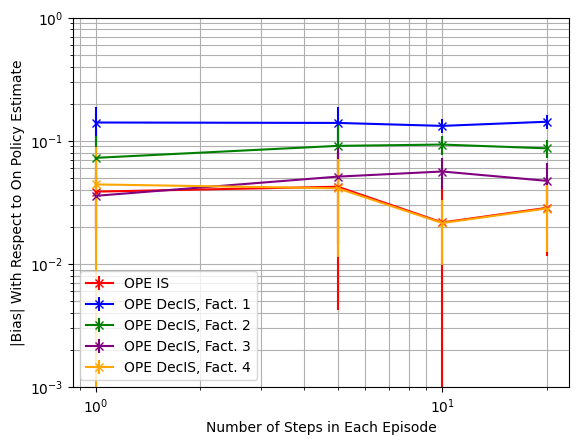

In [ ]:
label = 'bias'
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

OPE PDIS-----[0.03860821 0.04232165 0.02170785 0.02850519]
OPE DecPDIS, Fact. 1-----[0.03475045 0.03883539 0.01612823 0.02284606]
OPE DecPDIS, Fact. 2-----[0.04128422 0.04466756 0.01482688 0.02136777]
OPE DecPDIS, Fact. 3-----[0.04849491 0.03722071 0.01583458 0.01901908]
OPE DecPDIS, Fact. 4-----[0.040962   0.03719445 0.01397014 0.02015467]


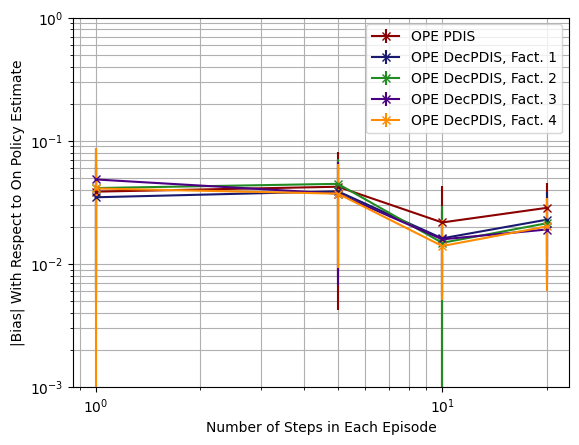

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

OPE PDWIS-----[0.78844629 0.77613495 0.77363798 0.77248034]
OPE DecPDWIS, Fact. 1-----[0.7930141  0.77957349 0.77696991 0.77592888]
OPE DecPDWIS, Fact. 2-----[0.78330716 0.77109024 0.76863166 0.76771106]
OPE DecPDWIS, Fact. 3-----[0.7864073  0.77403059 0.77178009 0.770674  ]
OPE DecPDWIS, Fact. 4-----[0.7879867  0.77508817 0.77260538 0.77165431]


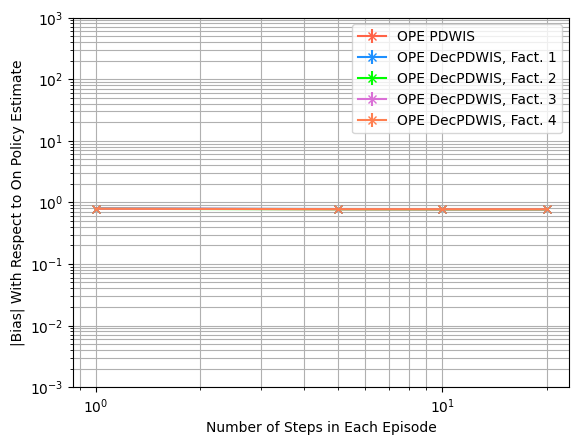

In [ ]:
plot_graphs(bias_means, bias_stds, label, 10**(-3), 10**3, shorter_D, estimator='PDWIS')

##### Plot Variance

On Policy-----[0.16592389 0.03285123 0.01880604 0.01013558]
OPE IS-----[0.36270927 0.06708437 0.03452453 0.01814864]
OPE DecIS, Fact. 1-----[0.29564892 0.06598135 0.03652679 0.01786499]
OPE DecIS, Fact. 2-----[0.22774999 0.05053461 0.02312282 0.01143193]
OPE DecIS, Fact. 3-----[0.37333068 0.06240567 0.02933575 0.01453946]
OPE DecIS, Fact. 4-----[0.24017064 0.04720446 0.02431795 0.01197036]


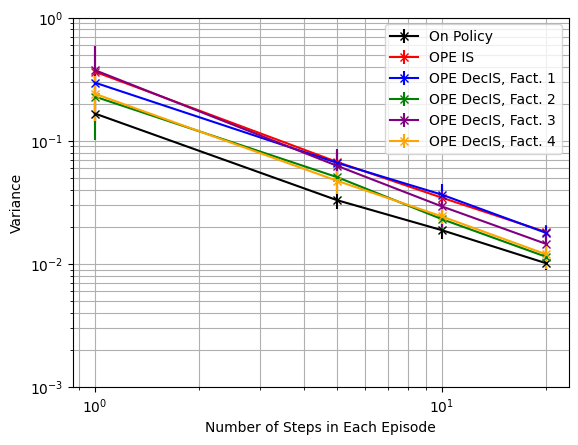

In [ ]:
label = 'var'
plot_graphs(var_means, var_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

On Policy-----[0.16592389 0.03285123 0.01880604 0.01013558]
OPE PDIS-----[0.36270927 0.06708437 0.03452453 0.01814864]
OPE DecPDIS, Fact. 1-----[0.24046467 0.05384574 0.02981996 0.0149899 ]
OPE DecPDIS, Fact. 2-----[0.28502472 0.06162757 0.02883442 0.01441852]
OPE DecPDIS, Fact. 3-----[0.41702999 0.06971188 0.03290447 0.01663183]
OPE DecPDIS, Fact. 4-----[0.24512994 0.04820515 0.02482402 0.01249569]


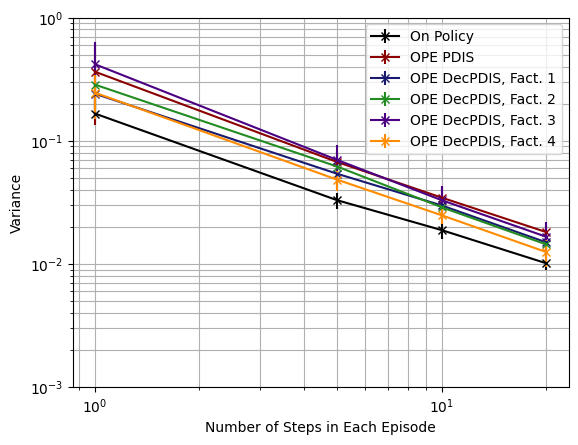

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.16592389 0.03285123 0.01880604 0.01013558]
OPE PDWIS-----[2.59951945e-04 9.54957923e-05 5.75931344e-05 2.99447100e-05]
OPE DecPDWIS, Fact. 1-----[2.19913768e-04 6.52278123e-05 3.68837399e-05 2.04904403e-05]
OPE DecPDWIS, Fact. 2-----[3.65309845e-04 1.20169281e-04 6.50954486e-05 3.65646924e-05]
OPE DecPDWIS, Fact. 3-----[3.01029025e-04 1.08055855e-04 6.28102613e-05 3.48186502e-05]
OPE DecPDWIS, Fact. 4-----[2.88291034e-04 8.63458764e-05 4.75572633e-05 2.67922389e-05]


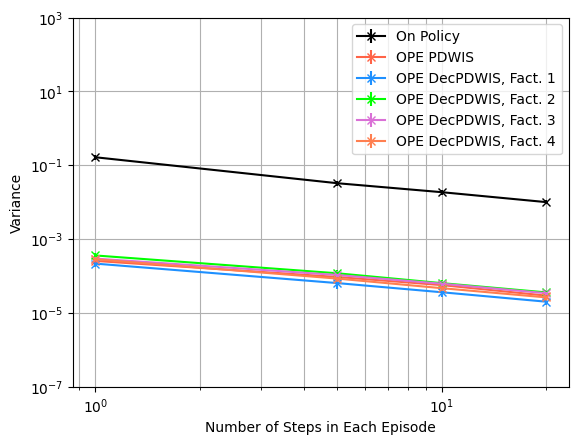

In [ ]:
plot_graphs(var_means, var_stds, label, 10**(-7), 10**(3), shorter_D, estimator='PDWIS')

##### Plot MSE

On Policy-----[0.16592389 0.03285123 0.01880604 0.01013558]
OPE IS-----[0.36473912 0.07032867 0.0354385  0.01924666]
OPE DecIS, Fact. 1-----[0.31748526 0.08777261 0.05422284 0.03851269]
OPE DecIS, Fact. 2-----[0.23430036 0.0608991  0.03207199 0.01915323]
OPE DecIS, Fact. 3-----[0.3748779  0.06635486 0.0327567  0.017102  ]
OPE DecIS, Fact. 4-----[0.2440647  0.04977244 0.02491388 0.01300964]


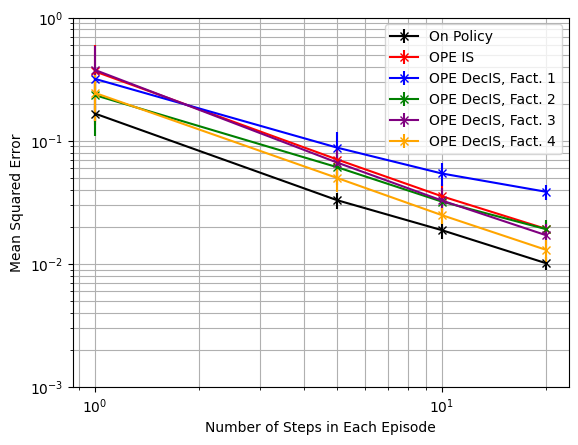

In [ ]:
label = 'MSE'
plot_graphs(MSE_means, MSE_stds, label, 10**(-3), 10**0, shorter_D, estimator='IS')

On Policy-----[0.16592389 0.03285123 0.01880604 0.01013558]
OPE PDIS-----[0.36473912 0.07032867 0.0354385  0.01924666]
OPE DecPDIS, Fact. 1-----[0.24255972 0.05630313 0.03019349 0.01576126]
OPE DecPDIS, Fact. 2-----[0.28795352 0.06432367 0.02926474 0.0150464 ]
OPE DecPDIS, Fact. 3-----[0.42094992 0.07202577 0.03320166 0.01712773]
OPE DecPDIS, Fact. 4-----[0.24895636 0.05037305 0.02509759 0.0131019 ]


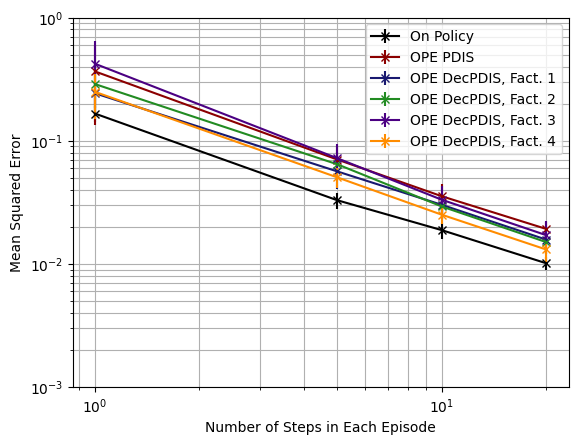

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-3), 10**0, shorter_D, estimator='PDIS')

On Policy-----[0.16592389 0.03285123 0.01880604 0.01013558]
OPE PDWIS-----[0.62359758 0.60293499 0.59871758 0.59678351]
OPE DecPDWIS, Fact. 1-----[0.63078321 0.60824675 0.60386315 0.60211194]
OPE DecPDWIS, Fact. 2-----[0.61564435 0.59515197 0.59100286 0.58944286]
OPE DecPDWIS, Fact. 3-----[0.62043439 0.59968059 0.59584535 0.59399973]
OPE DecPDWIS, Fact. 4-----[0.62291008 0.60129403 0.59710747 0.59550284]


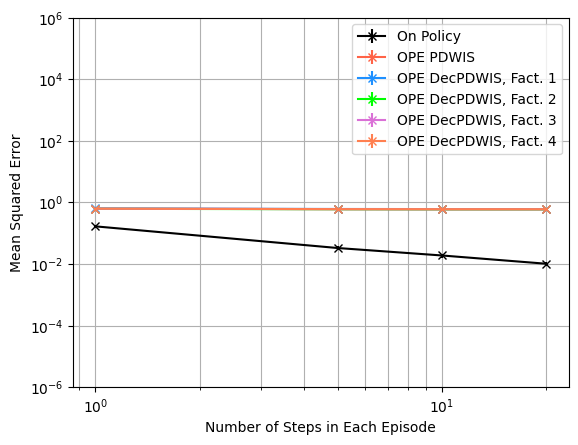

In [ ]:
plot_graphs(MSE_means, MSE_stds, label, 10**(-6), 10**(6), shorter_D, estimator='PDWIS')

##### Plot ESS

On Policy-----[ 1.  5. 10. 20.]
OPE IS-----[ 0.69771785  2.52267227  5.63291502 11.42193249]
OPE DecIS, Fact. 1-----[ 0.59233968  2.58804695  5.28372811 11.66465342]
OPE DecIS, Fact. 2-----[ 0.90794175  3.35838226  8.4465936  18.65668015]
OPE DecIS, Fact. 3-----[ 0.61048983  2.90667739  7.12627892 15.1080364 ]
OPE DecIS, Fact. 4-----[ 0.7872311   3.55029513  7.97594207 18.0003645 ]


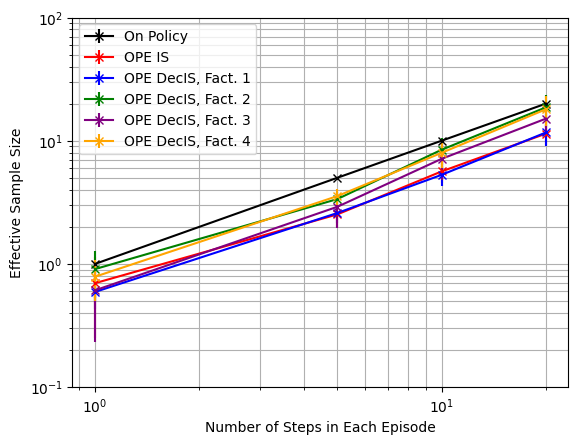

In [ ]:
label = 'ESS'
plot_graphs(ESS_means, ESS_stds, label, 10**(-1), 10**2, shorter_D, estimator='IS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDIS-----[ 0.69771785  2.52267227  5.63291502 11.42193249]
OPE DecPDIS, Fact. 1-----[ 0.74561463  3.15754764  6.48951058 13.88286067]
OPE DecPDIS, Fact. 2-----[ 0.68015769  2.72925219  6.78122678 14.80416153]
OPE DecPDIS, Fact. 3-----[ 0.53869702  2.54453393  6.29929907 13.28085721]
OPE DecPDIS, Fact. 4-----[ 0.76695925  3.46550522  7.84288119 17.29596932]


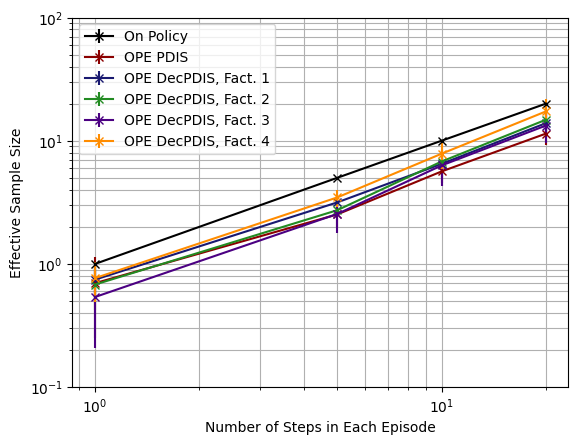

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-1), 10**2, shorter_D, estimator='PDIS')

On Policy-----[ 1.  5. 10. 20.]
OPE PDWIS-----[ 660.96614239 1809.04065844 3313.84994056 7058.18936374]
OPE DecPDWIS, Fact. 1-----[  781.63220199  2748.94135382  5309.34259793 10323.25656518]
OPE DecPDWIS, Fact. 2-----[ 465.70748695 1412.27864991 2962.27839563 5755.76464215]
OPE DecPDWIS, Fact. 3-----[ 567.58057959 1608.57373872 3086.54709534 6249.40263761]
OPE DecPDWIS, Fact. 4-----[ 596.82387407 1989.60183922 4091.06300945 7929.04346923]


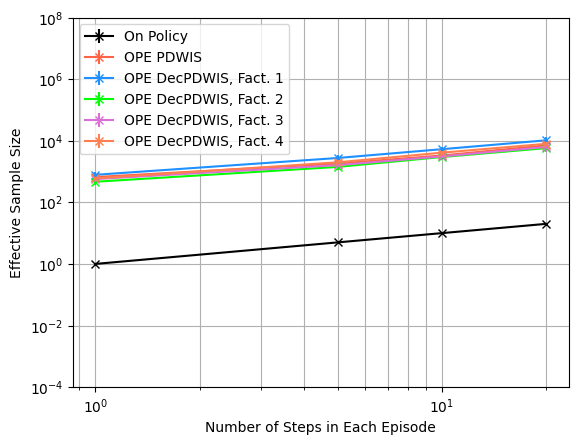

In [ ]:
plot_graphs(ESS_means, ESS_stds, label, 10**(-4), 10**(8), shorter_D, estimator='PDWIS')